In [3]:
%load_ext zipline


The zipline extension is already loaded. To reload it, use:
  %reload_ext zipline


In [6]:
%zipline ingest --help

Usage: %zipline [OPTIONS]

  Run a backtest for the given algorithm.

Options:
  -f, --algofile FILENAME         The file that contains the algorithm to run.
  -t, --algotext TEXT             The algorithm script to run.
  -D, --define TEXT               Define a name to be bound in the namespace
                                  before executing the algotext. For example
                                  '-Dname=value'. The value may be any python
                                  expression. These are evaluated in order so
                                  they may refer to previously defined names.
  --data-frequency [minute|daily]
                                  The data frequency of the simulation.
                                  [default: daily]
  --capital-base FLOAT            The starting capital for the simulation.
                                  [default: 10000000.0]
  -b, --bundle BUNDLE-NAME        The data bundle to use for the simulation.
                          

In [7]:
%%zipline --bundle yahoo-bundle --trading-calendar XNSE --start '2007-02-02' --end '2019-12-17' -o nse_weekly.pickle
from zipline.data import bundles
import os
import pandas as pd
from zipline.data.bundles import register, load
from zipline.data.bundles.csvdir import csvdir_equities
from zipline.data.bundles.yahoo import yahoo_stock_data
from zipline.data.data_portal import DataPortal
from zipline.api import schedule_function
from zipline.pipeline.data import Column
from zipline.pipeline.pipeline import Pipeline
from zipline.pipeline.data import USEquityPricing
from zipline.pipeline.engine import SimplePipelineEngine
from zipline.pipeline.loaders import USEquityPricingLoader
from trading_calendars.trading_calendar import TradingCalendar
from trading_calendars import get_calendar
import itertools
from zipline.pipeline.filters import StaticAssets
from zipline.utils.events import (
  date_rules,
  time_rules,
  Always,
  ComposedRule,
  Never,
  OncePerDay,
)
from zipline.api import (
  attach_pipeline,
  date_rules,
  order_target_percent,
  pipeline_output,
  record,
  schedule_function,
  symbols,
  symbol,
  sid,
)

start_session=pd.Timestamp('2007-02-02', tz='utc')
end_session=pd.Timestamp('2019-12-17', tz='utc')
import numpy as np
from scipy import stats
from zipline.api import order_target, record, symbol

register('yahoo-bundle',yahoo_stock_data,
    calendar_name="XNSE",
    start_session=start_session,
    end_session=end_session
)


bundle=load('yahoo-bundle')
all_assets=bundle.asset_finder.retrieve_all(bundle.asset_finder.sids)
# create a python set
symbols=set(
  str(asset.symbol) for asset in bundle.asset_finder.retrieve_all(bundle.asset_finder.equities_sids)
)

list_symbols=list(symbols)
# print(type(list_symbols))
# print("list of symbols", list_symbols)
data_por=DataPortal(bundle.asset_finder,
                    get_calendar("XNSE"),
                    bundle.equity_daily_bar_reader.first_trading_day,
                    equity_minute_reader=bundle.equity_minute_bar_reader,
                    equity_daily_reader=bundle.equity_daily_bar_reader,
                    adjustment_reader=bundle.adjustment_reader)

close_prices=data_por.get_spot_value(bundle.asset_finder.retrieve_all(bundle.asset_finder.equities_sids), 'close',
                                     pd.Timestamp('2007-02-02', tz='utc'), 'daily')
close_prices_list=data_por.get_spot_value(bundle.asset_finder.retrieve_all(bundle.asset_finder.equities_sids), 'close',
                                          pd.Timestamp('2019-12-17', tz='utc'), 'daily')

list_sids=list(bundle.asset_finder.sids)


# print((close_prices))


def _slope(ts):
  x=np.arange(len(ts))
  slope, intercept, r_value, p_value, std_err=stats.linregress(x, ts)
  annualized_slope=(np.power(np.exp(slope), 250)-1)*100
  return annualized_slope*(r_value**2)


def initialize(context):
  """
  Called once at the start of the algorithm.
  """
  # Setting global parameters
  # context.assets = symbol('3MINDIA')
  context.market=symbol('NIFTY.NS')
  context.market_window=200
  context.momentum_window=90
  context.minimum_momentum=30
  context.number_of_stocks=10
  # --------------------------

  """Set
  up
  pipeline
  engine"""

  # Loader for pricing
  pipeline_loader=USEquityPricingLoader(
    bundle.equity_daily_bar_reader,
    bundle.adjustment_reader,
  )

  def choose_loader(column):
    if column in USEquityPricing.columns:
      return pipeline_loader

    raise ValueError(
      'No PipelineLoader registered for column %s.'%column
    )

  engine=SimplePipelineEngine(
    get_loader=choose_loader,
    calendar=get_calendar("XNSE").all_sessions,
    asset_finder=bundle.asset_finder,
  )

  pipe=make_pipeline()

  results=engine.run_pipeline(pipe,
                              pd.to_datetime('2007-02-02', utc=True),
                              pd.to_datetime('2019-12-17', utc=True))

  # print(results.head(1200))
  context.pipeline_data=results
  # print("type results",type(results))
  # Create our dynamic stock selector.
  attach_pipeline(pipe, 'make_pipeline')

  # Rebalance monthly
  # schedule_function(my_rebalance, date_rules.month_start(), time_rules.market_open(hours=1))

  """close_prices_list=data_por.get_spot_value(bundle.asset_finder.retrieve_all(bundle.asset_finder.equities_sids), 'close',
                                          pd.Timestamp('2018-12-03', tz='utc'), 'daily')"""

  # print("type of close prices", type(close_prices_list))
  schedule_function(my_rebalance, date_rules.week_end(days_offset=2))
  #schedule_function(my_rebalance, date_rules.month_end())


#


def make_pipeline():
  """
  This will return the top 500 US stocks by market cap, dynically updated.
  """
  # Base universe set to the Q500US
  base_universe=(StaticAssets(all_assets))

  # print(type(base_universe))
  yesterday_close=close_prices_list

  pipe=Pipeline(
    screen=base_universe,
    columns={
      'close': USEquityPricing.close.latest,
      'volume': USEquityPricing.volume.latest,
      'open': USEquityPricing.open.latest,
    }
  )
  return pipe


def get_change(current, previous):
  if current==previous:
    return 100.0
  try:
    return ((current-previous)/previous)*100.0
  except ZeroDivisionError:
    return 0


def before_trading_start(context, data):
  print("inside before trading start")
  # context.pipeline_data=pipeline_output(name='make_pipeline')


def handle_data(context, data):
  # context.pipeline_data=pipeline_output('make_pipeline')
  # window_1 = data.history(context.assets,'high',1, '1d')
  # print(window_1)
  # schedule_function(my_rebalance(context, data), date_rules.week_end(days_offset=3))
  pass


def my_rebalance(context, data):
  """
  Our monthly rebalancing
  """
  # context.pipeline_data=pipeline_output('us_500')
  # context.output=pipeline_output('us_500')  # update the current top 500 us stocks
  # context.pipeline_data=pipeline_output('us_500')
  algo_run_timestamp=str(context.datetime)+"T00:00.000000000"
  print("has hit rebalance on date", algo_run_timestamp)
  market_history=data.history(context.market, "close", context.market_window, "1d")  ##NIFTY##
  market_price_algo_day=market_history.get(algo_run_timestamp)
  market_sma_200=data.history(context.market, 'price', bar_count=200, frequency="1d").mean()
  market_cond=market_price_algo_day>market_sma_200
  market_chg=get_change(market_price_algo_day, market_sma_200)
  print("market chg is", market_chg)
  market_chg_cond=(market_chg<0.5)
  if (market_chg_cond):
    print(str(algo_run_timestamp))
    print("nothing to buy")
    return

  my_dict={}
  for x in range(len(list_sids)):
    my_dict[x]=sid(list_sids[x])

  context.security_list=list(my_dict.values())

  momentum_list=np.log(data.history(context.security_list, "close", context.momentum_window, "1d")).apply(_slope)

  # print("momentum list is", momentum_list.sort_values(ascending=False))
  ranking_table=momentum_list.sort_values(ascending=False)  # Sorted

  # print("price at a particular time",market_history.get(algo_run_timestamp))

  # print("market history",market_history)
  # market details
  print("Nifty current price and 200Sma", market_price_algo_day, market_sma_200)
  buy_list=ranking_table[:context.number_of_stocks]  # These we want to buy
  print("buy list", buy_list)
  print("context portfolio positions", context.portfolio.positions)
  # Let's trade!
  for security in context.portfolio.positions:
    if security not in buy_list:
      print("making this", security, 0)
      order_target(security, 0)  # If a stock in the portfolio is not in buy list, sell it!

  for security in context.security_list:
    if security in buy_list:
      sma_100=data.history(security, 'price', bar_count=100, frequency="1d").mean()
      sma_50=data.history(security, 'price', bar_count=50, frequency="1d").mean()
      print("security details", security)

      if buy_list[security]<context.minimum_momentum:
        weight=0.0
      else:
        weight=1.0/context.number_of_stocks  # Equal size to keep simple
      cond1=sma_50>sma_100
      cond2=market_price_algo_day>market_sma_200
      print("security 50 and 100 sma", sma_50, sma_100)

      if (cond1 and cond2):
        order_target_percent(security, weight)  # Trade!
        print("ordering this", security)

            
        


<string>:47: UserWarning: Overwriting bundle with name 'yahoo-bundle'
/opt/anaconda3/envs/env_zipline/lib/python3.5/site-packages/empyrical/stats.py:704: RuntimeWarning: invalid value encountered in true_divide
  out=out,
/opt/anaconda3/envs/env_zipline/lib/python3.5/site-packages/empyrical/stats.py:790: RuntimeWarning: invalid value encountered in true_divide
  np.divide(average_annual_return, annualized_downside_risk, out=out)


has hit rebalance on date 2007-02-07 10:00:00+00:00T00:00.000000000
market chg is nan
Nifty current price and 200Sma nan nan
buy list Equity(346 [HINDZINC.NS])      6.141574e+08
Equity(24 [LAXMIMACH.NS])      2.788103e+06
Equity(7 [UFLEX.NS])           4.138557e+03
Equity(206 [VEDL.NS])          3.805990e+03
Equity(451 [TECHM.NS])         2.422934e+03
Equity(207 [SUPREMEIND.NS])    1.288432e+03
Equity(124 [SONATSOFTW.NS])    1.205846e+03
Equity(228 [RAJESHEXPO.NS])    1.119669e+03
Equity(352 [HERITGFOOD.NS])    8.928842e+02
Equity(402 [IFCI.NS])          7.133310e+02
dtype: float64
context portfolio positions {}
security details Equity(7 [UFLEX.NS])
security 50 and 100 sma 112.92984 82.15802000000002
security details Equity(24 [LAXMIMACH.NS])
security 50 and 100 sma 2371.6467 1302.04356
security details Equity(124 [SONATSOFTW.NS])
security 50 and 100 sma 32.1033 24.876539999999995
security details Equity(206 [VEDL.NS])
security 50 and 100 sma 24.01925999999999 17.636979999999998
securi

security details Equity(346 [HINDZINC.NS])
security 50 and 100 sma 40.48684 34.2146
security details Equity(352 [HERITGFOOD.NS])
security 50 and 100 sma 51.817179999999986 39.946349999999995
security details Equity(373 [PRAJIND.NS])
security 50 and 100 sma 120.68697999999999 95.67031000000003
security details Equity(402 [IFCI.NS])
security 50 and 100 sma 19.78452 14.820649999999999
security details Equity(413 [NIITTECH.NS])
security 50 and 100 sma 176.86406000000002 145.42591000000002
has hit rebalance on date 2007-03-21 10:00:00+00:00T00:00.000000000
market chg is nan
Nifty current price and 200Sma nan nan
buy list Equity(24 [LAXMIMACH.NS])      68321.648622
Equity(5 [TIMKEN.NS])          18569.633585
Equity(7 [UFLEX.NS])            4132.200767
Equity(206 [VEDL.NS])           1777.695614
Equity(402 [IFCI.NS])           1664.392967
Equity(373 [PRAJIND.NS])        1238.427952
Equity(346 [HINDZINC.NS])        902.060247
Equity(352 [HERITGFOOD.NS])      599.370845
Equity(413 [NIITTECH.NS]

Nifty current price and 200Sma nan nan
buy list Equity(5 [TIMKEN.NS])        21468.215109
Equity(84 [SUVEN.NS])         9405.661755
Equity(402 [IFCI.NS])         1940.660427
Equity(373 [PRAJIND.NS])      1148.930295
Equity(86 [JSWSTEEL.NS])       746.278613
Equity(265 [TVTODAY.NS])       420.551880
Equity(413 [NIITTECH.NS])      248.891117
Equity(143 [KEC.NS])           214.284008
Equity(211 [JAGRAN.NS])        184.083605
Equity(206 [VEDL.NS])          182.462396
dtype: float64
context portfolio positions {}
security details Equity(5 [TIMKEN.NS])
security 50 and 100 sma 105.54529999999994 69.18724999999998
security details Equity(84 [SUVEN.NS])
security 50 and 100 sma 20.02512 13.6552
security details Equity(86 [JSWSTEEL.NS])
security 50 and 100 sma 15.266699999999998 12.715030000000002
security details Equity(143 [KEC.NS])
security 50 and 100 sma 77.56668000000003 68.50037999999999
security details Equity(206 [VEDL.NS])
security 50 and 100 sma 33.82612 29.284409999999994
security deta

Nifty current price and 200Sma nan nan
buy list Equity(84 [SUVEN.NS])         21372.443538
Equity(86 [JSWSTEEL.NS])        917.134578
Equity(402 [IFCI.NS])           617.870170
Equity(87 [RENUKA.NS])          565.611362
Equity(321 [GMDCLTD.NS])        441.924744
Equity(150 [RALLIS.NS])         302.361277
Equity(49 [SKFINDIA.NS])        280.457976
Equity(373 [PRAJIND.NS])        254.937920
Equity(349 [DIVISLAB.NS])       192.852265
Equity(425 [KANSAINER.NS])      185.703782
dtype: float64
context portfolio positions {}
security details Equity(49 [SKFINDIA.NS])
security 50 and 100 sma 324.83408 287.28220999999985
security details Equity(84 [SUVEN.NS])
security 50 and 100 sma 34.46256 21.351169999999996
security details Equity(86 [JSWSTEEL.NS])
security 50 and 100 sma 20.459960000000002 16.202840000000002
security details Equity(87 [RENUKA.NS])
security 50 and 100 sma 22.397919999999996 18.988290000000006
security details Equity(150 [RALLIS.NS])
security 50 and 100 sma 2.6053800000000003 

Nifty current price and 200Sma nan nan
buy list Equity(119 [ABB.NS])           12462.677133
Equity(150 [RALLIS.NS])         1692.519069
Equity(349 [DIVISLAB.NS])       1548.301876
Equity(345 [WELCORP.NS])        1518.990882
Equity(70 [GMRINFRA.NS])        1045.638690
Equity(168 [SREINFRA.NS])       1037.812853
Equity(48 [GEPIL.NS])            937.353727
Equity(368 [NBVENTURES.NS])      933.948835
Equity(458 [GRUH.NS])            914.335512
Equity(115 [REDINGTON.NS])       764.069018
dtype: float64
context portfolio positions {}
security details Equity(48 [GEPIL.NS])
security 50 and 100 sma 544.2503 449.4946300000002
security details Equity(70 [GMRINFRA.NS])
security 50 and 100 sma 58.887700000000024 47.86074000000001
security details Equity(115 [REDINGTON.NS])
security 50 and 100 sma 25.995379999999997 21.31922
security details Equity(119 [ABB.NS])
security 50 and 100 sma 432.2138599999999 281.86953000000005
security details Equity(150 [RALLIS.NS])
security 50 and 100 sma 3.69497999999

security details Equity(70 [GMRINFRA.NS])
security 50 and 100 sma 77.01312 60.563860000000034
security details Equity(119 [ABB.NS])
security 50 and 100 sma 932.0397200000001 544.0479300000001
security details Equity(173 [AMARAJABAT.NS])
security 50 and 100 sma 4.719739999999999 3.58525
security details Equity(223 [JAICORPLTD.NS])
security 50 and 100 sma 19.22952 14.234889999999998
security details Equity(248 [CHOLAFIN.NS])
security 50 and 100 sma 17.69352 14.262020000000007
security details Equity(275 [IFBIND.NS])
security 50 and 100 sma 32.978640000000006 25.13771
security details Equity(277 [CUB.NS])
security 50 and 100 sma 9.702520000000002 7.93416
security details Equity(351 [SOUTHBANK.NS])
security 50 and 100 sma 2.6590799999999994 2.0097899999999997
security details Equity(389 [SOLARINDS.NS])
security 50 and 100 sma 20.38052000000001 17.02802999999999
security details Equity(400 [KARURVYSYA.NS])
security 50 and 100 sma 2.2475600000000004 1.85398
has hit rebalance on date 2007-09-

Nifty current price and 200Sma 4327.5 4071.507833333333
buy list Equity(173 [AMARAJABAT.NS])    66993.707383
Equity(223 [JAICORPLTD.NS])    22202.598717
Equity(119 [ABB.NS])           21930.857036
Equity(275 [IFBIND.NS])         1191.928556
Equity(353 [FEDERALBNK.NS])     1163.297490
Equity(321 [GMDCLTD.NS])         913.742832
Equity(492 [PRSMJOHNSN.NS])      796.274899
Equity(37 [RELINFRA.NS])         616.769439
Equity(81 [VAKRANGEE.NS])        601.602746
Equity(11 [BBTC.NS])             589.876994
dtype: float64
context portfolio positions {Equity(353 [FEDERALBNK.NS]): Position({'last_sale_date': Timestamp('2007-10-03 10:00:00+0000', tz='UTC'), 'cost_basis': 5.845715563414078, 'last_sale_price': 6.367, 'asset': Equity(353 [FEDERALBNK.NS]), 'amount': 163629}), Equity(37 [RELINFRA.NS]): Position({'last_sale_date': Timestamp('2007-10-03 10:00:00+0000', tz='UTC'), 'cost_basis': 952.1908570000002, 'last_sale_price': 1234.422, 'asset': Equity(37 [RELINFRA.NS]), 'amount': 1149}), Equity(321

Nifty current price and 200Sma 4531.7 4239.844954545454
buy list Equity(223 [JAICORPLTD.NS])    1.127233e+06
Equity(173 [AMARAJABAT.NS])    4.051113e+05
Equity(321 [GMDCLTD.NS])       4.539846e+03
Equity(119 [ABB.NS])           2.809667e+03
Equity(64 [GLENMARK.NS])       1.418606e+03
Equity(37 [RELINFRA.NS])       1.314922e+03
Equity(353 [FEDERALBNK.NS])    1.056438e+03
Equity(81 [VAKRANGEE.NS])      9.136353e+02
Equity(85 [JMFINANCIL.NS])     6.304006e+02
Equity(379 [UCOBANK.NS])       6.243489e+02
dtype: float64
context portfolio positions {Equity(64 [GLENMARK.NS]): Position({'last_sale_date': Timestamp('2007-10-17 10:00:00+0000', tz='UTC'), 'cost_basis': 435.446614, 'last_sale_price': 438.176, 'asset': Equity(64 [GLENMARK.NS]), 'amount': 5730}), Equity(353 [FEDERALBNK.NS]): Position({'last_sale_date': Timestamp('2007-10-17 10:00:00+0000', tz='UTC'), 'cost_basis': 6.084350829958607, 'last_sale_price': 6.176, 'asset': Equity(353 [FEDERALBNK.NS]), 'amount': 393252}), Equity(37 [RELINFR

Nifty current price and 200Sma 4806.85 4332.95428125
buy list Equity(223 [JAICORPLTD.NS])    3.677000e+07
Equity(173 [AMARAJABAT.NS])    8.683475e+05
Equity(321 [GMDCLTD.NS])       1.973475e+04
Equity(64 [GLENMARK.NS])       3.304832e+03
Equity(37 [RELINFRA.NS])       1.835839e+03
Equity(178 [JINDALSTEL.NS])    1.225605e+03
Equity(206 [VEDL.NS])          1.111269e+03
Equity(81 [VAKRANGEE.NS])      9.189838e+02
Equity(353 [FEDERALBNK.NS])    7.382358e+02
Equity(262 [TORNTPOWER.NS])    7.190773e+02
dtype: float64
context portfolio positions {Equity(64 [GLENMARK.NS]): Position({'last_sale_date': Timestamp('2007-10-31 10:00:00+0000', tz='UTC'), 'cost_basis': 436.262545395607, 'last_sale_price': 475.243, 'asset': Equity(64 [GLENMARK.NS]), 'amount': 6162}), Equity(353 [FEDERALBNK.NS]): Position({'last_sale_date': Timestamp('2007-10-31 10:00:00+0000', tz='UTC'), 'cost_basis': 6.08886351962079, 'last_sale_price': 6.43, 'asset': Equity(353 [FEDERALBNK.NS]), 'amount': 415429}), Equity(37 [RELINF

Nifty current price and 200Sma 4902.45 4425.584951219514
buy list Equity(223 [JAICORPLTD.NS])    2.382149e+08
Equity(173 [AMARAJABAT.NS])    8.652197e+05
Equity(321 [GMDCLTD.NS])       1.948891e+05
Equity(64 [GLENMARK.NS])       4.855191e+03
Equity(178 [JINDALSTEL.NS])    3.152472e+03
Equity(37 [RELINFRA.NS])       2.514323e+03
Equity(206 [VEDL.NS])          2.230575e+03
Equity(262 [TORNTPOWER.NS])    1.488558e+03
Equity(260 [NLCINDIA.NS])      1.003374e+03
Equity(81 [VAKRANGEE.NS])      8.647370e+02
dtype: float64
context portfolio positions {Equity(64 [GLENMARK.NS]): Position({'last_sale_date': Timestamp('2007-11-14 10:00:00+0000', tz='UTC'), 'cost_basis': 437.46087346566406, 'last_sale_price': 469.04900000000004, 'asset': Equity(64 [GLENMARK.NS]), 'amount': 6386}), Equity(260 [NLCINDIA.NS]): Position({'last_sale_date': Timestamp('2007-11-14 10:00:00+0000', tz='UTC'), 'cost_basis': 106.33414, 'last_sale_price': 137.79, 'asset': Equity(260 [NLCINDIA.NS]), 'amount': 28975}), Equity(37 

Nifty current price and 200Sma 4754.75 4500.889764705884
buy list Equity(223 [JAICORPLTD.NS])    4.029606e+08
Equity(321 [GMDCLTD.NS])       3.731252e+06
Equity(173 [AMARAJABAT.NS])    4.236193e+05
Equity(178 [JINDALSTEL.NS])    6.358738e+03
Equity(64 [GLENMARK.NS])       4.619190e+03
Equity(206 [VEDL.NS])          3.104661e+03
Equity(37 [RELINFRA.NS])       2.510804e+03
Equity(262 [TORNTPOWER.NS])    2.328935e+03
Equity(260 [NLCINDIA.NS])      1.940296e+03
Equity(3 [MRPL.NS])            1.690485e+03
dtype: float64
context portfolio positions {Equity(64 [GLENMARK.NS]): Position({'last_sale_date': Timestamp('2007-11-28 10:00:00+0000', tz='UTC'), 'cost_basis': 448.67471176910783, 'last_sale_price': 434.446, 'asset': Equity(64 [GLENMARK.NS]), 'amount': 9393}), Equity(3 [MRPL.NS]): Position({'last_sale_date': Timestamp('2007-11-28 10:00:00+0000', tz='UTC'), 'cost_basis': 84.7603585, 'last_sale_price': 94.126, 'asset': Equity(3 [MRPL.NS]), 'amount': 47579}), Equity(260 [NLCINDIA.NS]): Posit

Nifty current price and 200Sma 5263.799 4589.366721311476
buy list Equity(223 [JAICORPLTD.NS])    1.444142e+08
Equity(321 [GMDCLTD.NS])       1.763702e+07
Equity(173 [AMARAJABAT.NS])    1.332785e+05
Equity(178 [JINDALSTEL.NS])    1.327327e+04
Equity(260 [NLCINDIA.NS])      4.310112e+03
Equity(3 [MRPL.NS])            3.731159e+03
Equity(64 [GLENMARK.NS])       2.890435e+03
Equity(206 [VEDL.NS])          2.776860e+03
Equity(37 [RELINFRA.NS])       2.536314e+03
Equity(196 [NFL.NS])           2.025286e+03
dtype: float64
context portfolio positions {Equity(64 [GLENMARK.NS]): Position({'last_sale_date': Timestamp('2007-12-12 10:00:00+0000', tz='UTC'), 'cost_basis': 450.8356474146839, 'last_sale_price': 554.515, 'asset': Equity(64 [GLENMARK.NS]), 'amount': 10517}), Equity(3 [MRPL.NS]): Position({'last_sale_date': Timestamp('2007-12-12 10:00:00+0000', tz='UTC'), 'cost_basis': 84.76044392242879, 'last_sale_price': 111.502, 'asset': Equity(3 [MRPL.NS]), 'amount': 43761}), Equity(260 [NLCINDIA.NS

Nifty current price and 200Sma 5228.549 4646.87268115942
buy list Equity(223 [JAICORPLTD.NS])    3.587899e+07
Equity(321 [GMDCLTD.NS])       2.050467e+07
Equity(173 [AMARAJABAT.NS])    5.212689e+04
Equity(178 [JINDALSTEL.NS])    1.322632e+04
Equity(260 [NLCINDIA.NS])      5.223890e+03
Equity(3 [MRPL.NS])            4.429182e+03
Equity(15 [DHFL.NS])           3.241922e+03
Equity(206 [VEDL.NS])          1.925662e+03
Equity(227 [HEG.NS])           1.908600e+03
Equity(37 [RELINFRA.NS])       1.866258e+03
dtype: float64
context portfolio positions {Equity(64 [GLENMARK.NS]): Position({'last_sale_date': Timestamp('2007-12-26 10:00:00+0000', tz='UTC'), 'cost_basis': 450.83584499047015, 'last_sale_price': 558.0, 'asset': Equity(64 [GLENMARK.NS]), 'amount': 8730}), Equity(321 [GMDCLTD.NS]): Position({'last_sale_date': Timestamp('2007-12-26 10:00:00+0000', tz='UTC'), 'cost_basis': 67.39987413003757, 'last_sale_price': 180.697, 'asset': Equity(321 [GMDCLTD.NS]), 'amount': 28412}), Equity(3 [MRPL.N

Nifty current price and 200Sma 5164.95 4776.039380952379
buy list Equity(321 [GMDCLTD.NS])       2.110783e+06
Equity(223 [JAICORPLTD.NS])    4.225412e+05
Equity(15 [DHFL.NS])           6.975803e+03
Equity(178 [JINDALSTEL.NS])    5.265131e+03
Equity(260 [NLCINDIA.NS])      3.062950e+03
Equity(389 [SOLARINDS.NS])     2.690606e+03
Equity(3 [MRPL.NS])            2.643165e+03
Equity(130 [GODREJIND.NS])     2.600201e+03
Equity(227 [HEG.NS])           2.078624e+03
Equity(168 [SREINFRA.NS])      1.749650e+03
dtype: float64
context portfolio positions {Equity(321 [GMDCLTD.NS]): Position({'last_sale_date': Timestamp('2008-01-16 10:00:00+0000', tz='UTC'), 'cost_basis': 81.90488379180864, 'last_sale_price': 170.918, 'asset': Equity(321 [GMDCLTD.NS]), 'amount': 32592}), Equity(130 [GODREJIND.NS]): Position({'last_sale_date': Timestamp('2008-01-16 10:00:00+0000', tz='UTC'), 'cost_basis': 402.18599199999994, 'last_sale_price': 343.26800000000003, 'asset': Equity(130 [GODREJIND.NS]), 'amount': 13685})

market chg is -29.03105957998627
2008-07-16 10:00:00+00:00T00:00.000000000
nothing to buy
has hit rebalance on date 2008-07-23 10:00:00+00:00T00:00.000000000
market chg is -16.94549131987171
2008-07-23 10:00:00+00:00T00:00.000000000
nothing to buy
has hit rebalance on date 2008-07-30 10:00:00+00:00T00:00.000000000
market chg is -18.890765270843335
2008-07-30 10:00:00+00:00T00:00.000000000
nothing to buy
has hit rebalance on date 2008-08-06 10:00:00+00:00T00:00.000000000
market chg is -14.416224323491056
2008-08-06 10:00:00+00:00T00:00.000000000
nothing to buy
has hit rebalance on date 2008-08-12 10:00:00+00:00T00:00.000000000
market chg is -13.252044607739025
2008-08-12 10:00:00+00:00T00:00.000000000
nothing to buy
has hit rebalance on date 2008-08-20 10:00:00+00:00T00:00.000000000
market chg is -15.529379099945334
2008-08-20 10:00:00+00:00T00:00.000000000
nothing to buy
has hit rebalance on date 2008-08-27 10:00:00+00:00T00:00.000000000
market chg is -17.301297508638168
2008-08-27 10:

Nifty current price and 200Sma 2799.05 2622.1868749999953
buy list Equity(421 [AUROPHARMA.NS])    943.920239
Equity(223 [JAICORPLTD.NS])    910.044768
Equity(111 [OFSS.NS])          631.043375
Equity(178 [JINDALSTEL.NS])    524.624449
Equity(14 [SHREECEM.NS])       491.119305
Equity(322 [M&M.NS])           465.668106
Equity(338 [HEIDELBERG.NS])    350.147289
Equity(34 [DISHTV.NS])         342.155305
Equity(61 [MARUTI.NS])         340.472270
Equity(109 [JPASSOCIAT.NS])    333.100797
dtype: float64
context portfolio positions {Equity(322 [M&M.NS]): Position({'last_sale_date': Timestamp('2009-05-13 10:00:00+0000', tz='UTC'), 'cost_basis': 98.06800899999999, 'last_sale_price': 96.992, 'asset': Equity(322 [M&M.NS]), 'amount': 46771}), Equity(389 [SOLARINDS.NS]): Position({'last_sale_date': Timestamp('2009-05-13 10:00:00+0000', tz='UTC'), 'cost_basis': 55.798649281968295, 'last_sale_price': 34.97, 'asset': Equity(389 [SOLARINDS.NS]), 'amount': 166209}), Equity(137 [BEL.NS]): Position({'last_

Nifty current price and 200Sma 3443.75 2621.6003849999943
buy list Equity(223 [JAICORPLTD.NS])    3876.641181
Equity(421 [AUROPHARMA.NS])    2235.073899
Equity(109 [JPASSOCIAT.NS])    1630.525602
Equity(489 [TVSMOTOR.NS])      1441.522561
Equity(368 [NBVENTURES.NS])    1107.804751
Equity(161 [TATAMOTORS.NS])    1050.963077
Equity(150 [RALLIS.NS])        1046.171573
Equity(338 [HEIDELBERG.NS])    1023.536202
Equity(178 [JINDALSTEL.NS])    1018.861372
Equity(86 [JSWSTEEL.NS])        993.941894
dtype: float64
context portfolio positions {Equity(322 [M&M.NS]): Position({'last_sale_date': Timestamp('2009-05-27 10:00:00+0000', tz='UTC'), 'cost_basis': 97.98185510657875, 'last_sale_price': 118.782, 'asset': Equity(322 [M&M.NS]), 'amount': 44524}), Equity(389 [SOLARINDS.NS]): Position({'last_sale_date': Timestamp('2009-05-27 10:00:00+0000', tz='UTC'), 'cost_basis': 55.79875192713344, 'last_sale_price': 38.367, 'asset': Equity(389 [SOLARINDS.NS]), 'amount': 150323}), Equity(137 [BEL.NS]): Posit

Nifty current price and 200Sma 3732.8 2628.564649999996
buy list Equity(223 [JAICORPLTD.NS])    11157.764021
Equity(118 [AEGISCHEM.NS])      7204.982701
Equity(109 [JPASSOCIAT.NS])     4066.478342
Equity(421 [AUROPHARMA.NS])     3530.250504
Equity(150 [RALLIS.NS])         3139.254608
Equity(86 [JSWSTEEL.NS])        3009.295033
Equity(304 [KALPATPOWR.NS])     2767.908587
Equity(338 [HEIDELBERG.NS])     2687.933472
Equity(489 [TVSMOTOR.NS])       2640.520111
Equity(28 [MOTILALOFS.NS])      2478.983981
dtype: float64
context portfolio positions {Equity(389 [SOLARINDS.NS]): Position({'last_sale_date': Timestamp('2009-06-10 10:00:00+0000', tz='UTC'), 'cost_basis': 55.799350270631265, 'last_sale_price': 37.775, 'asset': Equity(389 [SOLARINDS.NS]), 'amount': 86258}), Equity(137 [BEL.NS]): Position({'last_sale_date': Timestamp('2009-06-10 10:00:00+0000', tz='UTC'), 'cost_basis': 0.9045966417826565, 'last_sale_price': 0.9480000000000001, 'asset': Equity(137 [BEL.NS]), 'amount': 5669465}), Equit

Nifty current price and 200Sma 3467.1 2625.9463949999963
buy list Equity(118 [AEGISCHEM.NS])     15225.487468
Equity(223 [JAICORPLTD.NS])    12311.904555
Equity(345 [WELCORP.NS])        5622.053156
Equity(86 [JSWSTEEL.NS])        5439.771463
Equity(135 [VOLTAS.NS])         5371.683368
Equity(109 [JPASSOCIAT.NS])     5356.157997
Equity(150 [RALLIS.NS])         5316.491286
Equity(143 [KEC.NS])            4999.071872
Equity(304 [KALPATPOWR.NS])     4739.913089
Equity(421 [AUROPHARMA.NS])     4699.771940
dtype: float64
context portfolio positions {Equity(67 [NCC.NS]): Position({'last_sale_date': Timestamp('2009-06-24 10:00:00+0000', tz='UTC'), 'cost_basis': 64.37517100000001, 'last_sale_price': 65.39, 'asset': Equity(67 [NCC.NS]), 'amount': 85184}), Equity(389 [SOLARINDS.NS]): Position({'last_sale_date': Timestamp('2009-06-24 10:00:00+0000', tz='UTC'), 'cost_basis': 55.79972790527208, 'last_sale_price': 31.429000000000002, 'asset': Equity(389 [SOLARINDS.NS]), 'amount': 60173}), Equity(135 

Nifty current price and 200Sma 3295.1 2624.946389999997
buy list Equity(118 [AEGISCHEM.NS])     23511.058957
Equity(458 [GRUH.NS])          12868.454178
Equity(135 [VOLTAS.NS])         8637.709098
Equity(223 [JAICORPLTD.NS])     8487.467353
Equity(345 [WELCORP.NS])        8095.523021
Equity(143 [KEC.NS])            7224.190257
Equity(86 [JSWSTEEL.NS])        6758.184774
Equity(129 [HSCL.NS])           6125.681919
Equity(150 [RALLIS.NS])         6070.609822
Equity(423 [LICHSGFIN.NS])      6012.696231
dtype: float64
context portfolio positions {Equity(389 [SOLARINDS.NS]): Position({'last_sale_date': Timestamp('2009-07-08 10:00:00+0000', tz='UTC'), 'cost_basis': 55.79982053832486, 'last_sale_price': 34.066, 'asset': Equity(389 [SOLARINDS.NS]), 'amount': 54910}), Equity(135 [VOLTAS.NS]): Position({'last_sale_date': Timestamp('2009-07-08 10:00:00+0000', tz='UTC'), 'cost_basis': 104.37568005453545, 'last_sale_price': 108.23, 'asset': Equity(135 [VOLTAS.NS]), 'amount': 51792}), Equity(137 [BE

Nifty current price and 200Sma 3565.0 2628.457124999998
buy list Equity(458 [GRUH.NS])          26912.205203
Equity(118 [AEGISCHEM.NS])     17378.633992
Equity(129 [HSCL.NS])           7481.516282
Equity(135 [VOLTAS.NS])         5256.892301
Equity(423 [LICHSGFIN.NS])      4848.831635
Equity(150 [RALLIS.NS])         4720.011197
Equity(143 [KEC.NS])            4218.867662
Equity(345 [WELCORP.NS])        4105.659719
Equity(218 [CEATLTD.NS])        4051.974392
Equity(421 [AUROPHARMA.NS])     3723.681727
dtype: float64
context portfolio positions {Equity(129 [HSCL.NS]): Position({'last_sale_date': Timestamp('2009-07-22 10:00:00+0000', tz='UTC'), 'cost_basis': 331.545572775, 'last_sale_price': 323.01, 'asset': Equity(129 [HSCL.NS]), 'amount': 19980}), Equity(389 [SOLARINDS.NS]): Position({'last_sale_date': Timestamp('2009-07-22 10:00:00+0000', tz='UTC'), 'cost_basis': 55.79994856128356, 'last_sale_price': 39.127, 'asset': Equity(389 [SOLARINDS.NS]), 'amount': 48358}), Equity(135 [VOLTAS.NS])

Nifty current price and 200Sma 3827.3 2660.051874999998
buy list Equity(458 [GRUH.NS])          25849.026219
Equity(118 [AEGISCHEM.NS])      9660.311303
Equity(129 [HSCL.NS])           5866.600362
Equity(218 [CEATLTD.NS])        3137.095034
Equity(451 [TECHM.NS])          3111.389683
Equity(374 [STRTECH.NS])        3102.801319
Equity(421 [AUROPHARMA.NS])     2803.449895
Equity(135 [VOLTAS.NS])         2685.150023
Equity(423 [LICHSGFIN.NS])      2504.804621
Equity(215 [CENTRALBK.NS])      2384.451634
dtype: float64
context portfolio positions {Equity(129 [HSCL.NS]): Position({'last_sale_date': Timestamp('2009-08-05 10:00:00+0000', tz='UTC'), 'cost_basis': 329.05275708802, 'last_sale_price': 333.434, 'asset': Equity(129 [HSCL.NS]), 'amount': 17733}), Equity(451 [TECHM.NS]): Position({'last_sale_date': Timestamp('2009-08-05 10:00:00+0000', tz='UTC'), 'cost_basis': 169.96894150000003, 'last_sale_price': 172.798, 'asset': Equity(451 [TECHM.NS]), 'amount': 37263}), Equity(389 [SOLARINDS.NS])

Nifty current price and 200Sma 3607.05 2715.147649999997
buy list Equity(458 [GRUH.NS])          13424.072912
Equity(380 [SUDARSCHEM.NS])     4868.159923
Equity(129 [HSCL.NS])           3770.385104
Equity(118 [AEGISCHEM.NS])      3187.776719
Equity(25 [VGUARD.NS])          2689.306162
Equity(374 [STRTECH.NS])        2192.110489
Equity(218 [CEATLTD.NS])        2067.791190
Equity(43 [ZENSARTECH.NS])      2018.171014
Equity(425 [KANSAINER.NS])      1971.939741
Equity(421 [AUROPHARMA.NS])     1873.026886
dtype: float64
context portfolio positions {Equity(129 [HSCL.NS]): Position({'last_sale_date': Timestamp('2009-08-19 10:00:00+0000', tz='UTC'), 'cost_basis': 330.25129574823546, 'last_sale_price': 347.92, 'asset': Equity(129 [HSCL.NS]), 'amount': 18343}), Equity(451 [TECHM.NS]): Position({'last_sale_date': Timestamp('2009-08-19 10:00:00+0000', tz='UTC'), 'cost_basis': 169.97793187065346, 'last_sale_price': 164.055, 'asset': Equity(451 [TECHM.NS]), 'amount': 36638}), Equity(389 [SOLARINDS.N

Nifty current price and 200Sma 3788.949 2792.7953949999974
buy list Equity(380 [SUDARSCHEM.NS])    8107.717956
Equity(458 [GRUH.NS])          5297.921506
Equity(43 [ZENSARTECH.NS])     4425.267152
Equity(25 [VGUARD.NS])         3070.341591
Equity(129 [HSCL.NS])          2293.281320
Equity(54 [TATACOFFEE.NS])     1984.976085
Equity(425 [KANSAINER.NS])     1982.600576
Equity(374 [STRTECH.NS])       1517.069614
Equity(169 [BAJAJELEC.NS])     1343.819215
Equity(218 [CEATLTD.NS])       1334.137035
dtype: float64
context portfolio positions {Equity(129 [HSCL.NS]): Position({'last_sale_date': Timestamp('2009-09-02 10:00:00+0000', tz='UTC'), 'cost_basis': 330.25133068091316, 'last_sale_price': 356.43600000000004, 'asset': Equity(129 [HSCL.NS]), 'amount': 17722}), Equity(389 [SOLARINDS.NS]): Position({'last_sale_date': Timestamp('2009-09-02 10:00:00+0000', tz='UTC'), 'cost_basis': 55.802581810169734, 'last_sale_price': 41.764, 'asset': Equity(389 [SOLARINDS.NS]), 'amount': 4411}), Equity(137 [B

Nifty current price and 200Sma 4019.3 2879.1056449999974
buy list Equity(380 [SUDARSCHEM.NS])    8259.619358
Equity(43 [ZENSARTECH.NS])     6839.899975
Equity(54 [TATACOFFEE.NS])     2845.216433
Equity(25 [VGUARD.NS])         2256.650969
Equity(458 [GRUH.NS])          1311.075089
Equity(425 [KANSAINER.NS])     1291.295086
Equity(297 [VIPIND.NS])        1151.144156
Equity(400 [KARURVYSYA.NS])     982.628765
Equity(374 [STRTECH.NS])        924.967774
Equity(129 [HSCL.NS])           910.371799
dtype: float64
context portfolio positions {Equity(129 [HSCL.NS]): Position({'last_sale_date': Timestamp('2009-09-16 10:00:00+0000', tz='UTC'), 'cost_basis': 330.6091573940285, 'last_sale_price': 354.421, 'asset': Equity(129 [HSCL.NS]), 'amount': 17494}), Equity(389 [SOLARINDS.NS]): Position({'last_sale_date': Timestamp('2009-09-16 10:00:00+0000', tz='UTC'), 'cost_basis': 49.83918798413046, 'last_sale_price': 50.581, 'asset': Equity(389 [SOLARINDS.NS]), 'amount': -13674}), Equity(137 [BEL.NS]): Posi

Nifty current price and 200Sma 4072.05 2948.3673949999975
buy list Equity(380 [SUDARSCHEM.NS])    6901.523042
Equity(43 [ZENSARTECH.NS])     6669.767899
Equity(54 [TATACOFFEE.NS])     3413.751224
Equity(297 [VIPIND.NS])        2303.384798
Equity(25 [VGUARD.NS])         1528.870296
Equity(287 [PHILIPCARB.NS])    1388.762565
Equity(425 [KANSAINER.NS])      845.869764
Equity(400 [KARURVYSYA.NS])     830.587521
Equity(381 [SUPRAJIT.NS])       821.223705
Equity(351 [SOUTHBANK.NS])      777.488953
dtype: float64
context portfolio positions {Equity(129 [HSCL.NS]): Position({'last_sale_date': Timestamp('2009-09-29 10:00:00+0000', tz='UTC'), 'cost_basis': 330.60935461763535, 'last_sale_price': 348.385, 'asset': Equity(129 [HSCL.NS]), 'amount': 14406}), Equity(389 [SOLARINDS.NS]): Position({'last_sale_date': Timestamp('2009-09-29 10:00:00+0000', tz='UTC'), 'cost_basis': 49.0588724693657, 'last_sale_price': 48.06, 'asset': Equity(389 [SOLARINDS.NS]), 'amount': -54612}), Equity(137 [BEL.NS]): Posi

Nifty current price and 200Sma 4159.6 3042.8236299999976
buy list Equity(297 [VIPIND.NS])        6661.914526
Equity(43 [ZENSARTECH.NS])     5171.690575
Equity(380 [SUDARSCHEM.NS])    4805.151528
Equity(287 [PHILIPCARB.NS])    3095.908183
Equity(54 [TATACOFFEE.NS])     2948.740410
Equity(352 [HERITGFOOD.NS])    1441.306979
Equity(127 [JKTYRE.NS])        1405.786711
Equity(19 [TTKPRESTIG.NS])     1191.986838
Equity(351 [SOUTHBANK.NS])     1141.497203
Equity(25 [VGUARD.NS])         1038.720673
dtype: float64
context portfolio positions {Equity(129 [HSCL.NS]): Position({'last_sale_date': Timestamp('2009-10-14 10:00:00+0000', tz='UTC'), 'cost_basis': 330.60993418055415, 'last_sale_price': 340.582, 'asset': Equity(129 [HSCL.NS]), 'amount': 8287}), Equity(389 [SOLARINDS.NS]): Position({'last_sale_date': Timestamp('2009-10-14 10:00:00+0000', tz='UTC'), 'cost_basis': 48.75134757465455, 'last_sale_price': 45.946, 'asset': Equity(389 [SOLARINDS.NS]), 'amount': -77872}), Equity(137 [BEL.NS]): Posi

Nifty current price and 200Sma 3949.3 3123.847629999997
buy list Equity(297 [VIPIND.NS])        8271.807020
Equity(287 [PHILIPCARB.NS])    3571.863697
Equity(352 [HERITGFOOD.NS])    2560.396154
Equity(43 [ZENSARTECH.NS])     2268.957305
Equity(380 [SUDARSCHEM.NS])    2257.786399
Equity(19 [TTKPRESTIG.NS])     2052.465250
Equity(81 [VAKRANGEE.NS])      1984.160650
Equity(127 [JKTYRE.NS])        1939.233790
Equity(440 [NILKAMAL.NS])      1561.979588
Equity(54 [TATACOFFEE.NS])     1500.759417
dtype: float64
context portfolio positions {Equity(129 [HSCL.NS]): Position({'last_sale_date': Timestamp('2009-10-28 10:00:00+0000', tz='UTC'), 'cost_basis': 318.33749425500434, 'last_sale_price': 318.498, 'asset': Equity(129 [HSCL.NS]), 'amount': -1149}), Equity(389 [SOLARINDS.NS]): Position({'last_sale_date': Timestamp('2009-10-28 10:00:00+0000', tz='UTC'), 'cost_basis': 48.947286541536016, 'last_sale_price': 48.293, 'asset': Equity(389 [SOLARINDS.NS]), 'amount': -88345}), Equity(137 [BEL.NS]): Pos

Nifty current price and 200Sma 4130.899 3198.6948699999975
buy list Equity(297 [VIPIND.NS])        4779.326697
Equity(81 [VAKRANGEE.NS])      2468.277963
Equity(19 [TTKPRESTIG.NS])     2195.848408
Equity(352 [HERITGFOOD.NS])    2180.537997
Equity(127 [JKTYRE.NS])        1792.605591
Equity(287 [PHILIPCARB.NS])    1598.796109
Equity(331 [WELSPUNIND.NS])    1452.806178
Equity(440 [NILKAMAL.NS])      1174.097334
Equity(228 [RAJESHEXPO.NS])    1139.091745
Equity(169 [BAJAJELEC.NS])      949.296114
dtype: float64
context portfolio positions {Equity(129 [HSCL.NS]): Position({'last_sale_date': Timestamp('2009-11-11 10:00:00+0000', tz='UTC'), 'cost_basis': 325.35433834044426, 'last_sale_price': 330.178, 'asset': Equity(129 [HSCL.NS]), 'amount': -11930}), Equity(389 [SOLARINDS.NS]): Position({'last_sale_date': Timestamp('2009-11-11 10:00:00+0000', tz='UTC'), 'cost_basis': 48.69573552193041, 'last_sale_price': 47.42, 'asset': Equity(389 [SOLARINDS.NS]), 'amount': -101138}), Equity(137 [BEL.NS]): 

has hit rebalance on date 2009-11-25 10:00:00+00:00T00:00.000000000
market chg is 26.869125133679304
Nifty current price and 200Sma 4184.6 3298.359624999996
buy list Equity(81 [VAKRANGEE.NS])      2122.906428
Equity(19 [TTKPRESTIG.NS])     1933.144895
Equity(297 [VIPIND.NS])        1437.995847
Equity(127 [JKTYRE.NS])        1382.847294
Equity(331 [WELSPUNIND.NS])    1283.139584
Equity(352 [HERITGFOOD.NS])    1053.246359
Equity(228 [RAJESHEXPO.NS])    1024.866469
Equity(244 [J&KBANK.NS])        833.518042
Equity(391 [TORNTPHARM.NS])     710.740012
Equity(319 [JETAIRWAYS.NS])     707.306426
dtype: float64
context portfolio positions {Equity(129 [HSCL.NS]): Position({'last_sale_date': Timestamp('2009-11-25 10:00:00+0000', tz='UTC'), 'cost_basis': 326.02346471847864, 'last_sale_price': 325.369, 'asset': Equity(129 [HSCL.NS]), 'amount': -20494}), Equity(389 [SOLARINDS.NS]): Position({'last_sale_date': Timestamp('2009-11-25 10:00:00+0000', tz='UTC'), 'cost_basis': 48.83991212384582, 'last_sa

market chg is 24.730879194603634
Nifty current price and 200Sma 4238.7 3398.2763749999954
buy list Equity(19 [TTKPRESTIG.NS])     1839.686676
Equity(81 [VAKRANGEE.NS])      1720.991054
Equity(319 [JETAIRWAYS.NS])    1076.066237
Equity(326 [VINATIORGA.NS])     899.744353
Equity(127 [JKTYRE.NS])         866.981777
Equity(331 [WELSPUNIND.NS])     799.605521
Equity(482 [MOTHERSUMI.NS])     614.937737
Equity(228 [RAJESHEXPO.NS])     605.442708
Equity(171 [PGHH.NS])           596.319753
Equity(391 [TORNTPHARM.NS])     583.920104
dtype: float64
context portfolio positions {Equity(129 [HSCL.NS]): Position({'last_sale_date': Timestamp('2009-12-09 10:00:00+0000', tz='UTC'), 'cost_basis': 325.7061753075794, 'last_sale_price': 322.915, 'asset': Equity(129 [HSCL.NS]), 'amount': -24844}), Equity(389 [SOLARINDS.NS]): Position({'last_sale_date': Timestamp('2009-12-09 10:00:00+0000', tz='UTC'), 'cost_basis': 49.76364195230485, 'last_sale_price': 55.483000000000004, 'asset': Equity(389 [SOLARINDS.NS]), 

Nifty current price and 200Sma 4177.299 3450.083859999996
buy list Equity(19 [TTKPRESTIG.NS])     1630.836465
Equity(81 [VAKRANGEE.NS])      1299.530019
Equity(319 [JETAIRWAYS.NS])    1271.902595
Equity(326 [VINATIORGA.NS])     735.432932
Equity(331 [WELSPUNIND.NS])     692.418485
Equity(127 [JKTYRE.NS])         599.352787
Equity(137 [BEL.NS])            581.258924
Equity(171 [PGHH.NS])           558.902212
Equity(482 [MOTHERSUMI.NS])     547.199565
Equity(391 [TORNTPHARM.NS])     544.717887
dtype: float64
context portfolio positions {Equity(129 [HSCL.NS]): Position({'last_sale_date': Timestamp('2009-12-16 10:00:00+0000', tz='UTC'), 'cost_basis': 385.0931100259741, 'last_sale_price': 384.897, 'asset': Equity(129 [HSCL.NS]), 'amount': 17248}), Equity(171 [PGHH.NS]): Position({'last_sale_date': Timestamp('2009-12-16 10:00:00+0000', tz='UTC'), 'cost_basis': 1597.890601726446, 'last_sale_price': 1583.388, 'asset': Equity(171 [PGHH.NS]), 'amount': 605}), Equity(389 [SOLARINDS.NS]): Position

Nifty current price and 200Sma 4168.6 3491.079864999996
buy list Equity(19 [TTKPRESTIG.NS])     1362.968588
Equity(319 [JETAIRWAYS.NS])    1220.880077
Equity(81 [VAKRANGEE.NS])       846.321661
Equity(331 [WELSPUNIND.NS])     668.211982
Equity(326 [VINATIORGA.NS])     575.085648
Equity(137 [BEL.NS])            544.463297
Equity(449 [VENKEYS.NS])        528.293001
Equity(171 [PGHH.NS])           474.073884
Equity(206 [VEDL.NS])           461.853814
Equity(446 [INDOCO.NS])         461.157141
dtype: float64
context portfolio positions {Equity(129 [HSCL.NS]): Position({'last_sale_date': Timestamp('2009-12-22 10:00:00+0000', tz='UTC'), 'cost_basis': 380.2450379666377, 'last_sale_price': 376.015, 'asset': Equity(129 [HSCL.NS]), 'amount': 45661}), Equity(171 [PGHH.NS]): Position({'last_sale_date': Timestamp('2009-12-22 10:00:00+0000', tz='UTC'), 'cost_basis': 1582.043570489597, 'last_sale_price': 1594.575, 'asset': Equity(171 [PGHH.NS]), 'amount': 5335}), Equity(389 [SOLARINDS.NS]): Position(

Nifty current price and 200Sma 4168.6 3523.1258699999953
buy list Equity(19 [TTKPRESTIG.NS])     1191.182631
Equity(319 [JETAIRWAYS.NS])    1143.068910
Equity(331 [WELSPUNIND.NS])     643.305911
Equity(81 [VAKRANGEE.NS])       566.253427
Equity(449 [VENKEYS.NS])        522.152255
Equity(137 [BEL.NS])            502.413755
Equity(446 [INDOCO.NS])         471.372572
Equity(206 [VEDL.NS])           470.374917
Equity(326 [VINATIORGA.NS])     454.105826
Equity(118 [AEGISCHEM.NS])      425.389910
dtype: float64
context portfolio positions {Equity(129 [HSCL.NS]): Position({'last_sale_date': Timestamp('2009-12-29 10:00:00+0000', tz='UTC'), 'cost_basis': 380.2452435207256, 'last_sale_price': 376.015, 'asset': Equity(129 [HSCL.NS]), 'amount': 37429}), Equity(171 [PGHH.NS]): Position({'last_sale_date': Timestamp('2009-12-29 10:00:00+0000', tz='UTC'), 'cost_basis': 1582.0437176690061, 'last_sale_price': 1594.575, 'asset': Equity(171 [PGHH.NS]), 'amount': 4621}), Equity(389 [SOLARINDS.NS]): Positio

Nifty current price and 200Sma 4422.649 3580.7963649999942
buy list Equity(19 [TTKPRESTIG.NS])     1051.725016
Equity(319 [JETAIRWAYS.NS])     962.350809
Equity(118 [AEGISCHEM.NS])      563.132978
Equity(331 [WELSPUNIND.NS])     554.379035
Equity(449 [VENKEYS.NS])        518.083902
Equity(446 [INDOCO.NS])         493.366431
Equity(206 [VEDL.NS])           443.131892
Equity(137 [BEL.NS])            423.933349
Equity(259 [MAHINDCIE.NS])      416.344215
Equity(326 [VINATIORGA.NS])     351.539211
dtype: float64
context portfolio positions {Equity(129 [HSCL.NS]): Position({'last_sale_date': Timestamp('2010-01-06 10:00:00+0000', tz='UTC'), 'cost_basis': 380.2468614172709, 'last_sale_price': 407.521, 'asset': Equity(129 [HSCL.NS]), 'amount': 10269}), Equity(171 [PGHH.NS]): Position({'last_sale_date': Timestamp('2010-01-06 10:00:00+0000', tz='UTC'), 'cost_basis': 1585.5580241806724, 'last_sale_price': 1562.748, 'asset': Equity(171 [PGHH.NS]), 'amount': -1428}), Equity(389 [SOLARINDS.NS]): Posi

market chg is 21.378181185861788
Nifty current price and 200Sma 4415.6 3637.8861149999934
buy list Equity(19 [TTKPRESTIG.NS])     976.694329
Equity(319 [JETAIRWAYS.NS])    738.249996
Equity(118 [AEGISCHEM.NS])     729.368637
Equity(449 [VENKEYS.NS])       522.394474
Equity(259 [MAHINDCIE.NS])     516.448965
Equity(446 [INDOCO.NS])        496.435762
Equity(331 [WELSPUNIND.NS])    478.955620
Equity(206 [VEDL.NS])          387.283385
Equity(325 [KRBL.NS])          366.017968
Equity(494 [HAVELLS.NS])       360.119726
dtype: float64
context portfolio positions {Equity(129 [HSCL.NS]): Position({'last_sale_date': Timestamp('2010-01-13 10:00:00+0000', tz='UTC'), 'cost_basis': 404.32290200522647, 'last_sale_price': 404.527, 'asset': Equity(129 [HSCL.NS]), 'amount': -1148}), Equity(259 [MAHINDCIE.NS]): Position({'last_sale_date': Timestamp('2010-01-13 10:00:00+0000', tz='UTC'), 'cost_basis': 136.07602452826038, 'last_sale_price': 137.199, 'asset': Equity(259 [MAHINDCIE.NS]), 'amount': 42250}), E

Nifty current price and 200Sma 4453.649 3692.750359999993
buy list Equity(118 [AEGISCHEM.NS])     1045.499171
Equity(19 [TTKPRESTIG.NS])      869.808199
Equity(259 [MAHINDCIE.NS])      565.268293
Equity(251 [WHIRLPOOL.NS])      489.263677
Equity(319 [JETAIRWAYS.NS])     486.782608
Equity(449 [VENKEYS.NS])        467.956650
Equity(494 [HAVELLS.NS])        441.684695
Equity(446 [INDOCO.NS])         438.842351
Equity(325 [KRBL.NS])           404.938491
Equity(331 [WELSPUNIND.NS])     396.300765
dtype: float64
context portfolio positions {Equity(129 [HSCL.NS]): Position({'last_sale_date': Timestamp('2010-01-20 10:00:00+0000', tz='UTC'), 'cost_basis': 406.0583562260464, 'last_sale_price': 403.497, 'asset': Equity(129 [HSCL.NS]), 'amount': -26614}), Equity(259 [MAHINDCIE.NS]): Position({'last_sale_date': Timestamp('2010-01-20 10:00:00+0000', tz='UTC'), 'cost_basis': 136.07631825156565, 'last_sale_price': 135.05, 'asset': Equity(259 [MAHINDCIE.NS]), 'amount': 32344}), Equity(389 [SOLARINDS.NS

Nifty current price and 200Sma 4125.5 3731.4998549999937
buy list Equity(251 [WHIRLPOOL.NS])     2032.869198
Equity(118 [AEGISCHEM.NS])     1157.142099
Equity(19 [TTKPRESTIG.NS])      726.034588
Equity(259 [MAHINDCIE.NS])      570.182865
Equity(494 [HAVELLS.NS])        531.628880
Equity(325 [KRBL.NS])           435.905425
Equity(449 [VENKEYS.NS])        400.402928
Equity(326 [VINATIORGA.NS])     392.596283
Equity(116 [WABCOINDIA.NS])     391.649021
Equity(446 [INDOCO.NS])         380.323547
dtype: float64
context portfolio positions {Equity(129 [HSCL.NS]): Position({'last_sale_date': Timestamp('2010-01-27 10:00:00+0000', tz='UTC'), 'cost_basis': 405.6182942777548, 'last_sale_price': 394.516, 'asset': Equity(129 [HSCL.NS]), 'amount': -31544}), Equity(259 [MAHINDCIE.NS]): Position({'last_sale_date': Timestamp('2010-01-27 10:00:00+0000', tz='UTC'), 'cost_basis': 135.29584246823129, 'last_sale_price': 115.8, 'asset': Equity(259 [MAHINDCIE.NS]), 'amount': 37265}), Equity(389 [SOLARINDS.NS])

Nifty current price and 200Sma 4212.1 3771.465604999993
buy list Equity(251 [WHIRLPOOL.NS])     7945.498831
Equity(118 [AEGISCHEM.NS])     1184.799205
Equity(494 [HAVELLS.NS])        651.272255
Equity(19 [TTKPRESTIG.NS])      516.717826
Equity(259 [MAHINDCIE.NS])      453.778420
Equity(325 [KRBL.NS])           426.226689
Equity(440 [NILKAMAL.NS])       413.366452
Equity(116 [WABCOINDIA.NS])     405.064252
Equity(186 [ENGINERSIN.NS])     397.336217
Equity(33 [TATAELXSI.NS])       396.832500
dtype: float64
context portfolio positions {Equity(129 [HSCL.NS]): Position({'last_sale_date': Timestamp('2010-02-03 10:00:00+0000', tz='UTC'), 'cost_basis': 403.57526646921866, 'last_sale_price': 395.939, 'asset': Equity(129 [HSCL.NS]), 'amount': -37799}), Equity(259 [MAHINDCIE.NS]): Position({'last_sale_date': Timestamp('2010-02-03 10:00:00+0000', tz='UTC'), 'cost_basis': 135.29609229661972, 'last_sale_price': 111.599, 'asset': Equity(259 [MAHINDCIE.NS]), 'amount': 29485}), Equity(389 [SOLARINDS.NS

Nifty current price and 200Sma 4104.0 3800.9346149999938
buy list Equity(251 [WHIRLPOOL.NS])     19110.368624
Equity(118 [AEGISCHEM.NS])      1086.028695
Equity(494 [HAVELLS.NS])         692.420515
Equity(196 [NFL.NS])             511.336378
Equity(325 [KRBL.NS])            485.310219
Equity(186 [ENGINERSIN.NS])      447.325425
Equity(440 [NILKAMAL.NS])        442.738500
Equity(33 [TATAELXSI.NS])        435.995761
Equity(378 [STAR.NS])            416.692383
Equity(116 [WABCOINDIA.NS])      390.172628
dtype: float64
context portfolio positions {Equity(129 [HSCL.NS]): Position({'last_sale_date': Timestamp('2010-02-09 10:00:00+0000', tz='UTC'), 'cost_basis': 402.5488961981444, 'last_sale_price': 389.608, 'asset': Equity(129 [HSCL.NS]), 'amount': -40637}), Equity(259 [MAHINDCIE.NS]): Position({'last_sale_date': Timestamp('2010-02-09 10:00:00+0000', tz='UTC'), 'cost_basis': 133.09407053877277, 'last_sale_price': 106.05, 'asset': Equity(259 [MAHINDCIE.NS]), 'amount': 31964}), Equity(389 [SOL

Nifty current price and 200Sma 4171.549 3838.0431149999936
buy list Equity(251 [WHIRLPOOL.NS])     45566.214843
Equity(196 [NFL.NS])             930.447650
Equity(118 [AEGISCHEM.NS])       925.641291
Equity(494 [HAVELLS.NS])         695.114203
Equity(325 [KRBL.NS])            693.789615
Equity(381 [SUPRAJIT.NS])        524.733858
Equity(378 [STAR.NS])            501.183194
Equity(186 [ENGINERSIN.NS])      492.504438
Equity(33 [TATAELXSI.NS])        480.319969
Equity(440 [NILKAMAL.NS])        479.660970
dtype: float64
context portfolio positions {Equity(129 [HSCL.NS]): Position({'last_sale_date': Timestamp('2010-02-17 10:00:00+0000', tz='UTC'), 'cost_basis': 400.5200737598459, 'last_sale_price': 390.884, 'asset': Equity(129 [HSCL.NS]), 'amount': -43264}), Equity(259 [MAHINDCIE.NS]): Position({'last_sale_date': Timestamp('2010-02-17 10:00:00+0000', tz='UTC'), 'cost_basis': 133.09683157414887, 'last_sale_price': 109.099, 'asset': Equity(259 [MAHINDCIE.NS]), 'amount': 4847}), Equity(389 [S

has hit rebalance on date 2010-02-24 10:00:00+00:00T00:00.000000000
market chg is 5.385821508731855
Nifty current price and 200Sma 4080.649 3872.104369999994
buy list Equity(251 [WHIRLPOOL.NS])     86698.349840
Equity(196 [NFL.NS])            1206.752641
Equity(325 [KRBL.NS])            734.702110
Equity(118 [AEGISCHEM.NS])       670.244104
Equity(381 [SUPRAJIT.NS])        663.301604
Equity(494 [HAVELLS.NS])         649.551583
Equity(378 [STAR.NS])            516.011792
Equity(440 [NILKAMAL.NS])        482.164219
Equity(186 [ENGINERSIN.NS])      462.675359
Equity(33 [TATAELXSI.NS])        458.015586
dtype: float64
context portfolio positions {Equity(129 [HSCL.NS]): Position({'last_sale_date': Timestamp('2010-02-24 10:00:00+0000', tz='UTC'), 'cost_basis': 400.51973819560067, 'last_sale_price': 383.18, 'asset': Equity(129 [HSCL.NS]), 'amount': -32167}), Equity(259 [MAHINDCIE.NS]): Position({'last_sale_date': Timestamp('2010-02-24 10:00:00+0000', tz='UTC'), 'cost_basis': 109.2499516077986

ordering this Equity(378 [STAR.NS])
security details Equity(381 [SUPRAJIT.NS])
security 50 and 100 sma 10.058979999999996 8.42495
ordering this Equity(381 [SUPRAJIT.NS])
security details Equity(440 [NILKAMAL.NS])
security 50 and 100 sma 199.52769999999998 165.38932999999994
ordering this Equity(440 [NILKAMAL.NS])
security details Equity(494 [HAVELLS.NS])
security 50 and 100 sma 38.68881999999999 31.42549999999998
ordering this Equity(494 [HAVELLS.NS])
has hit rebalance on date 2010-03-03 10:00:00+00:00T00:00.000000000
market chg is 8.989897092902899
Nifty current price and 200Sma 4249.85 3899.3063699999934
buy list Equity(251 [WHIRLPOOL.NS])     131001.082489
Equity(196 [NFL.NS])             1311.959377
Equity(381 [SUPRAJIT.NS])         770.982478
Equity(325 [KRBL.NS])             728.991479
Equity(494 [HAVELLS.NS])          575.311804
Equity(186 [ENGINERSIN.NS])       567.512519
Equity(297 [VIPIND.NS])           549.567739
Equity(378 [STAR.NS])             518.368371
Equity(440 [NILKA

Nifty current price and 200Sma 4253.799 3930.833364999994
buy list Equity(251 [WHIRLPOOL.NS])     201889.656735
Equity(196 [NFL.NS])             1313.177252
Equity(381 [SUPRAJIT.NS])        1058.364652
Equity(297 [VIPIND.NS])           817.890755
Equity(325 [KRBL.NS])             647.620031
Equity(348 [CERA.NS])             597.740344
Equity(378 [STAR.NS])             571.723472
Equity(186 [ENGINERSIN.NS])       563.560569
Equity(440 [NILKAMAL.NS])         532.088885
Equity(494 [HAVELLS.NS])          502.927665
dtype: float64
context portfolio positions {Equity(129 [HSCL.NS]): Position({'last_sale_date': Timestamp('2010-03-10 10:00:00+0000', tz='UTC'), 'cost_basis': 400.5193039993276, 'last_sale_price': 388.725, 'asset': Equity(129 [HSCL.NS]), 'amount': -21451}), Equity(389 [SOLARINDS.NS]): Position({'last_sale_date': Timestamp('2010-03-10 10:00:00+0000', tz='UTC'), 'cost_basis': 55.512266782459044, 'last_sale_price': 61.016, 'asset': Equity(389 [SOLARINDS.NS]), 'amount': -959578}), Eq

market chg is 8.862006180029654
Nifty current price and 200Sma 4304.2 3953.812859999993
buy list Equity(251 [WHIRLPOOL.NS])     258625.082033
Equity(381 [SUPRAJIT.NS])        1250.857806
Equity(196 [NFL.NS])              911.045187
Equity(297 [VIPIND.NS])           886.679667
Equity(348 [CERA.NS])             637.050055
Equity(378 [STAR.NS])             513.127119
Equity(177 [AJANTPHARM.NS])       511.363452
Equity(325 [KRBL.NS])             510.501752
Equity(186 [ENGINERSIN.NS])       497.842391
Equity(207 [SUPREMEIND.NS])       451.886924
dtype: float64
context portfolio positions {Equity(129 [HSCL.NS]): Position({'last_sale_date': Timestamp('2010-03-17 10:00:00+0000', tz='UTC'), 'cost_basis': 388.47182955527154, 'last_sale_price': 393.24, 'asset': Equity(129 [HSCL.NS]), 'amount': 37361}), Equity(389 [SOLARINDS.NS]): Position({'last_sale_date': Timestamp('2010-03-17 10:00:00+0000', tz='UTC'), 'cost_basis': 55.54620802086841, 'last_sale_price': 58.936, 'asset': Equity(389 [SOLARINDS.N

security details Equity(186 [ENGINERSIN.NS])
security 50 and 100 sma 112.27394 92.05939000000002
ordering this Equity(186 [ENGINERSIN.NS])
security details Equity(196 [NFL.NS])
security 50 and 100 sma 96.52911999999998 74.87476999999998
ordering this Equity(196 [NFL.NS])
security details Equity(207 [SUPREMEIND.NS])
security 50 and 100 sma 66.77906 56.569840000000006
ordering this Equity(207 [SUPREMEIND.NS])
security details Equity(251 [WHIRLPOOL.NS])
security 50 and 100 sma 133.89841999999996 77.32821000000001
ordering this Equity(251 [WHIRLPOOL.NS])
security details Equity(297 [VIPIND.NS])
security 50 and 100 sma 33.65596 27.324330000000003
ordering this Equity(297 [VIPIND.NS])
security details Equity(325 [KRBL.NS])
security 50 and 100 sma 21.166880000000003 17.75305
ordering this Equity(325 [KRBL.NS])
security details Equity(348 [CERA.NS])
security 50 and 100 sma 103.48910000000002 87.03117999999999
ordering this Equity(348 [CERA.NS])
security details Equity(378 [STAR.NS])
security 5

Nifty current price and 200Sma 4313.2 3981.6351149999928
buy list Equity(251 [WHIRLPOOL.NS])     226344.943567
Equity(381 [SUPRAJIT.NS])        1391.835818
Equity(297 [VIPIND.NS])          1003.960798
Equity(196 [NFL.NS])              583.376547
Equity(177 [AJANTPHARM.NS])       540.185806
Equity(348 [CERA.NS])             539.410776
Equity(186 [ENGINERSIN.NS])       502.434589
Equity(51 [MAGMA.NS])             499.631996
Equity(378 [STAR.NS])             425.238687
Equity(207 [SUPREMEIND.NS])       422.536907
dtype: float64
context portfolio positions {Equity(129 [HSCL.NS]): Position({'last_sale_date': Timestamp('2010-03-30 10:00:00+0000', tz='UTC'), 'cost_basis': 421.4870791562061, 'last_sale_price': 450.511, 'asset': Equity(129 [HSCL.NS]), 'amount': 198904}), Equity(389 [SOLARINDS.NS]): Position({'last_sale_date': Timestamp('2010-03-30 10:00:00+0000', tz='UTC'), 'cost_basis': 55.55835251571547, 'last_sale_price': 59.04, 'asset': Equity(389 [SOLARINDS.NS]), 'amount': -969584}), Equit

Nifty current price and 200Sma 4424.95 3999.4593649999924
buy list Equity(251 [WHIRLPOOL.NS])     152659.642810
Equity(381 [SUPRAJIT.NS])        1323.365307
Equity(297 [VIPIND.NS])           961.564749
Equity(51 [MAGMA.NS])             623.404392
Equity(177 [AJANTPHARM.NS])       558.493012
Equity(186 [ENGINERSIN.NS])       449.153150
Equity(348 [CERA.NS])             448.049780
Equity(196 [NFL.NS])              411.115321
Equity(207 [SUPREMEIND.NS])       394.901814
Equity(378 [STAR.NS])             376.468983
dtype: float64
context portfolio positions {Equity(129 [HSCL.NS]): Position({'last_sale_date': Timestamp('2010-04-07 10:00:00+0000', tz='UTC'), 'cost_basis': 428.04822941212626, 'last_sale_price': 524.566, 'asset': Equity(129 [HSCL.NS]), 'amount': 194030}), Equity(389 [SOLARINDS.NS]): Position({'last_sale_date': Timestamp('2010-04-07 10:00:00+0000', tz='UTC'), 'cost_basis': 55.57095603286981, 'last_sale_price': 60.669000000000004, 'asset': Equity(389 [SOLARINDS.NS]), 'amount': -

Nifty current price and 200Sma 4383.35 4016.5563699999925
buy list Equity(251 [WHIRLPOOL.NS])     96375.500183
Equity(381 [SUPRAJIT.NS])       1201.080094
Equity(297 [VIPIND.NS])          904.298311
Equity(51 [MAGMA.NS])            687.087855
Equity(177 [AJANTPHARM.NS])      565.287936
Equity(364 [MAHSCOOTER.NS])      403.623881
Equity(186 [ENGINERSIN.NS])      403.466016
Equity(207 [SUPREMEIND.NS])      367.219514
Equity(348 [CERA.NS])            341.415708
Equity(378 [STAR.NS])            332.219452
dtype: float64
context portfolio positions {Equity(129 [HSCL.NS]): Position({'last_sale_date': Timestamp('2010-04-13 10:00:00+0000', tz='UTC'), 'cost_basis': 428.0482773577975, 'last_sale_price': 503.31600000000003, 'asset': Equity(129 [HSCL.NS]), 'amount': 185051}), Equity(389 [SOLARINDS.NS]): Position({'last_sale_date': Timestamp('2010-04-13 10:00:00+0000', tz='UTC'), 'cost_basis': 55.57679350202762, 'last_sale_price': 59.061, 'asset': Equity(389 [SOLARINDS.NS]), 'amount': -973797}), Eq

has hit rebalance on date 2010-04-21 10:00:00+00:00T00:00.000000000
market chg is 7.563965985851838
Nifty current price and 200Sma 4344.399 4038.8981199999916
buy list Equity(251 [WHIRLPOOL.NS])     42109.748828
Equity(381 [SUPRAJIT.NS])        999.321945
Equity(297 [VIPIND.NS])          813.728751
Equity(51 [MAGMA.NS])            699.932134
Equity(177 [AJANTPHARM.NS])      521.911993
Equity(81 [VAKRANGEE.NS])        480.792325
Equity(364 [MAHSCOOTER.NS])      435.723101
Equity(186 [ENGINERSIN.NS])      344.572735
Equity(45 [SHILPAMED.NS])        324.339725
Equity(207 [SUPREMEIND.NS])      323.315397
dtype: float64
context portfolio positions {Equity(129 [HSCL.NS]): Position({'last_sale_date': Timestamp('2010-04-21 10:00:00+0000', tz='UTC'), 'cost_basis': 428.0483286874199, 'last_sale_price': 539.583, 'asset': Equity(129 [HSCL.NS]), 'amount': 175897}), Equity(389 [SOLARINDS.NS]): Position({'last_sale_date': Timestamp('2010-04-21 10:00:00+0000', tz='UTC'), 'cost_basis': 55.6630355165944

security details Equity(81 [VAKRANGEE.NS])
security 50 and 100 sma 1.2511799999999997 1.06714
ordering this Equity(81 [VAKRANGEE.NS])
security details Equity(177 [AJANTPHARM.NS])
security 50 and 100 sma 14.688420000000002 12.335459999999998
ordering this Equity(177 [AJANTPHARM.NS])
security details Equity(186 [ENGINERSIN.NS])
security 50 and 100 sma 122.1473 105.92459000000002
ordering this Equity(186 [ENGINERSIN.NS])
security details Equity(207 [SUPREMEIND.NS])
security 50 and 100 sma 72.79505999999998 62.99216000000004
ordering this Equity(207 [SUPREMEIND.NS])
security details Equity(251 [WHIRLPOOL.NS])
security 50 and 100 sma 154.49272000000002 109.55404999999993
ordering this Equity(251 [WHIRLPOOL.NS])
security details Equity(297 [VIPIND.NS])
security 50 and 100 sma 39.983120000000014 32.29562999999998
ordering this Equity(297 [VIPIND.NS])
security details Equity(364 [MAHSCOOTER.NS])
security 50 and 100 sma 255.84721999999994 217.02804
ordering this Equity(364 [MAHSCOOTER.NS])
secu

security details Equity(81 [VAKRANGEE.NS])
security 50 and 100 sma 1.3827799999999997 1.13557
ordering this Equity(81 [VAKRANGEE.NS])
security details Equity(177 [AJANTPHARM.NS])
security 50 and 100 sma 15.152819999999998 12.776119999999999
ordering this Equity(177 [AJANTPHARM.NS])
security details Equity(251 [WHIRLPOOL.NS])
security 50 and 100 sma 159.40782000000004 117.51595999999994
ordering this Equity(251 [WHIRLPOOL.NS])
security details Equity(297 [VIPIND.NS])
security 50 and 100 sma 41.304220000000015 33.448139999999995
ordering this Equity(297 [VIPIND.NS])
security details Equity(364 [MAHSCOOTER.NS])
security 50 and 100 sma 266.9523199999999 225.27787000000004
ordering this Equity(364 [MAHSCOOTER.NS])
security details Equity(381 [SUPRAJIT.NS])
security 50 and 100 sma 14.601660000000003 11.77398
ordering this Equity(381 [SUPRAJIT.NS])
security details Equity(449 [VENKEYS.NS])
security 50 and 100 sma 213.46215999999995 182.41711999999998
ordering this Equity(449 [VENKEYS.NS])
sec

security details Equity(297 [VIPIND.NS])
security 50 and 100 sma 41.47952 34.507909999999995
ordering this Equity(297 [VIPIND.NS])
security details Equity(364 [MAHSCOOTER.NS])
security 50 and 100 sma 276.31361999999996 232.10188000000002
ordering this Equity(364 [MAHSCOOTER.NS])
security details Equity(381 [SUPRAJIT.NS])
security 50 and 100 sma 14.764139999999998 12.17667
ordering this Equity(381 [SUPRAJIT.NS])
security details Equity(449 [VENKEYS.NS])
security 50 and 100 sma 218.45538000000005 187.34826999999999
ordering this Equity(449 [VENKEYS.NS])
has hit rebalance on date 2010-05-12 10:00:00+00:00T00:00.000000000
market chg is 3.8338365905294873
Nifty current price and 200Sma 4263.899 4106.463884999992
buy list Equity(81 [VAKRANGEE.NS])      1585.641232
Equity(251 [WHIRLPOOL.NS])      929.678393
Equity(248 [CHOLAFIN.NS])       477.196030
Equity(364 [MAHSCOOTER.NS])     473.343523
Equity(51 [MAGMA.NS])           450.670874
Equity(449 [VENKEYS.NS])        391.487475
Equity(177 [AJAN

has hit rebalance on date 2010-05-19 10:00:00+00:00T00:00.000000000
market chg is -0.3748229585337716
2010-05-19 10:00:00+00:00T00:00.000000000
nothing to buy
has hit rebalance on date 2010-05-26 10:00:00+00:00T00:00.000000000
market chg is -1.4701508910731373
2010-05-26 10:00:00+00:00T00:00.000000000
nothing to buy
has hit rebalance on date 2010-06-02 10:00:00+00:00T00:00.000000000
market chg is 1.180760823246258
Nifty current price and 200Sma 4189.75 4140.856389999991
buy list Equity(81 [VAKRANGEE.NS])     1961.857144
Equity(248 [CHOLAFIN.NS])     1079.250205
Equity(425 [KANSAINER.NS])     459.694331
Equity(251 [WHIRLPOOL.NS])     419.982655
Equity(431 [NETWORK18.NS])     391.367946
Equity(293 [KPRMILL.NS])       347.283540
Equity(342 [CRISIL.NS])        319.394663
Equity(483 [ZYDUSWELL.NS])     310.295786
Equity(449 [VENKEYS.NS])       286.721855
Equity(452 [KNRCON.NS])        279.307407
dtype: float64
context portfolio positions {Equity(129 [HSCL.NS]): Position({'last_sale_date': T

has hit rebalance on date 2010-06-09 10:00:00+00:00T00:00.000000000
market chg is 0.42529365654528467
2010-06-09 10:00:00+00:00T00:00.000000000
nothing to buy
has hit rebalance on date 2010-06-16 10:00:00+00:00T00:00.000000000
market chg is 3.5963173994188016
Nifty current price and 200Sma 4319.95 4169.9841349999915
buy list Equity(81 [VAKRANGEE.NS])      1969.764525
Equity(248 [CHOLAFIN.NS])       954.044319
Equity(425 [KANSAINER.NS])      919.017838
Equity(251 [WHIRLPOOL.NS])      559.617916
Equity(284 [BAJFINANCE.NS])     412.902931
Equity(431 [NETWORK18.NS])      387.336298
Equity(342 [CRISIL.NS])         372.905632
Equity(132 [EICHERMOT.NS])      311.464534
Equity(483 [ZYDUSWELL.NS])      288.067724
Equity(89 [COROMANDEL.NS])      282.634110
dtype: float64
context portfolio positions {Equity(129 [HSCL.NS]): Position({'last_sale_date': Timestamp('2010-06-16 10:00:00+0000', tz='UTC'), 'cost_basis': 428.04865610570647, 'last_sale_price': 483.09700000000004, 'asset': Equity(129 [HSCL.

has hit rebalance on date 2010-06-23 10:00:00+00:00T00:00.000000000
market chg is 4.668633790931117
Nifty current price and 200Sma 4379.75 4184.395879999991
buy list Equity(81 [VAKRANGEE.NS])      1725.427562
Equity(425 [KANSAINER.NS])     1231.800289
Equity(248 [CHOLAFIN.NS])       765.196127
Equity(251 [WHIRLPOOL.NS])      540.409135
Equity(284 [BAJFINANCE.NS])     406.517520
Equity(458 [GRUH.NS])           400.905699
Equity(342 [CRISIL.NS])         370.422195
Equity(431 [NETWORK18.NS])      368.414900
Equity(132 [EICHERMOT.NS])      307.458504
Equity(118 [AEGISCHEM.NS])      291.645751
dtype: float64
context portfolio positions {Equity(129 [HSCL.NS]): Position({'last_sale_date': Timestamp('2010-06-23 10:00:00+0000', tz='UTC'), 'cost_basis': 428.04869427151993, 'last_sale_price': 487.71000000000004, 'asset': Equity(129 [HSCL.NS]), 'amount': 122519}), Equity(132 [EICHERMOT.NS]): Position({'last_sale_date': Timestamp('2010-06-23 10:00:00+0000', tz='UTC'), 'cost_basis': 867.567617531180

security details Equity(132 [EICHERMOT.NS])
security 50 and 100 sma 760.9841399999998 664.0952800000002
ordering this Equity(132 [EICHERMOT.NS])
security details Equity(248 [CHOLAFIN.NS])
security 50 and 100 sma 16.42576 13.418599999999996
ordering this Equity(248 [CHOLAFIN.NS])
security details Equity(251 [WHIRLPOOL.NS])
security 50 and 100 sma 218.99063999999996 184.99615999999995
ordering this Equity(251 [WHIRLPOOL.NS])
security details Equity(284 [BAJFINANCE.NS])
security 50 and 100 sma 20.91368000000001 17.761250000000004
ordering this Equity(284 [BAJFINANCE.NS])
security details Equity(342 [CRISIL.NS])
security 50 and 100 sma 392.5550400000001 334.88849999999985
ordering this Equity(342 [CRISIL.NS])
security details Equity(425 [KANSAINER.NS])
security 50 and 100 sma 34.380160000000004 27.690249999999992
ordering this Equity(425 [KANSAINER.NS])
security details Equity(431 [NETWORK18.NS])
security 50 and 100 sma 154.35686 131.14965
ordering this Equity(431 [NETWORK18.NS])
security 

security details Equity(81 [VAKRANGEE.NS])
security 50 and 100 sma 2.2489000000000003 1.7500399999999994
ordering this Equity(81 [VAKRANGEE.NS])
security details Equity(89 [COROMANDEL.NS])
security 50 and 100 sma 157.07146000000003 137.18969000000004
ordering this Equity(89 [COROMANDEL.NS])
security details Equity(118 [AEGISCHEM.NS])
security 50 and 100 sma 5.283119999999999 4.539490000000001
ordering this Equity(118 [AEGISCHEM.NS])
security details Equity(248 [CHOLAFIN.NS])
security 50 and 100 sma 16.977940000000004 13.928919999999998
ordering this Equity(248 [CHOLAFIN.NS])
security details Equity(251 [WHIRLPOOL.NS])
security 50 and 100 sma 228.14137999999994 191.31705
ordering this Equity(251 [WHIRLPOOL.NS])
security details Equity(284 [BAJFINANCE.NS])
security 50 and 100 sma 21.369100000000007 18.144560000000002
ordering this Equity(284 [BAJFINANCE.NS])
security details Equity(342 [CRISIL.NS])
security 50 and 100 sma 403.1569600000001 342.69988999999987
ordering this Equity(342 [CRI

security details Equity(89 [COROMANDEL.NS])
security 50 and 100 sma 161.68698000000003 141.16554000000005
ordering this Equity(89 [COROMANDEL.NS])
security details Equity(118 [AEGISCHEM.NS])
security 50 and 100 sma 5.5188 4.753819999999999
ordering this Equity(118 [AEGISCHEM.NS])
security details Equity(248 [CHOLAFIN.NS])
security 50 and 100 sma 17.575300000000006 14.468779999999997
ordering this Equity(248 [CHOLAFIN.NS])
security details Equity(251 [WHIRLPOOL.NS])
security 50 and 100 sma 236.42919999999998 197.9185099999999
ordering this Equity(251 [WHIRLPOOL.NS])
security details Equity(284 [BAJFINANCE.NS])
security 50 and 100 sma 21.725540000000006 18.59606
ordering this Equity(284 [BAJFINANCE.NS])
security details Equity(342 [CRISIL.NS])
security 50 and 100 sma 405.78674 350.37916000000007
ordering this Equity(342 [CRISIL.NS])
security details Equity(425 [KANSAINER.NS])
security 50 and 100 sma 38.50385999999999 30.270960000000006
ordering this Equity(425 [KANSAINER.NS])
security de

security details Equity(132 [EICHERMOT.NS])
security 50 and 100 sma 816.7357999999999 716.61004
ordering this Equity(132 [EICHERMOT.NS])
security details Equity(248 [CHOLAFIN.NS])
security 50 and 100 sma 18.002400000000005 15.052069999999992
ordering this Equity(248 [CHOLAFIN.NS])
security details Equity(251 [WHIRLPOOL.NS])
security 50 and 100 sma 246.645 205.7719099999999
ordering this Equity(251 [WHIRLPOOL.NS])
security details Equity(284 [BAJFINANCE.NS])
security 50 and 100 sma 22.48962000000001 19.28918000000001
ordering this Equity(284 [BAJFINANCE.NS])
security details Equity(425 [KANSAINER.NS])
security 50 and 100 sma 40.25237999999999 31.49393000000001
ordering this Equity(425 [KANSAINER.NS])
security details Equity(458 [GRUH.NS])
security 50 and 100 sma 3.852359999999999 2.99031
ordering this Equity(458 [GRUH.NS])
has hit rebalance on date 2010-07-21 10:00:00+00:00T00:00.000000000
market chg is 6.253871427848991
Nifty current price and 200Sma 4499.149 4234.338889999993
buy list

has hit rebalance on date 2010-07-28 10:00:00+00:00T00:00.000000000
market chg is 5.877828396883227
Nifty current price and 200Sma 4494.6 4245.081399999993
buy list Equity(458 [GRUH.NS])          2930.056316
Equity(425 [KANSAINER.NS])     1044.783188
Equity(118 [AEGISCHEM.NS])      588.723024
Equity(36 [JYOTHYLAB.NS])       508.843897
Equity(251 [WHIRLPOOL.NS])      451.661448
Equity(284 [BAJFINANCE.NS])     407.783669
Equity(81 [VAKRANGEE.NS])       392.434752
Equity(89 [COROMANDEL.NS])      367.788747
Equity(248 [CHOLAFIN.NS])       351.071615
Equity(275 [IFBIND.NS])         350.994641
dtype: float64
context portfolio positions {Equity(129 [HSCL.NS]): Position({'last_sale_date': Timestamp('2010-07-28 10:00:00+0000', tz='UTC'), 'cost_basis': 428.04880111387206, 'last_sale_price': 510.432, 'asset': Equity(129 [HSCL.NS]), 'amount': 110146}), Equity(132 [EICHERMOT.NS]): Position({'last_sale_date': Timestamp('2010-07-28 10:00:00+0000', tz='UTC'), 'cost_basis': 921.1776060082029, 'last_sal

security details Equity(284 [BAJFINANCE.NS])
security 50 and 100 sma 23.98596 20.75506000000001
ordering this Equity(284 [BAJFINANCE.NS])
security details Equity(425 [KANSAINER.NS])
security 50 and 100 sma 43.02051999999999 34.11592000000001
ordering this Equity(425 [KANSAINER.NS])
security details Equity(458 [GRUH.NS])
security 50 and 100 sma 4.488320000000001 3.3879200000000003
ordering this Equity(458 [GRUH.NS])
has hit rebalance on date 2010-08-04 10:00:00+00:00T00:00.000000000
market chg is 6.943707487029198
Nifty current price and 200Sma 4551.85 4256.3046549999935
buy list Equity(458 [GRUH.NS])          3140.294780
Equity(425 [KANSAINER.NS])      808.499019
Equity(36 [JYOTHYLAB.NS])       588.694315
Equity(118 [AEGISCHEM.NS])      587.954963
Equity(275 [IFBIND.NS])         396.037788
Equity(284 [BAJFINANCE.NS])     390.832216
Equity(89 [COROMANDEL.NS])      385.235031
Equity(251 [WHIRLPOOL.NS])      379.697422
Equity(437 [SHOPERSTOP.NS])     368.025496
Equity(19 [TTKPRESTIG.NS]) 

has hit rebalance on date 2010-08-11 10:00:00+00:00T00:00.000000000
market chg is 6.321203057145943
Nifty current price and 200Sma 4535.399 4265.752144999992
buy list Equity(458 [GRUH.NS])          3410.444621
Equity(425 [KANSAINER.NS])      671.387188
Equity(36 [JYOTHYLAB.NS])       637.143422
Equity(118 [AEGISCHEM.NS])      632.036390
Equity(275 [IFBIND.NS])         487.542169
Equity(437 [SHOPERSTOP.NS])     464.611389
Equity(25 [VGUARD.NS])          449.686121
Equity(284 [BAJFINANCE.NS])     379.502304
Equity(19 [TTKPRESTIG.NS])      365.415807
Equity(89 [COROMANDEL.NS])      364.291920
dtype: float64
context portfolio positions {Equity(129 [HSCL.NS]): Position({'last_sale_date': Timestamp('2010-08-11 10:00:00+0000', tz='UTC'), 'cost_basis': 428.0489671271983, 'last_sale_price': 501.844, 'asset': Equity(129 [HSCL.NS]), 'amount': 93546}), Equity(132 [EICHERMOT.NS]): Position({'last_sale_date': Timestamp('2010-08-11 10:00:00+0000', tz='UTC'), 'cost_basis': 923.706832922202, 'last_sale

security details Equity(118 [AEGISCHEM.NS])
security 50 and 100 sma 7.568040000000001 6.155779999999997
ordering this Equity(118 [AEGISCHEM.NS])
security details Equity(275 [IFBIND.NS])
security 50 and 100 sma 138.29764000000006 114.68311999999996
ordering this Equity(275 [IFBIND.NS])
security details Equity(284 [BAJFINANCE.NS])
security 50 and 100 sma 25.909939999999995 22.39399000000001
ordering this Equity(284 [BAJFINANCE.NS])
security details Equity(425 [KANSAINER.NS])
security 50 and 100 sma 45.4944 36.79897000000002
ordering this Equity(425 [KANSAINER.NS])
security details Equity(437 [SHOPERSTOP.NS])
security 50 and 100 sma 275.30923999999993 234.15954999999997
ordering this Equity(437 [SHOPERSTOP.NS])
security details Equity(458 [GRUH.NS])
security 50 and 100 sma 5.237560000000001 3.81905
ordering this Equity(458 [GRUH.NS])
has hit rebalance on date 2010-08-18 10:00:00+00:00T00:00.000000000
market chg is 7.512921031877504
Nifty current price and 200Sma 4600.549 4279.066139999992

security details Equity(297 [VIPIND.NS])
security 50 and 100 sma 61.70936 51.38709999999999
ordering this Equity(297 [VIPIND.NS])
security details Equity(376 [CANFINHOME.NS])
security 50 and 100 sma 11.0599 9.352869999999996
ordering this Equity(376 [CANFINHOME.NS])
security details Equity(380 [SUDARSCHEM.NS])
security 50 and 100 sma 12.985219999999996 11.180850000000003
ordering this Equity(380 [SUDARSCHEM.NS])
security details Equity(425 [KANSAINER.NS])
security 50 and 100 sma 46.461139999999986 38.14178000000002
ordering this Equity(425 [KANSAINER.NS])
security details Equity(437 [SHOPERSTOP.NS])
security 50 and 100 sma 287.3717199999999 241.37091
ordering this Equity(437 [SHOPERSTOP.NS])
security details Equity(458 [GRUH.NS])
security 50 and 100 sma 5.661059999999999 4.06211
ordering this Equity(458 [GRUH.NS])
has hit rebalance on date 2010-08-25 10:00:00+00:00T00:00.000000000
market chg is 6.590633565583791
Nifty current price and 200Sma 4582.0 4298.689149999992
buy list Equity(45

ordering this Equity(297 [VIPIND.NS])
security details Equity(351 [SOUTHBANK.NS])
security 50 and 100 sma 12.154540000000003 10.29071
ordering this Equity(351 [SOUTHBANK.NS])
security details Equity(376 [CANFINHOME.NS])
security 50 and 100 sma 11.749780000000003 9.730569999999997
ordering this Equity(376 [CANFINHOME.NS])
security details Equity(437 [SHOPERSTOP.NS])
security 50 and 100 sma 298.4997599999999 248.57643999999996
ordering this Equity(437 [SHOPERSTOP.NS])
security details Equity(449 [VENKEYS.NS])
security 50 and 100 sma 357.69104000000016 302.71924999999993
ordering this Equity(449 [VENKEYS.NS])
security details Equity(458 [GRUH.NS])
security 50 and 100 sma 5.973819999999998 4.288829999999999
ordering this Equity(458 [GRUH.NS])
has hit rebalance on date 2010-09-01 10:00:00+00:00T00:00.000000000
market chg is 6.764883912389329
Nifty current price and 200Sma 4603.45 4311.7641599999915
buy list Equity(458 [GRUH.NS])          2742.955111
Equity(25 [VGUARD.NS])         2605.75715

has hit rebalance on date 2010-09-07 10:00:00+00:00T00:00.000000000
market chg is 9.028191677115576
Nifty current price and 200Sma 4712.149 4321.9546499999915
buy list Equity(25 [VGUARD.NS])         3555.274371
Equity(458 [GRUH.NS])          2307.249614
Equity(118 [AEGISCHEM.NS])     1326.750439
Equity(297 [VIPIND.NS])        1290.099482
Equity(449 [VENKEYS.NS])        815.818663
Equity(11 [BBTC.NS])            776.965753
Equity(376 [CANFINHOME.NS])     759.654398
Equity(351 [SOUTHBANK.NS])      753.224073
Equity(140 [UBL.NS])            697.092161
Equity(400 [KARURVYSYA.NS])     665.742612
dtype: float64
context portfolio positions {Equity(129 [HSCL.NS]): Position({'last_sale_date': Timestamp('2010-09-07 10:00:00+0000', tz='UTC'), 'cost_basis': 428.04907645730674, 'last_sale_price': 489.13300000000004, 'asset': Equity(129 [HSCL.NS]), 'amount': 83906}), Equity(389 [SOLARINDS.NS]): Position({'last_sale_date': Timestamp('2010-09-07 10:00:00+0000', tz='UTC'), 'cost_basis': 56.181154999929

has hit rebalance on date 2010-09-15 10:00:00+00:00T00:00.000000000
market chg is 12.069109997999412
Nifty current price and 200Sma 4861.299 4337.768899999992
buy list Equity(25 [VGUARD.NS])         4979.474868
Equity(458 [GRUH.NS])          2020.435018
Equity(297 [VIPIND.NS])        1393.774510
Equity(118 [AEGISCHEM.NS])     1140.471637
Equity(449 [VENKEYS.NS])        990.472378
Equity(140 [UBL.NS])            953.213937
Equity(11 [BBTC.NS])            879.344345
Equity(400 [KARURVYSYA.NS])     861.310375
Equity(376 [CANFINHOME.NS])     787.466082
Equity(351 [SOUTHBANK.NS])      699.219985
dtype: float64
context portfolio positions {Equity(129 [HSCL.NS]): Position({'last_sale_date': Timestamp('2010-09-15 10:00:00+0000', tz='UTC'), 'cost_basis': 428.0490907091492, 'last_sale_price': 472.546, 'asset': Equity(129 [HSCL.NS]), 'amount': 82721}), Equity(389 [SOLARINDS.NS]): Position({'last_sale_date': Timestamp('2010-09-15 10:00:00+0000', tz='UTC'), 'cost_basis': 56.18113253977891, 'last_sa

security details Equity(400 [KARURVYSYA.NS])
security 50 and 100 sma 19.465419999999998 15.803970000000001
ordering this Equity(400 [KARURVYSYA.NS])
security details Equity(449 [VENKEYS.NS])
security 50 and 100 sma 418.29352 338.3726699999999
ordering this Equity(449 [VENKEYS.NS])
security details Equity(458 [GRUH.NS])
security 50 and 100 sma 6.377659999999999 4.91885
ordering this Equity(458 [GRUH.NS])
has hit rebalance on date 2010-09-22 10:00:00+00:00T00:00.000000000
market chg is 12.691849862850809
Nifty current price and 200Sma 4909.1 4356.215649999991
buy list Equity(25 [VGUARD.NS])         6058.104301
Equity(458 [GRUH.NS])          1560.818866
Equity(297 [VIPIND.NS])        1363.296940
Equity(449 [VENKEYS.NS])       1243.214975
Equity(140 [UBL.NS])           1226.349747
Equity(118 [AEGISCHEM.NS])     1006.486146
Equity(400 [KARURVYSYA.NS])     976.378007
Equity(11 [BBTC.NS])            937.092958
Equity(188 [WOCKPHARMA.NS])     827.526520
Equity(255 [JUBLFOOD.NS])       792.2182

security details Equity(297 [VIPIND.NS])
security 50 and 100 sma 76.97558000000002 60.99276999999997
ordering this Equity(297 [VIPIND.NS])
security details Equity(400 [KARURVYSYA.NS])
security 50 and 100 sma 20.37282 16.41654
ordering this Equity(400 [KARURVYSYA.NS])
security details Equity(449 [VENKEYS.NS])
security 50 and 100 sma 443.5373199999999 353.87366
ordering this Equity(449 [VENKEYS.NS])
security details Equity(458 [GRUH.NS])
security 50 and 100 sma 6.55034 5.167750000000001
ordering this Equity(458 [GRUH.NS])
has hit rebalance on date 2010-09-29 10:00:00+00:00T00:00.000000000
market chg is 12.629570832662084
Nifty current price and 200Sma 4926.049 4373.672884999991
buy list Equity(25 [VGUARD.NS])         6323.290924
Equity(449 [VENKEYS.NS])       1323.807528
Equity(140 [UBL.NS])           1261.121131
Equity(297 [VIPIND.NS])        1185.579150
Equity(188 [WOCKPHARMA.NS])    1069.650743
Equity(458 [GRUH.NS])           987.357738
Equity(400 [KARURVYSYA.NS])     953.089106
Equit

has hit rebalance on date 2010-10-06 10:00:00+00:00T00:00.000000000
market chg is 15.867218019685906
Nifty current price and 200Sma 5091.049 4393.864879999991
buy list Equity(25 [VGUARD.NS])         5850.789722
Equity(188 [WOCKPHARMA.NS])    1398.150832
Equity(449 [VENKEYS.NS])       1304.273749
Equity(297 [VIPIND.NS])        1217.393802
Equity(140 [UBL.NS])           1208.807704
Equity(7 [UFLEX.NS])            830.005580
Equity(400 [KARURVYSYA.NS])     827.560205
Equity(409 [RAYMOND.NS])        796.842632
Equity(118 [AEGISCHEM.NS])      748.700973
Equity(284 [BAJFINANCE.NS])     745.169299
dtype: float64
context portfolio positions {Equity(409 [RAYMOND.NS]): Position({'last_sale_date': Timestamp('2010-10-06 10:00:00+0000', tz='UTC'), 'cost_basis': 353.58491908464066, 'last_sale_price': 362.476, 'asset': Equity(409 [RAYMOND.NS]), 'amount': 194044}), Equity(129 [HSCL.NS]): Position({'last_sale_date': Timestamp('2010-10-06 10:00:00+0000', tz='UTC'), 'cost_basis': 428.0492225550169, 'last

has hit rebalance on date 2010-10-13 10:00:00+00:00T00:00.000000000
market chg is 15.974799983000487
Nifty current price and 200Sma 5121.799 4416.303369999991
buy list Equity(25 [VGUARD.NS])         4635.392449
Equity(188 [WOCKPHARMA.NS])    1845.222560
Equity(449 [VENKEYS.NS])       1201.355030
Equity(140 [UBL.NS])           1131.794835
Equity(297 [VIPIND.NS])        1109.026953
Equity(7 [UFLEX.NS])           1089.298930
Equity(475 [DELTACORP.NS])      867.081639
Equity(409 [RAYMOND.NS])        737.895858
Equity(284 [BAJFINANCE.NS])     723.724717
Equity(400 [KARURVYSYA.NS])     661.211472
dtype: float64
context portfolio positions {Equity(409 [RAYMOND.NS]): Position({'last_sale_date': Timestamp('2010-10-13 10:00:00+0000', tz='UTC'), 'cost_basis': 353.91920801495024, 'last_sale_price': 368.931, 'asset': Equity(409 [RAYMOND.NS]), 'amount': 200767}), Equity(129 [HSCL.NS]): Position({'last_sale_date': Timestamp('2010-10-13 10:00:00+0000', tz='UTC'), 'cost_basis': 428.0492534585931, 'last

security details Equity(188 [WOCKPHARMA.NS])
security 50 and 100 sma 232.62902000000003 179.02422
ordering this Equity(188 [WOCKPHARMA.NS])
security details Equity(284 [BAJFINANCE.NS])
security 50 and 100 sma 37.429080000000006 31.064509999999995
ordering this Equity(284 [BAJFINANCE.NS])
security details Equity(297 [VIPIND.NS])
security 50 and 100 sma 88.84034 70.78512999999997
ordering this Equity(297 [VIPIND.NS])
security details Equity(400 [KARURVYSYA.NS])
security 50 and 100 sma 21.843299999999996 18.035
ordering this Equity(400 [KARURVYSYA.NS])
security details Equity(409 [RAYMOND.NS])
security 50 and 100 sma 349.80944000000017 280.19247
ordering this Equity(409 [RAYMOND.NS])
security details Equity(449 [VENKEYS.NS])
security 50 and 100 sma 508.49084000000005 402.99994
ordering this Equity(449 [VENKEYS.NS])
security details Equity(475 [DELTACORP.NS])
security 50 and 100 sma 55.710100000000004 45.87631999999998
ordering this Equity(475 [DELTACORP.NS])
has hit rebalance on date 2010

making this Equity(45 [SHILPAMED.NS]) 0
making this Equity(431 [NETWORK18.NS]) 0
making this Equity(437 [SHOPERSTOP.NS]) 0
making this Equity(116 [WABCOINDIA.NS]) 0
making this Equity(446 [INDOCO.NS]) 0
making this Equity(452 [KNRCON.NS]) 0
making this Equity(326 [VINATIORGA.NS]) 0
making this Equity(458 [GRUH.NS]) 0
making this Equity(331 [WELSPUNIND.NS]) 0
making this Equity(207 [SUPREMEIND.NS]) 0
making this Equity(81 [VAKRANGEE.NS]) 0
making this Equity(342 [CRISIL.NS]) 0
making this Equity(169 [BAJAJELEC.NS]) 0
making this Equity(348 [CERA.NS]) 0
making this Equity(352 [HERITGFOOD.NS]) 0
making this Equity(483 [ZYDUSWELL.NS]) 0
making this Equity(364 [MAHSCOOTER.NS]) 0
making this Equity(19 [TTKPRESTIG.NS]) 0
making this Equity(244 [J&KBANK.NS]) 0
making this Equity(118 [AEGISCHEM.NS]) 0
making this Equity(425 [KANSAINER.NS]) 0
making this Equity(248 [CHOLAFIN.NS]) 0
making this Equity(251 [WHIRLPOOL.NS]) 0
making this Equity(380 [SUDARSCHEM.NS]) 0
making this Equity(381 [SUPRAJIT

security details Equity(81 [VAKRANGEE.NS])
security 50 and 100 sma 4.14256 3.3935599999999995
ordering this Equity(81 [VAKRANGEE.NS])
security details Equity(98 [TATAMTRDVR.NS])
security 50 and 100 sma 120.02427999999995 99.91168000000002
ordering this Equity(98 [TATAMTRDVR.NS])
security details Equity(140 [UBL.NS])
security 50 and 100 sma 417.3400799999999 337.43766000000005
ordering this Equity(140 [UBL.NS])
security details Equity(188 [WOCKPHARMA.NS])
security 50 and 100 sma 260.73932 196.52614000000003
ordering this Equity(188 [WOCKPHARMA.NS])
security details Equity(297 [VIPIND.NS])
security 50 and 100 sma 93.65332000000001 77.23579
ordering this Equity(297 [VIPIND.NS])
security details Equity(325 [KRBL.NS])
security 50 and 100 sma 31.57664 26.26828
ordering this Equity(325 [KRBL.NS])
security details Equity(449 [VENKEYS.NS])
security 50 and 100 sma 534.34962 434.6992899999999
ordering this Equity(449 [VENKEYS.NS])
security details Equity(475 [DELTACORP.NS])
security 50 and 100 sm

security details Equity(81 [VAKRANGEE.NS])
security 50 and 100 sma 4.4116800000000005 3.5261499999999995
ordering this Equity(81 [VAKRANGEE.NS])
security details Equity(98 [TATAMTRDVR.NS])
security 50 and 100 sma 121.23025999999994 102.40243000000004
ordering this Equity(98 [TATAMTRDVR.NS])
security details Equity(140 [UBL.NS])
security 50 and 100 sma 424.8039799999999 346.79821000000004
ordering this Equity(140 [UBL.NS])
security details Equity(188 [WOCKPHARMA.NS])
security 50 and 100 sma 267.35694000000007 203.36627000000001
ordering this Equity(188 [WOCKPHARMA.NS])
security details Equity(297 [VIPIND.NS])
security 50 and 100 sma 94.89862 79.60754999999999
ordering this Equity(297 [VIPIND.NS])
security details Equity(325 [KRBL.NS])
security 50 and 100 sma 33.289919999999995 27.19735
ordering this Equity(325 [KRBL.NS])
security details Equity(449 [VENKEYS.NS])
security 50 and 100 sma 538.71168 444.7972899999999
ordering this Equity(449 [VENKEYS.NS])
security details Equity(475 [DELTAC

security details Equity(17 [MANAPPURAM.NS])
security 50 and 100 sma 48.052580000000006 40.51837234042554
ordering this Equity(17 [MANAPPURAM.NS])
security details Equity(25 [VGUARD.NS])
security 50 and 100 sma 5.864180000000002 4.742450000000001
ordering this Equity(25 [VGUARD.NS])
security details Equity(81 [VAKRANGEE.NS])
security 50 and 100 sma 4.7695 3.70807
ordering this Equity(81 [VAKRANGEE.NS])
security details Equity(140 [UBL.NS])
security 50 and 100 sma 433.00792 357.37746999999996
ordering this Equity(140 [UBL.NS])
security details Equity(188 [WOCKPHARMA.NS])
security 50 and 100 sma 281.74886000000004 214.86094999999995
ordering this Equity(188 [WOCKPHARMA.NS])
security details Equity(325 [KRBL.NS])
security 50 and 100 sma 35.605639999999994 28.412099999999995
ordering this Equity(325 [KRBL.NS])
security details Equity(385 [ATUL.NS])
security 50 and 100 sma 145.1369 122.64980999999997
ordering this Equity(385 [ATUL.NS])
security details Equity(409 [RAYMOND.NS])
security 50 an

security details Equity(325 [KRBL.NS])
security 50 and 100 sma 37.30891999999999 29.298399999999994
ordering this Equity(325 [KRBL.NS])
security details Equity(353 [FEDERALBNK.NS])
security 50 and 100 sma 17.793220000000005 15.075430000000004
ordering this Equity(353 [FEDERALBNK.NS])
security details Equity(385 [ATUL.NS])
security 50 and 100 sma 149.30898000000005 126.31088999999999
ordering this Equity(385 [ATUL.NS])
security details Equity(475 [DELTACORP.NS])
security 50 and 100 sma 80.84600000000002 60.523979999999995
ordering this Equity(475 [DELTACORP.NS])
security details Equity(488 [CCL.NS])
security 50 and 100 sma 16.83916 14.094810000000006
ordering this Equity(488 [CCL.NS])
has hit rebalance on date 2010-11-24 10:00:00+00:00T00:00.000000000
market chg is 6.681013150504065
Nifty current price and 200Sma 4819.049 4517.250874999991
buy list Equity(475 [DELTACORP.NS])     2970.083588
Equity(188 [WOCKPHARMA.NS])    1919.521092
Equity(81 [VAKRANGEE.NS])      1895.249242
Equity(7 [U

making this Equity(89 [COROMANDEL.NS]) 0
making this Equity(25 [VGUARD.NS]) 0
making this Equity(282 [RKFORGE.NS]) 0
making this Equity(284 [BAJFINANCE.NS]) 0
making this Equity(287 [PHILIPCARB.NS]) 0
making this Equity(376 [CANFINHOME.NS]) 0
making this Equity(36 [JYOTHYLAB.NS]) 0
making this Equity(293 [KPRMILL.NS]) 0
making this Equity(297 [VIPIND.NS]) 0
making this Equity(43 [ZENSARTECH.NS]) 0
making this Equity(45 [SHILPAMED.NS]) 0
making this Equity(431 [NETWORK18.NS]) 0
making this Equity(437 [SHOPERSTOP.NS]) 0
making this Equity(116 [WABCOINDIA.NS]) 0
making this Equity(446 [INDOCO.NS]) 0
making this Equity(449 [VENKEYS.NS]) 0
making this Equity(452 [KNRCON.NS]) 0
making this Equity(326 [VINATIORGA.NS]) 0
making this Equity(458 [GRUH.NS]) 0
making this Equity(331 [WELSPUNIND.NS]) 0
making this Equity(207 [SUPREMEIND.NS]) 0
making this Equity(342 [CRISIL.NS]) 0
making this Equity(169 [BAJAJELEC.NS]) 0
making this Equity(348 [CERA.NS]) 0
making this Equity(352 [HERITGFOOD.NS]) 0


has hit rebalance on date 2010-12-08 10:00:00+00:00T00:00.000000000
market chg is 4.884268114707184
Nifty current price and 200Sma 4774.45 4552.112614999992
buy list Equity(475 [DELTACORP.NS])     3017.854621
Equity(81 [VAKRANGEE.NS])      1368.443892
Equity(188 [WOCKPHARMA.NS])     914.101396
Equity(325 [KRBL.NS])           527.831136
Equity(19 [TTKPRESTIG.NS])      467.168725
Equity(7 [UFLEX.NS])            426.849056
Equity(353 [FEDERALBNK.NS])     349.139552
Equity(201 [AVANTIFEED.NS])     327.899912
Equity(246 [ELGIEQUIP.NS])      309.485674
Equity(292 [CANBK.NS])          296.878088
dtype: float64
context portfolio positions {Equity(129 [HSCL.NS]): Position({'last_sale_date': Timestamp('2010-12-08 10:00:00+0000', tz='UTC'), 'cost_basis': 55.90589081772553, 'last_sale_price': 47.261, 'asset': Equity(129 [HSCL.NS]), 'amount': -245956}), Equity(389 [SOLARINDS.NS]): Position({'last_sale_date': Timestamp('2010-12-08 10:00:00+0000', tz='UTC'), 'cost_basis': 56.18076643427338, 'last_sal

has hit rebalance on date 2010-12-14 10:00:00+00:00T00:00.000000000
market chg is 5.343027829354375
Nifty current price and 200Sma 4808.799 4564.895369999991
buy list Equity(475 [DELTACORP.NS])     2449.706429
Equity(81 [VAKRANGEE.NS])       955.897816
Equity(188 [WOCKPHARMA.NS])     579.864099
Equity(19 [TTKPRESTIG.NS])      475.669168
Equity(246 [ELGIEQUIP.NS])      303.075125
Equity(325 [KRBL.NS])           295.569234
Equity(201 [AVANTIFEED.NS])     260.395652
Equity(421 [AUROPHARMA.NS])     259.498132
Equity(353 [FEDERALBNK.NS])     249.120440
Equity(226 [KSCL.NS])           235.063495
dtype: float64
context portfolio positions {Equity(129 [HSCL.NS]): Position({'last_sale_date': Timestamp('2010-12-14 10:00:00+0000', tz='UTC'), 'cost_basis': 55.34502249920244, 'last_sale_price': 46.769, 'asset': Equity(129 [HSCL.NS]), 'amount': -259546}), Equity(389 [SOLARINDS.NS]): Position({'last_sale_date': Timestamp('2010-12-14 10:00:00+0000', tz='UTC'), 'cost_basis': 56.18072416246485, 'last_sa

security details Equity(353 [FEDERALBNK.NS])
security 50 and 100 sma 18.801479999999998 16.226530000000004
ordering this Equity(353 [FEDERALBNK.NS])
security details Equity(421 [AUROPHARMA.NS])
security 50 and 100 sma 109.14545999999994 96.38255000000002
ordering this Equity(421 [AUROPHARMA.NS])
security details Equity(475 [DELTACORP.NS])
security 50 and 100 sma 96.91990000000001 73.50430000000001
ordering this Equity(475 [DELTACORP.NS])
has hit rebalance on date 2010-12-22 10:00:00+00:00T00:00.000000000
market chg is 5.439707616304699
Nifty current price and 200Sma 4827.7 4578.635609999991
buy list Equity(475 [DELTACORP.NS])     1597.661742
Equity(81 [VAKRANGEE.NS])       600.370832
Equity(19 [TTKPRESTIG.NS])      472.458693
Equity(188 [WOCKPHARMA.NS])     325.415141
Equity(246 [ELGIEQUIP.NS])      273.186327
Equity(421 [AUROPHARMA.NS])     234.981326
Equity(226 [KSCL.NS])           208.226268
Equity(201 [AVANTIFEED.NS])     181.929319
Equity(439 [SUNPHARMA.NS])      178.029430
Equity

making this Equity(207 [SUPREMEIND.NS]) 0
making this Equity(342 [CRISIL.NS]) 0
making this Equity(169 [BAJAJELEC.NS]) 0
making this Equity(348 [CERA.NS]) 0
making this Equity(352 [HERITGFOOD.NS]) 0
making this Equity(353 [FEDERALBNK.NS]) 0
making this Equity(483 [ZYDUSWELL.NS]) 0
making this Equity(488 [CCL.NS]) 0
making this Equity(364 [MAHSCOOTER.NS]) 0
making this Equity(244 [J&KBANK.NS]) 0
making this Equity(118 [AEGISCHEM.NS]) 0
making this Equity(425 [KANSAINER.NS]) 0
making this Equity(248 [CHOLAFIN.NS]) 0
making this Equity(251 [WHIRLPOOL.NS]) 0
making this Equity(380 [SUDARSCHEM.NS]) 0
making this Equity(381 [SUPRAJIT.NS]) 0
security details Equity(19 [TTKPRESTIG.NS])
security 50 and 100 sma 1110.71762 939.6958600000003
ordering this Equity(19 [TTKPRESTIG.NS])
security details Equity(81 [VAKRANGEE.NS])
security 50 and 100 sma 5.540139999999999 4.5080800000000005
ordering this Equity(81 [VAKRANGEE.NS])
security details Equity(188 [WOCKPHARMA.NS])
security 50 and 100 sma 327.68

security details Equity(421 [AUROPHARMA.NS])
security 50 and 100 sma 113.36704 100.63411000000002
ordering this Equity(421 [AUROPHARMA.NS])
security details Equity(439 [SUNPHARMA.NS])
security 50 and 100 sma 211.84462 190.99983999999992
ordering this Equity(439 [SUNPHARMA.NS])
security details Equity(475 [DELTACORP.NS])
security 50 and 100 sma 100.082 78.56700000000001
ordering this Equity(475 [DELTACORP.NS])
has hit rebalance on date 2011-01-05 10:00:00+00:00T00:00.000000000
market chg is 6.374384948306126
Nifty current price and 200Sma 4903.1 4609.286344999991
buy list Equity(475 [DELTACORP.NS])     585.747462
Equity(19 [TTKPRESTIG.NS])     426.233312
Equity(104 [HEXAWARE.NS])      239.719578
Equity(421 [AUROPHARMA.NS])    190.305854
Equity(246 [ELGIEQUIP.NS])     182.851064
Equity(81 [VAKRANGEE.NS])      176.328738
Equity(188 [WOCKPHARMA.NS])    156.276792
Equity(157 [ECLERX.NS])        153.266236
Equity(439 [SUNPHARMA.NS])     140.828448
Equity(308 [TCS.NS])           132.083252
dt

ordering this Equity(421 [AUROPHARMA.NS])
security details Equity(439 [SUNPHARMA.NS])
security 50 and 100 sma 215.19456 194.85463000000004
ordering this Equity(439 [SUNPHARMA.NS])
security details Equity(475 [DELTACORP.NS])
security 50 and 100 sma 102.6039 81.60192
ordering this Equity(475 [DELTACORP.NS])
has hit rebalance on date 2011-01-12 10:00:00+00:00T00:00.000000000
market chg is 1.9540771678124211
Nifty current price and 200Sma 4709.85 4619.579844999991
buy list Equity(19 [TTKPRESTIG.NS])     337.440730
Equity(104 [HEXAWARE.NS])      259.607027
Equity(475 [DELTACORP.NS])     213.612351
Equity(421 [AUROPHARMA.NS])    157.917905
Equity(157 [ECLERX.NS])        116.662997
Equity(308 [TCS.NS])           114.640325
Equity(439 [SUNPHARMA.NS])     114.245746
Equity(246 [ELGIEQUIP.NS])     110.874407
Equity(228 [RAJESHEXPO.NS])    106.136392
Equity(312 [PAGEIND.NS])       100.149660
dtype: float64
context portfolio positions {Equity(129 [HSCL.NS]): Position({'last_sale_date': Timestamp('

ordering this Equity(19 [TTKPRESTIG.NS])
security details Equity(104 [HEXAWARE.NS])
security 50 and 100 sma 35.12827999999999 31.219950000000004
ordering this Equity(104 [HEXAWARE.NS])
security details Equity(157 [ECLERX.NS])
security 50 and 100 sma 406.9401599999998 370.52099000000015
ordering this Equity(157 [ECLERX.NS])
security details Equity(228 [RAJESHEXPO.NS])
security 50 and 100 sma 118.45732 108.30396999999999
ordering this Equity(228 [RAJESHEXPO.NS])
security details Equity(246 [ELGIEQUIP.NS])
security 50 and 100 sma 89.09385999999999 78.71554
ordering this Equity(246 [ELGIEQUIP.NS])
security details Equity(308 [TCS.NS])
security 50 and 100 sma 422.63621999999987 390.00913000000014
ordering this Equity(308 [TCS.NS])
security details Equity(312 [PAGEIND.NS])
security 50 and 100 sma 1321.11924 1231.0407500000001
ordering this Equity(312 [PAGEIND.NS])
security details Equity(421 [AUROPHARMA.NS])
security 50 and 100 sma 116.93691999999999 105.04249
ordering this Equity(421 [AUROP

has hit rebalance on date 2011-04-11 10:00:00+00:00T00:00.000000000
market chg is -0.5489577158716687
2011-04-11 10:00:00+00:00T00:00.000000000
nothing to buy
has hit rebalance on date 2011-04-19 10:00:00+00:00T00:00.000000000
market chg is -1.2006060544860186
2011-04-19 10:00:00+00:00T00:00.000000000
nothing to buy
has hit rebalance on date 2011-04-27 10:00:00+00:00T00:00.000000000
market chg is 0.1405427017812207
2011-04-27 10:00:00+00:00T00:00.000000000
nothing to buy
has hit rebalance on date 2011-05-04 10:00:00+00:00T00:00.000000000
market chg is -5.011276722595775
2011-05-04 10:00:00+00:00T00:00.000000000
nothing to buy
has hit rebalance on date 2011-05-11 10:00:00+00:00T00:00.000000000
market chg is -4.303662515207696
2011-05-11 10:00:00+00:00T00:00.000000000
nothing to buy
has hit rebalance on date 2011-05-18 10:00:00+00:00T00:00.000000000
market chg is -6.514636000427282
2011-05-18 10:00:00+00:00T00:00.000000000
nothing to buy
has hit rebalance on date 2011-05-25 10:00:00+00:0

has hit rebalance on date 2012-02-15 10:00:00+00:00T00:00.000000000
market chg is 5.866964401682661
Nifty current price and 200Sma 4381.45 4138.637604999998
buy list Equity(43 [ZENSARTECH.NS])     149.734560
Equity(161 [TATAMOTORS.NS])    119.388795
Equity(388 [HATHWAY.NS])       104.344901
Equity(314 [IBULISL.NS])       103.030115
Equity(213 [IPCALAB.NS])        98.413290
Equity(164 [ASTRAZEN.NS])       91.441226
Equity(36 [JYOTHYLAB.NS])       87.681431
Equity(472 [APOLLOTYRE.NS])     86.461414
Equity(494 [HAVELLS.NS])        85.240363
Equity(14 [SHREECEM.NS])        83.276403
dtype: float64
context portfolio positions {Equity(129 [HSCL.NS]): Position({'last_sale_date': Timestamp('2012-02-15 10:00:00+0000', tz='UTC'), 'cost_basis': 47.64762216869653, 'last_sale_price': 44.005, 'asset': Equity(129 [HSCL.NS]), 'amount': -1735466}), Equity(388 [HATHWAY.NS]): Position({'last_sale_date': Timestamp('2012-02-15 10:00:00+0000', tz='UTC'), 'cost_basis': 35.02096042866554, 'last_sale_price': 3

making this Equity(140 [UBL.NS]) 0
making this Equity(400 [KARURVYSYA.NS]) 0
making this Equity(344 [CIPLA.NS]) 0
making this Equity(275 [IFBIND.NS]) 0
making this Equity(89 [COROMANDEL.NS]) 0
making this Equity(25 [VGUARD.NS]) 0
making this Equity(282 [RKFORGE.NS]) 0
making this Equity(284 [BAJFINANCE.NS]) 0
making this Equity(157 [ECLERX.NS]) 0
making this Equity(287 [PHILIPCARB.NS]) 0
making this Equity(376 [CANFINHOME.NS]) 0
making this Equity(293 [KPRMILL.NS]) 0
making this Equity(296 [SIEMENS.NS]) 0
making this Equity(45 [SHILPAMED.NS]) 0
making this Equity(431 [NETWORK18.NS]) 0
making this Equity(385 [ATUL.NS]) 0
making this Equity(437 [SHOPERSTOP.NS]) 0
making this Equity(54 [TATACOFFEE.NS]) 0
making this Equity(312 [PAGEIND.NS]) 0
making this Equity(116 [WABCOINDIA.NS]) 0
making this Equity(446 [INDOCO.NS]) 0
making this Equity(279 [WIPRO.NS]) 0
making this Equity(449 [VENKEYS.NS]) 0
making this Equity(452 [KNRCON.NS]) 0
making this Equity(325 [KRBL.NS]) 0
making this Equity(3

security details Equity(472 [APOLLOTYRE.NS])
security 50 and 100 sma 59.85972000000002 56.14804000000001
ordering this Equity(472 [APOLLOTYRE.NS])
security details Equity(494 [HAVELLS.NS])
security 50 and 100 sma 69.94846 65.59203000000001
ordering this Equity(494 [HAVELLS.NS])
has hit rebalance on date 2012-02-29 10:00:00+00:00T00:00.000000000
market chg is 3.5130269996503967
Nifty current price and 200Sma 4275.549 4130.445339999998
buy list Equity(43 [ZENSARTECH.NS])     248.296728
Equity(161 [TATAMOTORS.NS])    181.349442
Equity(164 [ASTRAZEN.NS])      163.636283
Equity(36 [JYOTHYLAB.NS])      158.936877
Equity(314 [IBULISL.NS])       144.730183
Equity(28 [MOTILALOFS.NS])     140.143446
Equity(493 [IBVENTURES.NS])    129.377642
Equity(316 [MRF.NS])           126.042421
Equity(213 [IPCALAB.NS])       123.215215
Equity(69 [TATAGLOBAL.NS])     120.489028
dtype: float64
context portfolio positions {Equity(129 [HSCL.NS]): Position({'last_sale_date': Timestamp('2012-02-29 10:00:00+0000', 

security details Equity(36 [JYOTHYLAB.NS])
security 50 and 100 sma 34.53168000000001 31.72020999999998
ordering this Equity(36 [JYOTHYLAB.NS])
security details Equity(43 [ZENSARTECH.NS])
security 50 and 100 sma 14.690020000000002 13.080520000000002
ordering this Equity(43 [ZENSARTECH.NS])
security details Equity(69 [TATAGLOBAL.NS])
security 50 and 100 sma 90.54003999999999 83.34844999999997
ordering this Equity(69 [TATAGLOBAL.NS])
security details Equity(161 [TATAMOTORS.NS])
security 50 and 100 sma 218.25398 195.22401000000002
ordering this Equity(161 [TATAMOTORS.NS])
security details Equity(164 [ASTRAZEN.NS])
security 50 and 100 sma 1526.9734799999997 1389.1792300000002
ordering this Equity(164 [ASTRAZEN.NS])
security details Equity(213 [IPCALAB.NS])
security 50 and 100 sma 290.47454 267.53845999999993
ordering this Equity(213 [IPCALAB.NS])
security details Equity(314 [IBULISL.NS])
security 50 and 100 sma 5.777460000000001 5.13683
ordering this Equity(314 [IBULISL.NS])
security detail

security details Equity(345 [WELCORP.NS])
security 50 and 100 sma 112.57848 98.81988000000003
ordering this Equity(345 [WELCORP.NS])
security details Equity(388 [HATHWAY.NS])
security 50 and 100 sma 28.248880000000003 25.341329999999992
ordering this Equity(388 [HATHWAY.NS])
security details Equity(493 [IBVENTURES.NS])
security 50 and 100 sma 4.32648 3.8144500000000003
ordering this Equity(493 [IBVENTURES.NS])
has hit rebalance on date 2012-03-14 10:00:00+00:00T00:00.000000000
market chg is 5.3446760625725025
Nifty current price and 200Sma 4343.049 4122.703834999997
buy list Equity(345 [WELCORP.NS])       487.719667
Equity(43 [ZENSARTECH.NS])     364.613375
Equity(161 [TATAMOTORS.NS])    326.871686
Equity(164 [ASTRAZEN.NS])      298.899752
Equity(314 [IBULISL.NS])       296.387464
Equity(98 [TATAMTRDVR.NS])     292.052621
Equity(402 [IFCI.NS])          270.937688
Equity(388 [HATHWAY.NS])       259.583259
Equity(196 [NFL.NS])           251.481261
Equity(28 [MOTILALOFS.NS])     238.30474

security details Equity(314 [IBULISL.NS])
security 50 and 100 sma 6.453600000000002 5.550539999999999
ordering this Equity(314 [IBULISL.NS])
security details Equity(345 [WELCORP.NS])
security 50 and 100 sma 117.71939999999996 99.84571000000004
ordering this Equity(345 [WELCORP.NS])
security details Equity(388 [HATHWAY.NS])
security 50 and 100 sma 29.504279999999994 26.11643
ordering this Equity(388 [HATHWAY.NS])
security details Equity(402 [IFCI.NS])
security 50 and 100 sma 29.14548 25.57175
ordering this Equity(402 [IFCI.NS])
has hit rebalance on date 2012-03-21 10:00:00+00:00T00:00.000000000
market chg is 3.6832309311381843
Nifty current price and 200Sma 4270.899 4119.180084999996
buy list Equity(345 [WELCORP.NS])       804.218598
Equity(402 [IFCI.NS])          612.373185
Equity(314 [IBULISL.NS])       530.239083
Equity(98 [TATAMTRDVR.NS])     456.060877
Equity(164 [ASTRAZEN.NS])      420.144149
Equity(43 [ZENSARTECH.NS])     413.681861
Equity(161 [TATAMOTORS.NS])    408.957795
Equit

security details Equity(345 [WELCORP.NS])
security 50 and 100 sma 122.08823999999998 101.12435
ordering this Equity(345 [WELCORP.NS])
security details Equity(388 [HATHWAY.NS])
security 50 and 100 sma 30.504679999999997 26.560819999999993
ordering this Equity(388 [HATHWAY.NS])
security details Equity(402 [IFCI.NS])
security 50 and 100 sma 30.807439999999993 26.056589999999996
ordering this Equity(402 [IFCI.NS])
has hit rebalance on date 2012-03-28 10:00:00+00:00T00:00.000000000
market chg is 0.43083272526723315
2012-03-28 10:00:00+00:00T00:00.000000000
nothing to buy
has hit rebalance on date 2012-04-02 10:00:00+00:00T00:00.000000000
market chg is 3.40145136102696
Nifty current price and 200Sma 4246.95 4107.244089999996
buy list Equity(402 [IFCI.NS])          910.371921
Equity(345 [WELCORP.NS])       832.400585
Equity(314 [IBULISL.NS])       684.525517
Equity(295 [THOMASCOOK.NS])    562.755924
Equity(164 [ASTRAZEN.NS])      558.643276
Equity(98 [TATAMTRDVR.NS])     512.423047
Equity(484

has hit rebalance on date 2012-04-11 10:00:00+00:00T00:00.000000000
market chg is 1.8857710429959034
Nifty current price and 200Sma 4179.399 4102.043844999995
buy list Equity(402 [IFCI.NS])          897.670690
Equity(295 [THOMASCOOK.NS])    724.239444
Equity(314 [IBULISL.NS])       723.203407
Equity(164 [ASTRAZEN.NS])      629.136410
Equity(345 [WELCORP.NS])       610.392914
Equity(484 [LINDEINDIA.NS])    578.632865
Equity(98 [TATAMTRDVR.NS])     561.160324
Equity(143 [KEC.NS])           526.146522
Equity(188 [WOCKPHARMA.NS])    520.767908
Equity(149 [KAJARIACER.NS])    503.563268
dtype: float64
context portfolio positions {Equity(385 [ATUL.NS]): Position({'last_sale_date': Timestamp('2012-04-11 10:00:00+0000', tz='UTC'), 'cost_basis': 181.52524458066284, 'last_sale_price': 180.816, 'asset': Equity(385 [ATUL.NS]), 'amount': 1768862}), Equity(11 [BBTC.NS]): Position({'last_sale_date': Timestamp('2012-04-11 10:00:00+0000', tz='UTC'), 'cost_basis': 83.5157660945053, 'last_sale_price': 98.

has hit rebalance on date 2012-04-18 10:00:00+00:00T00:00.000000000
market chg is 3.4600437292826904
Nifty current price and 200Sma 4242.0 4100.133584999994
buy list Equity(188 [WOCKPHARMA.NS])    957.758142
Equity(295 [THOMASCOOK.NS])    906.535568
Equity(402 [IFCI.NS])          873.772247
Equity(314 [IBULISL.NS])       729.018006
Equity(164 [ASTRAZEN.NS])      678.552312
Equity(484 [LINDEINDIA.NS])    675.516440
Equity(81 [VAKRANGEE.NS])      664.102921
Equity(98 [TATAMTRDVR.NS])     642.031826
Equity(149 [KAJARIACER.NS])    574.555720
Equity(143 [KEC.NS])           507.470931
dtype: float64
context portfolio positions {Equity(385 [ATUL.NS]): Position({'last_sale_date': Timestamp('2012-04-18 10:00:00+0000', tz='UTC'), 'cost_basis': 181.52338371015824, 'last_sale_price': 181.281, 'asset': Equity(385 [ATUL.NS]), 'amount': 1771177}), Equity(11 [BBTC.NS]): Position({'last_sale_date': Timestamp('2012-04-18 10:00:00+0000', tz='UTC'), 'cost_basis': 83.5157941264149, 'last_sale_price': 108.7

security details Equity(188 [WOCKPHARMA.NS])
security 50 and 100 sma 502.2059600000001 411.25378000000006
ordering this Equity(188 [WOCKPHARMA.NS])
security details Equity(295 [THOMASCOOK.NS])
security 50 and 100 sma 20.5436 16.4665
ordering this Equity(295 [THOMASCOOK.NS])
security details Equity(314 [IBULISL.NS])
security 50 and 100 sma 7.972139999999999 6.34951
ordering this Equity(314 [IBULISL.NS])
security details Equity(402 [IFCI.NS])
security 50 and 100 sma 35.352239999999995 27.930649999999982
ordering this Equity(402 [IFCI.NS])
security details Equity(484 [LINDEINDIA.NS])
security 50 and 100 sma 423.43132 351.43764000000004
ordering this Equity(484 [LINDEINDIA.NS])
has hit rebalance on date 2012-04-25 10:00:00+00:00T00:00.000000000
market chg is 1.292675186857692
Nifty current price and 200Sma 4146.299 4093.384829999993
buy list Equity(188 [WOCKPHARMA.NS])    1525.589957
Equity(295 [THOMASCOOK.NS])     965.285985
Equity(81 [VAKRANGEE.NS])       860.279435
Equity(314 [IBULISL.N

security details Equity(319 [JETAIRWAYS.NS])
security 50 and 100 sma 327.0166200000001 276.59763
ordering this Equity(319 [JETAIRWAYS.NS])
security details Equity(402 [IFCI.NS])
security 50 and 100 sma 36.09369999999999 28.717929999999974
ordering this Equity(402 [IFCI.NS])
security details Equity(484 [LINDEINDIA.NS])
security 50 and 100 sma 439.54870000000005 361.56461000000013
ordering this Equity(484 [LINDEINDIA.NS])
has hit rebalance on date 2012-05-02 10:00:00+00:00T00:00.000000000
market chg is 2.0941736777364053
Nifty current price and 200Sma 4171.299 4085.7365799999925
buy list Equity(188 [WOCKPHARMA.NS])    1684.333049
Equity(81 [VAKRANGEE.NS])       945.111553
Equity(295 [THOMASCOOK.NS])     855.992801
Equity(314 [IBULISL.NS])        764.096757
Equity(149 [KAJARIACER.NS])     644.788037
Equity(98 [TATAMTRDVR.NS])      627.596772
Equity(484 [LINDEINDIA.NS])     593.839316
Equity(177 [AJANTPHARM.NS])     571.002345
Equity(386 [JAMNAAUTO.NS])      563.324895
Equity(164 [ASTRAZEN

security details Equity(295 [THOMASCOOK.NS])
security 50 and 100 sma 21.295739999999995 17.28267
ordering this Equity(295 [THOMASCOOK.NS])
security details Equity(314 [IBULISL.NS])
security 50 and 100 sma 8.282239999999996 6.722149999999998
ordering this Equity(314 [IBULISL.NS])
security details Equity(386 [JAMNAAUTO.NS])
security 50 and 100 sma 4.79618 4.06515
ordering this Equity(386 [JAMNAAUTO.NS])
security details Equity(484 [LINDEINDIA.NS])
security 50 and 100 sma 445.72020000000003 368.2996600000001
ordering this Equity(484 [LINDEINDIA.NS])
has hit rebalance on date 2012-05-09 10:00:00+00:00T00:00.000000000
market chg is -2.6960467071955505
2012-05-09 10:00:00+00:00T00:00.000000000
nothing to buy
has hit rebalance on date 2012-05-16 10:00:00+00:00T00:00.000000000
market chg is -4.612090041267469
2012-05-16 10:00:00+00:00T00:00.000000000
nothing to buy
has hit rebalance on date 2012-05-23 10:00:00+00:00T00:00.000000000
market chg is -4.791455823761013
2012-05-23 10:00:00+00:00T00:

has hit rebalance on date 2012-06-20 10:00:00+00:00T00:00.000000000
market chg is 0.381718401791716
2012-06-20 10:00:00+00:00T00:00.000000000
nothing to buy
has hit rebalance on date 2012-06-27 10:00:00+00:00T00:00.000000000
market chg is 1.1402219620376948
Nifty current price and 200Sma 4069.85 4023.967834999997
buy list Equity(188 [WOCKPHARMA.NS])    474.472917
Equity(177 [AJANTPHARM.NS])    332.757408
Equity(35 [RELAXO.NS])         242.139618
Equity(269 [ITDCEM.NS])        240.738777
Equity(488 [CCL.NS])           238.087424
Equity(420 [BERGEPAINT.NS])    200.468067
Equity(113 [MINDTREE.NS])      193.140036
Equity(278 [VSTIND.NS])        182.873242
Equity(257 [GRANULES.NS])      172.176663
Equity(165 [ASIANPAINT.NS])    155.919514
dtype: float64
context portfolio positions {Equity(385 [ATUL.NS]): Position({'last_sale_date': Timestamp('2012-06-27 10:00:00+0000', tz='UTC'), 'cost_basis': 182.39228690427217, 'last_sale_price': 212.913, 'asset': Equity(385 [ATUL.NS]), 'amount': 1909558}

ordering this Equity(257 [GRANULES.NS])
security details Equity(269 [ITDCEM.NS])
security 50 and 100 sma 16.693559999999994 14.558909999999996
ordering this Equity(269 [ITDCEM.NS])
security details Equity(278 [VSTIND.NS])
security 50 and 100 sma 1391.1743200000005 1213.43228
ordering this Equity(278 [VSTIND.NS])
security details Equity(420 [BERGEPAINT.NS])
security 50 and 100 sma 42.35728 38.036449999999995
ordering this Equity(420 [BERGEPAINT.NS])
security details Equity(488 [CCL.NS])
security 50 and 100 sma 12.131139999999995 10.672720000000004
ordering this Equity(488 [CCL.NS])
has hit rebalance on date 2012-07-04 10:00:00+00:00T00:00.000000000
market chg is 4.6567337808691756
Nifty current price and 200Sma 4213.049 4025.5880799999973
buy list Equity(188 [WOCKPHARMA.NS])    455.506539
Equity(35 [RELAXO.NS])         377.936925
Equity(177 [AJANTPHARM.NS])    365.389289
Equity(488 [CCL.NS])           350.284326
Equity(269 [ITDCEM.NS])        266.728130
Equity(257 [GRANULES.NS])      24

security details Equity(226 [KSCL.NS])
security 50 and 100 sma 125.83190000000005 113.52213999999998
ordering this Equity(226 [KSCL.NS])
security details Equity(257 [GRANULES.NS])
security 50 and 100 sma 6.56052 5.759459999999999
ordering this Equity(257 [GRANULES.NS])
security details Equity(269 [ITDCEM.NS])
security 50 and 100 sma 17.320159999999998 14.950429999999997
ordering this Equity(269 [ITDCEM.NS])
security details Equity(420 [BERGEPAINT.NS])
security 50 and 100 sma 42.997460000000004 38.621269999999996
ordering this Equity(420 [BERGEPAINT.NS])
security details Equity(488 [CCL.NS])
security 50 and 100 sma 12.526659999999998 10.94472
ordering this Equity(488 [CCL.NS])
has hit rebalance on date 2012-07-11 10:00:00+00:00T00:00.000000000
market chg is 4.498615787923688
Nifty current price and 200Sma 4210.649 4029.382559999997
buy list Equity(35 [RELAXO.NS])         523.889227
Equity(488 [CCL.NS])           470.094777
Equity(188 [WOCKPHARMA.NS])    394.437701
Equity(177 [AJANTPHARM

security details Equity(269 [ITDCEM.NS])
security 50 and 100 sma 17.74406 15.321459999999997
ordering this Equity(269 [ITDCEM.NS])
security details Equity(349 [DIVISLAB.NS])
security 50 and 100 sma 406.52876 369.28909999999996
ordering this Equity(349 [DIVISLAB.NS])
security details Equity(458 [GRUH.NS])
security 50 and 100 sma 25.09191999999999 22.08465000000001
ordering this Equity(458 [GRUH.NS])
security details Equity(488 [CCL.NS])
security 50 and 100 sma 13.031039999999996 11.28235
ordering this Equity(488 [CCL.NS])
has hit rebalance on date 2012-07-18 10:00:00+00:00T00:00.000000000
market chg is 2.6671493173833514
Nifty current price and 200Sma 4139.75 4032.205069999998
buy list Equity(35 [RELAXO.NS])         591.549721
Equity(488 [CCL.NS])           534.753123
Equity(257 [GRANULES.NS])      511.818480
Equity(458 [GRUH.NS])          446.718793
Equity(177 [AJANTPHARM.NS])    367.553502
Equity(188 [WOCKPHARMA.NS])    336.610421
Equity(269 [ITDCEM.NS])        299.378495
Equity(36 [J

security details Equity(257 [GRANULES.NS])
security 50 and 100 sma 7.369600000000003 6.312369999999998
ordering this Equity(257 [GRANULES.NS])
security details Equity(269 [ITDCEM.NS])
security 50 and 100 sma 18.202340000000003 15.640399999999998
ordering this Equity(269 [ITDCEM.NS])
security details Equity(458 [GRUH.NS])
security 50 and 100 sma 26.45874 22.77488
ordering this Equity(458 [GRUH.NS])
security details Equity(488 [CCL.NS])
security 50 and 100 sma 13.48704 11.57292
ordering this Equity(488 [CCL.NS])
has hit rebalance on date 2012-07-25 10:00:00+00:00T00:00.000000000
market chg is 0.6740416714951483
Nifty current price and 200Sma 4062.399 4035.2000699999985
buy list Equity(257 [GRANULES.NS])      706.002053
Equity(35 [RELAXO.NS])         588.800347
Equity(458 [GRUH.NS])          563.414883
Equity(488 [CCL.NS])           541.272792
Equity(177 [AJANTPHARM.NS])    368.809609
Equity(25 [VGUARD.NS])         329.380566
Equity(188 [WOCKPHARMA.NS])    316.048324
Equity(36 [JYOTHYLAB.

security details Equity(257 [GRANULES.NS])
security 50 and 100 sma 7.903160000000002 6.612929999999999
ordering this Equity(257 [GRANULES.NS])
security details Equity(269 [ITDCEM.NS])
security 50 and 100 sma 18.525039999999997 15.977749999999997
ordering this Equity(269 [ITDCEM.NS])
security details Equity(458 [GRUH.NS])
security 50 and 100 sma 27.85668 23.416279999999997
ordering this Equity(458 [GRUH.NS])
security details Equity(488 [CCL.NS])
security 50 and 100 sma 13.92616 11.89563
ordering this Equity(488 [CCL.NS])
has hit rebalance on date 2012-08-01 10:00:00+00:00T00:00.000000000
market chg is 2.5330926989404254
Nifty current price and 200Sma 4141.85 4039.5250849999984
buy list Equity(257 [GRANULES.NS])      761.435607
Equity(458 [GRUH.NS])          660.761345
Equity(35 [RELAXO.NS])         559.872980
Equity(25 [VGUARD.NS])         501.906864
Equity(488 [CCL.NS])           471.707042
Equity(177 [AJANTPHARM.NS])    363.810885
Equity(36 [JYOTHYLAB.NS])      324.716659
Equity(188 [

security details Equity(188 [WOCKPHARMA.NS])
security 50 and 100 sma 826.27538 716.3799200000001
ordering this Equity(188 [WOCKPHARMA.NS])
security details Equity(257 [GRANULES.NS])
security 50 and 100 sma 8.315620000000003 6.8704399999999985
ordering this Equity(257 [GRANULES.NS])
security details Equity(269 [ITDCEM.NS])
security 50 and 100 sma 18.728080000000006 16.279199999999996
ordering this Equity(269 [ITDCEM.NS])
security details Equity(458 [GRUH.NS])
security 50 and 100 sma 29.300480000000007 24.119229999999998
ordering this Equity(458 [GRUH.NS])
security details Equity(488 [CCL.NS])
security 50 and 100 sma 14.35674 12.217080000000001
ordering this Equity(488 [CCL.NS])
has hit rebalance on date 2012-08-08 10:00:00+00:00T00:00.000000000
market chg is 3.944860853367006
Nifty current price and 200Sma 4201.6 4042.143079999997
buy list Equity(257 [GRANULES.NS])      845.175817
Equity(25 [VGUARD.NS])         764.263746
Equity(458 [GRUH.NS])          698.419873
Equity(35 [RELAXO.NS]) 

security details Equity(225 [DCAL.NS])
security 50 and 100 sma 27.736040000000003 24.082219999999996
ordering this Equity(225 [DCAL.NS])
security details Equity(257 [GRANULES.NS])
security 50 and 100 sma 8.82306 7.171829999999997
ordering this Equity(257 [GRANULES.NS])
security details Equity(458 [GRUH.NS])
security 50 and 100 sma 30.756819999999994 24.888189999999994
ordering this Equity(458 [GRUH.NS])
security details Equity(488 [CCL.NS])
security 50 and 100 sma 14.765760000000002 12.571129999999998
ordering this Equity(488 [CCL.NS])
has hit rebalance on date 2012-08-14 10:00:00+00:00T00:00.000000000
market chg is 4.680743773976865
Nifty current price and 200Sma 4234.5 4045.1565849999974
buy list Equity(25 [VGUARD.NS])         1189.331062
Equity(257 [GRANULES.NS])       851.987535
Equity(458 [GRUH.NS])           708.804370
Equity(35 [RELAXO.NS])          463.072017
Equity(225 [DCAL.NS])           413.598184
Equity(488 [CCL.NS])            326.312313
Equity(36 [JYOTHYLAB.NS])       32

has hit rebalance on date 2012-08-22 10:00:00+00:00T00:00.000000000
market chg is 5.024585153625198
Nifty current price and 200Sma 4249.649 4046.337334999997
buy list Equity(25 [VGUARD.NS])         1737.826161
Equity(257 [GRANULES.NS])       884.331924
Equity(458 [GRUH.NS])           740.306493
Equity(225 [DCAL.NS])           583.877010
Equity(35 [RELAXO.NS])          461.232910
Equity(454 [JKCEMENT.NS])       424.476206
Equity(188 [WOCKPHARMA.NS])     358.392182
Equity(244 [J&KBANK.NS])        344.748291
Equity(201 [AVANTIFEED.NS])     323.738757
Equity(293 [KPRMILL.NS])        320.237740
dtype: float64
context portfolio positions {Equity(257 [GRANULES.NS]): Position({'last_sale_date': Timestamp('2012-08-22 10:00:00+0000', tz='UTC'), 'cost_basis': 10.565385758460181, 'last_sale_price': 11.514000000000001, 'asset': Equity(257 [GRANULES.NS]), 'amount': 3214706}), Equity(385 [ATUL.NS]): Position({'last_sale_date': Timestamp('2012-08-22 10:00:00+0000', tz='UTC'), 'cost_basis': 184.4718927

security details Equity(257 [GRANULES.NS])
security 50 and 100 sma 9.63428 7.658449999999999
ordering this Equity(257 [GRANULES.NS])
security details Equity(293 [KPRMILL.NS])
security 50 and 100 sma 38.57676000000001 33.936930000000004
ordering this Equity(293 [KPRMILL.NS])
security details Equity(454 [JKCEMENT.NS])
security 50 and 100 sma 171.6933 149.12355000000002
ordering this Equity(454 [JKCEMENT.NS])
security details Equity(458 [GRUH.NS])
security 50 and 100 sma 32.56985999999999 26.284949999999995
ordering this Equity(458 [GRUH.NS])
has hit rebalance on date 2012-08-29 10:00:00+00:00T00:00.000000000
market chg is 2.390410587992919
Nifty current price and 200Sma 4143.6 4046.8633499999955
buy list Equity(25 [VGUARD.NS])         2462.222620
Equity(257 [GRANULES.NS])      1002.604230
Equity(225 [DCAL.NS])           833.953284
Equity(458 [GRUH.NS])           783.397730
Equity(454 [JKCEMENT.NS])       500.550451
Equity(274 [BLISSGVS.NS])       435.798589
Equity(293 [KPRMILL.NS])      

security details Equity(257 [GRANULES.NS])
security 50 and 100 sma 10.15888 8.00293
ordering this Equity(257 [GRANULES.NS])
security details Equity(274 [BLISSGVS.NS])
security 50 and 100 sma 28.55648 24.450619999999994
ordering this Equity(274 [BLISSGVS.NS])
security details Equity(293 [KPRMILL.NS])
security 50 and 100 sma 40.4522 34.95469
ordering this Equity(293 [KPRMILL.NS])
security details Equity(454 [JKCEMENT.NS])
security 50 and 100 sma 177.52689999999998 151.18253
ordering this Equity(454 [JKCEMENT.NS])
security details Equity(458 [GRUH.NS])
security 50 and 100 sma 33.49247999999999 27.28273999999999
ordering this Equity(458 [GRUH.NS])
has hit rebalance on date 2012-09-05 10:00:00+00:00T00:00.000000000
market chg is 1.6104853922407327
Nifty current price and 200Sma 4115.35 4050.123354999995
buy list Equity(25 [VGUARD.NS])         2965.000744
Equity(257 [GRANULES.NS])      1342.929137
Equity(225 [DCAL.NS])          1040.422842
Equity(458 [GRUH.NS])           757.885032
Equity(27

security details Equity(289 [DEEPAKNTR.NS])
security 50 and 100 sma 9.40206 8.105789999999995
ordering this Equity(289 [DEEPAKNTR.NS])
security details Equity(293 [KPRMILL.NS])
security 50 and 100 sma 42.188419999999994 35.954750000000004
ordering this Equity(293 [KPRMILL.NS])
security details Equity(454 [JKCEMENT.NS])
security 50 and 100 sma 183.16248 153.40058
ordering this Equity(454 [JKCEMENT.NS])
security details Equity(458 [GRUH.NS])
security 50 and 100 sma 34.41306 28.256589999999992
ordering this Equity(458 [GRUH.NS])
has hit rebalance on date 2012-09-12 10:00:00+00:00T00:00.000000000
market chg is 4.910234473013666
Nifty current price and 200Sma 4260.25 4060.8526149999934
buy list Equity(25 [VGUARD.NS])         3093.222862
Equity(257 [GRANULES.NS])      1783.056844
Equity(225 [DCAL.NS])          1174.094515
Equity(274 [BLISSGVS.NS])       712.036169
Equity(458 [GRUH.NS])           667.211461
Equity(352 [HERITGFOOD.NS])     518.103543
Equity(293 [KPRMILL.NS])        508.649645


ordering this Equity(257 [GRANULES.NS])
security details Equity(274 [BLISSGVS.NS])
security 50 and 100 sma 31.702680000000015 25.957659999999997
ordering this Equity(274 [BLISSGVS.NS])
security details Equity(289 [DEEPAKNTR.NS])
security 50 and 100 sma 9.792520000000001 8.316359999999996
ordering this Equity(289 [DEEPAKNTR.NS])
security details Equity(293 [KPRMILL.NS])
security 50 and 100 sma 43.69999999999999 36.989900000000006
ordering this Equity(293 [KPRMILL.NS])
security details Equity(352 [HERITGFOOD.NS])
security 50 and 100 sma 44.70642 38.228449999999995
ordering this Equity(352 [HERITGFOOD.NS])
security details Equity(458 [GRUH.NS])
security 50 and 100 sma 35.221740000000004 29.21820999999999
ordering this Equity(458 [GRUH.NS])
has hit rebalance on date 2012-09-18 10:00:00+00:00T00:00.000000000
market chg is 7.8360944853925725
Nifty current price and 200Sma 4390.85 4071.7813649999935
buy list Equity(25 [VGUARD.NS])         2866.393855
Equity(257 [GRANULES.NS])      1964.387762

security details Equity(274 [BLISSGVS.NS])
security 50 and 100 sma 32.63658 26.652139999999996
ordering this Equity(274 [BLISSGVS.NS])
security details Equity(289 [DEEPAKNTR.NS])
security 50 and 100 sma 10.107140000000001 8.483379999999995
ordering this Equity(289 [DEEPAKNTR.NS])
security details Equity(293 [KPRMILL.NS])
security 50 and 100 sma 44.71791999999999 37.82358000000001
ordering this Equity(293 [KPRMILL.NS])
security details Equity(352 [HERITGFOOD.NS])
security 50 and 100 sma 46.809 39.33245999999999
ordering this Equity(352 [HERITGFOOD.NS])
security details Equity(458 [GRUH.NS])
security 50 and 100 sma 35.84622 30.05628999999999
ordering this Equity(458 [GRUH.NS])
has hit rebalance on date 2012-09-26 10:00:00+00:00T00:00.000000000
market chg is 9.145939985076799
Nifty current price and 200Sma 4458.0 4084.4396049999928
buy list Equity(25 [VGUARD.NS])         2395.981462
Equity(257 [GRANULES.NS])      1771.669271
Equity(219 [SYMPHONY.NS])      1049.034773
Equity(225 [DCAL.NS])

security details Equity(17 [MANAPPURAM.NS])
security 50 and 100 sma 24.038700000000002 20.59706000000001
ordering this Equity(17 [MANAPPURAM.NS])
security details Equity(25 [VGUARD.NS])
security 50 and 100 sma 18.02504 13.460629999999995
ordering this Equity(25 [VGUARD.NS])
security details Equity(93 [NBCC.NS])
security 50 and 100 sma 1.5164799999999996 1.2321000000000002
ordering this Equity(93 [NBCC.NS])
security details Equity(219 [SYMPHONY.NS])
security 50 and 100 sma 151.78712000000002 122.5784
ordering this Equity(219 [SYMPHONY.NS])
security details Equity(225 [DCAL.NS])
security 50 and 100 sma 38.687020000000004 31.280479999999994
ordering this Equity(225 [DCAL.NS])
security details Equity(257 [GRANULES.NS])
security 50 and 100 sma 12.526040000000002 9.793709999999999
ordering this Equity(257 [GRANULES.NS])
security details Equity(274 [BLISSGVS.NS])
security 50 and 100 sma 33.716280000000005 27.542460000000002
ordering this Equity(274 [BLISSGVS.NS])
security details Equity(289 [

ordering this Equity(274 [BLISSGVS.NS])
security details Equity(289 [DEEPAKNTR.NS])
security 50 and 100 sma 10.862020000000005 8.91108
ordering this Equity(289 [DEEPAKNTR.NS])
security details Equity(293 [KPRMILL.NS])
security 50 and 100 sma 46.739920000000005 39.907340000000005
ordering this Equity(293 [KPRMILL.NS])
security details Equity(352 [HERITGFOOD.NS])
security 50 and 100 sma 52.32947999999998 42.2715
ordering this Equity(352 [HERITGFOOD.NS])
security details Equity(466 [JKLAKSHMI.NS])
security 50 and 100 sma 90.48239999999996 76.51771000000001
ordering this Equity(466 [JKLAKSHMI.NS])
has hit rebalance on date 2012-10-10 10:00:00+00:00T00:00.000000000
market chg is 8.632989647848778
Nifty current price and 200Sma 4477.299 4121.491099999992
buy list Equity(93 [NBCC.NS])           2225.446865
Equity(219 [SYMPHONY.NS])      1316.339982
Equity(352 [HERITGFOOD.NS])    1296.827836
Equity(25 [VGUARD.NS])         1287.853324
Equity(257 [GRANULES.NS])      1171.565103
Equity(274 [BLISS

security details Equity(274 [BLISSGVS.NS])
security 50 and 100 sma 35.54138 29.30639
ordering this Equity(274 [BLISSGVS.NS])
security details Equity(289 [DEEPAKNTR.NS])
security 50 and 100 sma 11.124860000000004 9.192770000000001
ordering this Equity(289 [DEEPAKNTR.NS])
security details Equity(338 [HEIDELBERG.NS])
security 50 and 100 sma 41.38812 35.53847999999999
ordering this Equity(338 [HEIDELBERG.NS])
security details Equity(352 [HERITGFOOD.NS])
security 50 and 100 sma 55.45727999999999 44.10804999999999
ordering this Equity(352 [HERITGFOOD.NS])
security details Equity(466 [JKLAKSHMI.NS])
security 50 and 100 sma 93.27927999999999 78.92382000000002
ordering this Equity(466 [JKLAKSHMI.NS])
has hit rebalance on date 2012-10-17 10:00:00+00:00T00:00.000000000
market chg is 8.353899793488091
Nifty current price and 200Sma 4488.5 4142.444349999992
buy list Equity(93 [NBCC.NS])           3741.802697
Equity(352 [HERITGFOOD.NS])    1391.135133
Equity(219 [SYMPHONY.NS])      1109.323742
Equit

has hit rebalance on date 2012-10-22 10:00:00+00:00T00:00.000000000
market chg is 8.954025356746198
Nifty current price and 200Sma 4528.45 4156.294349999991
buy list Equity(93 [NBCC.NS])           4693.972872
Equity(352 [HERITGFOOD.NS])    1518.384704
Equity(219 [SYMPHONY.NS])       921.796374
Equity(25 [VGUARD.NS])          726.005821
Equity(257 [GRANULES.NS])       597.918868
Equity(274 [BLISSGVS.NS])       529.895270
Equity(84 [SUVEN.NS])           511.287524
Equity(482 [MOTHERSUMI.NS])     510.236606
Equity(225 [DCAL.NS])           501.786214
Equity(338 [HEIDELBERG.NS])     460.184701
dtype: float64
context portfolio positions {Equity(257 [GRANULES.NS]): Position({'last_sale_date': Timestamp('2012-10-22 10:00:00+0000', tz='UTC'), 'cost_basis': 13.655311657034051, 'last_sale_price': 14.744, 'asset': Equity(257 [GRANULES.NS]), 'amount': 11115650}), Equity(385 [ATUL.NS]): Position({'last_sale_date': Timestamp('2012-10-22 10:00:00+0000', tz='UTC'), 'cost_basis': 184.47214777846517, 'la

security details Equity(257 [GRANULES.NS])
security 50 and 100 sma 13.78888 11.258389999999999
ordering this Equity(257 [GRANULES.NS])
security details Equity(274 [BLISSGVS.NS])
security 50 and 100 sma 36.65171999999999 30.79375000000001
ordering this Equity(274 [BLISSGVS.NS])
security details Equity(338 [HEIDELBERG.NS])
security 50 and 100 sma 43.73990000000001 37.28633000000001
ordering this Equity(338 [HEIDELBERG.NS])
security details Equity(352 [HERITGFOOD.NS])
security 50 and 100 sma 60.909800000000004 47.507349999999995
ordering this Equity(352 [HERITGFOOD.NS])
security details Equity(482 [MOTHERSUMI.NS])
security 50 and 100 sma 21.947019999999995 18.585169999999994
ordering this Equity(482 [MOTHERSUMI.NS])
has hit rebalance on date 2012-10-31 10:00:00+00:00T00:00.000000000
market chg is 6.540509892436917
Nifty current price and 200Sma 4448.85 4175.735599999991
buy list Equity(93 [NBCC.NS])           5780.526181
Equity(352 [HERITGFOOD.NS])    1683.501142
Equity(482 [MOTHERSUMI.NS

security details Equity(219 [SYMPHONY.NS])
security 50 and 100 sma 170.73220000000003 139.82706999999994
ordering this Equity(219 [SYMPHONY.NS])
security details Equity(289 [DEEPAKNTR.NS])
security 50 and 100 sma 11.612739999999997 9.956690000000002
ordering this Equity(289 [DEEPAKNTR.NS])
security details Equity(343 [EXCELCROP.NS])
security 50 and 100 sma 136.22571999999997 117.84652
ordering this Equity(343 [EXCELCROP.NS])
security details Equity(352 [HERITGFOOD.NS])
security 50 and 100 sma 64.83434000000001 50.14809
ordering this Equity(352 [HERITGFOOD.NS])
security details Equity(385 [ATUL.NS])
security 50 and 100 sma 320.69800000000004 275.18626000000006
ordering this Equity(385 [ATUL.NS])
security details Equity(482 [MOTHERSUMI.NS])
security 50 and 100 sma 23.000739999999997 19.146599999999996
ordering this Equity(482 [MOTHERSUMI.NS])
has hit rebalance on date 2012-11-07 10:00:00+00:00T00:00.000000000
market chg is 8.720675800051831
Nifty current price and 200Sma 4559.1 4193.4066

security details Equity(173 [AMARAJABAT.NS])
security 50 and 100 sma 199.48086000000004 172.50513000000007
ordering this Equity(173 [AMARAJABAT.NS])
security details Equity(289 [DEEPAKNTR.NS])
security 50 and 100 sma 11.88932 10.295770000000003
ordering this Equity(289 [DEEPAKNTR.NS])
security details Equity(343 [EXCELCROP.NS])
security 50 and 100 sma 146.76003999999995 123.80027000000001
ordering this Equity(343 [EXCELCROP.NS])
security details Equity(352 [HERITGFOOD.NS])
security 50 and 100 sma 69.24891999999998 53.38450000000001
ordering this Equity(352 [HERITGFOOD.NS])
security details Equity(385 [ATUL.NS])
security 50 and 100 sma 332.00372000000004 285.15461000000005
ordering this Equity(385 [ATUL.NS])
security details Equity(482 [MOTHERSUMI.NS])
security 50 and 100 sma 23.959419999999994 19.700789999999994
ordering this Equity(482 [MOTHERSUMI.NS])
has hit rebalance on date 2012-11-12 10:00:00+00:00T00:00.000000000
market chg is 7.531477947051323
Nifty current price and 200Sma 451

ordering this Equity(173 [AMARAJABAT.NS])
security details Equity(188 [WOCKPHARMA.NS])
security 50 and 100 sma 1275.2370800000003 1106.4439600000003
ordering this Equity(188 [WOCKPHARMA.NS])
security details Equity(343 [EXCELCROP.NS])
security 50 and 100 sma 152.53091999999998 127.07401000000003
ordering this Equity(343 [EXCELCROP.NS])
security details Equity(352 [HERITGFOOD.NS])
security 50 and 100 sma 71.77104 55.44467999999999
ordering this Equity(352 [HERITGFOOD.NS])
security details Equity(385 [ATUL.NS])
security 50 and 100 sma 339.40138 291.52469000000013
ordering this Equity(385 [ATUL.NS])
security details Equity(482 [MOTHERSUMI.NS])
security 50 and 100 sma 24.565279999999994 20.079719999999995
ordering this Equity(482 [MOTHERSUMI.NS])
has hit rebalance on date 2012-11-21 10:00:00+00:00T00:00.000000000
market chg is 5.806259484736852
Nifty current price and 200Sma 4458.45 4213.786614999991
buy list Equity(93 [NBCC.NS])           8637.129441
Equity(352 [HERITGFOOD.NS])    2329.88

ordering this Equity(173 [AMARAJABAT.NS])
security details Equity(343 [EXCELCROP.NS])
security 50 and 100 sma 161.58713999999998 132.35775000000004
ordering this Equity(343 [EXCELCROP.NS])
security details Equity(352 [HERITGFOOD.NS])
security 50 and 100 sma 76.37763999999999 58.95700000000001
ordering this Equity(352 [HERITGFOOD.NS])
security details Equity(385 [ATUL.NS])
security 50 and 100 sma 350.5524199999998 301.26712000000003
ordering this Equity(385 [ATUL.NS])
security details Equity(421 [AUROPHARMA.NS])
security 50 and 100 sma 71.41051999999999 61.390819999999984
ordering this Equity(421 [AUROPHARMA.NS])
security details Equity(482 [MOTHERSUMI.NS])
security 50 and 100 sma 25.3963 20.692249999999998
ordering this Equity(482 [MOTHERSUMI.NS])
has hit rebalance on date 2012-11-27 10:00:00+00:00T00:00.000000000
market chg is 8.06039155164732
Nifty current price and 200Sma 4562.399 4222.08260999999
buy list Equity(93 [NBCC.NS])           8707.201181
Equity(352 [HERITGFOOD.NS])    254

security details Equity(170 [TV18BRDCST.NS])
security 50 and 100 sma 27.10792 22.969540000000006
ordering this Equity(170 [TV18BRDCST.NS])
security details Equity(173 [AMARAJABAT.NS])
security 50 and 100 sma 214.85166 184.78839
ordering this Equity(173 [AMARAJABAT.NS])
security details Equity(343 [EXCELCROP.NS])
security 50 and 100 sma 168.71444 136.54472000000007
ordering this Equity(343 [EXCELCROP.NS])
security details Equity(352 [HERITGFOOD.NS])
security 50 and 100 sma 81.07557999999999 62.340710000000016
ordering this Equity(352 [HERITGFOOD.NS])
security details Equity(421 [AUROPHARMA.NS])
security 50 and 100 sma 73.47082 62.738039999999984
ordering this Equity(421 [AUROPHARMA.NS])
security details Equity(482 [MOTHERSUMI.NS])
security 50 and 100 sma 25.918140000000005 21.225299999999997
ordering this Equity(482 [MOTHERSUMI.NS])
has hit rebalance on date 2012-12-05 10:00:00+00:00T00:00.000000000
market chg is 11.3047351948247
Nifty current price and 200Sma 4712.1 4233.51260999999
bu

security details Equity(226 [KSCL.NS])
security 50 and 100 sma 201.34853999999999 171.64000999999996
ordering this Equity(226 [KSCL.NS])
security details Equity(343 [EXCELCROP.NS])
security 50 and 100 sma 175.84263999999996 141.76278000000008
ordering this Equity(343 [EXCELCROP.NS])
security details Equity(352 [HERITGFOOD.NS])
security 50 and 100 sma 85.87934 66.08750000000002
ordering this Equity(352 [HERITGFOOD.NS])
security details Equity(369 [KTKBANK.NS])
security 50 and 100 sma 80.86385999999999 67.97127
ordering this Equity(369 [KTKBANK.NS])
security details Equity(421 [AUROPHARMA.NS])
security 50 and 100 sma 76.43296000000001 64.61085999999997
ordering this Equity(421 [AUROPHARMA.NS])
security details Equity(482 [MOTHERSUMI.NS])
security 50 and 100 sma 26.628980000000002 21.93616
ordering this Equity(482 [MOTHERSUMI.NS])
has hit rebalance on date 2012-12-12 10:00:00+00:00T00:00.000000000
market chg is 10.983874349509758
Nifty current price and 200Sma 4709.85 4243.724619999991
bu

security details Equity(226 [KSCL.NS])
security 50 and 100 sma 208.65819999999997 176.57065
ordering this Equity(226 [KSCL.NS])
security details Equity(343 [EXCELCROP.NS])
security 50 and 100 sma 182.85667999999995 146.64403000000004
ordering this Equity(343 [EXCELCROP.NS])
security details Equity(352 [HERITGFOOD.NS])
security 50 and 100 sma 91.11098 70.10896000000001
ordering this Equity(352 [HERITGFOOD.NS])
security details Equity(369 [KTKBANK.NS])
security 50 and 100 sma 86.33455999999998 70.75638000000001
ordering this Equity(369 [KTKBANK.NS])
security details Equity(421 [AUROPHARMA.NS])
security 50 and 100 sma 79.37198 66.54276999999999
ordering this Equity(421 [AUROPHARMA.NS])
security details Equity(482 [MOTHERSUMI.NS])
security 50 and 100 sma 27.402980000000003 22.777379999999994
ordering this Equity(482 [MOTHERSUMI.NS])
has hit rebalance on date 2012-12-19 10:00:00+00:00T00:00.000000000
market chg is 11.82557871824467
Nifty current price and 200Sma 4755.299 4252.425119999991
b

security details Equity(309 [L&TFH.NS])
security 50 and 100 sma 62.67040000000001 52.16763999999999
ordering this Equity(309 [L&TFH.NS])
security details Equity(343 [EXCELCROP.NS])
security 50 and 100 sma 189.08878 151.19478
ordering this Equity(343 [EXCELCROP.NS])
security details Equity(352 [HERITGFOOD.NS])
security 50 and 100 sma 95.80182 74.06564999999999
ordering this Equity(352 [HERITGFOOD.NS])
security details Equity(369 [KTKBANK.NS])
security 50 and 100 sma 89.92031999999996 72.90131000000001
ordering this Equity(369 [KTKBANK.NS])
security details Equity(482 [MOTHERSUMI.NS])
security 50 and 100 sma 28.230820000000005 23.673349999999996
ordering this Equity(482 [MOTHERSUMI.NS])
security details Equity(493 [IBVENTURES.NS])
security 50 and 100 sma 5.356999999999998 4.51238
ordering this Equity(493 [IBVENTURES.NS])
has hit rebalance on date 2012-12-26 10:00:00+00:00T00:00.000000000
market chg is 11.018031145710456
Nifty current price and 200Sma 4731.6 4262.010369999992
buy list Equ

has hit rebalance on date 2013-01-04 10:00:00+00:00T00:00.000000000
market chg is 13.142916902925366
Nifty current price and 200Sma 4844.0 4281.31086999999
buy list Equity(91 [KOLTEPATIL.NS])     3748.644765
Equity(93 [NBCC.NS])           1163.774793
Equity(309 [L&TFH.NS])         1142.405278
Equity(352 [HERITGFOOD.NS])    1078.706634
Equity(369 [KTKBANK.NS])       1040.301885
Equity(418 [MINDACORP.NS])      894.730023
Equity(444 [BRIGADE.NS])        657.168233
Equity(168 [SREINFRA.NS])       639.288646
Equity(170 [TV18BRDCST.NS])     595.987910
Equity(493 [IBVENTURES.NS])     557.748514
dtype: float64
context portfolio positions {Equity(257 [GRANULES.NS]): Position({'last_sale_date': Timestamp('2013-01-04 10:00:00+0000', tz='UTC'), 'cost_basis': 13.565281447028847, 'last_sale_price': 12.079, 'asset': Equity(257 [GRANULES.NS]), 'amount': 13620306}), Equity(385 [ATUL.NS]): Position({'last_sale_date': Timestamp('2013-01-04 10:00:00+0000', tz='UTC'), 'cost_basis': 184.47232870162813, 'las

security details Equity(168 [SREINFRA.NS])
security 50 and 100 sma 31.68122 26.63187
ordering this Equity(168 [SREINFRA.NS])
security details Equity(170 [TV18BRDCST.NS])
security 50 and 100 sma 32.10866 26.70669000000001
ordering this Equity(170 [TV18BRDCST.NS])
security details Equity(309 [L&TFH.NS])
security 50 and 100 sma 70.49937999999999 56.792870000000015
ordering this Equity(309 [L&TFH.NS])
security details Equity(352 [HERITGFOOD.NS])
security 50 and 100 sma 105.45666000000003 82.38458
ordering this Equity(352 [HERITGFOOD.NS])
security details Equity(369 [KTKBANK.NS])
security 50 and 100 sma 96.53462000000002 77.96522000000003
ordering this Equity(369 [KTKBANK.NS])
security details Equity(418 [MINDACORP.NS])
security 50 and 100 sma 8.383020000000002 6.769390000000007
ordering this Equity(418 [MINDACORP.NS])
security details Equity(444 [BRIGADE.NS])
security 50 and 100 sma 45.50072000000002 38.284490000000005
ordering this Equity(444 [BRIGADE.NS])
security details Equity(493 [IBV

security details Equity(309 [L&TFH.NS])
security 50 and 100 sma 72.57456 58.09388000000002
ordering this Equity(309 [L&TFH.NS])
security details Equity(320 [SPARC.NS])
security 50 and 100 sma 115.56217999999998 99.32329
ordering this Equity(320 [SPARC.NS])
security details Equity(352 [HERITGFOOD.NS])
security 50 and 100 sma 107.64586000000001 84.68146
ordering this Equity(352 [HERITGFOOD.NS])
security details Equity(369 [KTKBANK.NS])
security 50 and 100 sma 98.26510000000002 79.56683000000002
ordering this Equity(369 [KTKBANK.NS])
security details Equity(418 [MINDACORP.NS])
security 50 and 100 sma 9.167380000000001 7.183470000000007
ordering this Equity(418 [MINDACORP.NS])
security details Equity(444 [BRIGADE.NS])
security 50 and 100 sma 46.55144000000002 39.128640000000004
ordering this Equity(444 [BRIGADE.NS])
has hit rebalance on date 2013-01-16 10:00:00+00:00T00:00.000000000
market chg is 11.676144442560197
Nifty current price and 200Sma 4807.549 4304.9023799999895
buy list Equity(

security details Equity(331 [WELSPUNIND.NS])
security 50 and 100 sma 2.286859999999999 1.8763600000000002
ordering this Equity(331 [WELSPUNIND.NS])
security details Equity(352 [HERITGFOOD.NS])
security 50 and 100 sma 111.25044000000001 88.4559
ordering this Equity(352 [HERITGFOOD.NS])
security details Equity(369 [KTKBANK.NS])
security 50 and 100 sma 100.5615 82.07852000000003
ordering this Equity(369 [KTKBANK.NS])
security details Equity(418 [MINDACORP.NS])
security 50 and 100 sma 10.87754 8.072690000000007
ordering this Equity(418 [MINDACORP.NS])
security details Equity(444 [BRIGADE.NS])
security 50 and 100 sma 48.04532000000002 40.41767000000001
ordering this Equity(444 [BRIGADE.NS])
has hit rebalance on date 2013-01-23 10:00:00+00:00T00:00.000000000
market chg is 11.40547873160003
Nifty current price and 200Sma 4814.799 4321.86913499999
buy list Equity(418 [MINDACORP.NS])     8698.509341
Equity(91 [KOLTEPATIL.NS])     3602.808872
Equity(309 [L&TFH.NS])          927.835220
Equity(314

security details Equity(319 [JETAIRWAYS.NS])
security 50 and 100 sma 548.82656 452.93561
ordering this Equity(319 [JETAIRWAYS.NS])
security details Equity(331 [WELSPUNIND.NS])
security 50 and 100 sma 2.4198199999999996 1.94002
ordering this Equity(331 [WELSPUNIND.NS])
security details Equity(352 [HERITGFOOD.NS])
security 50 and 100 sma 113.37653999999999 91.71519000000004
ordering this Equity(352 [HERITGFOOD.NS])
security details Equity(369 [KTKBANK.NS])
security 50 and 100 sma 102.63918 84.69988
ordering this Equity(369 [KTKBANK.NS])
security details Equity(418 [MINDACORP.NS])
security 50 and 100 sma 13.045519999999996 9.181380000000004
ordering this Equity(418 [MINDACORP.NS])
security details Equity(444 [BRIGADE.NS])
security 50 and 100 sma 49.21144 41.611489999999996
ordering this Equity(444 [BRIGADE.NS])
has hit rebalance on date 2013-01-30 10:00:00+00:00T00:00.000000000
market chg is 10.637712213714691
Nifty current price and 200Sma 4797.149 4335.90762499999
buy list Equity(418 [M

security details Equity(309 [L&TFH.NS])
security 50 and 100 sma 79.36279999999998 64.08445000000002
ordering this Equity(309 [L&TFH.NS])
security details Equity(314 [IBULISL.NS])
security 50 and 100 sma 13.699679999999999 10.914789999999998
ordering this Equity(314 [IBULISL.NS])
security details Equity(319 [JETAIRWAYS.NS])
security 50 and 100 sma 569.5375600000001 464.99762000000004
ordering this Equity(319 [JETAIRWAYS.NS])
security details Equity(331 [WELSPUNIND.NS])
security 50 and 100 sma 2.5603599999999993 2.0229999999999997
ordering this Equity(331 [WELSPUNIND.NS])
security details Equity(352 [HERITGFOOD.NS])
security 50 and 100 sma 114.75853999999998 94.41673000000003
ordering this Equity(352 [HERITGFOOD.NS])
security details Equity(418 [MINDACORP.NS])
security 50 and 100 sma 15.205819999999992 10.278730000000003
ordering this Equity(418 [MINDACORP.NS])
has hit rebalance on date 2013-02-06 10:00:00+00:00T00:00.000000000
market chg is 8.921917203766146
Nifty current price and 200S

security details Equity(314 [IBULISL.NS])
security 50 and 100 sma 14.161059999999997 11.203370000000005
ordering this Equity(314 [IBULISL.NS])
security details Equity(319 [JETAIRWAYS.NS])
security 50 and 100 sma 582.81456 478.6671
ordering this Equity(319 [JETAIRWAYS.NS])
security details Equity(331 [WELSPUNIND.NS])
security 50 and 100 sma 2.6342799999999995 2.1029
ordering this Equity(331 [WELSPUNIND.NS])
security details Equity(352 [HERITGFOOD.NS])
security 50 and 100 sma 113.70609999999995 96.89316000000002
ordering this Equity(352 [HERITGFOOD.NS])
security details Equity(376 [CANFINHOME.NS])
security 50 and 100 sma 20.291679999999996 17.61752999999999
ordering this Equity(376 [CANFINHOME.NS])
security details Equity(418 [MINDACORP.NS])
security 50 and 100 sma 17.359999999999992 11.368020000000001
ordering this Equity(418 [MINDACORP.NS])
has hit rebalance on date 2013-02-13 10:00:00+00:00T00:00.000000000
market chg is 7.483376335644003
Nifty current price and 200Sma 4688.45 4362.023

security details Equity(309 [L&TFH.NS])
security 50 and 100 sma 80.12042000000001 67.27400000000002
ordering this Equity(309 [L&TFH.NS])
security details Equity(314 [IBULISL.NS])
security 50 and 100 sma 14.2031 11.430310000000004
ordering this Equity(314 [IBULISL.NS])
security details Equity(319 [JETAIRWAYS.NS])
security 50 and 100 sma 587.62152 490.3826
ordering this Equity(319 [JETAIRWAYS.NS])
security details Equity(331 [WELSPUNIND.NS])
security 50 and 100 sma 2.67512 2.1821400000000004
ordering this Equity(331 [WELSPUNIND.NS])
security details Equity(376 [CANFINHOME.NS])
security 50 and 100 sma 20.5399 17.940449999999995
ordering this Equity(376 [CANFINHOME.NS])
security details Equity(418 [MINDACORP.NS])
security 50 and 100 sma 19.500659999999993 12.49457
ordering this Equity(418 [MINDACORP.NS])
has hit rebalance on date 2013-02-20 10:00:00+00:00T00:00.000000000
market chg is 7.391215645418411
Nifty current price and 200Sma 4698.35 4374.985394999991
buy list Equity(418 [MINDACORP.

ordering this Equity(91 [KOLTEPATIL.NS])
security details Equity(267 [SUNTECK.NS])
security 50 and 100 sma 226.37527999999998 193.49461000000002
ordering this Equity(267 [SUNTECK.NS])
security details Equity(314 [IBULISL.NS])
security 50 and 100 sma 13.968720000000005 11.595629999999998
ordering this Equity(314 [IBULISL.NS])
security details Equity(319 [JETAIRWAYS.NS])
security 50 and 100 sma 593.4845399999999 501.88862
ordering this Equity(319 [JETAIRWAYS.NS])
security details Equity(331 [WELSPUNIND.NS])
security 50 and 100 sma 2.7296200000000006 2.2602900000000012
ordering this Equity(331 [WELSPUNIND.NS])
security details Equity(333 [SHRIRAMCIT.NS])
security 50 and 100 sma 962.9704599999998 863.7845199999999
ordering this Equity(333 [SHRIRAMCIT.NS])
security details Equity(418 [MINDACORP.NS])
security 50 and 100 sma 21.63 13.703419999999996
ordering this Equity(418 [MINDACORP.NS])
has hit rebalance on date 2013-02-27 10:00:00+00:00T00:00.000000000
market chg is 4.089233561274748
Nift

has hit rebalance on date 2013-03-06 10:00:00+00:00T00:00.000000000
market chg is 2.194541562821174
Nifty current price and 200Sma 4499.75 4403.1216649999915
buy list Equity(418 [MINDACORP.NS])     42483.235397
Equity(331 [WELSPUNIND.NS])      385.397816
Equity(177 [AJANTPHARM.NS])      314.396818
Equity(267 [SUNTECK.NS])         215.284324
Equity(333 [SHRIRAMCIT.NS])      171.278808
Equity(420 [BERGEPAINT.NS])      161.887865
Equity(217 [DLF.NS])             154.745808
Equity(248 [CHOLAFIN.NS])        135.015967
Equity(377 [ONGC.NS])            118.778957
Equity(41 [SUZLON.NS])           115.073772
dtype: float64
context portfolio positions {Equity(257 [GRANULES.NS]): Position({'last_sale_date': Timestamp('2013-03-06 10:00:00+0000', tz='UTC'), 'cost_basis': 13.077835753031113, 'last_sale_price': 8.655, 'asset': Equity(257 [GRANULES.NS]), 'amount': 15842258}), Equity(385 [ATUL.NS]): Position({'last_sale_date': Timestamp('2013-03-06 10:00:00+0000', tz='UTC'), 'cost_basis': 184.472496637

security details Equity(267 [SUNTECK.NS])
security 50 and 100 sma 230.29116000000002 200.97071
ordering this Equity(267 [SUNTECK.NS])
security details Equity(331 [WELSPUNIND.NS])
security 50 and 100 sma 2.8308200000000006 2.40016
ordering this Equity(331 [WELSPUNIND.NS])
security details Equity(333 [SHRIRAMCIT.NS])
security 50 and 100 sma 1001.3498199999999 893.05308
ordering this Equity(333 [SHRIRAMCIT.NS])
security details Equity(377 [ONGC.NS])
security 50 and 100 sma 155.69444 141.9179
ordering this Equity(377 [ONGC.NS])
security details Equity(418 [MINDACORP.NS])
security 50 and 100 sma 24.83386000000001 15.935089999999995
ordering this Equity(418 [MINDACORP.NS])
security details Equity(420 [BERGEPAINT.NS])
security 50 and 100 sma 57.25994 52.37986999999998
ordering this Equity(420 [BERGEPAINT.NS])
has hit rebalance on date 2013-03-13 10:00:00+00:00T00:00.000000000
market chg is 3.717646146954746
Nifty current price and 200Sma 4585.0 4420.655664999991
buy list Equity(418 [MINDACORP

security details Equity(361 [FINPIPE.NS])
security 50 and 100 sma 68.05014 61.59295
ordering this Equity(361 [FINPIPE.NS])
security details Equity(377 [ONGC.NS])
security 50 and 100 sma 158.45922 143.21651
ordering this Equity(377 [ONGC.NS])
security details Equity(418 [MINDACORP.NS])
security 50 and 100 sma 26.028800000000018 16.984589999999997
ordering this Equity(418 [MINDACORP.NS])
security details Equity(420 [BERGEPAINT.NS])
security 50 and 100 sma 58.62115999999999 53.33060999999998
ordering this Equity(420 [BERGEPAINT.NS])
has hit rebalance on date 2013-03-20 10:00:00+00:00T00:00.000000000
market chg is 0.22504388378803197
2013-03-20 10:00:00+00:00T00:00.000000000
nothing to buy
has hit rebalance on date 2013-03-25 10:00:00+00:00T00:00.000000000
market chg is -1.2090247879500864
2013-03-25 10:00:00+00:00T00:00.000000000
nothing to buy
has hit rebalance on date 2013-04-03 10:00:00+00:00T00:00.000000000
market chg is 0.022083647224179652
2013-04-03 10:00:00+00:00T00:00.000000000
n

security details Equity(288 [APLLTD.NS])
security 50 and 100 sma 90.84638 78.46802000000001
ordering this Equity(288 [APLLTD.NS])
security details Equity(308 [TCS.NS])
security 50 and 100 sma 616.28834 572.44839
ordering this Equity(308 [TCS.NS])
security details Equity(327 [HCLTECH.NS])
security 50 and 100 sma 143.04947999999996 133.35360000000003
ordering this Equity(327 [HCLTECH.NS])
security details Equity(361 [FINPIPE.NS])
security 50 and 100 sma 80.81587999999999 69.3382
ordering this Equity(361 [FINPIPE.NS])
security details Equity(387 [OIL.NS])
security 50 and 100 sma 159.27897999999996 148.64559
ordering this Equity(387 [OIL.NS])
security details Equity(418 [MINDACORP.NS])
security 50 and 100 sma 26.81411999999998 22.30295000000002
ordering this Equity(418 [MINDACORP.NS])
security details Equity(420 [BERGEPAINT.NS])
security 50 and 100 sma 63.37532 57.88337999999999
ordering this Equity(420 [BERGEPAINT.NS])
has hit rebalance on date 2013-04-30 10:00:00+00:00T00:00.000000000
ma

ordering this Equity(177 [AJANTPHARM.NS])
security details Equity(241 [RUPA.NS])
security 50 and 100 sma 152.41676000000004 142.05363999999994
ordering this Equity(241 [RUPA.NS])
security details Equity(288 [APLLTD.NS])
security 50 and 100 sma 93.72957999999998 80.23341000000002
ordering this Equity(288 [APLLTD.NS])
security details Equity(361 [FINPIPE.NS])
security 50 and 100 sma 82.71134 70.85440999999999
ordering this Equity(361 [FINPIPE.NS])
security details Equity(418 [MINDACORP.NS])
security 50 and 100 sma 26.64599999999998 23.073330000000027
ordering this Equity(418 [MINDACORP.NS])
security details Equity(420 [BERGEPAINT.NS])
security 50 and 100 sma 63.793540000000014 58.41980999999997
ordering this Equity(420 [BERGEPAINT.NS])
security details Equity(439 [SUNPHARMA.NS])
security 50 and 100 sma 411.3347600000001 383.61979999999994
ordering this Equity(439 [SUNPHARMA.NS])
security details Equity(445 [RAIN.NS])
security 50 and 100 sma 36.71942 34.19075999999999
ordering this Equity

has hit rebalance on date 2013-05-15 10:00:00+00:00T00:00.000000000
market chg is 6.513883270877663
Nifty current price and 200Sma 4810.95 4516.735144999993
buy list Equity(288 [APLLTD.NS])        538.347855
Equity(177 [AJANTPHARM.NS])    529.135420
Equity(361 [FINPIPE.NS])       430.727501
Equity(445 [RAIN.NS])          137.601094
Equity(439 [SUNPHARMA.NS])     133.766091
Equity(94 [CONCOR.NS])          96.265684
Equity(420 [BERGEPAINT.NS])     84.887331
Equity(72 [BLUEDART.NS])        80.931430
Equity(384 [GUJALKALI.NS])      68.957943
Equity(449 [VENKEYS.NS])        64.454922
dtype: float64
context portfolio positions {Equity(257 [GRANULES.NS]): Position({'last_sale_date': Timestamp('2013-05-15 10:00:00+0000', tz='UTC'), 'cost_basis': 12.514137102968656, 'last_sale_price': 11.189, 'asset': Equity(257 [GRANULES.NS]), 'amount': 18961033}), Equity(385 [ATUL.NS]): Position({'last_sale_date': Timestamp('2013-05-15 10:00:00+0000', tz='UTC'), 'cost_basis': 184.47261232259496, 'last_sale_pr

security details Equity(361 [FINPIPE.NS])
security 50 and 100 sma 88.17316000000001 75.53409999999998
ordering this Equity(361 [FINPIPE.NS])
security details Equity(384 [GUJALKALI.NS])
security 50 and 100 sma 150.64328 138.13108
ordering this Equity(384 [GUJALKALI.NS])
security details Equity(420 [BERGEPAINT.NS])
security 50 and 100 sma 65.33824000000001 60.66156
ordering this Equity(420 [BERGEPAINT.NS])
security details Equity(439 [SUNPHARMA.NS])
security 50 and 100 sma 427.88836000000003 395.92272
ordering this Equity(439 [SUNPHARMA.NS])
security details Equity(445 [RAIN.NS])
security 50 and 100 sma 38.61862000000001 34.96208999999999
ordering this Equity(445 [RAIN.NS])
security details Equity(449 [VENKEYS.NS])
security 50 and 100 sma 333.13969999999995 312.38181000000003
ordering this Equity(449 [VENKEYS.NS])
has hit rebalance on date 2013-05-22 10:00:00+00:00T00:00.000000000
market chg is 5.124213442782042
Nifty current price and 200Sma 4766.85 4534.492904999993
buy list Equity(288

ordering this Equity(288 [APLLTD.NS])
security details Equity(361 [FINPIPE.NS])
security 50 and 100 sma 91.32354000000001 78.18244
ordering this Equity(361 [FINPIPE.NS])
security details Equity(384 [GUJALKALI.NS])
security 50 and 100 sma 154.62902000000003 139.7573
ordering this Equity(384 [GUJALKALI.NS])
security details Equity(420 [BERGEPAINT.NS])
security 50 and 100 sma 66.90334 62.08164
ordering this Equity(420 [BERGEPAINT.NS])
security details Equity(439 [SUNPHARMA.NS])
security 50 and 100 sma 436.4505600000001 401.47513
ordering this Equity(439 [SUNPHARMA.NS])
security details Equity(442 [PVR.NS])
security 50 and 100 sma 311.48538 290.41353
ordering this Equity(442 [PVR.NS])
security details Equity(445 [RAIN.NS])
security 50 and 100 sma 39.14126000000002 35.15649999999999
ordering this Equity(445 [RAIN.NS])
has hit rebalance on date 2013-05-29 10:00:00+00:00T00:00.000000000
market chg is 4.744454877958799
Nifty current price and 200Sma 4766.649 4550.741139999993
buy list Equity(2

security details Equity(288 [APLLTD.NS])
security 50 and 100 sma 108.48906000000001 90.91114000000002
ordering this Equity(288 [APLLTD.NS])
security details Equity(361 [FINPIPE.NS])
security 50 and 100 sma 94.43548000000001 81.24281
ordering this Equity(361 [FINPIPE.NS])
security details Equity(384 [GUJALKALI.NS])
security 50 and 100 sma 156.99074000000002 141.38307999999998
ordering this Equity(384 [GUJALKALI.NS])
security details Equity(420 [BERGEPAINT.NS])
security 50 and 100 sma 68.32968 63.47541999999999
ordering this Equity(420 [BERGEPAINT.NS])
security details Equity(439 [SUNPHARMA.NS])
security 50 and 100 sma 445.44542000000007 408.03927
ordering this Equity(439 [SUNPHARMA.NS])
security details Equity(442 [PVR.NS])
security 50 and 100 sma 315.83930000000004 292.9006399999999
ordering this Equity(442 [PVR.NS])
security details Equity(445 [RAIN.NS])
security 50 and 100 sma 39.22750000000001 35.25964
ordering this Equity(445 [RAIN.NS])
has hit rebalance on date 2013-06-05 10:00:00

security details Equity(281 [BRITANNIA.NS])
security 50 and 100 sma 251.36736000000002 234.69143000000003
ordering this Equity(281 [BRITANNIA.NS])
security details Equity(288 [APLLTD.NS])
security 50 and 100 sma 112.14656 94.03038000000002
ordering this Equity(288 [APLLTD.NS])
security details Equity(320 [SPARC.NS])
security 50 and 100 sma 131.83441999999997 123.55478999999995
ordering this Equity(320 [SPARC.NS])
security details Equity(361 [FINPIPE.NS])
security 50 and 100 sma 97.91008 84.45218000000001
ordering this Equity(361 [FINPIPE.NS])
security details Equity(384 [GUJALKALI.NS])
security 50 and 100 sma 158.72091999999998 142.83945999999997
ordering this Equity(384 [GUJALKALI.NS])
security details Equity(439 [SUNPHARMA.NS])
security 50 and 100 sma 455.3502600000001 415.1557299999999
ordering this Equity(439 [SUNPHARMA.NS])
security details Equity(442 [PVR.NS])
security 50 and 100 sma 319.55322 295.13627999999994
ordering this Equity(442 [PVR.NS])
has hit rebalance on date 2013-06

has hit rebalance on date 2013-10-15 10:00:00+00:00T00:00.000000000
market chg is 1.8741963552906138
Nifty current price and 200Sma 4639.5 4554.14635499999
buy list Equity(84 [SUVEN.NS])          1002.334228
Equity(380 [SUDARSCHEM.NS])     393.502757
Equity(362 [VMART.NS])          350.808444
Equity(104 [HEXAWARE.NS])       345.743778
Equity(407 [FSL.NS])            337.497445
Equity(113 [MINDTREE.NS])       293.733335
Equity(201 [AVANTIFEED.NS])     286.999206
Equity(257 [GRANULES.NS])       285.416160
Equity(451 [TECHM.NS])          264.975681
Equity(279 [WIPRO.NS])          256.522092
dtype: float64
context portfolio positions {Equity(257 [GRANULES.NS]): Position({'last_sale_date': Timestamp('2013-10-15 10:00:00+0000', tz='UTC'), 'cost_basis': 12.062998018125318, 'last_sale_price': 14.965, 'asset': Equity(257 [GRANULES.NS]), 'amount': 25295717}), Equity(385 [ATUL.NS]): Position({'last_sale_date': Timestamp('2013-10-15 10:00:00+0000', tz='UTC'), 'cost_basis': 184.47281927950235, 'las

security details Equity(84 [SUVEN.NS])
security 50 and 100 sma 36.880500000000005 29.784580000000002
ordering this Equity(84 [SUVEN.NS])
security details Equity(104 [HEXAWARE.NS])
security 50 and 100 sma 100.29121999999998 86.03665000000001
ordering this Equity(104 [HEXAWARE.NS])
security details Equity(113 [MINDTREE.NS])
security 50 and 100 sma 234.88684000000003 207.91106999999988
ordering this Equity(113 [MINDTREE.NS])
security details Equity(201 [AVANTIFEED.NS])
security 50 and 100 sma 39.12018 34.178540000000005
ordering this Equity(201 [AVANTIFEED.NS])
security details Equity(257 [GRANULES.NS])
security 50 and 100 sma 12.525520000000002 11.107809999999999
ordering this Equity(257 [GRANULES.NS])
security details Equity(279 [WIPRO.NS])
security 50 and 100 sma 148.35002 129.64565000000002
ordering this Equity(279 [WIPRO.NS])
security details Equity(362 [VMART.NS])
security 50 and 100 sma 184.67952000000005 159.57311000000004
ordering this Equity(362 [VMART.NS])
security details Equi

security details Equity(93 [NBCC.NS])
security 50 and 100 sma 4.511519999999999 3.82025
ordering this Equity(93 [NBCC.NS])
security details Equity(104 [HEXAWARE.NS])
security 50 and 100 sma 101.44888 88.09492999999996
ordering this Equity(104 [HEXAWARE.NS])
security details Equity(113 [MINDTREE.NS])
security 50 and 100 sma 242.83097999999998 213.9438799999999
ordering this Equity(113 [MINDTREE.NS])
security details Equity(137 [BEL.NS])
security 50 and 100 sma 9.743520000000002 8.398150000000003
ordering this Equity(137 [BEL.NS])
security details Equity(257 [GRANULES.NS])
security 50 and 100 sma 13.082840000000003 11.36564
ordering this Equity(257 [GRANULES.NS])
security details Equity(362 [VMART.NS])
security 50 and 100 sma 190.09371999999996 163.64284000000004
ordering this Equity(362 [VMART.NS])
security details Equity(380 [SUDARSCHEM.NS])
security 50 and 100 sma 19.511899999999997 16.219720000000002
ordering this Equity(380 [SUDARSCHEM.NS])
security details Equity(407 [FSL.NS])
secu

security details Equity(137 [BEL.NS])
security 50 and 100 sma 10.190560000000003 8.587660000000001
ordering this Equity(137 [BEL.NS])
security details Equity(153 [RADICO.NS])
security 50 and 100 sma 122.45888 108.74740000000007
ordering this Equity(153 [RADICO.NS])
security details Equity(257 [GRANULES.NS])
security 50 and 100 sma 13.409180000000001 11.646560000000001
ordering this Equity(257 [GRANULES.NS])
security details Equity(362 [VMART.NS])
security 50 and 100 sma 195.66326000000004 168.67663000000005
ordering this Equity(362 [VMART.NS])
security details Equity(380 [SUDARSCHEM.NS])
security 50 and 100 sma 20.938299999999998 16.908949999999997
ordering this Equity(380 [SUDARSCHEM.NS])
security details Equity(407 [FSL.NS])
security 50 and 100 sma 15.123139999999994 13.00867
ordering this Equity(407 [FSL.NS])
security details Equity(442 [PVR.NS])
security 50 and 100 sma 447.6578 389.31887
ordering this Equity(442 [PVR.NS])
has hit rebalance on date 2013-11-06 10:00:00+00:00T00:00.00

security details Equity(137 [BEL.NS])
security 50 and 100 sma 10.547720000000004 8.73159
ordering this Equity(137 [BEL.NS])
security details Equity(257 [GRANULES.NS])
security 50 and 100 sma 13.753179999999997 11.887540000000003
ordering this Equity(257 [GRANULES.NS])
security details Equity(331 [WELSPUNIND.NS])
security 50 and 100 sma 3.1603000000000008 2.699470000000001
ordering this Equity(331 [WELSPUNIND.NS])
security details Equity(362 [VMART.NS])
security 50 and 100 sma 200.9195600000001 173.32432
ordering this Equity(362 [VMART.NS])
security details Equity(380 [SUDARSCHEM.NS])
security 50 and 100 sma 22.209939999999996 17.531670000000002
ordering this Equity(380 [SUDARSCHEM.NS])
security details Equity(407 [FSL.NS])
security 50 and 100 sma 15.808819999999994 13.422519999999997
ordering this Equity(407 [FSL.NS])
security details Equity(442 [PVR.NS])
security 50 and 100 sma 465.3446799999999 399.61346000000015
ordering this Equity(442 [PVR.NS])
has hit rebalance on date 2013-11-12

security details Equity(137 [BEL.NS])
security 50 and 100 sma 10.913960000000005 8.878
ordering this Equity(137 [BEL.NS])
security details Equity(331 [WELSPUNIND.NS])
security 50 and 100 sma 3.29898 2.7570400000000013
ordering this Equity(331 [WELSPUNIND.NS])
security details Equity(362 [VMART.NS])
security 50 and 100 sma 205.24056000000004 177.21923000000004
ordering this Equity(362 [VMART.NS])
security details Equity(380 [SUDARSCHEM.NS])
security 50 and 100 sma 23.53624 18.207770000000004
ordering this Equity(380 [SUDARSCHEM.NS])
security details Equity(407 [FSL.NS])
security 50 and 100 sma 16.487899999999996 13.845319999999994
ordering this Equity(407 [FSL.NS])
security details Equity(442 [PVR.NS])
security 50 and 100 sma 479.60884 409.03787000000017
ordering this Equity(442 [PVR.NS])
security details Equity(475 [DELTACORP.NS])
security 50 and 100 sma 71.31498000000002 61.83559
ordering this Equity(475 [DELTACORP.NS])
has hit rebalance on date 2013-11-20 10:00:00+00:00T00:00.0000000

security details Equity(93 [NBCC.NS])
security 50 and 100 sma 5.568540000000001 4.298980000000001
ordering this Equity(93 [NBCC.NS])
security details Equity(137 [BEL.NS])
security 50 and 100 sma 11.36348 9.06761
ordering this Equity(137 [BEL.NS])
security details Equity(218 [CEATLTD.NS])
security 50 and 100 sma 145.13414 123.83643000000002
ordering this Equity(218 [CEATLTD.NS])
security details Equity(331 [WELSPUNIND.NS])
security 50 and 100 sma 3.47786 2.83539
ordering this Equity(331 [WELSPUNIND.NS])
security details Equity(380 [SUDARSCHEM.NS])
security 50 and 100 sma 25.161919999999995 19.01283
ordering this Equity(380 [SUDARSCHEM.NS])
security details Equity(407 [FSL.NS])
security 50 and 100 sma 17.27894 14.368299999999998
ordering this Equity(407 [FSL.NS])
security details Equity(442 [PVR.NS])
security 50 and 100 sma 497.82893999999993 421.1345300000001
ordering this Equity(442 [PVR.NS])
security details Equity(475 [DELTACORP.NS])
security 50 and 100 sma 74.37638000000001 63.64122

security details Equity(123 [MINDAIND.NS])
security 50 and 100 sma 6.83656 5.650549999999999
ordering this Equity(123 [MINDAIND.NS])
security details Equity(218 [CEATLTD.NS])
security 50 and 100 sma 159.45874000000003 131.21384
ordering this Equity(218 [CEATLTD.NS])
security details Equity(306 [JUSTDIAL.NS])
security 50 and 100 sma 996.4937199999999 838.5812700000002
ordering this Equity(306 [JUSTDIAL.NS])
security details Equity(331 [WELSPUNIND.NS])
security 50 and 100 sma 3.67552 2.925369999999999
ordering this Equity(331 [WELSPUNIND.NS])
security details Equity(380 [SUDARSCHEM.NS])
security 50 and 100 sma 25.924159999999993 19.84612
ordering this Equity(380 [SUDARSCHEM.NS])
security details Equity(407 [FSL.NS])
security 50 and 100 sma 18.00978 14.937349999999997
ordering this Equity(407 [FSL.NS])
security details Equity(442 [PVR.NS])
security 50 and 100 sma 515.6084599999999 434.20070000000015
ordering this Equity(442 [PVR.NS])
security details Equity(475 [DELTACORP.NS])
security 50

security details Equity(123 [MINDAIND.NS])
security 50 and 100 sma 7.1691600000000015 5.911149999999999
ordering this Equity(123 [MINDAIND.NS])
security details Equity(218 [CEATLTD.NS])
security 50 and 100 sma 176.96710000000002 140.41882000000004
ordering this Equity(218 [CEATLTD.NS])
security details Equity(233 [NAVINFLUOR.NS])
security 50 and 100 sma 29.605800000000002 24.920080000000002
ordering this Equity(233 [NAVINFLUOR.NS])
security details Equity(306 [JUSTDIAL.NS])
security 50 and 100 sma 1041.3612000000003 866.80491
ordering this Equity(306 [JUSTDIAL.NS])
security details Equity(331 [WELSPUNIND.NS])
security 50 and 100 sma 3.8241 3.0160499999999995
ordering this Equity(331 [WELSPUNIND.NS])
security details Equity(380 [SUDARSCHEM.NS])
security 50 and 100 sma 26.730519999999988 20.7153
ordering this Equity(380 [SUDARSCHEM.NS])
security details Equity(407 [FSL.NS])
security 50 and 100 sma 18.62772 15.429279999999999
ordering this Equity(407 [FSL.NS])
security details Equity(489 

has hit rebalance on date 2013-12-18 10:00:00+00:00T00:00.000000000
market chg is 5.686454186225706
Nifty current price and 200Sma 4809.649 4550.866084999992
buy list Equity(218 [CEATLTD.NS])       3093.173842
Equity(84 [SUVEN.NS])          1362.963174
Equity(380 [SUDARSCHEM.NS])    1244.316946
Equity(493 [IBVENTURES.NS])    1217.355822
Equity(123 [MINDAIND.NS])       973.787607
Equity(225 [DCAL.NS])           927.219964
Equity(143 [KEC.NS])            892.335778
Equity(489 [TVSMOTOR.NS])       712.261040
Equity(93 [NBCC.NS])            705.378015
Equity(331 [WELSPUNIND.NS])     703.733857
dtype: float64
context portfolio positions {Equity(257 [GRANULES.NS]): Position({'last_sale_date': Timestamp('2013-12-18 10:00:00+0000', tz='UTC'), 'cost_basis': 12.648903545195937, 'last_sale_price': 17.52, 'asset': Equity(257 [GRANULES.NS]), 'amount': 29351878}), Equity(86 [JSWSTEEL.NS]): Position({'last_sale_date': Timestamp('2013-12-18 10:00:00+0000', tz='UTC'), 'cost_basis': 64.39910878763283, '

security details Equity(93 [NBCC.NS])
security 50 and 100 sma 5.969720000000001 4.943670000000003
ordering this Equity(93 [NBCC.NS])
security details Equity(123 [MINDAIND.NS])
security 50 and 100 sma 7.714820000000002 6.30816
ordering this Equity(123 [MINDAIND.NS])
security details Equity(143 [KEC.NS])
security 50 and 100 sma 38.36811999999999 31.699430000000007
ordering this Equity(143 [KEC.NS])
security details Equity(218 [CEATLTD.NS])
security 50 and 100 sma 212.71447999999998 159.54396
ordering this Equity(218 [CEATLTD.NS])
security details Equity(225 [DCAL.NS])
security 50 and 100 sma 35.15500000000001 28.554630000000003
ordering this Equity(225 [DCAL.NS])
security details Equity(331 [WELSPUNIND.NS])
security 50 and 100 sma 3.909500000000001 3.1956900000000013
ordering this Equity(331 [WELSPUNIND.NS])
security details Equity(380 [SUDARSCHEM.NS])
security 50 and 100 sma 28.393159999999984 22.449789999999993
ordering this Equity(380 [SUDARSCHEM.NS])
security details Equity(489 [TVSM

security details Equity(143 [KEC.NS])
security 50 and 100 sma 39.94227999999999 32.49799
ordering this Equity(143 [KEC.NS])
security details Equity(179 [PIIND.NS])
security 50 and 100 sma 205.07478000000003 168.25125000000003
ordering this Equity(179 [PIIND.NS])
security details Equity(218 [CEATLTD.NS])
security 50 and 100 sma 224.77573999999996 166.74876
ordering this Equity(218 [CEATLTD.NS])
security details Equity(225 [DCAL.NS])
security 50 and 100 sma 36.32712000000001 29.302920000000007
ordering this Equity(225 [DCAL.NS])
security details Equity(326 [VINATIORGA.NS])
security 50 and 100 sma 141.00003999999998 115.72291000000001
ordering this Equity(326 [VINATIORGA.NS])
security details Equity(380 [SUDARSCHEM.NS])
security 50 and 100 sma 28.868819999999985 23.14622
ordering this Equity(380 [SUDARSCHEM.NS])
security details Equity(489 [TVSMOTOR.NS])
security 50 and 100 sma 49.91066000000001 40.71958
ordering this Equity(489 [TVSMOTOR.NS])
security details Equity(493 [IBVENTURES.NS])


security details Equity(143 [KEC.NS])
security 50 and 100 sma 44.60427999999998 35.384499999999996
ordering this Equity(143 [KEC.NS])
security details Equity(218 [CEATLTD.NS])
security 50 and 100 sma 259.7795 187.47095000000004
ordering this Equity(218 [CEATLTD.NS])
security details Equity(225 [DCAL.NS])
security 50 and 100 sma 39.93632 31.82636
ordering this Equity(225 [DCAL.NS])
security details Equity(326 [VINATIORGA.NS])
security 50 and 100 sma 160.30526 125.30838
ordering this Equity(326 [VINATIORGA.NS])
security details Equity(421 [AUROPHARMA.NS])
security 50 and 100 sma 151.31073999999998 122.24745000000004
ordering this Equity(421 [AUROPHARMA.NS])
security details Equity(446 [INDOCO.NS])
security 50 and 100 sma 106.30716000000001 85.42054999999999
ordering this Equity(446 [INDOCO.NS])
security details Equity(489 [TVSMOTOR.NS])
security 50 and 100 sma 55.06359999999999 44.960280000000004
ordering this Equity(489 [TVSMOTOR.NS])
security details Equity(493 [IBVENTURES.NS])
securit

security details Equity(143 [KEC.NS])
security 50 and 100 sma 46.463680000000004 36.84823000000001
ordering this Equity(143 [KEC.NS])
security details Equity(218 [CEATLTD.NS])
security 50 and 100 sma 275.59412 198.36427000000003
ordering this Equity(218 [CEATLTD.NS])
security details Equity(225 [DCAL.NS])
security 50 and 100 sma 41.64086 33.12243
ordering this Equity(225 [DCAL.NS])
security details Equity(326 [VINATIORGA.NS])
security 50 and 100 sma 170.55978 131.10617
ordering this Equity(326 [VINATIORGA.NS])
security details Equity(421 [AUROPHARMA.NS])
security 50 and 100 sma 159.61208 127.14596000000007
ordering this Equity(421 [AUROPHARMA.NS])
security details Equity(446 [INDOCO.NS])
security 50 and 100 sma 111.55188 88.82163999999999
ordering this Equity(446 [INDOCO.NS])
security details Equity(489 [TVSMOTOR.NS])
security 50 and 100 sma 57.28575999999998 46.98369999999999
ordering this Equity(489 [TVSMOTOR.NS])
security details Equity(493 [IBVENTURES.NS])
security 50 and 100 sma 1

security details Equity(143 [KEC.NS])
security 50 and 100 sma 47.81597999999999 38.29177
ordering this Equity(143 [KEC.NS])
security details Equity(218 [CEATLTD.NS])
security 50 and 100 sma 285.99602000000004 208.70336999999995
ordering this Equity(218 [CEATLTD.NS])
security details Equity(225 [DCAL.NS])
security 50 and 100 sma 42.71502 34.56519
ordering this Equity(225 [DCAL.NS])
security details Equity(326 [VINATIORGA.NS])
security 50 and 100 sma 178.20705999999998 137.17737
ordering this Equity(326 [VINATIORGA.NS])
security details Equity(421 [AUROPHARMA.NS])
security 50 and 100 sma 167.61008 132.89378000000002
ordering this Equity(421 [AUROPHARMA.NS])
security details Equity(446 [INDOCO.NS])
security 50 and 100 sma 114.17375999999999 91.58197999999999
ordering this Equity(446 [INDOCO.NS])
security details Equity(489 [TVSMOTOR.NS])
security 50 and 100 sma 59.43215999999998 48.96226999999999
ordering this Equity(489 [TVSMOTOR.NS])
security details Equity(493 [IBVENTURES.NS])
security

security details Equity(33 [TATAELXSI.NS])
security 50 and 100 sma 152.04089999999997 118.62852
ordering this Equity(33 [TATAELXSI.NS])
security details Equity(143 [KEC.NS])
security 50 and 100 sma 49.056860000000015 39.63735
ordering this Equity(143 [KEC.NS])
security details Equity(218 [CEATLTD.NS])
security 50 and 100 sma 295.25230000000005 218.73721999999995
ordering this Equity(218 [CEATLTD.NS])
security details Equity(326 [VINATIORGA.NS])
security 50 and 100 sma 185.791 144.10277000000002
ordering this Equity(326 [VINATIORGA.NS])
security details Equity(345 [WELCORP.NS])
security 50 and 100 sma 48.96246 41.50810999999997
ordering this Equity(345 [WELCORP.NS])
security details Equity(421 [AUROPHARMA.NS])
security 50 and 100 sma 174.79626 138.79128
ordering this Equity(421 [AUROPHARMA.NS])
security details Equity(446 [INDOCO.NS])
security 50 and 100 sma 116.22917999999999 94.44317
ordering this Equity(446 [INDOCO.NS])
security details Equity(489 [TVSMOTOR.NS])
security 50 and 100 s

security details Equity(143 [KEC.NS])
security 50 and 100 sma 50.27374000000003 40.983900000000006
ordering this Equity(143 [KEC.NS])
security details Equity(218 [CEATLTD.NS])
security 50 and 100 sma 299.34996 227.85574999999997
ordering this Equity(218 [CEATLTD.NS])
security details Equity(326 [VINATIORGA.NS])
security 50 and 100 sma 190.85978 150.51307000000006
ordering this Equity(326 [VINATIORGA.NS])
security details Equity(343 [EXCELCROP.NS])
security 50 and 100 sma 373.7819000000002 316.85155
ordering this Equity(343 [EXCELCROP.NS])
security details Equity(345 [WELCORP.NS])
security 50 and 100 sma 51.075419999999994 42.67229999999997
ordering this Equity(345 [WELCORP.NS])
security details Equity(421 [AUROPHARMA.NS])
security 50 and 100 sma 184.125 145.72414
ordering this Equity(421 [AUROPHARMA.NS])
security details Equity(446 [INDOCO.NS])
security 50 and 100 sma 118.09349999999999 97.16972999999994
ordering this Equity(446 [INDOCO.NS])
security details Equity(489 [TVSMOTOR.NS])
s

has hit rebalance on date 2014-02-19 10:00:00+00:00T00:00.000000000
market chg is 2.966694915193125
Nifty current price and 200Sma 4752.899 4615.957619999991
buy list Equity(421 [AUROPHARMA.NS])    1311.156281
Equity(33 [TATAELXSI.NS])      1025.414208
Equity(326 [VINATIORGA.NS])     950.353120
Equity(345 [WELCORP.NS])        559.149526
Equity(472 [APOLLOTYRE.NS])     549.880170
Equity(489 [TVSMOTOR.NS])       476.838098
Equity(218 [CEATLTD.NS])        423.719598
Equity(343 [EXCELCROP.NS])      422.669865
Equity(381 [SUPRAJIT.NS])       373.709044
Equity(0 [COX&KINGS.NS])        372.959231
dtype: float64
context portfolio positions {Equity(257 [GRANULES.NS]): Position({'last_sale_date': Timestamp('2014-02-19 10:00:00+0000', tz='UTC'), 'cost_basis': 15.399553630490109, 'last_sale_price': 24.569, 'asset': Equity(257 [GRANULES.NS]), 'amount': 41696819}), Equity(86 [JSWSTEEL.NS]): Position({'last_sale_date': Timestamp('2014-02-19 10:00:00+0000', tz='UTC'), 'cost_basis': 64.15160414337336, 

making this Equity(177 [AJANTPHARM.NS]) 0
making this Equity(179 [PIIND.NS]) 0
making this Equity(437 [SHOPERSTOP.NS]) 0
making this Equity(182 [TAKE.NS]) 0
making this Equity(475 [DELTACORP.NS]) 0
making this Equity(442 [PVR.NS]) 0
making this Equity(188 [WOCKPHARMA.NS]) 0
making this Equity(445 [RAIN.NS]) 0
making this Equity(446 [INDOCO.NS]) 0
making this Equity(449 [VENKEYS.NS]) 0
making this Equity(452 [KNRCON.NS]) 0
making this Equity(454 [JKCEMENT.NS]) 0
making this Equity(233 [NAVINFLUOR.NS]) 0
making this Equity(201 [AVANTIFEED.NS]) 0
making this Equity(458 [GRUH.NS]) 0
making this Equity(207 [SUPREMEIND.NS]) 0
making this Equity(465 [PFIZER.NS]) 0
making this Equity(466 [JKLAKSHMI.NS]) 0
making this Equity(213 [IPCALAB.NS]) 0
making this Equity(420 [BERGEPAINT.NS]) 0
making this Equity(219 [SYMPHONY.NS]) 0
making this Equity(425 [KANSAINER.NS]) 0
making this Equity(226 [KSCL.NS]) 0
making this Equity(483 [ZYDUSWELL.NS]) 0
making this Equity(484 [LINDEINDIA.NS]) 0
making this 

security details Equity(226 [KSCL.NS])
security 50 and 100 sma 398.64734000000004 345.7259600000002
ordering this Equity(226 [KSCL.NS])
security details Equity(326 [VINATIORGA.NS])
security 50 and 100 sma 207.43007999999998 169.05998
ordering this Equity(326 [VINATIORGA.NS])
security details Equity(343 [EXCELCROP.NS])
security 50 and 100 sma 416.9588600000001 350.45091
ordering this Equity(343 [EXCELCROP.NS])
security details Equity(345 [WELCORP.NS])
security 50 and 100 sma 58.28781999999998 46.98971999999998
ordering this Equity(345 [WELCORP.NS])
security details Equity(381 [SUPRAJIT.NS])
security 50 and 100 sma 51.290859999999995 43.63724000000001
ordering this Equity(381 [SUPRAJIT.NS])
security details Equity(421 [AUROPHARMA.NS])
security 50 and 100 sma 210.08576000000005 166.70959000000002
ordering this Equity(421 [AUROPHARMA.NS])
security details Equity(472 [APOLLOTYRE.NS])
security 50 and 100 sma 99.64636000000002 83.02262999999999
ordering this Equity(472 [APOLLOTYRE.NS])
securi

security details Equity(226 [KSCL.NS])
security 50 and 100 sma 419.44338000000005 358.6967000000002
ordering this Equity(226 [KSCL.NS])
security details Equity(257 [GRANULES.NS])
security 50 and 100 sma 21.1467 18.407619999999998
ordering this Equity(257 [GRANULES.NS])
security details Equity(326 [VINATIORGA.NS])
security 50 and 100 sma 215.09942000000004 177.13651
ordering this Equity(326 [VINATIORGA.NS])
security details Equity(345 [WELCORP.NS])
security 50 and 100 sma 60.39405999999999 48.57805999999998
ordering this Equity(345 [WELCORP.NS])
security details Equity(421 [AUROPHARMA.NS])
security 50 and 100 sma 217.42543999999998 174.41589000000005
ordering this Equity(421 [AUROPHARMA.NS])
security details Equity(472 [APOLLOTYRE.NS])
security 50 and 100 sma 103.25048000000002 85.80106999999998
ordering this Equity(472 [APOLLOTYRE.NS])
security details Equity(474 [MONSANTO.NS])
security 50 and 100 sma 920.8339800000003 770.4249099999998
ordering this Equity(474 [MONSANTO.NS])
security 

security details Equity(33 [TATAELXSI.NS])
security 50 and 100 sma 196.14322000000004 158.29411
ordering this Equity(33 [TATAELXSI.NS])
security details Equity(201 [AVANTIFEED.NS])
security 50 and 100 sma 65.75897999999998 56.14218000000002
ordering this Equity(201 [AVANTIFEED.NS])
security details Equity(226 [KSCL.NS])
security 50 and 100 sma 438.3434599999999 370.73349000000024
ordering this Equity(226 [KSCL.NS])
security details Equity(257 [GRANULES.NS])
security 50 and 100 sma 21.801319999999997 18.88477
ordering this Equity(257 [GRANULES.NS])
security details Equity(326 [VINATIORGA.NS])
security 50 and 100 sma 221.80757999999997 185.02072
ordering this Equity(326 [VINATIORGA.NS])
security details Equity(345 [WELCORP.NS])
security 50 and 100 sma 61.43564000000002 50.30573
ordering this Equity(345 [WELCORP.NS])
security details Equity(421 [AUROPHARMA.NS])
security 50 and 100 sma 222.76056 181.67885000000007
ordering this Equity(421 [AUROPHARMA.NS])
security details Equity(472 [APOLL

security details Equity(201 [AVANTIFEED.NS])
security 50 and 100 sma 68.93779999999998 57.86134000000003
ordering this Equity(201 [AVANTIFEED.NS])
security details Equity(226 [KSCL.NS])
security 50 and 100 sma 452.61016 380.40713000000034
ordering this Equity(226 [KSCL.NS])
security details Equity(257 [GRANULES.NS])
security 50 and 100 sma 22.375739999999997 19.264889999999994
ordering this Equity(257 [GRANULES.NS])
security details Equity(326 [VINATIORGA.NS])
security 50 and 100 sma 227.84997999999996 191.82575000000006
ordering this Equity(326 [VINATIORGA.NS])
security details Equity(345 [WELCORP.NS])
security 50 and 100 sma 62.27640000000003 51.646179999999994
ordering this Equity(345 [WELCORP.NS])
security details Equity(421 [AUROPHARMA.NS])
security 50 and 100 sma 227.42588 187.49865000000003
ordering this Equity(421 [AUROPHARMA.NS])
security details Equity(472 [APOLLOTYRE.NS])
security 50 and 100 sma 107.91126 91.01369000000003
ordering this Equity(472 [APOLLOTYRE.NS])
security d

ordering this Equity(201 [AVANTIFEED.NS])
security details Equity(226 [KSCL.NS])
security 50 and 100 sma 471.9144600000002 393.78311000000014
ordering this Equity(226 [KSCL.NS])
security details Equity(242 [MUTHOOTFIN.NS])
security 50 and 100 sma 131.51842 112.83616999999998
ordering this Equity(242 [MUTHOOTFIN.NS])
security details Equity(257 [GRANULES.NS])
security 50 and 100 sma 22.974120000000003 19.66803
ordering this Equity(257 [GRANULES.NS])
security details Equity(345 [WELCORP.NS])
security 50 and 100 sma 62.92310000000004 53.11202000000001
ordering this Equity(345 [WELCORP.NS])
security details Equity(421 [AUROPHARMA.NS])
security 50 and 100 sma 233.98135999999994 195.19878000000006
ordering this Equity(421 [AUROPHARMA.NS])
security details Equity(472 [APOLLOTYRE.NS])
security 50 and 100 sma 111.21308000000003 94.60877000000002
ordering this Equity(472 [APOLLOTYRE.NS])
security details Equity(474 [MONSANTO.NS])
security 50 and 100 sma 1078.0245799999998 867.3312700000001
order

security details Equity(33 [TATAELXSI.NS])
security 50 and 100 sma 217.39782000000005 179.82826
ordering this Equity(33 [TATAELXSI.NS])
security details Equity(201 [AVANTIFEED.NS])
security 50 and 100 sma 77.33064 62.59475
ordering this Equity(201 [AVANTIFEED.NS])
security details Equity(226 [KSCL.NS])
security 50 and 100 sma 495.6677000000002 408.67348000000015
ordering this Equity(226 [KSCL.NS])
security details Equity(242 [MUTHOOTFIN.NS])
security 50 and 100 sma 134.99326 115.60193000000001
ordering this Equity(242 [MUTHOOTFIN.NS])
security details Equity(259 [MAHINDCIE.NS])
security 50 and 100 sma 66.25664000000003 57.09466999999999
ordering this Equity(259 [MAHINDCIE.NS])
security details Equity(421 [AUROPHARMA.NS])
security 50 and 100 sma 240.53249999999997 202.38568000000004
ordering this Equity(421 [AUROPHARMA.NS])
security details Equity(472 [APOLLOTYRE.NS])
security 50 and 100 sma 115.17366000000005 98.53368999999999
ordering this Equity(472 [APOLLOTYRE.NS])
security details 

security details Equity(33 [TATAELXSI.NS])
security 50 and 100 sma 223.6468800000001 185.63574999999997
ordering this Equity(33 [TATAELXSI.NS])
security details Equity(201 [AVANTIFEED.NS])
security 50 and 100 sma 81.758 65.03786999999998
ordering this Equity(201 [AVANTIFEED.NS])
security details Equity(219 [SYMPHONY.NS])
security 50 and 100 sma 271.92076 231.29660999999996
ordering this Equity(219 [SYMPHONY.NS])
security details Equity(226 [KSCL.NS])
security 50 and 100 sma 512.0171400000002 420.13413000000014
ordering this Equity(226 [KSCL.NS])
security details Equity(242 [MUTHOOTFIN.NS])
security 50 and 100 sma 137.38165999999998 117.45642999999998
ordering this Equity(242 [MUTHOOTFIN.NS])
security details Equity(259 [MAHINDCIE.NS])
security 50 and 100 sma 68.85962000000004 58.708670000000005
ordering this Equity(259 [MAHINDCIE.NS])
security details Equity(421 [AUROPHARMA.NS])
security 50 and 100 sma 245.73242000000002 208.15522000000007
ordering this Equity(421 [AUROPHARMA.NS])
secu

ordering this Equity(33 [TATAELXSI.NS])
security details Equity(180 [DCMSHRIRAM.NS])
security 50 and 100 sma 65.95457999999999 56.96354000000002
ordering this Equity(180 [DCMSHRIRAM.NS])
security details Equity(201 [AVANTIFEED.NS])
security 50 and 100 sma 86.17183999999999 67.4443
ordering this Equity(201 [AVANTIFEED.NS])
security details Equity(219 [SYMPHONY.NS])
security 50 and 100 sma 279.25321999999994 236.05661
ordering this Equity(219 [SYMPHONY.NS])
security details Equity(226 [KSCL.NS])
security 50 and 100 sma 522.8256600000001 428.61203
ordering this Equity(226 [KSCL.NS])
security details Equity(242 [MUTHOOTFIN.NS])
security 50 and 100 sma 139.49797999999998 119.02361999999998
ordering this Equity(242 [MUTHOOTFIN.NS])
security details Equity(259 [MAHINDCIE.NS])
security 50 and 100 sma 72.73766000000003 60.84367999999999
ordering this Equity(259 [MAHINDCIE.NS])
security details Equity(472 [APOLLOTYRE.NS])
security 50 and 100 sma 122.22942 104.42628000000002
ordering this Equity(

has hit rebalance on date 2014-04-29 10:00:00+00:00T00:00.000000000
market chg is 11.928278785510022
Nifty current price and 200Sma 5286.049 4722.710879999988
buy list Equity(201 [AVANTIFEED.NS])    1907.250738
Equity(474 [MONSANTO.NS])      1153.888187
Equity(259 [MAHINDCIE.NS])     1148.818384
Equity(219 [SYMPHONY.NS])       801.465024
Equity(266 [SRF.NS])            592.704932
Equity(226 [KSCL.NS])           577.334452
Equity(180 [DCMSHRIRAM.NS])     547.559333
Equity(289 [DEEPAKNTR.NS])      424.033660
Equity(472 [APOLLOTYRE.NS])     418.771622
Equity(238 [BALKRISIND.NS])     375.019879
dtype: float64
context portfolio positions {Equity(0 [COX&KINGS.NS]): Position({'last_sale_date': Timestamp('2014-04-29 10:00:00+0000', tz='UTC'), 'cost_basis': 134.71467433682648, 'last_sale_price': 136.465, 'asset': Equity(0 [COX&KINGS.NS]), 'amount': -249921}), Equity(257 [GRANULES.NS]): Position({'last_sale_date': Timestamp('2014-04-29 10:00:00+0000', tz='UTC'), 'cost_basis': 17.858624630126087,

ordering this Equity(180 [DCMSHRIRAM.NS])
security details Equity(201 [AVANTIFEED.NS])
security 50 and 100 sma 97.39019999999995 73.67274999999997
ordering this Equity(201 [AVANTIFEED.NS])
security details Equity(219 [SYMPHONY.NS])
security 50 and 100 sma 307.2273599999999 253.48704
ordering this Equity(219 [SYMPHONY.NS])
security details Equity(226 [KSCL.NS])
security 50 and 100 sma 548.3075199999998 455.61647
ordering this Equity(226 [KSCL.NS])
security details Equity(238 [BALKRISIND.NS])
security 50 and 100 sma 207.04666 176.77017999999995
ordering this Equity(238 [BALKRISIND.NS])
security details Equity(259 [MAHINDCIE.NS])
security 50 and 100 sma 84.31070000000004 67.36819000000001
ordering this Equity(259 [MAHINDCIE.NS])
security details Equity(266 [SRF.NS])
security 50 and 100 sma 295.09988 246.72426
ordering this Equity(266 [SRF.NS])
security details Equity(289 [DEEPAKNTR.NS])
security 50 and 100 sma 40.63066000000001 34.70352
ordering this Equity(289 [DEEPAKNTR.NS])
security de

security details Equity(180 [DCMSHRIRAM.NS])
security 50 and 100 sma 74.96631999999998 61.98091
ordering this Equity(180 [DCMSHRIRAM.NS])
security details Equity(201 [AVANTIFEED.NS])
security 50 and 100 sma 101.71666 77.13564999999998
ordering this Equity(201 [AVANTIFEED.NS])
security details Equity(219 [SYMPHONY.NS])
security 50 and 100 sma 324.6885 264.12254000000013
ordering this Equity(219 [SYMPHONY.NS])
security details Equity(226 [KSCL.NS])
security 50 and 100 sma 559.1900399999998 470.74225000000007
ordering this Equity(226 [KSCL.NS])
security details Equity(259 [MAHINDCIE.NS])
security 50 and 100 sma 89.60670000000003 70.6177
ordering this Equity(259 [MAHINDCIE.NS])
security details Equity(266 [SRF.NS])
security 50 and 100 sma 311.45856000000003 255.33558999999994
ordering this Equity(266 [SRF.NS])
security details Equity(289 [DEEPAKNTR.NS])
security 50 and 100 sma 42.71012000000002 35.98578
ordering this Equity(289 [DEEPAKNTR.NS])
security details Equity(474 [MONSANTO.NS])
sec

security details Equity(71 [BEML.NS])
security 50 and 100 sma 318.14459999999997 260.58365000000003
ordering this Equity(71 [BEML.NS])
security details Equity(180 [DCMSHRIRAM.NS])
security 50 and 100 sma 79.2779 64.82133
ordering this Equity(180 [DCMSHRIRAM.NS])
security details Equity(201 [AVANTIFEED.NS])
security 50 and 100 sma 103.73452000000002 80.39826999999998
ordering this Equity(201 [AVANTIFEED.NS])
security details Equity(219 [SYMPHONY.NS])
security 50 and 100 sma 340.0164 273.82049000000006
ordering this Equity(219 [SYMPHONY.NS])
security details Equity(259 [MAHINDCIE.NS])
security 50 and 100 sma 94.08570000000005 73.74770000000001
ordering this Equity(259 [MAHINDCIE.NS])
security details Equity(266 [SRF.NS])
security 50 and 100 sma 328.3746 264.21331999999984
ordering this Equity(266 [SRF.NS])
security details Equity(289 [DEEPAKNTR.NS])
security 50 and 100 sma 44.943780000000004 37.478339999999996
ordering this Equity(289 [DEEPAKNTR.NS])
security details Equity(474 [MONSANTO

security details Equity(71 [BEML.NS])
security 50 and 100 sma 349.05524 275.8549
ordering this Equity(71 [BEML.NS])
security details Equity(180 [DCMSHRIRAM.NS])
security 50 and 100 sma 83.73981999999998 67.80683000000002
ordering this Equity(180 [DCMSHRIRAM.NS])
security details Equity(201 [AVANTIFEED.NS])
security 50 and 100 sma 104.87512000000001 83.39858
ordering this Equity(201 [AVANTIFEED.NS])
security details Equity(219 [SYMPHONY.NS])
security 50 and 100 sma 354.03266 284.06300000000005
ordering this Equity(219 [SYMPHONY.NS])
security details Equity(259 [MAHINDCIE.NS])
security 50 and 100 sma 96.91070000000005 76.74271000000003
ordering this Equity(259 [MAHINDCIE.NS])
security details Equity(266 [SRF.NS])
security 50 and 100 sma 348.41530000000006 274.49131999999986
ordering this Equity(266 [SRF.NS])
security details Equity(289 [DEEPAKNTR.NS])
security 50 and 100 sma 47.32094 39.23965999999999
ordering this Equity(289 [DEEPAKNTR.NS])
security details Equity(474 [MONSANTO.NS])
sec

security details Equity(67 [NCC.NS])
security 50 and 100 sma 29.06566 22.435570000000002
ordering this Equity(67 [NCC.NS])
security details Equity(71 [BEML.NS])
security 50 and 100 sma 384.62067999999994 293.29326999999995
ordering this Equity(71 [BEML.NS])
security details Equity(180 [DCMSHRIRAM.NS])
security 50 and 100 sma 88.55407999999997 71.01753000000002
ordering this Equity(180 [DCMSHRIRAM.NS])
security details Equity(219 [SYMPHONY.NS])
security 50 and 100 sma 367.448 294.4707
ordering this Equity(219 [SYMPHONY.NS])
security details Equity(259 [MAHINDCIE.NS])
security 50 and 100 sma 99.80472000000003 79.74220000000003
ordering this Equity(259 [MAHINDCIE.NS])
security details Equity(266 [SRF.NS])
security 50 and 100 sma 363.4687800000001 285.7447799999999
ordering this Equity(266 [SRF.NS])
security details Equity(289 [DEEPAKNTR.NS])
security 50 and 100 sma 51.26551999999998 41.76209999999999
ordering this Equity(289 [DEEPAKNTR.NS])
security details Equity(466 [JKLAKSHMI.NS])
secu

security details Equity(38 [IRB.NS])
security 50 and 100 sma 125.59058 100.09904999999998
ordering this Equity(38 [IRB.NS])
security details Equity(67 [NCC.NS])
security 50 and 100 sma 31.593060000000005 23.710419999999996
ordering this Equity(67 [NCC.NS])
security details Equity(71 [BEML.NS])
security 50 and 100 sma 422.1433599999998 314.0638899999999
ordering this Equity(71 [BEML.NS])
security details Equity(180 [DCMSHRIRAM.NS])
security 50 and 100 sma 92.7331 74.21478000000002
ordering this Equity(180 [DCMSHRIRAM.NS])
security details Equity(266 [SRF.NS])
security 50 and 100 sma 379.2422600000001 297.6168099999999
ordering this Equity(266 [SRF.NS])
security details Equity(289 [DEEPAKNTR.NS])
security 50 and 100 sma 55.93342 44.62653
ordering this Equity(289 [DEEPAKNTR.NS])
security details Equity(463 [ASHOKA.NS])
security 50 and 100 sma 64.17743999999999 51.66941999999999
ordering this Equity(463 [ASHOKA.NS])
security details Equity(466 [JKLAKSHMI.NS])
security 50 and 100 sma 131.30

security details Equity(6 [KEI.NS])
security 50 and 100 sma 20.288919999999994 15.96473
ordering this Equity(6 [KEI.NS])
security details Equity(20 [CENTURYPLY.NS])
security 50 and 100 sma 41.93694000000001 32.595349999999996
ordering this Equity(20 [CENTURYPLY.NS])
security details Equity(38 [IRB.NS])
security 50 and 100 sma 136.07854 105.73512999999997
ordering this Equity(38 [IRB.NS])
security details Equity(67 [NCC.NS])
security 50 and 100 sma 34.15878000000001 25.10392
ordering this Equity(67 [NCC.NS])
security details Equity(71 [BEML.NS])
security 50 and 100 sma 468.5074399999999 341.0012099999999
ordering this Equity(71 [BEML.NS])
security details Equity(266 [SRF.NS])
security 50 and 100 sma 395.91832 311.53167999999994
ordering this Equity(266 [SRF.NS])
security details Equity(289 [DEEPAKNTR.NS])
security 50 and 100 sma 60.37832 47.407329999999995
ordering this Equity(289 [DEEPAKNTR.NS])
security details Equity(463 [ASHOKA.NS])
security 50 and 100 sma 68.64338 54.31132
ordering

security details Equity(20 [CENTURYPLY.NS])
security 50 and 100 sma 46.4125 34.86619999999999
ordering this Equity(20 [CENTURYPLY.NS])
security details Equity(38 [IRB.NS])
security 50 and 100 sma 144.80661999999995 111.10098999999997
ordering this Equity(38 [IRB.NS])
security details Equity(41 [SUZLON.NS])
security 50 and 100 sma 19.848900000000004 15.163450000000006
ordering this Equity(41 [SUZLON.NS])
security details Equity(67 [NCC.NS])
security 50 and 100 sma 36.224160000000005 26.342749999999995
ordering this Equity(67 [NCC.NS])
security details Equity(71 [BEML.NS])
security 50 and 100 sma 514.88216 368.23526
ordering this Equity(71 [BEML.NS])
security details Equity(289 [DEEPAKNTR.NS])
security 50 and 100 sma 64.74796 50.25824999999999
ordering this Equity(289 [DEEPAKNTR.NS])
security details Equity(374 [STRTECH.NS])
security 50 and 100 sma 36.25416 28.09627999999999
ordering this Equity(374 [STRTECH.NS])
security details Equity(463 [ASHOKA.NS])
security 50 and 100 sma 72.95692 5

has hit rebalance on date 2014-07-02 10:00:00+00:00T00:00.000000000
market chg is 24.11447631904381
Nifty current price and 200Sma 6276.899 5057.3463999999885
buy list Equity(71 [BEML.NS])           7901.354741
Equity(20 [CENTURYPLY.NS])     5782.862355
Equity(197 [GAYAPROJ.NS])      4747.138016
Equity(374 [STRTECH.NS])       4440.803671
Equity(41 [SUZLON.NS])         4023.638071
Equity(67 [NCC.NS])            3491.390870
Equity(38 [IRB.NS])            2629.237406
Equity(492 [PRSMJOHNSN.NS])    2623.245123
Equity(466 [JKLAKSHMI.NS])     2406.159523
Equity(269 [ITDCEM.NS])        2072.474521
dtype: float64
context portfolio positions {Equity(0 [COX&KINGS.NS]): Position({'last_sale_date': Timestamp('2014-07-02 10:00:00+0000', tz='UTC'), 'cost_basis': 184.04901234410156, 'last_sale_price': 194.84, 'asset': Equity(0 [COX&KINGS.NS]), 'amount': 1007807}), Equity(257 [GRANULES.NS]): Position({'last_sale_date': Timestamp('2014-07-02 10:00:00+0000', tz='UTC'), 'cost_basis': 21.183366724385674, 

making this Equity(452 [KNRCON.NS]) 0
making this Equity(454 [JKCEMENT.NS]) 0
making this Equity(33 [TATAELXSI.NS]) 0
making this Equity(233 [NAVINFLUOR.NS]) 0
making this Equity(201 [AVANTIFEED.NS]) 0
making this Equity(458 [GRUH.NS]) 0
making this Equity(238 [BALKRISIND.NS]) 0
making this Equity(207 [SUPREMEIND.NS]) 0
making this Equity(465 [PFIZER.NS]) 0
making this Equity(213 [IPCALAB.NS]) 0
making this Equity(420 [BERGEPAINT.NS]) 0
making this Equity(218 [CEATLTD.NS]) 0
making this Equity(219 [SYMPHONY.NS]) 0
making this Equity(421 [AUROPHARMA.NS]) 0
making this Equity(425 [KANSAINER.NS]) 0
making this Equity(226 [KSCL.NS]) 0
making this Equity(483 [ZYDUSWELL.NS]) 0
making this Equity(484 [LINDEINDIA.NS]) 0
making this Equity(488 [CCL.NS]) 0
making this Equity(489 [TVSMOTOR.NS]) 0
making this Equity(491 [NATIONALUM.NS]) 0
making this Equity(493 [IBVENTURES.NS]) 0
making this Equity(494 [HAVELLS.NS]) 0
making this Equity(241 [RUPA.NS]) 0
making this Equity(242 [MUTHOOTFIN.NS]) 0
ma

making this Equity(140 [UBL.NS]) 0
making this Equity(143 [KEC.NS]) 0
making this Equity(400 [KARURVYSYA.NS]) 0
making this Equity(463 [ASHOKA.NS]) 0
making this Equity(149 [KAJARIACER.NS]) 0
making this Equity(281 [BRITANNIA.NS]) 0
making this Equity(196 [NFL.NS]) 0
making this Equity(411 [NATCOPHARM.NS]) 0
making this Equity(157 [ECLERX.NS]) 0
making this Equity(418 [MINDACORP.NS]) 0
making this Equity(164 [ASTRAZEN.NS]) 0
making this Equity(165 [ASIANPAINT.NS]) 0
making this Equity(168 [SREINFRA.NS]) 0
making this Equity(170 [TV18BRDCST.NS]) 0
making this Equity(173 [AMARAJABAT.NS]) 0
making this Equity(431 [NETWORK18.NS]) 0
making this Equity(177 [AJANTPHARM.NS]) 0
making this Equity(179 [PIIND.NS]) 0
making this Equity(180 [DCMSHRIRAM.NS]) 0
making this Equity(437 [SHOPERSTOP.NS]) 0
making this Equity(182 [TAKE.NS]) 0
making this Equity(475 [DELTACORP.NS]) 0
making this Equity(442 [PVR.NS]) 0
making this Equity(188 [WOCKPHARMA.NS]) 0
making this Equity(445 [RAIN.NS]) 0
making this

making this Equity(293 [KPRMILL.NS]) 0
making this Equity(295 [THOMASCOOK.NS]) 0
making this Equity(43 [ZENSARTECH.NS]) 0
making this Equity(45 [SHILPAMED.NS]) 0
making this Equity(51 [MAGMA.NS]) 0
making this Equity(309 [L&TFH.NS]) 0
making this Equity(54 [TATACOFFEE.NS]) 0
making this Equity(312 [PAGEIND.NS]) 0
making this Equity(314 [IBULISL.NS]) 0
making this Equity(316 [MRF.NS]) 0
making this Equity(153 [RADICO.NS]) 0
making this Equity(320 [SPARC.NS]) 0
making this Equity(267 [SUNTECK.NS]) 0
making this Equity(325 [KRBL.NS]) 0
making this Equity(326 [VINATIORGA.NS]) 0
making this Equity(225 [DCAL.NS]) 0
making this Equity(72 [BLUEDART.NS]) 0
making this Equity(331 [WELSPUNIND.NS]) 0
making this Equity(482 [MOTHERSUMI.NS]) 0
making this Equity(81 [VAKRANGEE.NS]) 0
making this Equity(338 [HEIDELBERG.NS]) 0
making this Equity(84 [SUVEN.NS]) 0
making this Equity(342 [CRISIL.NS]) 0
making this Equity(343 [EXCELCROP.NS]) 0
making this Equity(89 [COROMANDEL.NS]) 0
making this Equity(91 

making this Equity(442 [PVR.NS]) 0
making this Equity(188 [WOCKPHARMA.NS]) 0
making this Equity(445 [RAIN.NS]) 0
making this Equity(446 [INDOCO.NS]) 0
making this Equity(449 [VENKEYS.NS]) 0
making this Equity(454 [JKCEMENT.NS]) 0
making this Equity(33 [TATAELXSI.NS]) 0
making this Equity(233 [NAVINFLUOR.NS]) 0
making this Equity(201 [AVANTIFEED.NS]) 0
making this Equity(458 [GRUH.NS]) 0
making this Equity(238 [BALKRISIND.NS]) 0
making this Equity(207 [SUPREMEIND.NS]) 0
making this Equity(465 [PFIZER.NS]) 0
making this Equity(466 [JKLAKSHMI.NS]) 0
making this Equity(213 [IPCALAB.NS]) 0
making this Equity(420 [BERGEPAINT.NS]) 0
making this Equity(218 [CEATLTD.NS]) 0
making this Equity(219 [SYMPHONY.NS]) 0
making this Equity(421 [AUROPHARMA.NS]) 0
making this Equity(425 [KANSAINER.NS]) 0
making this Equity(226 [KSCL.NS]) 0
making this Equity(483 [ZYDUSWELL.NS]) 0
making this Equity(484 [LINDEINDIA.NS]) 0
making this Equity(488 [CCL.NS]) 0
making this Equity(489 [TVSMOTOR.NS]) 0
making thi

making this Equity(188 [WOCKPHARMA.NS]) 0
making this Equity(445 [RAIN.NS]) 0
making this Equity(446 [INDOCO.NS]) 0
making this Equity(449 [VENKEYS.NS]) 0
making this Equity(454 [JKCEMENT.NS]) 0
making this Equity(33 [TATAELXSI.NS]) 0
making this Equity(233 [NAVINFLUOR.NS]) 0
making this Equity(201 [AVANTIFEED.NS]) 0
making this Equity(458 [GRUH.NS]) 0
making this Equity(238 [BALKRISIND.NS]) 0
making this Equity(207 [SUPREMEIND.NS]) 0
making this Equity(465 [PFIZER.NS]) 0
making this Equity(466 [JKLAKSHMI.NS]) 0
making this Equity(213 [IPCALAB.NS]) 0
making this Equity(420 [BERGEPAINT.NS]) 0
making this Equity(218 [CEATLTD.NS]) 0
making this Equity(219 [SYMPHONY.NS]) 0
making this Equity(421 [AUROPHARMA.NS]) 0
making this Equity(425 [KANSAINER.NS]) 0
making this Equity(226 [KSCL.NS]) 0
making this Equity(483 [ZYDUSWELL.NS]) 0
making this Equity(484 [LINDEINDIA.NS]) 0
making this Equity(488 [CCL.NS]) 0
making this Equity(489 [TVSMOTOR.NS]) 0
making this Equity(491 [NATIONALUM.NS]) 0
mak

making this Equity(493 [IBVENTURES.NS]) 0
making this Equity(494 [HAVELLS.NS]) 0
making this Equity(241 [RUPA.NS]) 0
making this Equity(242 [MUTHOOTFIN.NS]) 0
making this Equity(244 [J&KBANK.NS]) 0
making this Equity(246 [ELGIEQUIP.NS]) 0
making this Equity(169 [BAJAJELEC.NS]) 0
making this Equity(248 [CHOLAFIN.NS]) 0
making this Equity(251 [WHIRLPOOL.NS]) 0
security details Equity(20 [CENTURYPLY.NS])
security 50 and 100 sma 74.00074 53.87992
ordering this Equity(20 [CENTURYPLY.NS])
security details Equity(28 [MOTILALOFS.NS])
security 50 and 100 sma 202.23149999999995 154.35809999999995
ordering this Equity(28 [MOTILALOFS.NS])
security details Equity(38 [IRB.NS])
security 50 and 100 sma 211.48819999999992 162.85225000000003
ordering this Equity(38 [IRB.NS])
security details Equity(93 [NBCC.NS])
security 50 and 100 sma 17.442220000000002 13.424240000000003
ordering this Equity(93 [NBCC.NS])
security details Equity(197 [GAYAPROJ.NS])
security 50 and 100 sma 28.148860000000003 19.87167000

making this Equity(104 [HEXAWARE.NS]) 0
making this Equity(444 [BRIGADE.NS]) 0
making this Equity(362 [VMART.NS]) 0
making this Equity(364 [MAHSCOOTER.NS]) 0
making this Equity(333 [SHRIRAMCIT.NS]) 0
making this Equity(113 [MINDTREE.NS]) 0
making this Equity(116 [WABCOINDIA.NS]) 0
making this Equity(118 [AEGISCHEM.NS]) 0
making this Equity(361 [FINPIPE.NS]) 0
making this Equity(376 [CANFINHOME.NS]) 0
making this Equity(123 [MINDAIND.NS]) 0
making this Equity(380 [SUDARSCHEM.NS]) 0
making this Equity(381 [SUPRAJIT.NS]) 0
making this Equity(127 [JKTYRE.NS]) 0
making this Equity(384 [GUJALKALI.NS]) 0
making this Equity(129 [HSCL.NS]) 0
making this Equity(386 [JAMNAAUTO.NS]) 0
making this Equity(387 [OIL.NS]) 0
making this Equity(388 [HATHWAY.NS]) 0
making this Equity(389 [SOLARINDS.NS]) 0
making this Equity(137 [BEL.NS]) 0
making this Equity(407 [FSL.NS]) 0
making this Equity(140 [UBL.NS]) 0
making this Equity(143 [KEC.NS]) 0
making this Equity(400 [KARURVYSYA.NS]) 0
making this Equity(46

making this Equity(218 [CEATLTD.NS]) 0
making this Equity(219 [SYMPHONY.NS]) 0
making this Equity(421 [AUROPHARMA.NS]) 0
making this Equity(425 [KANSAINER.NS]) 0
making this Equity(226 [KSCL.NS]) 0
making this Equity(483 [ZYDUSWELL.NS]) 0
making this Equity(484 [LINDEINDIA.NS]) 0
making this Equity(488 [CCL.NS]) 0
making this Equity(489 [TVSMOTOR.NS]) 0
making this Equity(491 [NATIONALUM.NS]) 0
making this Equity(492 [PRSMJOHNSN.NS]) 0
making this Equity(493 [IBVENTURES.NS]) 0
making this Equity(494 [HAVELLS.NS]) 0
making this Equity(241 [RUPA.NS]) 0
making this Equity(242 [MUTHOOTFIN.NS]) 0
making this Equity(244 [J&KBANK.NS]) 0
making this Equity(246 [ELGIEQUIP.NS]) 0
making this Equity(169 [BAJAJELEC.NS]) 0
making this Equity(248 [CHOLAFIN.NS]) 0
making this Equity(251 [WHIRLPOOL.NS]) 0
security details Equity(20 [CENTURYPLY.NS])
security 50 and 100 sma 77.27531999999997 58.78608000000002
ordering this Equity(20 [CENTURYPLY.NS])
security details Equity(93 [NBCC.NS])
security 50 and 

has hit rebalance on date 2014-09-03 10:00:00+00:00T00:00.000000000
market chg is 20.73098205659816
Nifty current price and 200Sma 6517.7 5398.531419999988
buy list Equity(275 [IFBIND.NS])        2381.078090
Equity(331 [WELSPUNIND.NS])    1567.458970
Equity(269 [ITDCEM.NS])        1447.787154
Equity(118 [AEGISCHEM.NS])     1426.151387
Equity(418 [MINDACORP.NS])     1111.933347
Equity(257 [GRANULES.NS])      1102.385439
Equity(380 [SUDARSCHEM.NS])    1020.971458
Equity(466 [JKLAKSHMI.NS])     1009.463401
Equity(124 [SONATSOFTW.NS])     944.656632
Equity(452 [KNRCON.NS])         931.076075
dtype: float64
context portfolio positions {Equity(0 [COX&KINGS.NS]): Position({'last_sale_date': Timestamp('2014-09-03 10:00:00+0000', tz='UTC'), 'cost_basis': 207.48909373216662, 'last_sale_price': 254.764, 'asset': Equity(0 [COX&KINGS.NS]), 'amount': 1232902}), Equity(257 [GRANULES.NS]): Position({'last_sale_date': Timestamp('2014-09-03 10:00:00+0000', tz='UTC'), 'cost_basis': 27.422038931053027, 'l

security details Equity(118 [AEGISCHEM.NS])
security 50 and 100 sma 23.939719999999998 18.98216
ordering this Equity(118 [AEGISCHEM.NS])
security details Equity(124 [SONATSOFTW.NS])
security 50 and 100 sma 60.35687999999999 49.212920000000004
ordering this Equity(124 [SONATSOFTW.NS])
security details Equity(257 [GRANULES.NS])
security 50 and 100 sma 56.82474000000002 44.826660000000004
ordering this Equity(257 [GRANULES.NS])
security details Equity(269 [ITDCEM.NS])
security 50 and 100 sma 35.64618 27.883039999999987
ordering this Equity(269 [ITDCEM.NS])
security details Equity(275 [IFBIND.NS])
security 50 and 100 sma 182.82380000000003 140.94173
ordering this Equity(275 [IFBIND.NS])
security details Equity(331 [WELSPUNIND.NS])
security 50 and 100 sma 15.082779999999998 11.483660000000002
ordering this Equity(331 [WELSPUNIND.NS])
security details Equity(380 [SUDARSCHEM.NS])
security 50 and 100 sma 76.54260000000001 62.03315000000001
ordering this Equity(380 [SUDARSCHEM.NS])
security det

making this Equity(312 [PAGEIND.NS]) 0
making this Equity(314 [IBULISL.NS]) 0
making this Equity(316 [MRF.NS]) 0
making this Equity(153 [RADICO.NS]) 0
making this Equity(320 [SPARC.NS]) 0
making this Equity(267 [SUNTECK.NS]) 0
making this Equity(325 [KRBL.NS]) 0
making this Equity(326 [VINATIORGA.NS]) 0
making this Equity(225 [DCAL.NS]) 0
making this Equity(72 [BLUEDART.NS]) 0
making this Equity(482 [MOTHERSUMI.NS]) 0
making this Equity(81 [VAKRANGEE.NS]) 0
making this Equity(338 [HEIDELBERG.NS]) 0
making this Equity(84 [SUVEN.NS]) 0
making this Equity(342 [CRISIL.NS]) 0
making this Equity(343 [EXCELCROP.NS]) 0
making this Equity(89 [COROMANDEL.NS]) 0
making this Equity(91 [KOLTEPATIL.NS]) 0
making this Equity(348 [CERA.NS]) 0
making this Equity(349 [DIVISLAB.NS]) 0
making this Equity(94 [CONCOR.NS]) 0
making this Equity(352 [HERITGFOOD.NS]) 0
making this Equity(131 [ORIENTCEM.NS]) 0
making this Equity(104 [HEXAWARE.NS]) 0
making this Equity(444 [BRIGADE.NS]) 0
making this Equity(362 [

making this Equity(137 [BEL.NS]) 0
making this Equity(407 [FSL.NS]) 0
making this Equity(140 [UBL.NS]) 0
making this Equity(143 [KEC.NS]) 0
making this Equity(400 [KARURVYSYA.NS]) 0
making this Equity(463 [ASHOKA.NS]) 0
making this Equity(67 [NCC.NS]) 0
making this Equity(149 [KAJARIACER.NS]) 0
making this Equity(281 [BRITANNIA.NS]) 0
making this Equity(196 [NFL.NS]) 0
making this Equity(411 [NATCOPHARM.NS]) 0
making this Equity(157 [ECLERX.NS]) 0
making this Equity(197 [GAYAPROJ.NS]) 0
making this Equity(164 [ASTRAZEN.NS]) 0
making this Equity(165 [ASIANPAINT.NS]) 0
making this Equity(168 [SREINFRA.NS]) 0
making this Equity(28 [MOTILALOFS.NS]) 0
making this Equity(170 [TV18BRDCST.NS]) 0
making this Equity(71 [BEML.NS]) 0
making this Equity(173 [AMARAJABAT.NS]) 0
making this Equity(431 [NETWORK18.NS]) 0
making this Equity(177 [AJANTPHARM.NS]) 0
making this Equity(179 [PIIND.NS]) 0
making this Equity(180 [DCMSHRIRAM.NS]) 0
making this Equity(437 [SHOPERSTOP.NS]) 0
making this Equity(182

making this Equity(452 [KNRCON.NS]) 0
making this Equity(374 [STRTECH.NS]) 0
making this Equity(454 [JKCEMENT.NS]) 0
making this Equity(33 [TATAELXSI.NS]) 0
making this Equity(233 [NAVINFLUOR.NS]) 0
making this Equity(458 [GRUH.NS]) 0
making this Equity(238 [BALKRISIND.NS]) 0
making this Equity(207 [SUPREMEIND.NS]) 0
making this Equity(465 [PFIZER.NS]) 0
making this Equity(466 [JKLAKSHMI.NS]) 0
making this Equity(213 [IPCALAB.NS]) 0
making this Equity(420 [BERGEPAINT.NS]) 0
making this Equity(218 [CEATLTD.NS]) 0
making this Equity(219 [SYMPHONY.NS]) 0
making this Equity(421 [AUROPHARMA.NS]) 0
making this Equity(425 [KANSAINER.NS]) 0
making this Equity(226 [KSCL.NS]) 0
making this Equity(483 [ZYDUSWELL.NS]) 0
making this Equity(484 [LINDEINDIA.NS]) 0
making this Equity(488 [CCL.NS]) 0
making this Equity(489 [TVSMOTOR.NS]) 0
making this Equity(491 [NATIONALUM.NS]) 0
making this Equity(492 [PRSMJOHNSN.NS]) 0
making this Equity(493 [IBVENTURES.NS]) 0
making this Equity(494 [HAVELLS.NS]) 0


making this Equity(320 [SPARC.NS]) 0
making this Equity(267 [SUNTECK.NS]) 0
making this Equity(325 [KRBL.NS]) 0
making this Equity(326 [VINATIORGA.NS]) 0
making this Equity(225 [DCAL.NS]) 0
making this Equity(72 [BLUEDART.NS]) 0
making this Equity(331 [WELSPUNIND.NS]) 0
making this Equity(482 [MOTHERSUMI.NS]) 0
making this Equity(81 [VAKRANGEE.NS]) 0
making this Equity(338 [HEIDELBERG.NS]) 0
making this Equity(342 [CRISIL.NS]) 0
making this Equity(343 [EXCELCROP.NS]) 0
making this Equity(89 [COROMANDEL.NS]) 0
making this Equity(91 [KOLTEPATIL.NS]) 0
making this Equity(348 [CERA.NS]) 0
making this Equity(349 [DIVISLAB.NS]) 0
making this Equity(94 [CONCOR.NS]) 0
making this Equity(352 [HERITGFOOD.NS]) 0
making this Equity(131 [ORIENTCEM.NS]) 0
making this Equity(104 [HEXAWARE.NS]) 0
making this Equity(444 [BRIGADE.NS]) 0
making this Equity(362 [VMART.NS]) 0
making this Equity(364 [MAHSCOOTER.NS]) 0
making this Equity(333 [SHRIRAMCIT.NS]) 0
making this Equity(113 [MINDTREE.NS]) 0
making t

making this Equity(45 [SHILPAMED.NS]) 0
making this Equity(51 [MAGMA.NS]) 0
making this Equity(309 [L&TFH.NS]) 0
making this Equity(54 [TATACOFFEE.NS]) 0
making this Equity(312 [PAGEIND.NS]) 0
making this Equity(314 [IBULISL.NS]) 0
making this Equity(316 [MRF.NS]) 0
making this Equity(153 [RADICO.NS]) 0
making this Equity(320 [SPARC.NS]) 0
making this Equity(267 [SUNTECK.NS]) 0
making this Equity(325 [KRBL.NS]) 0
making this Equity(326 [VINATIORGA.NS]) 0
making this Equity(225 [DCAL.NS]) 0
making this Equity(72 [BLUEDART.NS]) 0
making this Equity(331 [WELSPUNIND.NS]) 0
making this Equity(482 [MOTHERSUMI.NS]) 0
making this Equity(81 [VAKRANGEE.NS]) 0
making this Equity(338 [HEIDELBERG.NS]) 0
making this Equity(342 [CRISIL.NS]) 0
making this Equity(343 [EXCELCROP.NS]) 0
making this Equity(89 [COROMANDEL.NS]) 0
making this Equity(91 [KOLTEPATIL.NS]) 0
making this Equity(348 [CERA.NS]) 0
making this Equity(349 [DIVISLAB.NS]) 0
making this Equity(94 [CONCOR.NS]) 0
making this Equity(352 [HE

making this Equity(118 [AEGISCHEM.NS]) 0
making this Equity(361 [FINPIPE.NS]) 0
making this Equity(376 [CANFINHOME.NS]) 0
making this Equity(380 [SUDARSCHEM.NS]) 0
making this Equity(381 [SUPRAJIT.NS]) 0
making this Equity(127 [JKTYRE.NS]) 0
making this Equity(384 [GUJALKALI.NS]) 0
making this Equity(129 [HSCL.NS]) 0
making this Equity(386 [JAMNAAUTO.NS]) 0
making this Equity(387 [OIL.NS]) 0
making this Equity(388 [HATHWAY.NS]) 0
making this Equity(389 [SOLARINDS.NS]) 0
making this Equity(137 [BEL.NS]) 0
making this Equity(407 [FSL.NS]) 0
making this Equity(140 [UBL.NS]) 0
making this Equity(143 [KEC.NS]) 0
making this Equity(400 [KARURVYSYA.NS]) 0
making this Equity(463 [ASHOKA.NS]) 0
making this Equity(67 [NCC.NS]) 0
making this Equity(149 [KAJARIACER.NS]) 0
making this Equity(281 [BRITANNIA.NS]) 0
making this Equity(196 [NFL.NS]) 0
making this Equity(411 [NATCOPHARM.NS]) 0
making this Equity(157 [ECLERX.NS]) 0
making this Equity(197 [GAYAPROJ.NS]) 0
making this Equity(164 [ASTRAZEN.

making this Equity(54 [TATACOFFEE.NS]) 0
making this Equity(312 [PAGEIND.NS]) 0
making this Equity(314 [IBULISL.NS]) 0
making this Equity(316 [MRF.NS]) 0
making this Equity(153 [RADICO.NS]) 0
making this Equity(320 [SPARC.NS]) 0
making this Equity(267 [SUNTECK.NS]) 0
making this Equity(325 [KRBL.NS]) 0
making this Equity(326 [VINATIORGA.NS]) 0
making this Equity(225 [DCAL.NS]) 0
making this Equity(72 [BLUEDART.NS]) 0
making this Equity(331 [WELSPUNIND.NS]) 0
making this Equity(482 [MOTHERSUMI.NS]) 0
making this Equity(108 [GHCL.NS]) 0
making this Equity(81 [VAKRANGEE.NS]) 0
making this Equity(338 [HEIDELBERG.NS]) 0
making this Equity(342 [CRISIL.NS]) 0
making this Equity(343 [EXCELCROP.NS]) 0
making this Equity(89 [COROMANDEL.NS]) 0
making this Equity(91 [KOLTEPATIL.NS]) 0
making this Equity(348 [CERA.NS]) 0
making this Equity(349 [DIVISLAB.NS]) 0
making this Equity(94 [CONCOR.NS]) 0
making this Equity(352 [HERITGFOOD.NS]) 0
making this Equity(131 [ORIENTCEM.NS]) 0
making this Equity(1

making this Equity(343 [EXCELCROP.NS]) 0
making this Equity(89 [COROMANDEL.NS]) 0
making this Equity(91 [KOLTEPATIL.NS]) 0
making this Equity(348 [CERA.NS]) 0
making this Equity(349 [DIVISLAB.NS]) 0
making this Equity(94 [CONCOR.NS]) 0
making this Equity(352 [HERITGFOOD.NS]) 0
making this Equity(131 [ORIENTCEM.NS]) 0
making this Equity(104 [HEXAWARE.NS]) 0
making this Equity(444 [BRIGADE.NS]) 0
making this Equity(362 [VMART.NS]) 0
making this Equity(364 [MAHSCOOTER.NS]) 0
making this Equity(333 [SHRIRAMCIT.NS]) 0
making this Equity(113 [MINDTREE.NS]) 0
making this Equity(116 [WABCOINDIA.NS]) 0
making this Equity(118 [AEGISCHEM.NS]) 0
making this Equity(361 [FINPIPE.NS]) 0
making this Equity(376 [CANFINHOME.NS]) 0
making this Equity(380 [SUDARSCHEM.NS]) 0
making this Equity(381 [SUPRAJIT.NS]) 0
making this Equity(127 [JKTYRE.NS]) 0
making this Equity(384 [GUJALKALI.NS]) 0
making this Equity(129 [HSCL.NS]) 0
making this Equity(386 [JAMNAAUTO.NS]) 0
making this Equity(387 [OIL.NS]) 0
maki

has hit rebalance on date 2014-11-12 10:00:00+00:00T00:00.000000000
market chg is 17.64074066937354
Nifty current price and 200Sma 6777.6 5761.269404999992
buy list Equity(275 [IFBIND.NS])        2761.160057
Equity(201 [AVANTIFEED.NS])    1990.513979
Equity(93 [NBCC.NS])           1887.261573
Equity(441 [TRIDENT.NS])       1242.164009
Equity(84 [SUVEN.NS])          1100.676675
Equity(365 [PCJEWELLER.NS])     957.072737
Equity(124 [SONATSOFTW.NS])     851.472154
Equity(488 [CCL.NS])            825.249474
Equity(123 [MINDAIND.NS])       799.302732
Equity(418 [MINDACORP.NS])      769.932514
dtype: float64
context portfolio positions {Equity(0 [COX&KINGS.NS]): Position({'last_sale_date': Timestamp('2014-11-12 10:00:00+0000', tz='UTC'), 'cost_basis': 260.3417077469825, 'last_sale_price': 267.721, 'asset': Equity(0 [COX&KINGS.NS]), 'amount': -1915024}), Equity(257 [GRANULES.NS]): Position({'last_sale_date': Timestamp('2014-11-12 10:00:00+0000', tz='UTC'), 'cost_basis': 32.26407071699427, 'la

making this Equity(153 [RADICO.NS]) 0
making this Equity(320 [SPARC.NS]) 0
making this Equity(267 [SUNTECK.NS]) 0
making this Equity(325 [KRBL.NS]) 0
making this Equity(326 [VINATIORGA.NS]) 0
making this Equity(225 [DCAL.NS]) 0
making this Equity(72 [BLUEDART.NS]) 0
making this Equity(331 [WELSPUNIND.NS]) 0
making this Equity(482 [MOTHERSUMI.NS]) 0
making this Equity(108 [GHCL.NS]) 0
making this Equity(81 [VAKRANGEE.NS]) 0
making this Equity(338 [HEIDELBERG.NS]) 0
making this Equity(342 [CRISIL.NS]) 0
making this Equity(343 [EXCELCROP.NS]) 0
making this Equity(89 [COROMANDEL.NS]) 0
making this Equity(91 [KOLTEPATIL.NS]) 0
making this Equity(348 [CERA.NS]) 0
making this Equity(349 [DIVISLAB.NS]) 0
making this Equity(94 [CONCOR.NS]) 0
making this Equity(352 [HERITGFOOD.NS]) 0
making this Equity(131 [ORIENTCEM.NS]) 0
making this Equity(104 [HEXAWARE.NS]) 0
making this Equity(444 [BRIGADE.NS]) 0
making this Equity(362 [VMART.NS]) 0
making this Equity(364 [MAHSCOOTER.NS]) 0
making this Equi

has hit rebalance on date 2014-11-26 10:00:00+00:00T00:00.000000000
market chg is 16.481559195363356
Nifty current price and 200Sma 6825.45 5859.6828949999945
buy list Equity(275 [IFBIND.NS])        2834.356579
Equity(93 [NBCC.NS])           1597.796261
Equity(201 [AVANTIFEED.NS])    1302.843524
Equity(441 [TRIDENT.NS])       1243.879032
Equity(365 [PCJEWELLER.NS])     969.909993
Equity(123 [MINDAIND.NS])       957.176988
Equity(127 [JKTYRE.NS])         890.449113
Equity(488 [CCL.NS])            882.557058
Equity(124 [SONATSOFTW.NS])     807.059357
Equity(11 [BBTC.NS])            720.165451
dtype: float64
context portfolio positions {Equity(0 [COX&KINGS.NS]): Position({'last_sale_date': Timestamp('2014-11-26 10:00:00+0000', tz='UTC'), 'cost_basis': 261.8722252625164, 'last_sale_price': 252.041, 'asset': Equity(0 [COX&KINGS.NS]), 'amount': -2603510}), Equity(257 [GRANULES.NS]): Position({'last_sale_date': Timestamp('2014-11-26 10:00:00+0000', tz='UTC'), 'cost_basis': 33.283836226273834,

making this Equity(86 [JSWSTEEL.NS]) 0
making this Equity(6 [KEI.NS]) 0
making this Equity(385 [ATUL.NS]) 0
making this Equity(266 [SRF.NS]) 0
making this Equity(269 [ITDCEM.NS]) 0
making this Equity(14 [SHREECEM.NS]) 0
making this Equity(17 [MANAPPURAM.NS]) 0
making this Equity(274 [BLISSGVS.NS]) 0
making this Equity(20 [CENTURYPLY.NS]) 0
making this Equity(278 [VSTIND.NS]) 0
making this Equity(345 [WELCORP.NS]) 0
making this Equity(25 [VGUARD.NS]) 0
making this Equity(282 [RKFORGE.NS]) 0
making this Equity(284 [BAJFINANCE.NS]) 0
making this Equity(474 [MONSANTO.NS]) 0
making this Equity(287 [PHILIPCARB.NS]) 0
making this Equity(288 [APLLTD.NS]) 0
making this Equity(289 [DEEPAKNTR.NS]) 0
making this Equity(35 [RELAXO.NS]) 0
making this Equity(36 [JYOTHYLAB.NS]) 0
making this Equity(293 [KPRMILL.NS]) 0
making this Equity(38 [IRB.NS]) 0
making this Equity(295 [THOMASCOOK.NS]) 0
making this Equity(41 [SUZLON.NS]) 0
making this Equity(43 [ZENSARTECH.NS]) 0
making this Equity(45 [SHILPAMED

making this Equity(385 [ATUL.NS]) 0
making this Equity(266 [SRF.NS]) 0
making this Equity(269 [ITDCEM.NS]) 0
making this Equity(14 [SHREECEM.NS]) 0
making this Equity(17 [MANAPPURAM.NS]) 0
making this Equity(274 [BLISSGVS.NS]) 0
making this Equity(20 [CENTURYPLY.NS]) 0
making this Equity(278 [VSTIND.NS]) 0
making this Equity(345 [WELCORP.NS]) 0
making this Equity(25 [VGUARD.NS]) 0
making this Equity(282 [RKFORGE.NS]) 0
making this Equity(284 [BAJFINANCE.NS]) 0
making this Equity(474 [MONSANTO.NS]) 0
making this Equity(287 [PHILIPCARB.NS]) 0
making this Equity(288 [APLLTD.NS]) 0
making this Equity(289 [DEEPAKNTR.NS]) 0
making this Equity(35 [RELAXO.NS]) 0
making this Equity(36 [JYOTHYLAB.NS]) 0
making this Equity(293 [KPRMILL.NS]) 0
making this Equity(38 [IRB.NS]) 0
making this Equity(295 [THOMASCOOK.NS]) 0
making this Equity(41 [SUZLON.NS]) 0
making this Equity(43 [ZENSARTECH.NS]) 0
making this Equity(45 [SHILPAMED.NS]) 0
making this Equity(51 [MAGMA.NS]) 0
making this Equity(309 [L&TF

making this Equity(281 [BRITANNIA.NS]) 0
making this Equity(196 [NFL.NS]) 0
making this Equity(411 [NATCOPHARM.NS]) 0
making this Equity(157 [ECLERX.NS]) 0
making this Equity(197 [GAYAPROJ.NS]) 0
making this Equity(418 [MINDACORP.NS]) 0
making this Equity(164 [ASTRAZEN.NS]) 0
making this Equity(165 [ASIANPAINT.NS]) 0
making this Equity(168 [SREINFRA.NS]) 0
making this Equity(28 [MOTILALOFS.NS]) 0
making this Equity(170 [TV18BRDCST.NS]) 0
making this Equity(71 [BEML.NS]) 0
making this Equity(173 [AMARAJABAT.NS]) 0
making this Equity(431 [NETWORK18.NS]) 0
making this Equity(177 [AJANTPHARM.NS]) 0
making this Equity(179 [PIIND.NS]) 0
making this Equity(180 [DCMSHRIRAM.NS]) 0
making this Equity(437 [SHOPERSTOP.NS]) 0
making this Equity(182 [TAKE.NS]) 0
making this Equity(475 [DELTACORP.NS]) 0
making this Equity(442 [PVR.NS]) 0
making this Equity(188 [WOCKPHARMA.NS]) 0
making this Equity(445 [RAIN.NS]) 0
making this Equity(446 [INDOCO.NS]) 0
making this Equity(449 [VENKEYS.NS]) 0
making thi

making this Equity(449 [VENKEYS.NS]) 0
making this Equity(452 [KNRCON.NS]) 0
making this Equity(374 [STRTECH.NS]) 0
making this Equity(454 [JKCEMENT.NS]) 0
making this Equity(33 [TATAELXSI.NS]) 0
making this Equity(233 [NAVINFLUOR.NS]) 0
making this Equity(201 [AVANTIFEED.NS]) 0
making this Equity(458 [GRUH.NS]) 0
making this Equity(238 [BALKRISIND.NS]) 0
making this Equity(207 [SUPREMEIND.NS]) 0
making this Equity(465 [PFIZER.NS]) 0
making this Equity(466 [JKLAKSHMI.NS]) 0
making this Equity(213 [IPCALAB.NS]) 0
making this Equity(420 [BERGEPAINT.NS]) 0
making this Equity(218 [CEATLTD.NS]) 0
making this Equity(219 [SYMPHONY.NS]) 0
making this Equity(421 [AUROPHARMA.NS]) 0
making this Equity(425 [KANSAINER.NS]) 0
making this Equity(226 [KSCL.NS]) 0
making this Equity(483 [ZYDUSWELL.NS]) 0
making this Equity(484 [LINDEINDIA.NS]) 0
making this Equity(489 [TVSMOTOR.NS]) 0
making this Equity(491 [NATIONALUM.NS]) 0
making this Equity(492 [PRSMJOHNSN.NS]) 0
making this Equity(493 [IBVENTURES.

security details Equity(11 [BBTC.NS])
security 50 and 100 sma 342.59748 279.12852000000004
ordering this Equity(11 [BBTC.NS])
security details Equity(20 [CENTURYPLY.NS])
security 50 and 100 sma 134.40731999999994 113.86779
ordering this Equity(20 [CENTURYPLY.NS])
security details Equity(67 [NCC.NS])
security 50 and 100 sma 58.26392 48.97795000000002
ordering this Equity(67 [NCC.NS])
security details Equity(93 [NBCC.NS])
security 50 and 100 sma 43.63000000000001 35.134260000000005
ordering this Equity(93 [NBCC.NS])
security details Equity(120 [GULFOILLUB.NS])
security 50 and 100 sma 378.51410000000004 328.20902105263144
ordering this Equity(120 [GULFOILLUB.NS])
security details Equity(127 [JKTYRE.NS])
security 50 and 100 sma 104.11982 83.29409
ordering this Equity(127 [JKTYRE.NS])
security details Equity(137 [BEL.NS])
security 50 and 100 sma 42.349920000000004 35.53855000000001
ordering this Equity(137 [BEL.NS])
security details Equity(275 [IFBIND.NS])
security 50 and 100 sma 437.799739

making this Equity(489 [TVSMOTOR.NS]) 0
making this Equity(491 [NATIONALUM.NS]) 0
making this Equity(492 [PRSMJOHNSN.NS]) 0
making this Equity(493 [IBVENTURES.NS]) 0
making this Equity(494 [HAVELLS.NS]) 0
making this Equity(241 [RUPA.NS]) 0
making this Equity(242 [MUTHOOTFIN.NS]) 0
making this Equity(244 [J&KBANK.NS]) 0
making this Equity(246 [ELGIEQUIP.NS]) 0
making this Equity(169 [BAJAJELEC.NS]) 0
making this Equity(248 [CHOLAFIN.NS]) 0
making this Equity(251 [WHIRLPOOL.NS]) 0
security details Equity(11 [BBTC.NS])
security 50 and 100 sma 350.33044000000007 285.8755100000001
ordering this Equity(11 [BBTC.NS])
security details Equity(20 [CENTURYPLY.NS])
security 50 and 100 sma 136.52125999999998 115.61091
ordering this Equity(20 [CENTURYPLY.NS])
security details Equity(67 [NCC.NS])
security 50 and 100 sma 60.30847999999999 50.00587000000002
ordering this Equity(67 [NCC.NS])
security details Equity(93 [NBCC.NS])
security 50 and 100 sma 43.973680000000016 35.794390000000014
ordering thi

has hit rebalance on date 2015-01-14 10:00:00+00:00T00:00.000000000
market chg is 9.620925030703331
Nifty current price and 200Sma 6787.149 6191.472109999995
buy list Equity(67 [NCC.NS])            984.050987
Equity(319 [JETAIRWAYS.NS])    817.973007
Equity(11 [BBTC.NS])           752.419982
Equity(120 [GULFOILLUB.NS])    600.973077
Equity(127 [JKTYRE.NS])        549.290971
Equity(275 [IFBIND.NS])        527.447533
Equity(137 [BEL.NS])           439.642993
Equity(418 [MINDACORP.NS])     425.342180
Equity(488 [CCL.NS])           381.187831
Equity(182 [TAKE.NS])          320.734155
dtype: float64
context portfolio positions {Equity(0 [COX&KINGS.NS]): Position({'last_sale_date': Timestamp('2015-01-14 10:00:00+0000', tz='UTC'), 'cost_basis': 257.29894786868215, 'last_sale_price': 272.213, 'asset': Equity(0 [COX&KINGS.NS]), 'amount': -4596293}), Equity(257 [GRANULES.NS]): Position({'last_sale_date': Timestamp('2015-01-14 10:00:00+0000', tz='UTC'), 'cost_basis': 35.425304690399216, 'last_sal

making this Equity(226 [KSCL.NS]) 0
making this Equity(483 [ZYDUSWELL.NS]) 0
making this Equity(484 [LINDEINDIA.NS]) 0
making this Equity(489 [TVSMOTOR.NS]) 0
making this Equity(491 [NATIONALUM.NS]) 0
making this Equity(492 [PRSMJOHNSN.NS]) 0
making this Equity(493 [IBVENTURES.NS]) 0
making this Equity(494 [HAVELLS.NS]) 0
making this Equity(241 [RUPA.NS]) 0
making this Equity(242 [MUTHOOTFIN.NS]) 0
making this Equity(244 [J&KBANK.NS]) 0
making this Equity(246 [ELGIEQUIP.NS]) 0
making this Equity(169 [BAJAJELEC.NS]) 0
making this Equity(248 [CHOLAFIN.NS]) 0
making this Equity(251 [WHIRLPOOL.NS]) 0
security details Equity(11 [BBTC.NS])
security 50 and 100 sma 396.48208 313.81846
ordering this Equity(11 [BBTC.NS])
security details Equity(67 [NCC.NS])
security 50 and 100 sma 67.82433999999998 54.158110000000015
ordering this Equity(67 [NCC.NS])
security details Equity(120 [GULFOILLUB.NS])
security 50 and 100 sma 435.05573999999996 360.56733
ordering this Equity(120 [GULFOILLUB.NS])
securit

making this Equity(494 [HAVELLS.NS]) 0
making this Equity(241 [RUPA.NS]) 0
making this Equity(242 [MUTHOOTFIN.NS]) 0
making this Equity(244 [J&KBANK.NS]) 0
making this Equity(246 [ELGIEQUIP.NS]) 0
making this Equity(169 [BAJAJELEC.NS]) 0
making this Equity(248 [CHOLAFIN.NS]) 0
making this Equity(251 [WHIRLPOOL.NS]) 0
security details Equity(11 [BBTC.NS])
security 50 and 100 sma 414.61402000000015 327.4968200000001
ordering this Equity(11 [BBTC.NS])
security details Equity(56 [REPCOHOME.NS])
security 50 and 100 sma 600.7163999999999 522.93096
ordering this Equity(56 [REPCOHOME.NS])
security details Equity(67 [NCC.NS])
security 50 and 100 sma 69.57966000000002 55.65198
ordering this Equity(67 [NCC.NS])
security details Equity(120 [GULFOILLUB.NS])
security 50 and 100 sma 454.35919999999993 372.5214199999999
ordering this Equity(120 [GULFOILLUB.NS])
security details Equity(137 [BEL.NS])
security 50 and 100 sma 49.437639999999995 41.84511
ordering this Equity(137 [BEL.NS])
security details 

making this Equity(281 [BRITANNIA.NS]) 0
making this Equity(196 [NFL.NS]) 0
making this Equity(411 [NATCOPHARM.NS]) 0
making this Equity(157 [ECLERX.NS]) 0
making this Equity(197 [GAYAPROJ.NS]) 0
making this Equity(164 [ASTRAZEN.NS]) 0
making this Equity(165 [ASIANPAINT.NS]) 0
making this Equity(168 [SREINFRA.NS]) 0
making this Equity(28 [MOTILALOFS.NS]) 0
making this Equity(170 [TV18BRDCST.NS]) 0
making this Equity(71 [BEML.NS]) 0
making this Equity(173 [AMARAJABAT.NS]) 0
making this Equity(431 [NETWORK18.NS]) 0
making this Equity(177 [AJANTPHARM.NS]) 0
making this Equity(179 [PIIND.NS]) 0
making this Equity(180 [DCMSHRIRAM.NS]) 0
making this Equity(437 [SHOPERSTOP.NS]) 0
making this Equity(475 [DELTACORP.NS]) 0
making this Equity(441 [TRIDENT.NS]) 0
making this Equity(442 [PVR.NS]) 0
making this Equity(188 [WOCKPHARMA.NS]) 0
making this Equity(445 [RAIN.NS]) 0
making this Equity(446 [INDOCO.NS]) 0
making this Equity(449 [VENKEYS.NS]) 0
making this Equity(452 [KNRCON.NS]) 0
making thi

making this Equity(309 [L&TFH.NS]) 0
making this Equity(54 [TATACOFFEE.NS]) 0
making this Equity(312 [PAGEIND.NS]) 0
making this Equity(314 [IBULISL.NS]) 0
making this Equity(316 [MRF.NS]) 0
making this Equity(153 [RADICO.NS]) 0
making this Equity(320 [SPARC.NS]) 0
making this Equity(267 [SUNTECK.NS]) 0
making this Equity(325 [KRBL.NS]) 0
making this Equity(326 [VINATIORGA.NS]) 0
making this Equity(225 [DCAL.NS]) 0
making this Equity(72 [BLUEDART.NS]) 0
making this Equity(331 [WELSPUNIND.NS]) 0
making this Equity(482 [MOTHERSUMI.NS]) 0
making this Equity(108 [GHCL.NS]) 0
making this Equity(56 [REPCOHOME.NS]) 0
making this Equity(81 [VAKRANGEE.NS]) 0
making this Equity(338 [HEIDELBERG.NS]) 0
making this Equity(84 [SUVEN.NS]) 0
making this Equity(342 [CRISIL.NS]) 0
making this Equity(343 [EXCELCROP.NS]) 0
making this Equity(89 [COROMANDEL.NS]) 0
making this Equity(91 [KOLTEPATIL.NS]) 0
making this Equity(348 [CERA.NS]) 0
making this Equity(349 [DIVISLAB.NS]) 0
making this Equity(94 [CONC

making this Equity(325 [KRBL.NS]) 0
making this Equity(326 [VINATIORGA.NS]) 0
making this Equity(225 [DCAL.NS]) 0
making this Equity(72 [BLUEDART.NS]) 0
making this Equity(331 [WELSPUNIND.NS]) 0
making this Equity(482 [MOTHERSUMI.NS]) 0
making this Equity(108 [GHCL.NS]) 0
making this Equity(56 [REPCOHOME.NS]) 0
making this Equity(81 [VAKRANGEE.NS]) 0
making this Equity(338 [HEIDELBERG.NS]) 0
making this Equity(84 [SUVEN.NS]) 0
making this Equity(342 [CRISIL.NS]) 0
making this Equity(343 [EXCELCROP.NS]) 0
making this Equity(89 [COROMANDEL.NS]) 0
making this Equity(91 [KOLTEPATIL.NS]) 0
making this Equity(348 [CERA.NS]) 0
making this Equity(349 [DIVISLAB.NS]) 0
making this Equity(94 [CONCOR.NS]) 0
making this Equity(352 [HERITGFOOD.NS]) 0
making this Equity(131 [ORIENTCEM.NS]) 0
making this Equity(104 [HEXAWARE.NS]) 0
making this Equity(444 [BRIGADE.NS]) 0
making this Equity(362 [VMART.NS]) 0
making this Equity(364 [MAHSCOOTER.NS]) 0
making this Equity(365 [PCJEWELLER.NS]) 0
making this 

making this Equity(384 [GUJALKALI.NS]) 0
making this Equity(129 [HSCL.NS]) 0
making this Equity(386 [JAMNAAUTO.NS]) 0
making this Equity(387 [OIL.NS]) 0
making this Equity(388 [HATHWAY.NS]) 0
making this Equity(389 [SOLARINDS.NS]) 0
making this Equity(407 [FSL.NS]) 0
making this Equity(140 [UBL.NS]) 0
making this Equity(143 [KEC.NS]) 0
making this Equity(400 [KARURVYSYA.NS]) 0
making this Equity(124 [SONATSOFTW.NS]) 0
making this Equity(463 [ASHOKA.NS]) 0
making this Equity(67 [NCC.NS]) 0
making this Equity(149 [KAJARIACER.NS]) 0
making this Equity(281 [BRITANNIA.NS]) 0
making this Equity(196 [NFL.NS]) 0
making this Equity(411 [NATCOPHARM.NS]) 0
making this Equity(157 [ECLERX.NS]) 0
making this Equity(197 [GAYAPROJ.NS]) 0
making this Equity(164 [ASTRAZEN.NS]) 0
making this Equity(165 [ASIANPAINT.NS]) 0
making this Equity(168 [SREINFRA.NS]) 0
making this Equity(28 [MOTILALOFS.NS]) 0
making this Equity(170 [TV18BRDCST.NS]) 0
making this Equity(71 [BEML.NS]) 0
making this Equity(173 [AMAR

making this Equity(361 [FINPIPE.NS]) 0
making this Equity(376 [CANFINHOME.NS]) 0
making this Equity(123 [MINDAIND.NS]) 0
making this Equity(380 [SUDARSCHEM.NS]) 0
making this Equity(381 [SUPRAJIT.NS]) 0
making this Equity(120 [GULFOILLUB.NS]) 0
making this Equity(127 [JKTYRE.NS]) 0
making this Equity(384 [GUJALKALI.NS]) 0
making this Equity(129 [HSCL.NS]) 0
making this Equity(386 [JAMNAAUTO.NS]) 0
making this Equity(387 [OIL.NS]) 0
making this Equity(388 [HATHWAY.NS]) 0
making this Equity(389 [SOLARINDS.NS]) 0
making this Equity(407 [FSL.NS]) 0
making this Equity(140 [UBL.NS]) 0
making this Equity(143 [KEC.NS]) 0
making this Equity(400 [KARURVYSYA.NS]) 0
making this Equity(124 [SONATSOFTW.NS]) 0
making this Equity(463 [ASHOKA.NS]) 0
making this Equity(67 [NCC.NS]) 0
making this Equity(149 [KAJARIACER.NS]) 0
making this Equity(281 [BRITANNIA.NS]) 0
making this Equity(196 [NFL.NS]) 0
making this Equity(411 [NATCOPHARM.NS]) 0
making this Equity(157 [ECLERX.NS]) 0
making this Equity(197 [G

making this Equity(164 [ASTRAZEN.NS]) 0
making this Equity(165 [ASIANPAINT.NS]) 0
making this Equity(168 [SREINFRA.NS]) 0
making this Equity(28 [MOTILALOFS.NS]) 0
making this Equity(170 [TV18BRDCST.NS]) 0
making this Equity(71 [BEML.NS]) 0
making this Equity(173 [AMARAJABAT.NS]) 0
making this Equity(431 [NETWORK18.NS]) 0
making this Equity(177 [AJANTPHARM.NS]) 0
making this Equity(179 [PIIND.NS]) 0
making this Equity(180 [DCMSHRIRAM.NS]) 0
making this Equity(437 [SHOPERSTOP.NS]) 0
making this Equity(475 [DELTACORP.NS]) 0
making this Equity(441 [TRIDENT.NS]) 0
making this Equity(442 [PVR.NS]) 0
making this Equity(445 [RAIN.NS]) 0
making this Equity(446 [INDOCO.NS]) 0
making this Equity(449 [VENKEYS.NS]) 0
making this Equity(452 [KNRCON.NS]) 0
making this Equity(374 [STRTECH.NS]) 0
making this Equity(454 [JKCEMENT.NS]) 0
making this Equity(33 [TATAELXSI.NS]) 0
making this Equity(233 [NAVINFLUOR.NS]) 0
making this Equity(201 [AVANTIFEED.NS]) 0
making this Equity(458 [GRUH.NS]) 0
making th

has hit rebalance on date 2015-03-18 10:00:00+00:00T00:00.000000000
market chg is 8.630393550480186
Nifty current price and 200Sma 7137.049 6570.02959
buy list Equity(182 [TAKE.NS])          6146.854447
Equity(320 [SPARC.NS])         2015.161947
Equity(188 [WOCKPHARMA.NS])     934.756054
Equity(270 [CAPLIPOINT.NS])     867.140616
Equity(33 [TATAELXSI.NS])       687.841112
Equity(274 [BLISSGVS.NS])       618.059501
Equity(41 [SUZLON.NS])          508.942315
Equity(45 [SHILPAMED.NS])       483.757152
Equity(137 [BEL.NS])            401.224417
Equity(348 [CERA.NS])           351.010866
dtype: float64
context portfolio positions {Equity(0 [COX&KINGS.NS]): Position({'last_sale_date': Timestamp('2015-03-18 10:00:00+0000', tz='UTC'), 'cost_basis': 262.25469625394345, 'last_sale_price': 284.61, 'asset': Equity(0 [COX&KINGS.NS]), 'amount': -6132687}), Equity(257 [GRANULES.NS]): Position({'last_sale_date': Timestamp('2015-03-18 10:00:00+0000', tz='UTC'), 'cost_basis': 39.006930283182975, 'last_s

making this Equity(207 [SUPREMEIND.NS]) 0
making this Equity(465 [PFIZER.NS]) 0
making this Equity(466 [JKLAKSHMI.NS]) 0
making this Equity(213 [IPCALAB.NS]) 0
making this Equity(215 [CENTRALBK.NS]) 0
making this Equity(420 [BERGEPAINT.NS]) 0
making this Equity(218 [CEATLTD.NS]) 0
making this Equity(219 [SYMPHONY.NS]) 0
making this Equity(421 [AUROPHARMA.NS]) 0
making this Equity(425 [KANSAINER.NS]) 0
making this Equity(226 [KSCL.NS]) 0
making this Equity(483 [ZYDUSWELL.NS]) 0
making this Equity(484 [LINDEINDIA.NS]) 0
making this Equity(488 [CCL.NS]) 0
making this Equity(489 [TVSMOTOR.NS]) 0
making this Equity(491 [NATIONALUM.NS]) 0
making this Equity(492 [PRSMJOHNSN.NS]) 0
making this Equity(493 [IBVENTURES.NS]) 0
making this Equity(494 [HAVELLS.NS]) 0
making this Equity(241 [RUPA.NS]) 0
making this Equity(242 [MUTHOOTFIN.NS]) 0
making this Equity(244 [J&KBANK.NS]) 0
making this Equity(246 [ELGIEQUIP.NS]) 0
making this Equity(169 [BAJAJELEC.NS]) 0
making this Equity(248 [CHOLAFIN.NS])

making this Equity(108 [GHCL.NS]) 0
making this Equity(56 [REPCOHOME.NS]) 0
making this Equity(81 [VAKRANGEE.NS]) 0
making this Equity(338 [HEIDELBERG.NS]) 0
making this Equity(84 [SUVEN.NS]) 0
making this Equity(342 [CRISIL.NS]) 0
making this Equity(343 [EXCELCROP.NS]) 0
making this Equity(89 [COROMANDEL.NS]) 0
making this Equity(91 [KOLTEPATIL.NS]) 0
making this Equity(349 [DIVISLAB.NS]) 0
making this Equity(94 [CONCOR.NS]) 0
making this Equity(352 [HERITGFOOD.NS]) 0
making this Equity(131 [ORIENTCEM.NS]) 0
making this Equity(104 [HEXAWARE.NS]) 0
making this Equity(444 [BRIGADE.NS]) 0
making this Equity(362 [VMART.NS]) 0
making this Equity(364 [MAHSCOOTER.NS]) 0
making this Equity(365 [PCJEWELLER.NS]) 0
making this Equity(333 [SHRIRAMCIT.NS]) 0
making this Equity(113 [MINDTREE.NS]) 0
making this Equity(116 [WABCOINDIA.NS]) 0
making this Equity(118 [AEGISCHEM.NS]) 0
making this Equity(361 [FINPIPE.NS]) 0
making this Equity(376 [CANFINHOME.NS]) 0
making this Equity(123 [MINDAIND.NS]) 0

making this Equity(361 [FINPIPE.NS]) 0
making this Equity(376 [CANFINHOME.NS]) 0
making this Equity(123 [MINDAIND.NS]) 0
making this Equity(380 [SUDARSCHEM.NS]) 0
making this Equity(381 [SUPRAJIT.NS]) 0
making this Equity(120 [GULFOILLUB.NS]) 0
making this Equity(127 [JKTYRE.NS]) 0
making this Equity(384 [GUJALKALI.NS]) 0
making this Equity(129 [HSCL.NS]) 0
making this Equity(387 [OIL.NS]) 0
making this Equity(388 [HATHWAY.NS]) 0
making this Equity(389 [SOLARINDS.NS]) 0
making this Equity(137 [BEL.NS]) 0
making this Equity(407 [FSL.NS]) 0
making this Equity(140 [UBL.NS]) 0
making this Equity(143 [KEC.NS]) 0
making this Equity(400 [KARURVYSYA.NS]) 0
making this Equity(124 [SONATSOFTW.NS]) 0
making this Equity(463 [ASHOKA.NS]) 0
making this Equity(67 [NCC.NS]) 0
making this Equity(149 [KAJARIACER.NS]) 0
making this Equity(281 [BRITANNIA.NS]) 0
making this Equity(196 [NFL.NS]) 0
making this Equity(411 [NATCOPHARM.NS]) 0
making this Equity(157 [ECLERX.NS]) 0
making this Equity(197 [GAYAPRO

making this Equity(2 [ASTRAL.NS]) 0
making this Equity(259 [MAHINDCIE.NS]) 0
making this Equity(86 [JSWSTEEL.NS]) 0
making this Equity(6 [KEI.NS]) 0
making this Equity(385 [ATUL.NS]) 0
making this Equity(266 [SRF.NS]) 0
making this Equity(11 [BBTC.NS]) 0
making this Equity(269 [ITDCEM.NS]) 0
making this Equity(14 [SHREECEM.NS]) 0
making this Equity(17 [MANAPPURAM.NS]) 0
making this Equity(275 [IFBIND.NS]) 0
making this Equity(20 [CENTURYPLY.NS]) 0
making this Equity(278 [VSTIND.NS]) 0
making this Equity(345 [WELCORP.NS]) 0
making this Equity(25 [VGUARD.NS]) 0
making this Equity(282 [RKFORGE.NS]) 0
making this Equity(284 [BAJFINANCE.NS]) 0
making this Equity(474 [MONSANTO.NS]) 0
making this Equity(287 [PHILIPCARB.NS]) 0
making this Equity(288 [APLLTD.NS]) 0
making this Equity(289 [DEEPAKNTR.NS]) 0
making this Equity(35 [RELAXO.NS]) 0
making this Equity(36 [JYOTHYLAB.NS]) 0
making this Equity(293 [KPRMILL.NS]) 0
making this Equity(38 [IRB.NS]) 0
making this Equity(295 [THOMASCOOK.NS]) 0


making this Equity(89 [COROMANDEL.NS]) 0
making this Equity(91 [KOLTEPATIL.NS]) 0
making this Equity(348 [CERA.NS]) 0
making this Equity(349 [DIVISLAB.NS]) 0
making this Equity(94 [CONCOR.NS]) 0
making this Equity(352 [HERITGFOOD.NS]) 0
making this Equity(131 [ORIENTCEM.NS]) 0
making this Equity(104 [HEXAWARE.NS]) 0
making this Equity(444 [BRIGADE.NS]) 0
making this Equity(362 [VMART.NS]) 0
making this Equity(364 [MAHSCOOTER.NS]) 0
making this Equity(365 [PCJEWELLER.NS]) 0
making this Equity(333 [SHRIRAMCIT.NS]) 0
making this Equity(113 [MINDTREE.NS]) 0
making this Equity(116 [WABCOINDIA.NS]) 0
making this Equity(118 [AEGISCHEM.NS]) 0
making this Equity(361 [FINPIPE.NS]) 0
making this Equity(376 [CANFINHOME.NS]) 0
making this Equity(123 [MINDAIND.NS]) 0
making this Equity(380 [SUDARSCHEM.NS]) 0
making this Equity(381 [SUPRAJIT.NS]) 0
making this Equity(120 [GULFOILLUB.NS]) 0
making this Equity(127 [JKTYRE.NS]) 0
making this Equity(384 [GUJALKALI.NS]) 0
making this Equity(129 [HSCL.NS])

making this Equity(314 [IBULISL.NS]) 0
making this Equity(316 [MRF.NS]) 0
making this Equity(153 [RADICO.NS]) 0
making this Equity(319 [JETAIRWAYS.NS]) 0
making this Equity(267 [SUNTECK.NS]) 0
making this Equity(326 [VINATIORGA.NS]) 0
making this Equity(225 [DCAL.NS]) 0
making this Equity(72 [BLUEDART.NS]) 0
making this Equity(258 [BOSCHLTD.NS]) 0
making this Equity(331 [WELSPUNIND.NS]) 0
making this Equity(482 [MOTHERSUMI.NS]) 0
making this Equity(108 [GHCL.NS]) 0
making this Equity(56 [REPCOHOME.NS]) 0
making this Equity(81 [VAKRANGEE.NS]) 0
making this Equity(338 [HEIDELBERG.NS]) 0
making this Equity(84 [SUVEN.NS]) 0
making this Equity(342 [CRISIL.NS]) 0
making this Equity(343 [EXCELCROP.NS]) 0
making this Equity(89 [COROMANDEL.NS]) 0
making this Equity(91 [KOLTEPATIL.NS]) 0
making this Equity(348 [CERA.NS]) 0
making this Equity(349 [DIVISLAB.NS]) 0
making this Equity(94 [CONCOR.NS]) 0
making this Equity(352 [HERITGFOOD.NS]) 0
making this Equity(131 [ORIENTCEM.NS]) 0
making this Equ

making this Equity(180 [DCMSHRIRAM.NS]) 0
making this Equity(437 [SHOPERSTOP.NS]) 0
making this Equity(475 [DELTACORP.NS]) 0
making this Equity(441 [TRIDENT.NS]) 0
making this Equity(442 [PVR.NS]) 0
making this Equity(445 [RAIN.NS]) 0
making this Equity(446 [INDOCO.NS]) 0
making this Equity(449 [VENKEYS.NS]) 0
making this Equity(452 [KNRCON.NS]) 0
making this Equity(374 [STRTECH.NS]) 0
making this Equity(454 [JKCEMENT.NS]) 0
making this Equity(233 [NAVINFLUOR.NS]) 0
making this Equity(201 [AVANTIFEED.NS]) 0
making this Equity(458 [GRUH.NS]) 0
making this Equity(238 [BALKRISIND.NS]) 0
making this Equity(207 [SUPREMEIND.NS]) 0
making this Equity(465 [PFIZER.NS]) 0
making this Equity(466 [JKLAKSHMI.NS]) 0
making this Equity(213 [IPCALAB.NS]) 0
making this Equity(215 [CENTRALBK.NS]) 0
making this Equity(420 [BERGEPAINT.NS]) 0
making this Equity(218 [CEATLTD.NS]) 0
making this Equity(219 [SYMPHONY.NS]) 0
making this Equity(421 [AUROPHARMA.NS]) 0
making this Equity(425 [KANSAINER.NS]) 0
maki

has hit rebalance on date 2015-05-20 10:00:00+00:00T00:00.000000000
market chg is 2.9274448012555006
Nifty current price and 200Sma 6944.399 6746.887589999993
buy list Equity(270 [CAPLIPOINT.NS])    1358.703722
Equity(118 [AEGISCHEM.NS])      750.531012
Equity(411 [NATCOPHARM.NS])     400.398766
Equity(293 [KPRMILL.NS])        315.373371
Equity(325 [KRBL.NS])           288.289086
Equity(228 [RAJESHEXPO.NS])     274.632695
Equity(365 [PCJEWELLER.NS])     262.765746
Equity(33 [TATAELXSI.NS])       252.034923
Equity(41 [SUZLON.NS])          222.169117
Equity(44 [FORTIS.NS])          219.280475
dtype: float64
context portfolio positions {Equity(0 [COX&KINGS.NS]): Position({'last_sale_date': Timestamp('2015-05-20 10:00:00+0000', tz='UTC'), 'cost_basis': 263.97098950604226, 'last_sale_price': 259.731, 'asset': Equity(0 [COX&KINGS.NS]), 'amount': -7238968}), Equity(257 [GRANULES.NS]): Position({'last_sale_date': Timestamp('2015-05-20 10:00:00+0000', tz='UTC'), 'cost_basis': 42.33505731151346,

security details Equity(33 [TATAELXSI.NS])
security 50 and 100 sma 533.4390600000002 446.9040799999999
ordering this Equity(33 [TATAELXSI.NS])
security details Equity(41 [SUZLON.NS])
security 50 and 100 sma 26.157800000000005 22.180830000000004
ordering this Equity(41 [SUZLON.NS])
security details Equity(44 [FORTIS.NS])
security 50 and 100 sma 161.24466000000007 141.52562000000003
ordering this Equity(44 [FORTIS.NS])
security details Equity(118 [AEGISCHEM.NS])
security 50 and 100 sma 63.42067999999998 51.21486000000001
ordering this Equity(118 [AEGISCHEM.NS])
security details Equity(228 [RAJESHEXPO.NS])
security 50 and 100 sma 209.46068 183.16821000000004
ordering this Equity(228 [RAJESHEXPO.NS])
security details Equity(270 [CAPLIPOINT.NS])
security 50 and 100 sma 191.70989999999998 147.80413000000001
ordering this Equity(270 [CAPLIPOINT.NS])
security details Equity(293 [KPRMILL.NS])
security 50 and 100 sma 262.73262 230.11849
ordering this Equity(293 [KPRMILL.NS])
security details Equ

making this Equity(466 [JKLAKSHMI.NS]) 0
making this Equity(474 [MONSANTO.NS]) 0
making this Equity(475 [DELTACORP.NS]) 0
making this Equity(482 [MOTHERSUMI.NS]) 0
making this Equity(483 [ZYDUSWELL.NS]) 0
making this Equity(484 [LINDEINDIA.NS]) 0
making this Equity(488 [CCL.NS]) 0
making this Equity(489 [TVSMOTOR.NS]) 0
making this Equity(491 [NATIONALUM.NS]) 0
making this Equity(492 [PRSMJOHNSN.NS]) 0
making this Equity(493 [IBVENTURES.NS]) 0
making this Equity(494 [HAVELLS.NS]) 0
security details Equity(44 [FORTIS.NS])
security 50 and 100 sma 162.86166000000006 144.66462000000004
ordering this Equity(44 [FORTIS.NS])
security details Equity(118 [AEGISCHEM.NS])
security 50 and 100 sma 65.04575999999999 52.71313000000001
ordering this Equity(118 [AEGISCHEM.NS])
security details Equity(228 [RAJESHEXPO.NS])
security 50 and 100 sma 214.66793999999993 187.58409000000006
ordering this Equity(228 [RAJESHEXPO.NS])
security details Equity(270 [CAPLIPOINT.NS])
security 50 and 100 sma 193.3049000

making this Equity(445 [RAIN.NS]) 0
making this Equity(446 [INDOCO.NS]) 0
making this Equity(449 [VENKEYS.NS]) 0
making this Equity(454 [JKCEMENT.NS]) 0
making this Equity(458 [GRUH.NS]) 0
making this Equity(463 [ASHOKA.NS]) 0
making this Equity(465 [PFIZER.NS]) 0
making this Equity(466 [JKLAKSHMI.NS]) 0
making this Equity(474 [MONSANTO.NS]) 0
making this Equity(475 [DELTACORP.NS]) 0
making this Equity(482 [MOTHERSUMI.NS]) 0
making this Equity(483 [ZYDUSWELL.NS]) 0
making this Equity(484 [LINDEINDIA.NS]) 0
making this Equity(488 [CCL.NS]) 0
making this Equity(489 [TVSMOTOR.NS]) 0
making this Equity(491 [NATIONALUM.NS]) 0
making this Equity(492 [PRSMJOHNSN.NS]) 0
making this Equity(493 [IBVENTURES.NS]) 0
making this Equity(494 [HAVELLS.NS]) 0
security details Equity(118 [AEGISCHEM.NS])
security 50 and 100 sma 69.07624000000001 59.048769999999976
ordering this Equity(118 [AEGISCHEM.NS])
security details Equity(143 [KEC.NS])
security 50 and 100 sma 106.8503 94.41788999999996
ordering this

security details Equity(35 [RELAXO.NS])
security 50 and 100 sma 202.53624 184.90365000000006
ordering this Equity(35 [RELAXO.NS])
security details Equity(118 [AEGISCHEM.NS])
security 50 and 100 sma 69.77606 61.04654999999998
ordering this Equity(118 [AEGISCHEM.NS])
security details Equity(143 [KEC.NS])
security 50 and 100 sma 109.41392 96.15947999999995
ordering this Equity(143 [KEC.NS])
security details Equity(197 [GAYAPROJ.NS])
security 50 and 100 sma 35.97459999999999 32.22961999999998
ordering this Equity(197 [GAYAPROJ.NS])
security details Equity(228 [RAJESHEXPO.NS])
security 50 and 100 sma 242.58128 213.62219999999994
ordering this Equity(228 [RAJESHEXPO.NS])
security details Equity(241 [RUPA.NS])
security 50 and 100 sma 279.54542000000004 243.94562
ordering this Equity(241 [RUPA.NS])
security details Equity(288 [APLLTD.NS])
security 50 and 100 sma 526.2481200000001 475.70263999999986
ordering this Equity(288 [APLLTD.NS])
security details Equity(331 [WELSPUNIND.NS])
security 50 a

making this Equity(458 [GRUH.NS]) 0
making this Equity(463 [ASHOKA.NS]) 0
making this Equity(465 [PFIZER.NS]) 0
making this Equity(466 [JKLAKSHMI.NS]) 0
making this Equity(474 [MONSANTO.NS]) 0
making this Equity(475 [DELTACORP.NS]) 0
making this Equity(482 [MOTHERSUMI.NS]) 0
making this Equity(483 [ZYDUSWELL.NS]) 0
making this Equity(484 [LINDEINDIA.NS]) 0
making this Equity(488 [CCL.NS]) 0
making this Equity(489 [TVSMOTOR.NS]) 0
making this Equity(491 [NATIONALUM.NS]) 0
making this Equity(492 [PRSMJOHNSN.NS]) 0
making this Equity(493 [IBVENTURES.NS]) 0
making this Equity(494 [HAVELLS.NS]) 0
security details Equity(35 [RELAXO.NS])
security 50 and 100 sma 210.83886 189.75717
ordering this Equity(35 [RELAXO.NS])
security details Equity(143 [KEC.NS])
security 50 and 100 sma 113.29948 98.67055999999998
ordering this Equity(143 [KEC.NS])
security details Equity(197 [GAYAPROJ.NS])
security 50 and 100 sma 39.31886 33.79447999999999
ordering this Equity(197 [GAYAPROJ.NS])
security details Equi

has hit rebalance on date 2015-07-22 10:00:00+00:00T00:00.000000000
market chg is 4.121454166102386
Nifty current price and 200Sma 7149.45 6866.452314999999
buy list Equity(456 [CHENNPETRO.NS])    2213.523665
Equity(331 [WELSPUNIND.NS])    1519.771863
Equity(197 [GAYAPROJ.NS])      1290.381884
Equity(345 [WELCORP.NS])        822.767621
Equity(228 [RAJESHEXPO.NS])     469.965662
Equity(143 [KEC.NS])            466.341146
Equity(241 [RUPA.NS])           457.446226
Equity(355 [ABFRL.NS])          385.860403
Equity(288 [APLLTD.NS])         369.061615
Equity(373 [PRAJIND.NS])        294.604537
dtype: float64
context portfolio positions {Equity(0 [COX&KINGS.NS]): Position({'last_sale_date': Timestamp('2015-07-22 10:00:00+0000', tz='UTC'), 'cost_basis': 258.538663626766, 'last_sale_price': 240.811, 'asset': Equity(0 [COX&KINGS.NS]), 'amount': -8689058}), Equity(2 [ASTRAL.NS]): Position({'last_sale_date': Timestamp('2015-07-22 10:00:00+0000', tz='UTC'), 'cost_basis': 299.58525443183714, 'last_

making this Equity(348 [CERA.NS]) 0
making this Equity(349 [DIVISLAB.NS]) 0
making this Equity(352 [HERITGFOOD.NS]) 0
making this Equity(361 [FINPIPE.NS]) 0
making this Equity(362 [VMART.NS]) 0
making this Equity(364 [MAHSCOOTER.NS]) 0
making this Equity(365 [PCJEWELLER.NS]) 0
making this Equity(374 [STRTECH.NS]) 0
making this Equity(376 [CANFINHOME.NS]) 0
making this Equity(380 [SUDARSCHEM.NS]) 0
making this Equity(381 [SUPRAJIT.NS]) 0
making this Equity(384 [GUJALKALI.NS]) 0
making this Equity(385 [ATUL.NS]) 0
making this Equity(386 [JAMNAAUTO.NS]) 0
making this Equity(387 [OIL.NS]) 0
making this Equity(388 [HATHWAY.NS]) 0
making this Equity(389 [SOLARINDS.NS]) 0
making this Equity(400 [KARURVYSYA.NS]) 0
making this Equity(407 [FSL.NS]) 0
making this Equity(411 [NATCOPHARM.NS]) 0
making this Equity(418 [MINDACORP.NS]) 0
making this Equity(420 [BERGEPAINT.NS]) 0
making this Equity(421 [AUROPHARMA.NS]) 0
making this Equity(425 [KANSAINER.NS]) 0
making this Equity(431 [NETWORK18.NS]) 0


making this Equity(314 [IBULISL.NS]) 0
making this Equity(316 [MRF.NS]) 0
making this Equity(319 [JETAIRWAYS.NS]) 0
making this Equity(320 [SPARC.NS]) 0
making this Equity(325 [KRBL.NS]) 0
making this Equity(326 [VINATIORGA.NS]) 0
making this Equity(333 [SHRIRAMCIT.NS]) 0
making this Equity(335 [VTL.NS]) 0
making this Equity(338 [HEIDELBERG.NS]) 0
making this Equity(342 [CRISIL.NS]) 0
making this Equity(343 [EXCELCROP.NS]) 0
making this Equity(348 [CERA.NS]) 0
making this Equity(349 [DIVISLAB.NS]) 0
making this Equity(352 [HERITGFOOD.NS]) 0
making this Equity(361 [FINPIPE.NS]) 0
making this Equity(362 [VMART.NS]) 0
making this Equity(364 [MAHSCOOTER.NS]) 0
making this Equity(365 [PCJEWELLER.NS]) 0
making this Equity(374 [STRTECH.NS]) 0
making this Equity(376 [CANFINHOME.NS]) 0
making this Equity(380 [SUDARSCHEM.NS]) 0
making this Equity(381 [SUPRAJIT.NS]) 0
making this Equity(384 [GUJALKALI.NS]) 0
making this Equity(385 [ATUL.NS]) 0
making this Equity(386 [JAMNAAUTO.NS]) 0
making this 

making this Equity(258 [BOSCHLTD.NS]) 0
making this Equity(259 [MAHINDCIE.NS]) 0
making this Equity(266 [SRF.NS]) 0
making this Equity(267 [SUNTECK.NS]) 0
making this Equity(269 [ITDCEM.NS]) 0
making this Equity(270 [CAPLIPOINT.NS]) 0
making this Equity(274 [BLISSGVS.NS]) 0
making this Equity(275 [IFBIND.NS]) 0
making this Equity(278 [VSTIND.NS]) 0
making this Equity(281 [BRITANNIA.NS]) 0
making this Equity(282 [RKFORGE.NS]) 0
making this Equity(284 [BAJFINANCE.NS]) 0
making this Equity(287 [PHILIPCARB.NS]) 0
making this Equity(289 [DEEPAKNTR.NS]) 0
making this Equity(293 [KPRMILL.NS]) 0
making this Equity(295 [THOMASCOOK.NS]) 0
making this Equity(296 [SIEMENS.NS]) 0
making this Equity(309 [L&TFH.NS]) 0
making this Equity(312 [PAGEIND.NS]) 0
making this Equity(314 [IBULISL.NS]) 0
making this Equity(316 [MRF.NS]) 0
making this Equity(319 [JETAIRWAYS.NS]) 0
making this Equity(320 [SPARC.NS]) 0
making this Equity(325 [KRBL.NS]) 0
making this Equity(326 [VINATIORGA.NS]) 0
making this Equit

making this Equity(127 [JKTYRE.NS]) 0
making this Equity(129 [HSCL.NS]) 0
making this Equity(131 [ORIENTCEM.NS]) 0
making this Equity(137 [BEL.NS]) 0
making this Equity(140 [UBL.NS]) 0
making this Equity(143 [KEC.NS]) 0
making this Equity(149 [KAJARIACER.NS]) 0
making this Equity(153 [RADICO.NS]) 0
making this Equity(157 [ECLERX.NS]) 0
making this Equity(164 [ASTRAZEN.NS]) 0
making this Equity(165 [ASIANPAINT.NS]) 0
making this Equity(168 [SREINFRA.NS]) 0
making this Equity(169 [BAJAJELEC.NS]) 0
making this Equity(170 [TV18BRDCST.NS]) 0
making this Equity(173 [AMARAJABAT.NS]) 0
making this Equity(177 [AJANTPHARM.NS]) 0
making this Equity(179 [PIIND.NS]) 0
making this Equity(180 [DCMSHRIRAM.NS]) 0
making this Equity(182 [TAKE.NS]) 0
making this Equity(188 [WOCKPHARMA.NS]) 0
making this Equity(196 [NFL.NS]) 0
making this Equity(201 [AVANTIFEED.NS]) 0
making this Equity(207 [SUPREMEIND.NS]) 0
making this Equity(213 [IPCALAB.NS]) 0
making this Equity(215 [CENTRALBK.NS]) 0
making this Equit

making this Equity(488 [CCL.NS]) 0
making this Equity(489 [TVSMOTOR.NS]) 0
making this Equity(491 [NATIONALUM.NS]) 0
making this Equity(492 [PRSMJOHNSN.NS]) 0
making this Equity(493 [IBVENTURES.NS]) 0
making this Equity(494 [HAVELLS.NS]) 0
security details Equity(102 [HIMATSEIDE.NS])
security 50 and 100 sma 120.47936 98.40390000000001
ordering this Equity(102 [HIMATSEIDE.NS])
security details Equity(197 [GAYAPROJ.NS])
security 50 and 100 sma 64.22551999999999 47.75926999999999
ordering this Equity(197 [GAYAPROJ.NS])
security details Equity(228 [RAJESHEXPO.NS])
security 50 and 100 sma 419.20742000000007 318.92349
ordering this Equity(228 [RAJESHEXPO.NS])
security details Equity(331 [WELSPUNIND.NS])
security 50 and 100 sma 64.48407999999999 50.45176000000001
ordering this Equity(331 [WELSPUNIND.NS])
security details Equity(345 [WELCORP.NS])
security 50 and 100 sma 116.63878000000003 93.67808999999997
ordering this Equity(345 [WELCORP.NS])
security details Equity(373 [PRAJIND.NS])
securit

has hit rebalance on date 2016-06-15 10:00:00+00:00T00:00.000000000
market chg is -99.99909144338208
2016-06-15 10:00:00+00:00T00:00.000000000
nothing to buy
has hit rebalance on date 2016-06-22 10:00:00+00:00T00:00.000000000
market chg is -99.99905544836639
2016-06-22 10:00:00+00:00T00:00.000000000
nothing to buy
has hit rebalance on date 2016-06-29 10:00:00+00:00T00:00.000000000
market chg is -99.99901713133812
2016-06-29 10:00:00+00:00T00:00.000000000
nothing to buy
has hit rebalance on date 2016-07-05 10:00:00+00:00T00:00.000000000
market chg is -99.99898507117338
2016-07-05 10:00:00+00:00T00:00.000000000
nothing to buy
has hit rebalance on date 2016-07-13 10:00:00+00:00T00:00.000000000
market chg is -99.99894119463004
2016-07-13 10:00:00+00:00T00:00.000000000
nothing to buy
has hit rebalance on date 2016-07-20 10:00:00+00:00T00:00.000000000
market chg is -99.99889297705849
2016-07-20 10:00:00+00:00T00:00.000000000
nothing to buy
has hit rebalance on date 2016-07-27 10:00:00+00:00T

has hit rebalance on date 2016-12-21 10:00:00+00:00T00:00.000000000
market chg is 1447.8901696954272
Nifty current price and 200Sma 6896.0 445.5096450000004
buy list Equity(448 [NIFTY.NS])         2.890539e+08
Equity(82 [SWANENERGY.NS])     3.233691e+03
Equity(216 [BALMLAWRIE.NS])    4.282230e+02
Equity(291 [JSL.NS])           3.385486e+02
Equity(13 [JKPAPER.NS])        3.271519e+02
Equity(270 [CAPLIPOINT.NS])    2.867101e+02
Equity(162 [MOIL.NS])          2.421865e+02
Equity(81 [VAKRANGEE.NS])      2.409721e+02
Equity(167 [ADVENZYMES.NS])    2.255876e+02
Equity(343 [EXCELCROP.NS])     2.122901e+02
dtype: float64
context portfolio positions {Equity(0 [COX&KINGS.NS]): Position({'last_sale_date': Timestamp('2016-12-21 10:00:00+0000', tz='UTC'), 'cost_basis': 216.12191590775302, 'last_sale_price': 150.65200000000002, 'asset': Equity(0 [COX&KINGS.NS]), 'amount': -10304367}), Equity(2 [ASTRAL.NS]): Position({'last_sale_date': Timestamp('2016-12-21 10:00:00+0000', tz='UTC'), 'cost_basis': 31

making this Equity(449 [VENKEYS.NS]) 0
making this Equity(452 [KNRCON.NS]) 0
making this Equity(454 [JKCEMENT.NS]) 0
making this Equity(456 [CHENNPETRO.NS]) 0
making this Equity(458 [GRUH.NS]) 0
making this Equity(463 [ASHOKA.NS]) 0
making this Equity(465 [PFIZER.NS]) 0
making this Equity(466 [JKLAKSHMI.NS]) 0
making this Equity(474 [MONSANTO.NS]) 0
making this Equity(475 [DELTACORP.NS]) 0
making this Equity(482 [MOTHERSUMI.NS]) 0
making this Equity(483 [ZYDUSWELL.NS]) 0
making this Equity(484 [LINDEINDIA.NS]) 0
making this Equity(488 [CCL.NS]) 0
making this Equity(489 [TVSMOTOR.NS]) 0
making this Equity(491 [NATIONALUM.NS]) 0
making this Equity(492 [PRSMJOHNSN.NS]) 0
making this Equity(493 [IBVENTURES.NS]) 0
making this Equity(494 [HAVELLS.NS]) 0
security details Equity(13 [JKPAPER.NS])
security 50 and 100 sma 80.32141999999999 67.97238999999999
ordering this Equity(13 [JKPAPER.NS])
security details Equity(81 [VAKRANGEE.NS])
security 50 and 100 sma 126.88478 113.12486999999996
orderin

making this Equity(437 [SHOPERSTOP.NS]) 0
making this Equity(440 [NILKAMAL.NS]) 0
making this Equity(441 [TRIDENT.NS]) 0
making this Equity(442 [PVR.NS]) 0
making this Equity(444 [BRIGADE.NS]) 0
making this Equity(445 [RAIN.NS]) 0
making this Equity(446 [INDOCO.NS]) 0
making this Equity(449 [VENKEYS.NS]) 0
making this Equity(452 [KNRCON.NS]) 0
making this Equity(454 [JKCEMENT.NS]) 0
making this Equity(456 [CHENNPETRO.NS]) 0
making this Equity(458 [GRUH.NS]) 0
making this Equity(463 [ASHOKA.NS]) 0
making this Equity(465 [PFIZER.NS]) 0
making this Equity(466 [JKLAKSHMI.NS]) 0
making this Equity(474 [MONSANTO.NS]) 0
making this Equity(475 [DELTACORP.NS]) 0
making this Equity(482 [MOTHERSUMI.NS]) 0
making this Equity(483 [ZYDUSWELL.NS]) 0
making this Equity(484 [LINDEINDIA.NS]) 0
making this Equity(488 [CCL.NS]) 0
making this Equity(489 [TVSMOTOR.NS]) 0
making this Equity(491 [NATIONALUM.NS]) 0
making this Equity(492 [PRSMJOHNSN.NS]) 0
making this Equity(493 [IBVENTURES.NS]) 0
making this 

making this Equity(385 [ATUL.NS]) 0
making this Equity(386 [JAMNAAUTO.NS]) 0
making this Equity(387 [OIL.NS]) 0
making this Equity(388 [HATHWAY.NS]) 0
making this Equity(389 [SOLARINDS.NS]) 0
making this Equity(400 [KARURVYSYA.NS]) 0
making this Equity(407 [FSL.NS]) 0
making this Equity(411 [NATCOPHARM.NS]) 0
making this Equity(418 [MINDACORP.NS]) 0
making this Equity(420 [BERGEPAINT.NS]) 0
making this Equity(421 [AUROPHARMA.NS]) 0
making this Equity(425 [KANSAINER.NS]) 0
making this Equity(431 [NETWORK18.NS]) 0
making this Equity(437 [SHOPERSTOP.NS]) 0
making this Equity(440 [NILKAMAL.NS]) 0
making this Equity(441 [TRIDENT.NS]) 0
making this Equity(442 [PVR.NS]) 0
making this Equity(444 [BRIGADE.NS]) 0
making this Equity(445 [RAIN.NS]) 0
making this Equity(446 [INDOCO.NS]) 0
making this Equity(449 [VENKEYS.NS]) 0
making this Equity(452 [KNRCON.NS]) 0
making this Equity(454 [JKCEMENT.NS]) 0
making this Equity(456 [CHENNPETRO.NS]) 0
making this Equity(458 [GRUH.NS]) 0
making this Equity

making this Equity(349 [DIVISLAB.NS]) 0
making this Equity(352 [HERITGFOOD.NS]) 0
making this Equity(355 [ABFRL.NS]) 0
making this Equity(361 [FINPIPE.NS]) 0
making this Equity(362 [VMART.NS]) 0
making this Equity(364 [MAHSCOOTER.NS]) 0
making this Equity(365 [PCJEWELLER.NS]) 0
making this Equity(373 [PRAJIND.NS]) 0
making this Equity(374 [STRTECH.NS]) 0
making this Equity(376 [CANFINHOME.NS]) 0
making this Equity(380 [SUDARSCHEM.NS]) 0
making this Equity(381 [SUPRAJIT.NS]) 0
making this Equity(384 [GUJALKALI.NS]) 0
making this Equity(385 [ATUL.NS]) 0
making this Equity(386 [JAMNAAUTO.NS]) 0
making this Equity(387 [OIL.NS]) 0
making this Equity(388 [HATHWAY.NS]) 0
making this Equity(389 [SOLARINDS.NS]) 0
making this Equity(400 [KARURVYSYA.NS]) 0
making this Equity(407 [FSL.NS]) 0
making this Equity(411 [NATCOPHARM.NS]) 0
making this Equity(418 [MINDACORP.NS]) 0
making this Equity(420 [BERGEPAINT.NS]) 0
making this Equity(421 [AUROPHARMA.NS]) 0
making this Equity(425 [KANSAINER.NS]) 0
m

making this Equity(420 [BERGEPAINT.NS]) 0
making this Equity(421 [AUROPHARMA.NS]) 0
making this Equity(425 [KANSAINER.NS]) 0
making this Equity(431 [NETWORK18.NS]) 0
making this Equity(437 [SHOPERSTOP.NS]) 0
making this Equity(440 [NILKAMAL.NS]) 0
making this Equity(441 [TRIDENT.NS]) 0
making this Equity(442 [PVR.NS]) 0
making this Equity(444 [BRIGADE.NS]) 0
making this Equity(445 [RAIN.NS]) 0
making this Equity(446 [INDOCO.NS]) 0
making this Equity(449 [VENKEYS.NS]) 0
making this Equity(452 [KNRCON.NS]) 0
making this Equity(454 [JKCEMENT.NS]) 0
making this Equity(456 [CHENNPETRO.NS]) 0
making this Equity(458 [GRUH.NS]) 0
making this Equity(463 [ASHOKA.NS]) 0
making this Equity(465 [PFIZER.NS]) 0
making this Equity(466 [JKLAKSHMI.NS]) 0
making this Equity(474 [MONSANTO.NS]) 0
making this Equity(475 [DELTACORP.NS]) 0
making this Equity(482 [MOTHERSUMI.NS]) 0
making this Equity(483 [ZYDUSWELL.NS]) 0
making this Equity(484 [LINDEINDIA.NS]) 0
making this Equity(488 [CCL.NS]) 0
making this 

making this Equity(381 [SUPRAJIT.NS]) 0
making this Equity(384 [GUJALKALI.NS]) 0
making this Equity(385 [ATUL.NS]) 0
making this Equity(386 [JAMNAAUTO.NS]) 0
making this Equity(387 [OIL.NS]) 0
making this Equity(389 [SOLARINDS.NS]) 0
making this Equity(400 [KARURVYSYA.NS]) 0
making this Equity(407 [FSL.NS]) 0
making this Equity(411 [NATCOPHARM.NS]) 0
making this Equity(418 [MINDACORP.NS]) 0
making this Equity(420 [BERGEPAINT.NS]) 0
making this Equity(421 [AUROPHARMA.NS]) 0
making this Equity(425 [KANSAINER.NS]) 0
making this Equity(431 [NETWORK18.NS]) 0
making this Equity(437 [SHOPERSTOP.NS]) 0
making this Equity(440 [NILKAMAL.NS]) 0
making this Equity(441 [TRIDENT.NS]) 0
making this Equity(442 [PVR.NS]) 0
making this Equity(444 [BRIGADE.NS]) 0
making this Equity(445 [RAIN.NS]) 0
making this Equity(446 [INDOCO.NS]) 0
making this Equity(449 [VENKEYS.NS]) 0
making this Equity(452 [KNRCON.NS]) 0
making this Equity(454 [JKCEMENT.NS]) 0
making this Equity(456 [CHENNPETRO.NS]) 0
making this 

making this Equity(442 [PVR.NS]) 0
making this Equity(444 [BRIGADE.NS]) 0
making this Equity(445 [RAIN.NS]) 0
making this Equity(446 [INDOCO.NS]) 0
making this Equity(449 [VENKEYS.NS]) 0
making this Equity(452 [KNRCON.NS]) 0
making this Equity(454 [JKCEMENT.NS]) 0
making this Equity(456 [CHENNPETRO.NS]) 0
making this Equity(458 [GRUH.NS]) 0
making this Equity(463 [ASHOKA.NS]) 0
making this Equity(465 [PFIZER.NS]) 0
making this Equity(466 [JKLAKSHMI.NS]) 0
making this Equity(474 [MONSANTO.NS]) 0
making this Equity(475 [DELTACORP.NS]) 0
making this Equity(482 [MOTHERSUMI.NS]) 0
making this Equity(483 [ZYDUSWELL.NS]) 0
making this Equity(484 [LINDEINDIA.NS]) 0
making this Equity(488 [CCL.NS]) 0
making this Equity(489 [TVSMOTOR.NS]) 0
making this Equity(492 [PRSMJOHNSN.NS]) 0
making this Equity(493 [IBVENTURES.NS]) 0
making this Equity(494 [HAVELLS.NS]) 0
security details Equity(29 [INFIBEAM.NS])
security 50 and 100 sma 116.26209999999998 104.26841000000005
ordering this Equity(29 [INFIBEA

making this Equity(441 [TRIDENT.NS]) 0
making this Equity(442 [PVR.NS]) 0
making this Equity(444 [BRIGADE.NS]) 0
making this Equity(445 [RAIN.NS]) 0
making this Equity(446 [INDOCO.NS]) 0
making this Equity(449 [VENKEYS.NS]) 0
making this Equity(452 [KNRCON.NS]) 0
making this Equity(454 [JKCEMENT.NS]) 0
making this Equity(456 [CHENNPETRO.NS]) 0
making this Equity(458 [GRUH.NS]) 0
making this Equity(463 [ASHOKA.NS]) 0
making this Equity(465 [PFIZER.NS]) 0
making this Equity(466 [JKLAKSHMI.NS]) 0
making this Equity(474 [MONSANTO.NS]) 0
making this Equity(475 [DELTACORP.NS]) 0
making this Equity(482 [MOTHERSUMI.NS]) 0
making this Equity(483 [ZYDUSWELL.NS]) 0
making this Equity(484 [LINDEINDIA.NS]) 0
making this Equity(488 [CCL.NS]) 0
making this Equity(489 [TVSMOTOR.NS]) 0
making this Equity(492 [PRSMJOHNSN.NS]) 0
making this Equity(493 [IBVENTURES.NS]) 0
making this Equity(494 [HAVELLS.NS]) 0
security details Equity(29 [INFIBEAM.NS])
security 50 and 100 sma 117.46919999999996 106.44744000

has hit rebalance on date 2017-02-21 10:00:00+00:00T00:00.000000000
market chg is 318.02698934080826
Nifty current price and 200Sma 7725.25 1848.02661
buy list Equity(448 [NIFTY.NS])         2.750484e+23
Equity(196 [NFL.NS])           4.739009e+02
Equity(200 [ITI.NS])           3.501276e+02
Equity(325 [KRBL.NS])          3.342884e+02
Equity(372 [ADANITRANS.NS])    2.063936e+02
Equity(71 [BEML.NS])           1.963800e+02
Equity(82 [SWANENERGY.NS])     1.887705e+02
Equity(428 [ADANIPOWER.NS])    1.864043e+02
Equity(331 [WELSPUNIND.NS])    1.816230e+02
Equity(29 [INFIBEAM.NS])       1.720036e+02
dtype: float64
context portfolio positions {Equity(0 [COX&KINGS.NS]): Position({'last_sale_date': Timestamp('2017-02-21 10:00:00+0000', tz='UTC'), 'cost_basis': 216.12178518267467, 'last_sale_price': 165.844, 'asset': Equity(0 [COX&KINGS.NS]), 'amount': -9044481}), Equity(2 [ASTRAL.NS]): Position({'last_sale_date': Timestamp('2017-02-21 10:00:00+0000', tz='UTC'), 'cost_basis': 316.7743451830626, '

making this Equity(444 [BRIGADE.NS]) 0
making this Equity(445 [RAIN.NS]) 0
making this Equity(446 [INDOCO.NS]) 0
making this Equity(449 [VENKEYS.NS]) 0
making this Equity(452 [KNRCON.NS]) 0
making this Equity(454 [JKCEMENT.NS]) 0
making this Equity(456 [CHENNPETRO.NS]) 0
making this Equity(458 [GRUH.NS]) 0
making this Equity(463 [ASHOKA.NS]) 0
making this Equity(465 [PFIZER.NS]) 0
making this Equity(466 [JKLAKSHMI.NS]) 0
making this Equity(474 [MONSANTO.NS]) 0
making this Equity(475 [DELTACORP.NS]) 0
making this Equity(482 [MOTHERSUMI.NS]) 0
making this Equity(483 [ZYDUSWELL.NS]) 0
making this Equity(484 [LINDEINDIA.NS]) 0
making this Equity(488 [CCL.NS]) 0
making this Equity(489 [TVSMOTOR.NS]) 0
making this Equity(491 [NATIONALUM.NS]) 0
making this Equity(492 [PRSMJOHNSN.NS]) 0
making this Equity(493 [IBVENTURES.NS]) 0
making this Equity(494 [HAVELLS.NS]) 0
security details Equity(29 [INFIBEAM.NS])
security 50 and 100 sma 121.52033999999996 110.61277000000004
ordering this Equity(29 [

making this Equity(441 [TRIDENT.NS]) 0
making this Equity(442 [PVR.NS]) 0
making this Equity(444 [BRIGADE.NS]) 0
making this Equity(446 [INDOCO.NS]) 0
making this Equity(449 [VENKEYS.NS]) 0
making this Equity(452 [KNRCON.NS]) 0
making this Equity(454 [JKCEMENT.NS]) 0
making this Equity(456 [CHENNPETRO.NS]) 0
making this Equity(458 [GRUH.NS]) 0
making this Equity(463 [ASHOKA.NS]) 0
making this Equity(465 [PFIZER.NS]) 0
making this Equity(466 [JKLAKSHMI.NS]) 0
making this Equity(474 [MONSANTO.NS]) 0
making this Equity(475 [DELTACORP.NS]) 0
making this Equity(482 [MOTHERSUMI.NS]) 0
making this Equity(483 [ZYDUSWELL.NS]) 0
making this Equity(484 [LINDEINDIA.NS]) 0
making this Equity(488 [CCL.NS]) 0
making this Equity(489 [TVSMOTOR.NS]) 0
making this Equity(491 [NATIONALUM.NS]) 0
making this Equity(492 [PRSMJOHNSN.NS]) 0
making this Equity(493 [IBVENTURES.NS]) 0
making this Equity(494 [HAVELLS.NS]) 0
security details Equity(29 [INFIBEAM.NS])
security 50 and 100 sma 124.5183 113.078480000000

making this Equity(388 [HATHWAY.NS]) 0
making this Equity(389 [SOLARINDS.NS]) 0
making this Equity(400 [KARURVYSYA.NS]) 0
making this Equity(407 [FSL.NS]) 0
making this Equity(411 [NATCOPHARM.NS]) 0
making this Equity(418 [MINDACORP.NS]) 0
making this Equity(420 [BERGEPAINT.NS]) 0
making this Equity(421 [AUROPHARMA.NS]) 0
making this Equity(425 [KANSAINER.NS]) 0
making this Equity(430 [CHAMBLFERT.NS]) 0
making this Equity(431 [NETWORK18.NS]) 0
making this Equity(437 [SHOPERSTOP.NS]) 0
making this Equity(440 [NILKAMAL.NS]) 0
making this Equity(441 [TRIDENT.NS]) 0
making this Equity(442 [PVR.NS]) 0
making this Equity(444 [BRIGADE.NS]) 0
making this Equity(446 [INDOCO.NS]) 0
making this Equity(452 [KNRCON.NS]) 0
making this Equity(454 [JKCEMENT.NS]) 0
making this Equity(456 [CHENNPETRO.NS]) 0
making this Equity(458 [GRUH.NS]) 0
making this Equity(463 [ASHOKA.NS]) 0
making this Equity(465 [PFIZER.NS]) 0
making this Equity(466 [JKLAKSHMI.NS]) 0
making this Equity(474 [MONSANTO.NS]) 0
making

making this Equity(387 [OIL.NS]) 0
making this Equity(388 [HATHWAY.NS]) 0
making this Equity(389 [SOLARINDS.NS]) 0
making this Equity(400 [KARURVYSYA.NS]) 0
making this Equity(407 [FSL.NS]) 0
making this Equity(411 [NATCOPHARM.NS]) 0
making this Equity(418 [MINDACORP.NS]) 0
making this Equity(420 [BERGEPAINT.NS]) 0
making this Equity(421 [AUROPHARMA.NS]) 0
making this Equity(425 [KANSAINER.NS]) 0
making this Equity(428 [ADANIPOWER.NS]) 0
making this Equity(430 [CHAMBLFERT.NS]) 0
making this Equity(431 [NETWORK18.NS]) 0
making this Equity(437 [SHOPERSTOP.NS]) 0
making this Equity(440 [NILKAMAL.NS]) 0
making this Equity(441 [TRIDENT.NS]) 0
making this Equity(442 [PVR.NS]) 0
making this Equity(444 [BRIGADE.NS]) 0
making this Equity(446 [INDOCO.NS]) 0
making this Equity(452 [KNRCON.NS]) 0
making this Equity(454 [JKCEMENT.NS]) 0
making this Equity(456 [CHENNPETRO.NS]) 0
making this Equity(458 [GRUH.NS]) 0
making this Equity(463 [ASHOKA.NS]) 0
making this Equity(465 [PFIZER.NS]) 0
making thi

making this Equity(384 [GUJALKALI.NS]) 0
making this Equity(385 [ATUL.NS]) 0
making this Equity(386 [JAMNAAUTO.NS]) 0
making this Equity(387 [OIL.NS]) 0
making this Equity(388 [HATHWAY.NS]) 0
making this Equity(389 [SOLARINDS.NS]) 0
making this Equity(400 [KARURVYSYA.NS]) 0
making this Equity(407 [FSL.NS]) 0
making this Equity(411 [NATCOPHARM.NS]) 0
making this Equity(418 [MINDACORP.NS]) 0
making this Equity(420 [BERGEPAINT.NS]) 0
making this Equity(421 [AUROPHARMA.NS]) 0
making this Equity(425 [KANSAINER.NS]) 0
making this Equity(428 [ADANIPOWER.NS]) 0
making this Equity(430 [CHAMBLFERT.NS]) 0
making this Equity(431 [NETWORK18.NS]) 0
making this Equity(437 [SHOPERSTOP.NS]) 0
making this Equity(440 [NILKAMAL.NS]) 0
making this Equity(441 [TRIDENT.NS]) 0
making this Equity(442 [PVR.NS]) 0
making this Equity(444 [BRIGADE.NS]) 0
making this Equity(446 [INDOCO.NS]) 0
making this Equity(452 [KNRCON.NS]) 0
making this Equity(454 [JKCEMENT.NS]) 0
making this Equity(456 [CHENNPETRO.NS]) 0
maki

making this Equity(386 [JAMNAAUTO.NS]) 0
making this Equity(387 [OIL.NS]) 0
making this Equity(388 [HATHWAY.NS]) 0
making this Equity(389 [SOLARINDS.NS]) 0
making this Equity(400 [KARURVYSYA.NS]) 0
making this Equity(407 [FSL.NS]) 0
making this Equity(411 [NATCOPHARM.NS]) 0
making this Equity(418 [MINDACORP.NS]) 0
making this Equity(420 [BERGEPAINT.NS]) 0
making this Equity(421 [AUROPHARMA.NS]) 0
making this Equity(425 [KANSAINER.NS]) 0
making this Equity(428 [ADANIPOWER.NS]) 0
making this Equity(430 [CHAMBLFERT.NS]) 0
making this Equity(431 [NETWORK18.NS]) 0
making this Equity(437 [SHOPERSTOP.NS]) 0
making this Equity(440 [NILKAMAL.NS]) 0
making this Equity(441 [TRIDENT.NS]) 0
making this Equity(442 [PVR.NS]) 0
making this Equity(444 [BRIGADE.NS]) 0
making this Equity(446 [INDOCO.NS]) 0
making this Equity(452 [KNRCON.NS]) 0
making this Equity(454 [JKCEMENT.NS]) 0
making this Equity(456 [CHENNPETRO.NS]) 0
making this Equity(458 [GRUH.NS]) 0
making this Equity(463 [ASHOKA.NS]) 0
making 

making this Equity(388 [HATHWAY.NS]) 0
making this Equity(389 [SOLARINDS.NS]) 0
making this Equity(400 [KARURVYSYA.NS]) 0
making this Equity(407 [FSL.NS]) 0
making this Equity(411 [NATCOPHARM.NS]) 0
making this Equity(418 [MINDACORP.NS]) 0
making this Equity(420 [BERGEPAINT.NS]) 0
making this Equity(421 [AUROPHARMA.NS]) 0
making this Equity(425 [KANSAINER.NS]) 0
making this Equity(428 [ADANIPOWER.NS]) 0
making this Equity(430 [CHAMBLFERT.NS]) 0
making this Equity(431 [NETWORK18.NS]) 0
making this Equity(437 [SHOPERSTOP.NS]) 0
making this Equity(440 [NILKAMAL.NS]) 0
making this Equity(441 [TRIDENT.NS]) 0
making this Equity(442 [PVR.NS]) 0
making this Equity(444 [BRIGADE.NS]) 0
making this Equity(446 [INDOCO.NS]) 0
making this Equity(452 [KNRCON.NS]) 0
making this Equity(454 [JKCEMENT.NS]) 0
making this Equity(456 [CHENNPETRO.NS]) 0
making this Equity(458 [GRUH.NS]) 0
making this Equity(463 [ASHOKA.NS]) 0
making this Equity(465 [PFIZER.NS]) 0
making this Equity(466 [JKLAKSHMI.NS]) 0
maki

has hit rebalance on date 2017-04-19 10:00:00+00:00T00:00.000000000
market chg is 142.48860959941078
Nifty current price and 200Sma 8021.0 3307.7842349999974
buy list Equity(493 [IBVENTURES.NS])    5328.830169
Equity(449 [VENKEYS.NS])       2161.306249
Equity(272 [FRETAIL.NS])       1424.509115
Equity(196 [NFL.NS])           1368.493359
Equity(136 [FLFL.NS])          1093.911314
Equity(445 [RAIN.NS])          1090.271704
Equity(291 [JSL.NS])           1085.979934
Equity(448 [NIFTY.NS])         1034.568346
Equity(362 [VMART.NS])          802.536653
Equity(91 [KOLTEPATIL.NS])      745.272915
dtype: float64
context portfolio positions {Equity(0 [COX&KINGS.NS]): Position({'last_sale_date': Timestamp('2017-04-19 10:00:00+0000', tz='UTC'), 'cost_basis': 216.12156489543676, 'last_sale_price': 194.919, 'asset': Equity(0 [COX&KINGS.NS]), 'amount': -7265745}), Equity(2 [ASTRAL.NS]): Position({'last_sale_date': Timestamp('2017-04-19 10:00:00+0000', tz='UTC'), 'cost_basis': 327.0462058401592, 'las

has hit rebalance on date 2017-04-26 10:00:00+00:00T00:00.000000000
market chg is 134.40952079751708
Nifty current price and 200Sma 8230.849 3511.311729999997
buy list Equity(493 [IBVENTURES.NS])    11579.209596
Equity(449 [VENKEYS.NS])        2816.786648
Equity(272 [FRETAIL.NS])        1396.483664
Equity(136 [FLFL.NS])           1171.866439
Equity(196 [NFL.NS])            1156.694812
Equity(291 [JSL.NS])            1104.407571
Equity(91 [KOLTEPATIL.NS])      1087.403651
Equity(445 [RAIN.NS])           1059.783407
Equity(362 [VMART.NS])           910.766517
Equity(287 [PHILIPCARB.NS])      653.659241
dtype: float64
context portfolio positions {Equity(0 [COX&KINGS.NS]): Position({'last_sale_date': Timestamp('2017-04-26 10:00:00+0000', tz='UTC'), 'cost_basis': 216.12152469154444, 'last_sale_price': 200.507, 'asset': Equity(0 [COX&KINGS.NS]), 'amount': -6980636}), Equity(2 [ASTRAL.NS]): Position({'last_sale_date': Timestamp('2017-04-26 10:00:00+0000', tz='UTC'), 'cost_basis': 327.58957150

making this Equity(320 [SPARC.NS]) 0
making this Equity(325 [KRBL.NS]) 0
making this Equity(326 [VINATIORGA.NS]) 0
making this Equity(331 [WELSPUNIND.NS]) 0
making this Equity(333 [SHRIRAMCIT.NS]) 0
making this Equity(335 [VTL.NS]) 0
making this Equity(338 [HEIDELBERG.NS]) 0
making this Equity(342 [CRISIL.NS]) 0
making this Equity(343 [EXCELCROP.NS]) 0
making this Equity(345 [WELCORP.NS]) 0
making this Equity(348 [CERA.NS]) 0
making this Equity(349 [DIVISLAB.NS]) 0
making this Equity(352 [HERITGFOOD.NS]) 0
making this Equity(355 [ABFRL.NS]) 0
making this Equity(356 [CESC.NS]) 0
making this Equity(361 [FINPIPE.NS]) 0
making this Equity(364 [MAHSCOOTER.NS]) 0
making this Equity(365 [PCJEWELLER.NS]) 0
making this Equity(372 [ADANITRANS.NS]) 0
making this Equity(373 [PRAJIND.NS]) 0
making this Equity(374 [STRTECH.NS]) 0
making this Equity(376 [CANFINHOME.NS]) 0
making this Equity(380 [SUDARSCHEM.NS]) 0
making this Equity(381 [SUPRAJIT.NS]) 0
making this Equity(384 [GUJALKALI.NS]) 0
making 

making this Equity(418 [MINDACORP.NS]) 0
making this Equity(420 [BERGEPAINT.NS]) 0
making this Equity(421 [AUROPHARMA.NS]) 0
making this Equity(425 [KANSAINER.NS]) 0
making this Equity(428 [ADANIPOWER.NS]) 0
making this Equity(430 [CHAMBLFERT.NS]) 0
making this Equity(431 [NETWORK18.NS]) 0
making this Equity(437 [SHOPERSTOP.NS]) 0
making this Equity(440 [NILKAMAL.NS]) 0
making this Equity(441 [TRIDENT.NS]) 0
making this Equity(442 [PVR.NS]) 0
making this Equity(444 [BRIGADE.NS]) 0
making this Equity(446 [INDOCO.NS]) 0
making this Equity(452 [KNRCON.NS]) 0
making this Equity(454 [JKCEMENT.NS]) 0
making this Equity(456 [CHENNPETRO.NS]) 0
making this Equity(458 [GRUH.NS]) 0
making this Equity(463 [ASHOKA.NS]) 0
making this Equity(465 [PFIZER.NS]) 0
making this Equity(466 [JKLAKSHMI.NS]) 0
making this Equity(474 [MONSANTO.NS]) 0
making this Equity(475 [DELTACORP.NS]) 0
making this Equity(482 [MOTHERSUMI.NS]) 0
making this Equity(483 [ZYDUSWELL.NS]) 0
making this Equity(484 [LINDEINDIA.NS])

making this Equity(428 [ADANIPOWER.NS]) 0
making this Equity(430 [CHAMBLFERT.NS]) 0
making this Equity(431 [NETWORK18.NS]) 0
making this Equity(437 [SHOPERSTOP.NS]) 0
making this Equity(440 [NILKAMAL.NS]) 0
making this Equity(441 [TRIDENT.NS]) 0
making this Equity(442 [PVR.NS]) 0
making this Equity(444 [BRIGADE.NS]) 0
making this Equity(446 [INDOCO.NS]) 0
making this Equity(452 [KNRCON.NS]) 0
making this Equity(454 [JKCEMENT.NS]) 0
making this Equity(456 [CHENNPETRO.NS]) 0
making this Equity(458 [GRUH.NS]) 0
making this Equity(463 [ASHOKA.NS]) 0
making this Equity(465 [PFIZER.NS]) 0
making this Equity(466 [JKLAKSHMI.NS]) 0
making this Equity(474 [MONSANTO.NS]) 0
making this Equity(475 [DELTACORP.NS]) 0
making this Equity(482 [MOTHERSUMI.NS]) 0
making this Equity(483 [ZYDUSWELL.NS]) 0
making this Equity(484 [LINDEINDIA.NS]) 0
making this Equity(488 [CCL.NS]) 0
making this Equity(489 [TVSMOTOR.NS]) 0
making this Equity(491 [NATIONALUM.NS]) 0
making this Equity(492 [PRSMJOHNSN.NS]) 0
maki

making this Equity(376 [CANFINHOME.NS]) 0
making this Equity(380 [SUDARSCHEM.NS]) 0
making this Equity(381 [SUPRAJIT.NS]) 0
making this Equity(384 [GUJALKALI.NS]) 0
making this Equity(385 [ATUL.NS]) 0
making this Equity(386 [JAMNAAUTO.NS]) 0
making this Equity(387 [OIL.NS]) 0
making this Equity(388 [HATHWAY.NS]) 0
making this Equity(389 [SOLARINDS.NS]) 0
making this Equity(400 [KARURVYSYA.NS]) 0
making this Equity(407 [FSL.NS]) 0
making this Equity(411 [NATCOPHARM.NS]) 0
making this Equity(418 [MINDACORP.NS]) 0
making this Equity(420 [BERGEPAINT.NS]) 0
making this Equity(421 [AUROPHARMA.NS]) 0
making this Equity(425 [KANSAINER.NS]) 0
making this Equity(428 [ADANIPOWER.NS]) 0
making this Equity(430 [CHAMBLFERT.NS]) 0
making this Equity(431 [NETWORK18.NS]) 0
making this Equity(437 [SHOPERSTOP.NS]) 0
making this Equity(440 [NILKAMAL.NS]) 0
making this Equity(441 [TRIDENT.NS]) 0
making this Equity(442 [PVR.NS]) 0
making this Equity(444 [BRIGADE.NS]) 0
making this Equity(445 [RAIN.NS]) 0
ma

making this Equity(348 [CERA.NS]) 0
making this Equity(349 [DIVISLAB.NS]) 0
making this Equity(352 [HERITGFOOD.NS]) 0
making this Equity(355 [ABFRL.NS]) 0
making this Equity(356 [CESC.NS]) 0
making this Equity(361 [FINPIPE.NS]) 0
making this Equity(364 [MAHSCOOTER.NS]) 0
making this Equity(365 [PCJEWELLER.NS]) 0
making this Equity(372 [ADANITRANS.NS]) 0
making this Equity(373 [PRAJIND.NS]) 0
making this Equity(374 [STRTECH.NS]) 0
making this Equity(376 [CANFINHOME.NS]) 0
making this Equity(380 [SUDARSCHEM.NS]) 0
making this Equity(381 [SUPRAJIT.NS]) 0
making this Equity(384 [GUJALKALI.NS]) 0
making this Equity(385 [ATUL.NS]) 0
making this Equity(386 [JAMNAAUTO.NS]) 0
making this Equity(387 [OIL.NS]) 0
making this Equity(388 [HATHWAY.NS]) 0
making this Equity(389 [SOLARINDS.NS]) 0
making this Equity(400 [KARURVYSYA.NS]) 0
making this Equity(407 [FSL.NS]) 0
making this Equity(411 [NATCOPHARM.NS]) 0
making this Equity(418 [MINDACORP.NS]) 0
making this Equity(420 [BERGEPAINT.NS]) 0
making 

making this Equity(296 [SIEMENS.NS]) 0
making this Equity(309 [L&TFH.NS]) 0
making this Equity(312 [PAGEIND.NS]) 0
making this Equity(314 [IBULISL.NS]) 0
making this Equity(316 [MRF.NS]) 0
making this Equity(319 [JETAIRWAYS.NS]) 0
making this Equity(320 [SPARC.NS]) 0
making this Equity(325 [KRBL.NS]) 0
making this Equity(326 [VINATIORGA.NS]) 0
making this Equity(331 [WELSPUNIND.NS]) 0
making this Equity(333 [SHRIRAMCIT.NS]) 0
making this Equity(335 [VTL.NS]) 0
making this Equity(338 [HEIDELBERG.NS]) 0
making this Equity(342 [CRISIL.NS]) 0
making this Equity(343 [EXCELCROP.NS]) 0
making this Equity(345 [WELCORP.NS]) 0
making this Equity(348 [CERA.NS]) 0
making this Equity(349 [DIVISLAB.NS]) 0
making this Equity(352 [HERITGFOOD.NS]) 0
making this Equity(355 [ABFRL.NS]) 0
making this Equity(356 [CESC.NS]) 0
making this Equity(361 [FINPIPE.NS]) 0
making this Equity(362 [VMART.NS]) 0
making this Equity(364 [MAHSCOOTER.NS]) 0
making this Equity(365 [PCJEWELLER.NS]) 0
making this Equity(372 [

making this Equity(376 [CANFINHOME.NS]) 0
making this Equity(380 [SUDARSCHEM.NS]) 0
making this Equity(381 [SUPRAJIT.NS]) 0
making this Equity(384 [GUJALKALI.NS]) 0
making this Equity(385 [ATUL.NS]) 0
making this Equity(386 [JAMNAAUTO.NS]) 0
making this Equity(387 [OIL.NS]) 0
making this Equity(388 [HATHWAY.NS]) 0
making this Equity(389 [SOLARINDS.NS]) 0
making this Equity(400 [KARURVYSYA.NS]) 0
making this Equity(407 [FSL.NS]) 0
making this Equity(411 [NATCOPHARM.NS]) 0
making this Equity(418 [MINDACORP.NS]) 0
making this Equity(420 [BERGEPAINT.NS]) 0
making this Equity(421 [AUROPHARMA.NS]) 0
making this Equity(425 [KANSAINER.NS]) 0
making this Equity(428 [ADANIPOWER.NS]) 0
making this Equity(430 [CHAMBLFERT.NS]) 0
making this Equity(431 [NETWORK18.NS]) 0
making this Equity(437 [SHOPERSTOP.NS]) 0
making this Equity(440 [NILKAMAL.NS]) 0
making this Equity(441 [TRIDENT.NS]) 0
making this Equity(442 [PVR.NS]) 0
making this Equity(444 [BRIGADE.NS]) 0
making this Equity(445 [RAIN.NS]) 0
ma

making this Equity(381 [SUPRAJIT.NS]) 0
making this Equity(384 [GUJALKALI.NS]) 0
making this Equity(385 [ATUL.NS]) 0
making this Equity(386 [JAMNAAUTO.NS]) 0
making this Equity(387 [OIL.NS]) 0
making this Equity(388 [HATHWAY.NS]) 0
making this Equity(389 [SOLARINDS.NS]) 0
making this Equity(400 [KARURVYSYA.NS]) 0
making this Equity(407 [FSL.NS]) 0
making this Equity(411 [NATCOPHARM.NS]) 0
making this Equity(418 [MINDACORP.NS]) 0
making this Equity(420 [BERGEPAINT.NS]) 0
making this Equity(421 [AUROPHARMA.NS]) 0
making this Equity(425 [KANSAINER.NS]) 0
making this Equity(428 [ADANIPOWER.NS]) 0
making this Equity(430 [CHAMBLFERT.NS]) 0
making this Equity(431 [NETWORK18.NS]) 0
making this Equity(437 [SHOPERSTOP.NS]) 0
making this Equity(440 [NILKAMAL.NS]) 0
making this Equity(441 [TRIDENT.NS]) 0
making this Equity(442 [PVR.NS]) 0
making this Equity(444 [BRIGADE.NS]) 0
making this Equity(445 [RAIN.NS]) 0
making this Equity(446 [INDOCO.NS]) 0
making this Equity(452 [KNRCON.NS]) 0
making thi

has hit rebalance on date 2017-06-28 10:00:00+00:00T00:00.000000000
market chg is 56.1577005945786
Nifty current price and 200Sma 8279.7 5302.140059999994
buy list Equity(231 [KIOCL.NS])         54341.404769
Equity(493 [IBVENTURES.NS])    23646.182055
Equity(290 [IBREALEST.NS])      2354.995485
Equity(201 [AVANTIFEED.NS])     1294.788316
Equity(372 [ADANITRANS.NS])      784.477667
Equity(287 [PHILIPCARB.NS])      778.945864
Equity(200 [ITI.NS])             719.369946
Equity(28 [MOTILALOFS.NS])       609.541736
Equity(241 [RUPA.NS])            547.319995
Equity(449 [VENKEYS.NS])         417.030417
dtype: float64
context portfolio positions {Equity(0 [COX&KINGS.NS]): Position({'last_sale_date': Timestamp('2017-06-28 10:00:00+0000', tz='UTC'), 'cost_basis': 216.12113687404582, 'last_sale_price': 245.733, 'asset': Equity(0 [COX&KINGS.NS]), 'amount': -4758916}), Equity(2 [ASTRAL.NS]): Position({'last_sale_date': Timestamp('2017-06-28 10:00:00+0000', tz='UTC'), 'cost_basis': 338.858768439452

making this Equity(356 [CESC.NS]) 0
making this Equity(361 [FINPIPE.NS]) 0
making this Equity(362 [VMART.NS]) 0
making this Equity(364 [MAHSCOOTER.NS]) 0
making this Equity(365 [PCJEWELLER.NS]) 0
making this Equity(373 [PRAJIND.NS]) 0
making this Equity(374 [STRTECH.NS]) 0
making this Equity(376 [CANFINHOME.NS]) 0
making this Equity(380 [SUDARSCHEM.NS]) 0
making this Equity(381 [SUPRAJIT.NS]) 0
making this Equity(384 [GUJALKALI.NS]) 0
making this Equity(385 [ATUL.NS]) 0
making this Equity(386 [JAMNAAUTO.NS]) 0
making this Equity(387 [OIL.NS]) 0
making this Equity(388 [HATHWAY.NS]) 0
making this Equity(389 [SOLARINDS.NS]) 0
making this Equity(400 [KARURVYSYA.NS]) 0
making this Equity(407 [FSL.NS]) 0
making this Equity(411 [NATCOPHARM.NS]) 0
making this Equity(418 [MINDACORP.NS]) 0
making this Equity(420 [BERGEPAINT.NS]) 0
making this Equity(421 [AUROPHARMA.NS]) 0
making this Equity(425 [KANSAINER.NS]) 0
making this Equity(428 [ADANIPOWER.NS]) 0
making this Equity(430 [CHAMBLFERT.NS]) 0


making this Equity(319 [JETAIRWAYS.NS]) 0
making this Equity(320 [SPARC.NS]) 0
making this Equity(325 [KRBL.NS]) 0
making this Equity(326 [VINATIORGA.NS]) 0
making this Equity(331 [WELSPUNIND.NS]) 0
making this Equity(333 [SHRIRAMCIT.NS]) 0
making this Equity(335 [VTL.NS]) 0
making this Equity(338 [HEIDELBERG.NS]) 0
making this Equity(342 [CRISIL.NS]) 0
making this Equity(343 [EXCELCROP.NS]) 0
making this Equity(345 [WELCORP.NS]) 0
making this Equity(348 [CERA.NS]) 0
making this Equity(349 [DIVISLAB.NS]) 0
making this Equity(352 [HERITGFOOD.NS]) 0
making this Equity(355 [ABFRL.NS]) 0
making this Equity(356 [CESC.NS]) 0
making this Equity(361 [FINPIPE.NS]) 0
making this Equity(362 [VMART.NS]) 0
making this Equity(364 [MAHSCOOTER.NS]) 0
making this Equity(365 [PCJEWELLER.NS]) 0
making this Equity(373 [PRAJIND.NS]) 0
making this Equity(374 [STRTECH.NS]) 0
making this Equity(376 [CANFINHOME.NS]) 0
making this Equity(380 [SUDARSCHEM.NS]) 0
making this Equity(381 [SUPRAJIT.NS]) 0
making this

making this Equity(389 [SOLARINDS.NS]) 0
making this Equity(400 [KARURVYSYA.NS]) 0
making this Equity(407 [FSL.NS]) 0
making this Equity(411 [NATCOPHARM.NS]) 0
making this Equity(418 [MINDACORP.NS]) 0
making this Equity(420 [BERGEPAINT.NS]) 0
making this Equity(421 [AUROPHARMA.NS]) 0
making this Equity(425 [KANSAINER.NS]) 0
making this Equity(428 [ADANIPOWER.NS]) 0
making this Equity(430 [CHAMBLFERT.NS]) 0
making this Equity(431 [NETWORK18.NS]) 0
making this Equity(437 [SHOPERSTOP.NS]) 0
making this Equity(440 [NILKAMAL.NS]) 0
making this Equity(441 [TRIDENT.NS]) 0
making this Equity(442 [PVR.NS]) 0
making this Equity(444 [BRIGADE.NS]) 0
making this Equity(445 [RAIN.NS]) 0
making this Equity(446 [INDOCO.NS]) 0
making this Equity(452 [KNRCON.NS]) 0
making this Equity(454 [JKCEMENT.NS]) 0
making this Equity(456 [CHENNPETRO.NS]) 0
making this Equity(458 [GRUH.NS]) 0
making this Equity(463 [ASHOKA.NS]) 0
making this Equity(465 [PFIZER.NS]) 0
making this Equity(466 [JKLAKSHMI.NS]) 0
making 

making this Equity(362 [VMART.NS]) 0
making this Equity(364 [MAHSCOOTER.NS]) 0
making this Equity(365 [PCJEWELLER.NS]) 0
making this Equity(373 [PRAJIND.NS]) 0
making this Equity(374 [STRTECH.NS]) 0
making this Equity(376 [CANFINHOME.NS]) 0
making this Equity(380 [SUDARSCHEM.NS]) 0
making this Equity(381 [SUPRAJIT.NS]) 0
making this Equity(384 [GUJALKALI.NS]) 0
making this Equity(385 [ATUL.NS]) 0
making this Equity(386 [JAMNAAUTO.NS]) 0
making this Equity(387 [OIL.NS]) 0
making this Equity(388 [HATHWAY.NS]) 0
making this Equity(389 [SOLARINDS.NS]) 0
making this Equity(400 [KARURVYSYA.NS]) 0
making this Equity(407 [FSL.NS]) 0
making this Equity(411 [NATCOPHARM.NS]) 0
making this Equity(418 [MINDACORP.NS]) 0
making this Equity(420 [BERGEPAINT.NS]) 0
making this Equity(421 [AUROPHARMA.NS]) 0
making this Equity(425 [KANSAINER.NS]) 0
making this Equity(428 [ADANIPOWER.NS]) 0
making this Equity(430 [CHAMBLFERT.NS]) 0
making this Equity(431 [NETWORK18.NS]) 0
making this Equity(437 [SHOPERSTOP

making this Equity(388 [HATHWAY.NS]) 0
making this Equity(389 [SOLARINDS.NS]) 0
making this Equity(400 [KARURVYSYA.NS]) 0
making this Equity(407 [FSL.NS]) 0
making this Equity(411 [NATCOPHARM.NS]) 0
making this Equity(418 [MINDACORP.NS]) 0
making this Equity(420 [BERGEPAINT.NS]) 0
making this Equity(421 [AUROPHARMA.NS]) 0
making this Equity(425 [KANSAINER.NS]) 0
making this Equity(428 [ADANIPOWER.NS]) 0
making this Equity(430 [CHAMBLFERT.NS]) 0
making this Equity(431 [NETWORK18.NS]) 0
making this Equity(437 [SHOPERSTOP.NS]) 0
making this Equity(440 [NILKAMAL.NS]) 0
making this Equity(441 [TRIDENT.NS]) 0
making this Equity(442 [PVR.NS]) 0
making this Equity(444 [BRIGADE.NS]) 0
making this Equity(445 [RAIN.NS]) 0
making this Equity(446 [INDOCO.NS]) 0
making this Equity(452 [KNRCON.NS]) 0
making this Equity(454 [JKCEMENT.NS]) 0
making this Equity(456 [CHENNPETRO.NS]) 0
making this Equity(458 [GRUH.NS]) 0
making this Equity(463 [ASHOKA.NS]) 0
making this Equity(465 [PFIZER.NS]) 0
making th

making this Equity(345 [WELCORP.NS]) 0
making this Equity(348 [CERA.NS]) 0
making this Equity(349 [DIVISLAB.NS]) 0
making this Equity(352 [HERITGFOOD.NS]) 0
making this Equity(355 [ABFRL.NS]) 0
making this Equity(356 [CESC.NS]) 0
making this Equity(361 [FINPIPE.NS]) 0
making this Equity(362 [VMART.NS]) 0
making this Equity(364 [MAHSCOOTER.NS]) 0
making this Equity(365 [PCJEWELLER.NS]) 0
making this Equity(373 [PRAJIND.NS]) 0
making this Equity(374 [STRTECH.NS]) 0
making this Equity(376 [CANFINHOME.NS]) 0
making this Equity(380 [SUDARSCHEM.NS]) 0
making this Equity(381 [SUPRAJIT.NS]) 0
making this Equity(384 [GUJALKALI.NS]) 0
making this Equity(385 [ATUL.NS]) 0
making this Equity(386 [JAMNAAUTO.NS]) 0
making this Equity(387 [OIL.NS]) 0
making this Equity(388 [HATHWAY.NS]) 0
making this Equity(389 [SOLARINDS.NS]) 0
making this Equity(400 [KARURVYSYA.NS]) 0
making this Equity(407 [FSL.NS]) 0
making this Equity(411 [NATCOPHARM.NS]) 0
making this Equity(418 [MINDACORP.NS]) 0
making this Equ

making this Equity(387 [OIL.NS]) 0
making this Equity(388 [HATHWAY.NS]) 0
making this Equity(389 [SOLARINDS.NS]) 0
making this Equity(400 [KARURVYSYA.NS]) 0
making this Equity(407 [FSL.NS]) 0
making this Equity(411 [NATCOPHARM.NS]) 0
making this Equity(418 [MINDACORP.NS]) 0
making this Equity(420 [BERGEPAINT.NS]) 0
making this Equity(421 [AUROPHARMA.NS]) 0
making this Equity(425 [KANSAINER.NS]) 0
making this Equity(428 [ADANIPOWER.NS]) 0
making this Equity(430 [CHAMBLFERT.NS]) 0
making this Equity(431 [NETWORK18.NS]) 0
making this Equity(437 [SHOPERSTOP.NS]) 0
making this Equity(440 [NILKAMAL.NS]) 0
making this Equity(441 [TRIDENT.NS]) 0
making this Equity(442 [PVR.NS]) 0
making this Equity(444 [BRIGADE.NS]) 0
making this Equity(445 [RAIN.NS]) 0
making this Equity(446 [INDOCO.NS]) 0
making this Equity(452 [KNRCON.NS]) 0
making this Equity(454 [JKCEMENT.NS]) 0
making this Equity(456 [CHENNPETRO.NS]) 0
making this Equity(458 [GRUH.NS]) 0
making this Equity(463 [ASHOKA.NS]) 0
making this 

making this Equity(364 [MAHSCOOTER.NS]) 0
making this Equity(365 [PCJEWELLER.NS]) 0
making this Equity(372 [ADANITRANS.NS]) 0
making this Equity(373 [PRAJIND.NS]) 0
making this Equity(374 [STRTECH.NS]) 0
making this Equity(376 [CANFINHOME.NS]) 0
making this Equity(380 [SUDARSCHEM.NS]) 0
making this Equity(381 [SUPRAJIT.NS]) 0
making this Equity(384 [GUJALKALI.NS]) 0
making this Equity(385 [ATUL.NS]) 0
making this Equity(386 [JAMNAAUTO.NS]) 0
making this Equity(387 [OIL.NS]) 0
making this Equity(388 [HATHWAY.NS]) 0
making this Equity(389 [SOLARINDS.NS]) 0
making this Equity(400 [KARURVYSYA.NS]) 0
making this Equity(407 [FSL.NS]) 0
making this Equity(411 [NATCOPHARM.NS]) 0
making this Equity(418 [MINDACORP.NS]) 0
making this Equity(420 [BERGEPAINT.NS]) 0
making this Equity(421 [AUROPHARMA.NS]) 0
making this Equity(425 [KANSAINER.NS]) 0
making this Equity(428 [ADANIPOWER.NS]) 0
making this Equity(430 [CHAMBLFERT.NS]) 0
making this Equity(431 [NETWORK18.NS]) 0
making this Equity(437 [SHOPE

has hit rebalance on date 2017-08-30 10:00:00+00:00T00:00.000000000
market chg is 21.10741608790096
Nifty current price and 200Sma 8663.15 7153.277874999992
buy list Equity(231 [KIOCL.NS])         3575.031575
Equity(114 [GRAPHITE.NS])      1224.041453
Equity(109 [JPASSOCIAT.NS])     995.504043
Equity(201 [AVANTIFEED.NS])     600.308229
Equity(227 [HEG.NS])            593.032823
Equity(449 [VENKEYS.NS])        499.693974
Equity(493 [IBVENTURES.NS])     395.865674
Equity(433 [SHANKARA.NS])       369.619406
Equity(123 [MINDAIND.NS])       353.706547
Equity(345 [WELCORP.NS])        329.341512
dtype: float64
context portfolio positions {Equity(0 [COX&KINGS.NS]): Position({'last_sale_date': Timestamp('2017-08-30 10:00:00+0000', tz='UTC'), 'cost_basis': 216.120829892803, 'last_sale_price': 228.92600000000002, 'asset': Equity(0 [COX&KINGS.NS]), 'amount': -3506311}), Equity(2 [ASTRAL.NS]): Position({'last_sale_date': Timestamp('2017-08-30 10:00:00+0000', tz='UTC'), 'cost_basis': 351.93785300665

making this Equity(352 [HERITGFOOD.NS]) 0
making this Equity(355 [ABFRL.NS]) 0
making this Equity(356 [CESC.NS]) 0
making this Equity(361 [FINPIPE.NS]) 0
making this Equity(362 [VMART.NS]) 0
making this Equity(364 [MAHSCOOTER.NS]) 0
making this Equity(365 [PCJEWELLER.NS]) 0
making this Equity(372 [ADANITRANS.NS]) 0
making this Equity(373 [PRAJIND.NS]) 0
making this Equity(374 [STRTECH.NS]) 0
making this Equity(376 [CANFINHOME.NS]) 0
making this Equity(380 [SUDARSCHEM.NS]) 0
making this Equity(381 [SUPRAJIT.NS]) 0
making this Equity(384 [GUJALKALI.NS]) 0
making this Equity(385 [ATUL.NS]) 0
making this Equity(386 [JAMNAAUTO.NS]) 0
making this Equity(387 [OIL.NS]) 0
making this Equity(388 [HATHWAY.NS]) 0
making this Equity(389 [SOLARINDS.NS]) 0
making this Equity(400 [KARURVYSYA.NS]) 0
making this Equity(407 [FSL.NS]) 0
making this Equity(411 [NATCOPHARM.NS]) 0
making this Equity(418 [MINDACORP.NS]) 0
making this Equity(420 [BERGEPAINT.NS]) 0
making this Equity(421 [AUROPHARMA.NS]) 0
maki

making this Equity(342 [CRISIL.NS]) 0
making this Equity(343 [EXCELCROP.NS]) 0
making this Equity(348 [CERA.NS]) 0
making this Equity(349 [DIVISLAB.NS]) 0
making this Equity(352 [HERITGFOOD.NS]) 0
making this Equity(355 [ABFRL.NS]) 0
making this Equity(356 [CESC.NS]) 0
making this Equity(361 [FINPIPE.NS]) 0
making this Equity(362 [VMART.NS]) 0
making this Equity(364 [MAHSCOOTER.NS]) 0
making this Equity(365 [PCJEWELLER.NS]) 0
making this Equity(372 [ADANITRANS.NS]) 0
making this Equity(373 [PRAJIND.NS]) 0
making this Equity(374 [STRTECH.NS]) 0
making this Equity(376 [CANFINHOME.NS]) 0
making this Equity(380 [SUDARSCHEM.NS]) 0
making this Equity(381 [SUPRAJIT.NS]) 0
making this Equity(384 [GUJALKALI.NS]) 0
making this Equity(385 [ATUL.NS]) 0
making this Equity(386 [JAMNAAUTO.NS]) 0
making this Equity(387 [OIL.NS]) 0
making this Equity(388 [HATHWAY.NS]) 0
making this Equity(389 [SOLARINDS.NS]) 0
making this Equity(400 [KARURVYSYA.NS]) 0
making this Equity(407 [FSL.NS]) 0
making this Equi

making this Equity(355 [ABFRL.NS]) 0
making this Equity(356 [CESC.NS]) 0
making this Equity(361 [FINPIPE.NS]) 0
making this Equity(362 [VMART.NS]) 0
making this Equity(364 [MAHSCOOTER.NS]) 0
making this Equity(365 [PCJEWELLER.NS]) 0
making this Equity(372 [ADANITRANS.NS]) 0
making this Equity(373 [PRAJIND.NS]) 0
making this Equity(374 [STRTECH.NS]) 0
making this Equity(376 [CANFINHOME.NS]) 0
making this Equity(380 [SUDARSCHEM.NS]) 0
making this Equity(381 [SUPRAJIT.NS]) 0
making this Equity(384 [GUJALKALI.NS]) 0
making this Equity(385 [ATUL.NS]) 0
making this Equity(386 [JAMNAAUTO.NS]) 0
making this Equity(387 [OIL.NS]) 0
making this Equity(388 [HATHWAY.NS]) 0
making this Equity(389 [SOLARINDS.NS]) 0
making this Equity(400 [KARURVYSYA.NS]) 0
making this Equity(407 [FSL.NS]) 0
making this Equity(411 [NATCOPHARM.NS]) 0
making this Equity(418 [MINDACORP.NS]) 0
making this Equity(420 [BERGEPAINT.NS]) 0
making this Equity(421 [AUROPHARMA.NS]) 0
making this Equity(425 [KANSAINER.NS]) 0
makin

making this Equity(376 [CANFINHOME.NS]) 0
making this Equity(380 [SUDARSCHEM.NS]) 0
making this Equity(381 [SUPRAJIT.NS]) 0
making this Equity(384 [GUJALKALI.NS]) 0
making this Equity(385 [ATUL.NS]) 0
making this Equity(386 [JAMNAAUTO.NS]) 0
making this Equity(387 [OIL.NS]) 0
making this Equity(388 [HATHWAY.NS]) 0
making this Equity(389 [SOLARINDS.NS]) 0
making this Equity(400 [KARURVYSYA.NS]) 0
making this Equity(407 [FSL.NS]) 0
making this Equity(411 [NATCOPHARM.NS]) 0
making this Equity(418 [MINDACORP.NS]) 0
making this Equity(420 [BERGEPAINT.NS]) 0
making this Equity(421 [AUROPHARMA.NS]) 0
making this Equity(425 [KANSAINER.NS]) 0
making this Equity(428 [ADANIPOWER.NS]) 0
making this Equity(430 [CHAMBLFERT.NS]) 0
making this Equity(431 [NETWORK18.NS]) 0
making this Equity(437 [SHOPERSTOP.NS]) 0
making this Equity(440 [NILKAMAL.NS]) 0
making this Equity(441 [TRIDENT.NS]) 0
making this Equity(442 [PVR.NS]) 0
making this Equity(444 [BRIGADE.NS]) 0
making this Equity(445 [RAIN.NS]) 0
ma

making this Equity(365 [PCJEWELLER.NS]) 0
making this Equity(372 [ADANITRANS.NS]) 0
making this Equity(373 [PRAJIND.NS]) 0
making this Equity(374 [STRTECH.NS]) 0
making this Equity(376 [CANFINHOME.NS]) 0
making this Equity(380 [SUDARSCHEM.NS]) 0
making this Equity(381 [SUPRAJIT.NS]) 0
making this Equity(384 [GUJALKALI.NS]) 0
making this Equity(385 [ATUL.NS]) 0
making this Equity(386 [JAMNAAUTO.NS]) 0
making this Equity(387 [OIL.NS]) 0
making this Equity(388 [HATHWAY.NS]) 0
making this Equity(389 [SOLARINDS.NS]) 0
making this Equity(400 [KARURVYSYA.NS]) 0
making this Equity(407 [FSL.NS]) 0
making this Equity(411 [NATCOPHARM.NS]) 0
making this Equity(418 [MINDACORP.NS]) 0
making this Equity(420 [BERGEPAINT.NS]) 0
making this Equity(421 [AUROPHARMA.NS]) 0
making this Equity(425 [KANSAINER.NS]) 0
making this Equity(428 [ADANIPOWER.NS]) 0
making this Equity(430 [CHAMBLFERT.NS]) 0
making this Equity(431 [NETWORK18.NS]) 0
making this Equity(437 [SHOPERSTOP.NS]) 0
making this Equity(440 [NILKA

making this Equity(314 [IBULISL.NS]) 0
making this Equity(316 [MRF.NS]) 0
making this Equity(319 [JETAIRWAYS.NS]) 0
making this Equity(320 [SPARC.NS]) 0
making this Equity(325 [KRBL.NS]) 0
making this Equity(326 [VINATIORGA.NS]) 0
making this Equity(331 [WELSPUNIND.NS]) 0
making this Equity(333 [SHRIRAMCIT.NS]) 0
making this Equity(335 [VTL.NS]) 0
making this Equity(338 [HEIDELBERG.NS]) 0
making this Equity(342 [CRISIL.NS]) 0
making this Equity(343 [EXCELCROP.NS]) 0
making this Equity(345 [WELCORP.NS]) 0
making this Equity(348 [CERA.NS]) 0
making this Equity(349 [DIVISLAB.NS]) 0
making this Equity(352 [HERITGFOOD.NS]) 0
making this Equity(355 [ABFRL.NS]) 0
making this Equity(356 [CESC.NS]) 0
making this Equity(361 [FINPIPE.NS]) 0
making this Equity(362 [VMART.NS]) 0
making this Equity(364 [MAHSCOOTER.NS]) 0
making this Equity(365 [PCJEWELLER.NS]) 0
making this Equity(372 [ADANITRANS.NS]) 0
making this Equity(373 [PRAJIND.NS]) 0
making this Equity(374 [STRTECH.NS]) 0
making this Equity(

making this Equity(384 [GUJALKALI.NS]) 0
making this Equity(385 [ATUL.NS]) 0
making this Equity(386 [JAMNAAUTO.NS]) 0
making this Equity(387 [OIL.NS]) 0
making this Equity(388 [HATHWAY.NS]) 0
making this Equity(389 [SOLARINDS.NS]) 0
making this Equity(400 [KARURVYSYA.NS]) 0
making this Equity(407 [FSL.NS]) 0
making this Equity(411 [NATCOPHARM.NS]) 0
making this Equity(418 [MINDACORP.NS]) 0
making this Equity(420 [BERGEPAINT.NS]) 0
making this Equity(421 [AUROPHARMA.NS]) 0
making this Equity(425 [KANSAINER.NS]) 0
making this Equity(428 [ADANIPOWER.NS]) 0
making this Equity(430 [CHAMBLFERT.NS]) 0
making this Equity(431 [NETWORK18.NS]) 0
making this Equity(437 [SHOPERSTOP.NS]) 0
making this Equity(440 [NILKAMAL.NS]) 0
making this Equity(441 [TRIDENT.NS]) 0
making this Equity(442 [PVR.NS]) 0
making this Equity(444 [BRIGADE.NS]) 0
making this Equity(446 [INDOCO.NS]) 0
making this Equity(449 [VENKEYS.NS]) 0
making this Equity(452 [KNRCON.NS]) 0
making this Equity(454 [JKCEMENT.NS]) 0
making 

making this Equity(385 [ATUL.NS]) 0
making this Equity(386 [JAMNAAUTO.NS]) 0
making this Equity(387 [OIL.NS]) 0
making this Equity(388 [HATHWAY.NS]) 0
making this Equity(389 [SOLARINDS.NS]) 0
making this Equity(400 [KARURVYSYA.NS]) 0
making this Equity(407 [FSL.NS]) 0
making this Equity(411 [NATCOPHARM.NS]) 0
making this Equity(418 [MINDACORP.NS]) 0
making this Equity(420 [BERGEPAINT.NS]) 0
making this Equity(421 [AUROPHARMA.NS]) 0
making this Equity(425 [KANSAINER.NS]) 0
making this Equity(428 [ADANIPOWER.NS]) 0
making this Equity(430 [CHAMBLFERT.NS]) 0
making this Equity(431 [NETWORK18.NS]) 0
making this Equity(437 [SHOPERSTOP.NS]) 0
making this Equity(440 [NILKAMAL.NS]) 0
making this Equity(441 [TRIDENT.NS]) 0
making this Equity(442 [PVR.NS]) 0
making this Equity(444 [BRIGADE.NS]) 0
making this Equity(446 [INDOCO.NS]) 0
making this Equity(449 [VENKEYS.NS]) 0
making this Equity(452 [KNRCON.NS]) 0
making this Equity(454 [JKCEMENT.NS]) 0
making this Equity(456 [CHENNPETRO.NS]) 0
making

has hit rebalance on date 2017-11-01 10:00:00+00:00T00:00.000000000
market chg is 11.383402183312183
Nifty current price and 200Sma 9234.849 8291.045899999986
buy list Equity(227 [HEG.NS])          7612.056395
Equity(231 [KIOCL.NS])        5237.632899
Equity(114 [GRAPHITE.NS])     2954.574638
Equity(477 [BOMDYEING.NS])    2597.659504
Equity(129 [HSCL.NS])         1410.149585
Equity(159 [HFCL.NS])         1092.744332
Equity(105 [FCONSUMER.NS])     673.854417
Equity(445 [RAIN.NS])          669.074861
Equity(314 [IBULISL.NS])       637.067753
Equity(11 [BBTC.NS])           551.215910
dtype: float64
context portfolio positions {Equity(0 [COX&KINGS.NS]): Position({'last_sale_date': Timestamp('2017-11-01 10:00:00+0000', tz='UTC'), 'cost_basis': 216.12045946206328, 'last_sale_price': 230.023, 'asset': Equity(0 [COX&KINGS.NS]), 'amount': -2427173}), Equity(2 [ASTRAL.NS]): Position({'last_sale_date': Timestamp('2017-11-01 10:00:00+0000', tz='UTC'), 'cost_basis': 359.99673220680614, 'last_sale_p

making this Equity(326 [VINATIORGA.NS]) 0
making this Equity(331 [WELSPUNIND.NS]) 0
making this Equity(333 [SHRIRAMCIT.NS]) 0
making this Equity(335 [VTL.NS]) 0
making this Equity(338 [HEIDELBERG.NS]) 0
making this Equity(342 [CRISIL.NS]) 0
making this Equity(343 [EXCELCROP.NS]) 0
making this Equity(345 [WELCORP.NS]) 0
making this Equity(348 [CERA.NS]) 0
making this Equity(349 [DIVISLAB.NS]) 0
making this Equity(352 [HERITGFOOD.NS]) 0
making this Equity(355 [ABFRL.NS]) 0
making this Equity(356 [CESC.NS]) 0
making this Equity(361 [FINPIPE.NS]) 0
making this Equity(362 [VMART.NS]) 0
making this Equity(364 [MAHSCOOTER.NS]) 0
making this Equity(365 [PCJEWELLER.NS]) 0
making this Equity(372 [ADANITRANS.NS]) 0
making this Equity(373 [PRAJIND.NS]) 0
making this Equity(374 [STRTECH.NS]) 0
making this Equity(376 [CANFINHOME.NS]) 0
making this Equity(380 [SUDARSCHEM.NS]) 0
making this Equity(381 [SUPRAJIT.NS]) 0
making this Equity(384 [GUJALKALI.NS]) 0
making this Equity(385 [ATUL.NS]) 0
making 

making this Equity(362 [VMART.NS]) 0
making this Equity(364 [MAHSCOOTER.NS]) 0
making this Equity(365 [PCJEWELLER.NS]) 0
making this Equity(372 [ADANITRANS.NS]) 0
making this Equity(373 [PRAJIND.NS]) 0
making this Equity(374 [STRTECH.NS]) 0
making this Equity(376 [CANFINHOME.NS]) 0
making this Equity(380 [SUDARSCHEM.NS]) 0
making this Equity(381 [SUPRAJIT.NS]) 0
making this Equity(385 [ATUL.NS]) 0
making this Equity(386 [JAMNAAUTO.NS]) 0
making this Equity(387 [OIL.NS]) 0
making this Equity(388 [HATHWAY.NS]) 0
making this Equity(389 [SOLARINDS.NS]) 0
making this Equity(400 [KARURVYSYA.NS]) 0
making this Equity(407 [FSL.NS]) 0
making this Equity(411 [NATCOPHARM.NS]) 0
making this Equity(418 [MINDACORP.NS]) 0
making this Equity(420 [BERGEPAINT.NS]) 0
making this Equity(421 [AUROPHARMA.NS]) 0
making this Equity(425 [KANSAINER.NS]) 0
making this Equity(428 [ADANIPOWER.NS]) 0
making this Equity(430 [CHAMBLFERT.NS]) 0
making this Equity(431 [NETWORK18.NS]) 0
making this Equity(433 [SHANKARA.

making this Equity(295 [THOMASCOOK.NS]) 0
making this Equity(296 [SIEMENS.NS]) 0
making this Equity(309 [L&TFH.NS]) 0
making this Equity(312 [PAGEIND.NS]) 0
making this Equity(316 [MRF.NS]) 0
making this Equity(319 [JETAIRWAYS.NS]) 0
making this Equity(320 [SPARC.NS]) 0
making this Equity(325 [KRBL.NS]) 0
making this Equity(326 [VINATIORGA.NS]) 0
making this Equity(331 [WELSPUNIND.NS]) 0
making this Equity(333 [SHRIRAMCIT.NS]) 0
making this Equity(335 [VTL.NS]) 0
making this Equity(338 [HEIDELBERG.NS]) 0
making this Equity(342 [CRISIL.NS]) 0
making this Equity(343 [EXCELCROP.NS]) 0
making this Equity(345 [WELCORP.NS]) 0
making this Equity(348 [CERA.NS]) 0
making this Equity(349 [DIVISLAB.NS]) 0
making this Equity(352 [HERITGFOOD.NS]) 0
making this Equity(355 [ABFRL.NS]) 0
making this Equity(356 [CESC.NS]) 0
making this Equity(361 [FINPIPE.NS]) 0
making this Equity(362 [VMART.NS]) 0
making this Equity(364 [MAHSCOOTER.NS]) 0
making this Equity(365 [PCJEWELLER.NS]) 0
making this Equity(37

making this Equity(348 [CERA.NS]) 0
making this Equity(349 [DIVISLAB.NS]) 0
making this Equity(352 [HERITGFOOD.NS]) 0
making this Equity(355 [ABFRL.NS]) 0
making this Equity(356 [CESC.NS]) 0
making this Equity(361 [FINPIPE.NS]) 0
making this Equity(362 [VMART.NS]) 0
making this Equity(364 [MAHSCOOTER.NS]) 0
making this Equity(365 [PCJEWELLER.NS]) 0
making this Equity(373 [PRAJIND.NS]) 0
making this Equity(374 [STRTECH.NS]) 0
making this Equity(376 [CANFINHOME.NS]) 0
making this Equity(380 [SUDARSCHEM.NS]) 0
making this Equity(381 [SUPRAJIT.NS]) 0
making this Equity(385 [ATUL.NS]) 0
making this Equity(386 [JAMNAAUTO.NS]) 0
making this Equity(387 [OIL.NS]) 0
making this Equity(388 [HATHWAY.NS]) 0
making this Equity(389 [SOLARINDS.NS]) 0
making this Equity(400 [KARURVYSYA.NS]) 0
making this Equity(407 [FSL.NS]) 0
making this Equity(411 [NATCOPHARM.NS]) 0
making this Equity(418 [MINDACORP.NS]) 0
making this Equity(420 [BERGEPAINT.NS]) 0
making this Equity(421 [AUROPHARMA.NS]) 0
making this

making this Equity(364 [MAHSCOOTER.NS]) 0
making this Equity(365 [PCJEWELLER.NS]) 0
making this Equity(372 [ADANITRANS.NS]) 0
making this Equity(373 [PRAJIND.NS]) 0
making this Equity(374 [STRTECH.NS]) 0
making this Equity(376 [CANFINHOME.NS]) 0
making this Equity(380 [SUDARSCHEM.NS]) 0
making this Equity(381 [SUPRAJIT.NS]) 0
making this Equity(385 [ATUL.NS]) 0
making this Equity(386 [JAMNAAUTO.NS]) 0
making this Equity(387 [OIL.NS]) 0
making this Equity(388 [HATHWAY.NS]) 0
making this Equity(389 [SOLARINDS.NS]) 0
making this Equity(400 [KARURVYSYA.NS]) 0
making this Equity(407 [FSL.NS]) 0
making this Equity(411 [NATCOPHARM.NS]) 0
making this Equity(418 [MINDACORP.NS]) 0
making this Equity(420 [BERGEPAINT.NS]) 0
making this Equity(421 [AUROPHARMA.NS]) 0
making this Equity(425 [KANSAINER.NS]) 0
making this Equity(428 [ADANIPOWER.NS]) 0
making this Equity(430 [CHAMBLFERT.NS]) 0
making this Equity(431 [NETWORK18.NS]) 0
making this Equity(433 [SHANKARA.NS]) 0
making this Equity(437 [SHOPER

making this Equity(333 [SHRIRAMCIT.NS]) 0
making this Equity(335 [VTL.NS]) 0
making this Equity(338 [HEIDELBERG.NS]) 0
making this Equity(342 [CRISIL.NS]) 0
making this Equity(343 [EXCELCROP.NS]) 0
making this Equity(345 [WELCORP.NS]) 0
making this Equity(348 [CERA.NS]) 0
making this Equity(349 [DIVISLAB.NS]) 0
making this Equity(352 [HERITGFOOD.NS]) 0
making this Equity(355 [ABFRL.NS]) 0
making this Equity(356 [CESC.NS]) 0
making this Equity(361 [FINPIPE.NS]) 0
making this Equity(362 [VMART.NS]) 0
making this Equity(364 [MAHSCOOTER.NS]) 0
making this Equity(365 [PCJEWELLER.NS]) 0
making this Equity(372 [ADANITRANS.NS]) 0
making this Equity(373 [PRAJIND.NS]) 0
making this Equity(374 [STRTECH.NS]) 0
making this Equity(376 [CANFINHOME.NS]) 0
making this Equity(380 [SUDARSCHEM.NS]) 0
making this Equity(381 [SUPRAJIT.NS]) 0
making this Equity(385 [ATUL.NS]) 0
making this Equity(386 [JAMNAAUTO.NS]) 0
making this Equity(387 [OIL.NS]) 0
making this Equity(388 [HATHWAY.NS]) 0
making this Equit

making this Equity(373 [PRAJIND.NS]) 0
making this Equity(374 [STRTECH.NS]) 0
making this Equity(376 [CANFINHOME.NS]) 0
making this Equity(380 [SUDARSCHEM.NS]) 0
making this Equity(381 [SUPRAJIT.NS]) 0
making this Equity(385 [ATUL.NS]) 0
making this Equity(386 [JAMNAAUTO.NS]) 0
making this Equity(387 [OIL.NS]) 0
making this Equity(388 [HATHWAY.NS]) 0
making this Equity(389 [SOLARINDS.NS]) 0
making this Equity(400 [KARURVYSYA.NS]) 0
making this Equity(407 [FSL.NS]) 0
making this Equity(411 [NATCOPHARM.NS]) 0
making this Equity(418 [MINDACORP.NS]) 0
making this Equity(420 [BERGEPAINT.NS]) 0
making this Equity(421 [AUROPHARMA.NS]) 0
making this Equity(425 [KANSAINER.NS]) 0
making this Equity(428 [ADANIPOWER.NS]) 0
making this Equity(430 [CHAMBLFERT.NS]) 0
making this Equity(431 [NETWORK18.NS]) 0
making this Equity(433 [SHANKARA.NS]) 0
making this Equity(437 [SHOPERSTOP.NS]) 0
making this Equity(440 [NILKAMAL.NS]) 0
making this Equity(441 [TRIDENT.NS]) 0
making this Equity(442 [PVR.NS]) 0


making this Equity(309 [L&TFH.NS]) 0
making this Equity(312 [PAGEIND.NS]) 0
making this Equity(316 [MRF.NS]) 0
making this Equity(319 [JETAIRWAYS.NS]) 0
making this Equity(320 [SPARC.NS]) 0
making this Equity(325 [KRBL.NS]) 0
making this Equity(326 [VINATIORGA.NS]) 0
making this Equity(331 [WELSPUNIND.NS]) 0
making this Equity(333 [SHRIRAMCIT.NS]) 0
making this Equity(335 [VTL.NS]) 0
making this Equity(338 [HEIDELBERG.NS]) 0
making this Equity(342 [CRISIL.NS]) 0
making this Equity(343 [EXCELCROP.NS]) 0
making this Equity(345 [WELCORP.NS]) 0
making this Equity(348 [CERA.NS]) 0
making this Equity(349 [DIVISLAB.NS]) 0
making this Equity(352 [HERITGFOOD.NS]) 0
making this Equity(355 [ABFRL.NS]) 0
making this Equity(356 [CESC.NS]) 0
making this Equity(361 [FINPIPE.NS]) 0
making this Equity(362 [VMART.NS]) 0
making this Equity(364 [MAHSCOOTER.NS]) 0
making this Equity(365 [PCJEWELLER.NS]) 0
making this Equity(372 [ADANITRANS.NS]) 0
making this Equity(373 [PRAJIND.NS]) 0
making this Equity(37

has hit rebalance on date 2018-01-04 10:00:00+00:00T00:00.000000000
market chg is 9.698157287740102
Nifty current price and 200Sma 9505.75 8665.368894999994
buy list Equity(314 [IBULISL.NS])       56171.941251
Equity(227 [HEG.NS])            3112.478910
Equity(445 [RAIN.NS])           2575.723926
Equity(231 [KIOCL.NS])          2540.489996
Equity(114 [GRAPHITE.NS])       1631.500736
Equity(91 [KOLTEPATIL.NS])      1077.611483
Equity(275 [IFBIND.NS])         1045.161423
Equity(223 [JAICORPLTD.NS])      610.073614
Equity(153 [RADICO.NS])          606.323412
Equity(124 [SONATSOFTW.NS])      548.451548
dtype: float64
context portfolio positions {Equity(0 [COX&KINGS.NS]): Position({'last_sale_date': Timestamp('2018-01-04 10:00:00+0000', tz='UTC'), 'cost_basis': 216.11822811289915, 'last_sale_price': 236.73000000000002, 'asset': Equity(0 [COX&KINGS.NS]), 'amount': -292377}), Equity(2 [ASTRAL.NS]): Position({'last_sale_date': Timestamp('2018-01-04 10:00:00+0000', tz='UTC'), 'cost_basis': 370.

making this Equity(376 [CANFINHOME.NS]) 0
making this Equity(380 [SUDARSCHEM.NS]) 0
making this Equity(381 [SUPRAJIT.NS]) 0
making this Equity(384 [GUJALKALI.NS]) 0
making this Equity(385 [ATUL.NS]) 0
making this Equity(386 [JAMNAAUTO.NS]) 0
making this Equity(387 [OIL.NS]) 0
making this Equity(388 [HATHWAY.NS]) 0
making this Equity(389 [SOLARINDS.NS]) 0
making this Equity(400 [KARURVYSYA.NS]) 0
making this Equity(407 [FSL.NS]) 0
making this Equity(411 [NATCOPHARM.NS]) 0
making this Equity(418 [MINDACORP.NS]) 0
making this Equity(420 [BERGEPAINT.NS]) 0
making this Equity(421 [AUROPHARMA.NS]) 0
making this Equity(425 [KANSAINER.NS]) 0
making this Equity(428 [ADANIPOWER.NS]) 0
making this Equity(430 [CHAMBLFERT.NS]) 0
making this Equity(431 [NETWORK18.NS]) 0
making this Equity(433 [SHANKARA.NS]) 0
making this Equity(437 [SHOPERSTOP.NS]) 0
making this Equity(440 [NILKAMAL.NS]) 0
making this Equity(441 [TRIDENT.NS]) 0
making this Equity(442 [PVR.NS]) 0
making this Equity(444 [BRIGADE.NS]) 

making this Equity(376 [CANFINHOME.NS]) 0
making this Equity(380 [SUDARSCHEM.NS]) 0
making this Equity(381 [SUPRAJIT.NS]) 0
making this Equity(384 [GUJALKALI.NS]) 0
making this Equity(385 [ATUL.NS]) 0
making this Equity(386 [JAMNAAUTO.NS]) 0
making this Equity(387 [OIL.NS]) 0
making this Equity(388 [HATHWAY.NS]) 0
making this Equity(389 [SOLARINDS.NS]) 0
making this Equity(400 [KARURVYSYA.NS]) 0
making this Equity(407 [FSL.NS]) 0
making this Equity(411 [NATCOPHARM.NS]) 0
making this Equity(418 [MINDACORP.NS]) 0
making this Equity(420 [BERGEPAINT.NS]) 0
making this Equity(421 [AUROPHARMA.NS]) 0
making this Equity(425 [KANSAINER.NS]) 0
making this Equity(428 [ADANIPOWER.NS]) 0
making this Equity(430 [CHAMBLFERT.NS]) 0
making this Equity(431 [NETWORK18.NS]) 0
making this Equity(433 [SHANKARA.NS]) 0
making this Equity(437 [SHOPERSTOP.NS]) 0
making this Equity(440 [NILKAMAL.NS]) 0
making this Equity(441 [TRIDENT.NS]) 0
making this Equity(442 [PVR.NS]) 0
making this Equity(444 [BRIGADE.NS]) 

making this Equity(345 [WELCORP.NS]) 0
making this Equity(348 [CERA.NS]) 0
making this Equity(349 [DIVISLAB.NS]) 0
making this Equity(352 [HERITGFOOD.NS]) 0
making this Equity(355 [ABFRL.NS]) 0
making this Equity(356 [CESC.NS]) 0
making this Equity(361 [FINPIPE.NS]) 0
making this Equity(362 [VMART.NS]) 0
making this Equity(364 [MAHSCOOTER.NS]) 0
making this Equity(365 [PCJEWELLER.NS]) 0
making this Equity(372 [ADANITRANS.NS]) 0
making this Equity(373 [PRAJIND.NS]) 0
making this Equity(374 [STRTECH.NS]) 0
making this Equity(376 [CANFINHOME.NS]) 0
making this Equity(380 [SUDARSCHEM.NS]) 0
making this Equity(381 [SUPRAJIT.NS]) 0
making this Equity(384 [GUJALKALI.NS]) 0
making this Equity(385 [ATUL.NS]) 0
making this Equity(386 [JAMNAAUTO.NS]) 0
making this Equity(387 [OIL.NS]) 0
making this Equity(388 [HATHWAY.NS]) 0
making this Equity(389 [SOLARINDS.NS]) 0
making this Equity(400 [KARURVYSYA.NS]) 0
making this Equity(407 [FSL.NS]) 0
making this Equity(411 [NATCOPHARM.NS]) 0
making this Eq

making this Equity(361 [FINPIPE.NS]) 0
making this Equity(362 [VMART.NS]) 0
making this Equity(364 [MAHSCOOTER.NS]) 0
making this Equity(365 [PCJEWELLER.NS]) 0
making this Equity(372 [ADANITRANS.NS]) 0
making this Equity(374 [STRTECH.NS]) 0
making this Equity(376 [CANFINHOME.NS]) 0
making this Equity(380 [SUDARSCHEM.NS]) 0
making this Equity(381 [SUPRAJIT.NS]) 0
making this Equity(384 [GUJALKALI.NS]) 0
making this Equity(385 [ATUL.NS]) 0
making this Equity(386 [JAMNAAUTO.NS]) 0
making this Equity(387 [OIL.NS]) 0
making this Equity(388 [HATHWAY.NS]) 0
making this Equity(389 [SOLARINDS.NS]) 0
making this Equity(400 [KARURVYSYA.NS]) 0
making this Equity(407 [FSL.NS]) 0
making this Equity(411 [NATCOPHARM.NS]) 0
making this Equity(418 [MINDACORP.NS]) 0
making this Equity(420 [BERGEPAINT.NS]) 0
making this Equity(421 [AUROPHARMA.NS]) 0
making this Equity(425 [KANSAINER.NS]) 0
making this Equity(428 [ADANIPOWER.NS]) 0
making this Equity(430 [CHAMBLFERT.NS]) 0
making this Equity(431 [NETWORK18

making this Equity(376 [CANFINHOME.NS]) 0
making this Equity(380 [SUDARSCHEM.NS]) 0
making this Equity(381 [SUPRAJIT.NS]) 0
making this Equity(384 [GUJALKALI.NS]) 0
making this Equity(385 [ATUL.NS]) 0
making this Equity(386 [JAMNAAUTO.NS]) 0
making this Equity(387 [OIL.NS]) 0
making this Equity(388 [HATHWAY.NS]) 0
making this Equity(389 [SOLARINDS.NS]) 0
making this Equity(400 [KARURVYSYA.NS]) 0
making this Equity(407 [FSL.NS]) 0
making this Equity(411 [NATCOPHARM.NS]) 0
making this Equity(418 [MINDACORP.NS]) 0
making this Equity(420 [BERGEPAINT.NS]) 0
making this Equity(421 [AUROPHARMA.NS]) 0
making this Equity(425 [KANSAINER.NS]) 0
making this Equity(428 [ADANIPOWER.NS]) 0
making this Equity(430 [CHAMBLFERT.NS]) 0
making this Equity(431 [NETWORK18.NS]) 0
making this Equity(433 [SHANKARA.NS]) 0
making this Equity(437 [SHOPERSTOP.NS]) 0
making this Equity(440 [NILKAMAL.NS]) 0
making this Equity(441 [TRIDENT.NS]) 0
making this Equity(442 [PVR.NS]) 0
making this Equity(444 [BRIGADE.NS]) 

making this Equity(338 [HEIDELBERG.NS]) 0
making this Equity(342 [CRISIL.NS]) 0
making this Equity(345 [WELCORP.NS]) 0
making this Equity(348 [CERA.NS]) 0
making this Equity(349 [DIVISLAB.NS]) 0
making this Equity(352 [HERITGFOOD.NS]) 0
making this Equity(355 [ABFRL.NS]) 0
making this Equity(356 [CESC.NS]) 0
making this Equity(361 [FINPIPE.NS]) 0
making this Equity(362 [VMART.NS]) 0
making this Equity(364 [MAHSCOOTER.NS]) 0
making this Equity(365 [PCJEWELLER.NS]) 0
making this Equity(372 [ADANITRANS.NS]) 0
making this Equity(373 [PRAJIND.NS]) 0
making this Equity(374 [STRTECH.NS]) 0
making this Equity(376 [CANFINHOME.NS]) 0
making this Equity(380 [SUDARSCHEM.NS]) 0
making this Equity(381 [SUPRAJIT.NS]) 0
making this Equity(384 [GUJALKALI.NS]) 0
making this Equity(385 [ATUL.NS]) 0
making this Equity(386 [JAMNAAUTO.NS]) 0
making this Equity(387 [OIL.NS]) 0
making this Equity(388 [HATHWAY.NS]) 0
making this Equity(389 [SOLARINDS.NS]) 0
making this Equity(400 [KARURVYSYA.NS]) 0
making this

making this Equity(331 [WELSPUNIND.NS]) 0
making this Equity(333 [SHRIRAMCIT.NS]) 0
making this Equity(335 [VTL.NS]) 0
making this Equity(338 [HEIDELBERG.NS]) 0
making this Equity(342 [CRISIL.NS]) 0
making this Equity(345 [WELCORP.NS]) 0
making this Equity(348 [CERA.NS]) 0
making this Equity(349 [DIVISLAB.NS]) 0
making this Equity(352 [HERITGFOOD.NS]) 0
making this Equity(355 [ABFRL.NS]) 0
making this Equity(356 [CESC.NS]) 0
making this Equity(361 [FINPIPE.NS]) 0
making this Equity(362 [VMART.NS]) 0
making this Equity(364 [MAHSCOOTER.NS]) 0
making this Equity(365 [PCJEWELLER.NS]) 0
making this Equity(372 [ADANITRANS.NS]) 0
making this Equity(373 [PRAJIND.NS]) 0
making this Equity(374 [STRTECH.NS]) 0
making this Equity(376 [CANFINHOME.NS]) 0
making this Equity(380 [SUDARSCHEM.NS]) 0
making this Equity(381 [SUPRAJIT.NS]) 0
making this Equity(384 [GUJALKALI.NS]) 0
making this Equity(385 [ATUL.NS]) 0
making this Equity(386 [JAMNAAUTO.NS]) 0
making this Equity(387 [OIL.NS]) 0
making this Eq

making this Equity(356 [CESC.NS]) 0
making this Equity(361 [FINPIPE.NS]) 0
making this Equity(362 [VMART.NS]) 0
making this Equity(364 [MAHSCOOTER.NS]) 0
making this Equity(365 [PCJEWELLER.NS]) 0
making this Equity(372 [ADANITRANS.NS]) 0
making this Equity(373 [PRAJIND.NS]) 0
making this Equity(374 [STRTECH.NS]) 0
making this Equity(376 [CANFINHOME.NS]) 0
making this Equity(380 [SUDARSCHEM.NS]) 0
making this Equity(381 [SUPRAJIT.NS]) 0
making this Equity(384 [GUJALKALI.NS]) 0
making this Equity(385 [ATUL.NS]) 0
making this Equity(386 [JAMNAAUTO.NS]) 0
making this Equity(387 [OIL.NS]) 0
making this Equity(388 [HATHWAY.NS]) 0
making this Equity(389 [SOLARINDS.NS]) 0
making this Equity(400 [KARURVYSYA.NS]) 0
making this Equity(407 [FSL.NS]) 0
making this Equity(411 [NATCOPHARM.NS]) 0
making this Equity(418 [MINDACORP.NS]) 0
making this Equity(420 [BERGEPAINT.NS]) 0
making this Equity(421 [AUROPHARMA.NS]) 0
making this Equity(425 [KANSAINER.NS]) 0
making this Equity(428 [ADANIPOWER.NS]) 0


has hit rebalance on date 2018-03-07 10:00:00+00:00T00:00.000000000
market chg is -0.029474240858625565
2018-03-07 10:00:00+00:00T00:00.000000000
nothing to buy
has hit rebalance on date 2018-03-14 10:00:00+00:00T00:00.000000000
market chg is 2.119464381785884
Nifty current price and 200Sma 9151.549 8961.610849999992
buy list Equity(141 [RCOM.NS])          884.876958
Equity(343 [EXCELCROP.NS])     573.351673
Equity(113 [MINDTREE.NS])      370.127713
Equity(124 [SONATSOFTW.NS])    330.303350
Equity(307 [LTI.NS])           300.696993
Equity(178 [JINDALSTEL.NS])    292.476133
Equity(227 [HEG.NS])           272.358196
Equity(192 [BIOCON.NS])        240.932580
Equity(63 [LTTS.NS])           222.767505
Equity(59 [FDC.NS])            185.688296
dtype: float64
context portfolio positions {Equity(0 [COX&KINGS.NS]): Position({'last_sale_date': Timestamp('2018-03-14 10:00:00+0000', tz='UTC'), 'cost_basis': 220.36793043318798, 'last_sale_price': 218.756, 'asset': Equity(0 [COX&KINGS.NS]), 'amount'

making this Equity(338 [HEIDELBERG.NS]) 0
making this Equity(342 [CRISIL.NS]) 0
making this Equity(345 [WELCORP.NS]) 0
making this Equity(348 [CERA.NS]) 0
making this Equity(349 [DIVISLAB.NS]) 0
making this Equity(352 [HERITGFOOD.NS]) 0
making this Equity(355 [ABFRL.NS]) 0
making this Equity(356 [CESC.NS]) 0
making this Equity(361 [FINPIPE.NS]) 0
making this Equity(362 [VMART.NS]) 0
making this Equity(364 [MAHSCOOTER.NS]) 0
making this Equity(365 [PCJEWELLER.NS]) 0
making this Equity(372 [ADANITRANS.NS]) 0
making this Equity(373 [PRAJIND.NS]) 0
making this Equity(374 [STRTECH.NS]) 0
making this Equity(376 [CANFINHOME.NS]) 0
making this Equity(380 [SUDARSCHEM.NS]) 0
making this Equity(381 [SUPRAJIT.NS]) 0
making this Equity(384 [GUJALKALI.NS]) 0
making this Equity(385 [ATUL.NS]) 0
making this Equity(386 [JAMNAAUTO.NS]) 0
making this Equity(387 [OIL.NS]) 0
making this Equity(388 [HATHWAY.NS]) 0
making this Equity(389 [SOLARINDS.NS]) 0
making this Equity(400 [KARURVYSYA.NS]) 0
making this

making this Equity(345 [WELCORP.NS]) 0
making this Equity(348 [CERA.NS]) 0
making this Equity(349 [DIVISLAB.NS]) 0
making this Equity(352 [HERITGFOOD.NS]) 0
making this Equity(355 [ABFRL.NS]) 0
making this Equity(356 [CESC.NS]) 0
making this Equity(361 [FINPIPE.NS]) 0
making this Equity(364 [MAHSCOOTER.NS]) 0
making this Equity(365 [PCJEWELLER.NS]) 0
making this Equity(372 [ADANITRANS.NS]) 0
making this Equity(373 [PRAJIND.NS]) 0
making this Equity(374 [STRTECH.NS]) 0
making this Equity(376 [CANFINHOME.NS]) 0
making this Equity(380 [SUDARSCHEM.NS]) 0
making this Equity(381 [SUPRAJIT.NS]) 0
making this Equity(384 [GUJALKALI.NS]) 0
making this Equity(385 [ATUL.NS]) 0
making this Equity(386 [JAMNAAUTO.NS]) 0
making this Equity(387 [OIL.NS]) 0
making this Equity(388 [HATHWAY.NS]) 0
making this Equity(389 [SOLARINDS.NS]) 0
making this Equity(400 [KARURVYSYA.NS]) 0
making this Equity(411 [NATCOPHARM.NS]) 0
making this Equity(418 [MINDACORP.NS]) 0
making this Equity(420 [BERGEPAINT.NS]) 0
mak

making this Equity(314 [IBULISL.NS]) 0
making this Equity(316 [MRF.NS]) 0
making this Equity(319 [JETAIRWAYS.NS]) 0
making this Equity(320 [SPARC.NS]) 0
making this Equity(325 [KRBL.NS]) 0
making this Equity(326 [VINATIORGA.NS]) 0
making this Equity(331 [WELSPUNIND.NS]) 0
making this Equity(333 [SHRIRAMCIT.NS]) 0
making this Equity(335 [VTL.NS]) 0
making this Equity(338 [HEIDELBERG.NS]) 0
making this Equity(342 [CRISIL.NS]) 0
making this Equity(345 [WELCORP.NS]) 0
making this Equity(348 [CERA.NS]) 0
making this Equity(349 [DIVISLAB.NS]) 0
making this Equity(352 [HERITGFOOD.NS]) 0
making this Equity(355 [ABFRL.NS]) 0
making this Equity(356 [CESC.NS]) 0
making this Equity(361 [FINPIPE.NS]) 0
making this Equity(364 [MAHSCOOTER.NS]) 0
making this Equity(365 [PCJEWELLER.NS]) 0
making this Equity(372 [ADANITRANS.NS]) 0
making this Equity(373 [PRAJIND.NS]) 0
making this Equity(374 [STRTECH.NS]) 0
making this Equity(376 [CANFINHOME.NS]) 0
making this Equity(380 [SUDARSCHEM.NS]) 0
making this E

making this Equity(316 [MRF.NS]) 0
making this Equity(319 [JETAIRWAYS.NS]) 0
making this Equity(320 [SPARC.NS]) 0
making this Equity(325 [KRBL.NS]) 0
making this Equity(326 [VINATIORGA.NS]) 0
making this Equity(331 [WELSPUNIND.NS]) 0
making this Equity(333 [SHRIRAMCIT.NS]) 0
making this Equity(335 [VTL.NS]) 0
making this Equity(338 [HEIDELBERG.NS]) 0
making this Equity(342 [CRISIL.NS]) 0
making this Equity(345 [WELCORP.NS]) 0
making this Equity(348 [CERA.NS]) 0
making this Equity(349 [DIVISLAB.NS]) 0
making this Equity(352 [HERITGFOOD.NS]) 0
making this Equity(355 [ABFRL.NS]) 0
making this Equity(356 [CESC.NS]) 0
making this Equity(361 [FINPIPE.NS]) 0
making this Equity(364 [MAHSCOOTER.NS]) 0
making this Equity(365 [PCJEWELLER.NS]) 0
making this Equity(372 [ADANITRANS.NS]) 0
making this Equity(373 [PRAJIND.NS]) 0
making this Equity(374 [STRTECH.NS]) 0
making this Equity(376 [CANFINHOME.NS]) 0
making this Equity(380 [SUDARSCHEM.NS]) 0
making this Equity(381 [SUPRAJIT.NS]) 0
making this 

has hit rebalance on date 2018-05-09 10:00:00+00:00T00:00.000000000
market chg is 3.4619043119195787
Nifty current price and 200Sma 9418.9 9103.737324999993
buy list Equity(113 [MINDTREE.NS])      249.687388
Equity(407 [FSL.NS])           248.666048
Equity(413 [NIITTECH.NS])      203.988491
Equity(362 [VMART.NS])         156.136145
Equity(493 [IBVENTURES.NS])    148.523992
Equity(314 [IBULISL.NS])       140.325886
Equity(24 [LAXMIMACH.NS])      131.488851
Equity(255 [JUBLFOOD.NS])      129.706586
Equity(341 [ASHOKLEY.NS])      127.269947
Equity(248 [CHOLAFIN.NS])      121.006573
dtype: float64
context portfolio positions {Equity(0 [COX&KINGS.NS]): Position({'last_sale_date': Timestamp('2018-05-09 10:00:00+0000', tz='UTC'), 'cost_basis': 212.84565716627088, 'last_sale_price': 185.702, 'asset': Equity(0 [COX&KINGS.NS]), 'amount': 1651862}), Equity(2 [ASTRAL.NS]): Position({'last_sale_date': Timestamp('2018-05-09 10:00:00+0000', tz='UTC'), 'cost_basis': 395.64066591216823, 'last_sale_pric

making this Equity(309 [L&TFH.NS]) 0
making this Equity(312 [PAGEIND.NS]) 0
making this Equity(316 [MRF.NS]) 0
making this Equity(319 [JETAIRWAYS.NS]) 0
making this Equity(320 [SPARC.NS]) 0
making this Equity(325 [KRBL.NS]) 0
making this Equity(326 [VINATIORGA.NS]) 0
making this Equity(331 [WELSPUNIND.NS]) 0
making this Equity(333 [SHRIRAMCIT.NS]) 0
making this Equity(335 [VTL.NS]) 0
making this Equity(338 [HEIDELBERG.NS]) 0
making this Equity(342 [CRISIL.NS]) 0
making this Equity(343 [EXCELCROP.NS]) 0
making this Equity(345 [WELCORP.NS]) 0
making this Equity(348 [CERA.NS]) 0
making this Equity(349 [DIVISLAB.NS]) 0
making this Equity(352 [HERITGFOOD.NS]) 0
making this Equity(355 [ABFRL.NS]) 0
making this Equity(356 [CESC.NS]) 0
making this Equity(361 [FINPIPE.NS]) 0
making this Equity(364 [MAHSCOOTER.NS]) 0
making this Equity(365 [PCJEWELLER.NS]) 0
making this Equity(372 [ADANITRANS.NS]) 0
making this Equity(373 [PRAJIND.NS]) 0
making this Equity(374 [STRTECH.NS]) 0
making this Equity(

making this Equity(342 [CRISIL.NS]) 0
making this Equity(343 [EXCELCROP.NS]) 0
making this Equity(345 [WELCORP.NS]) 0
making this Equity(348 [CERA.NS]) 0
making this Equity(349 [DIVISLAB.NS]) 0
making this Equity(352 [HERITGFOOD.NS]) 0
making this Equity(355 [ABFRL.NS]) 0
making this Equity(356 [CESC.NS]) 0
making this Equity(361 [FINPIPE.NS]) 0
making this Equity(364 [MAHSCOOTER.NS]) 0
making this Equity(365 [PCJEWELLER.NS]) 0
making this Equity(372 [ADANITRANS.NS]) 0
making this Equity(373 [PRAJIND.NS]) 0
making this Equity(374 [STRTECH.NS]) 0
making this Equity(376 [CANFINHOME.NS]) 0
making this Equity(380 [SUDARSCHEM.NS]) 0
making this Equity(381 [SUPRAJIT.NS]) 0
making this Equity(384 [GUJALKALI.NS]) 0
making this Equity(385 [ATUL.NS]) 0
making this Equity(386 [JAMNAAUTO.NS]) 0
making this Equity(387 [OIL.NS]) 0
making this Equity(388 [HATHWAY.NS]) 0
making this Equity(389 [SOLARINDS.NS]) 0
making this Equity(400 [KARURVYSYA.NS]) 0
making this Equity(411 [NATCOPHARM.NS]) 0
making 

making this Equity(287 [PHILIPCARB.NS]) 0
making this Equity(288 [APLLTD.NS]) 0
making this Equity(289 [DEEPAKNTR.NS]) 0
making this Equity(290 [IBREALEST.NS]) 0
making this Equity(291 [JSL.NS]) 0
making this Equity(293 [KPRMILL.NS]) 0
making this Equity(295 [THOMASCOOK.NS]) 0
making this Equity(296 [SIEMENS.NS]) 0
making this Equity(307 [LTI.NS]) 0
making this Equity(309 [L&TFH.NS]) 0
making this Equity(312 [PAGEIND.NS]) 0
making this Equity(316 [MRF.NS]) 0
making this Equity(319 [JETAIRWAYS.NS]) 0
making this Equity(320 [SPARC.NS]) 0
making this Equity(325 [KRBL.NS]) 0
making this Equity(326 [VINATIORGA.NS]) 0
making this Equity(331 [WELSPUNIND.NS]) 0
making this Equity(333 [SHRIRAMCIT.NS]) 0
making this Equity(335 [VTL.NS]) 0
making this Equity(338 [HEIDELBERG.NS]) 0
making this Equity(341 [ASHOKLEY.NS]) 0
making this Equity(342 [CRISIL.NS]) 0
making this Equity(343 [EXCELCROP.NS]) 0
making this Equity(345 [WELCORP.NS]) 0
making this Equity(348 [CERA.NS]) 0
making this Equity(349 [D

making this Equity(296 [SIEMENS.NS]) 0
making this Equity(307 [LTI.NS]) 0
making this Equity(309 [L&TFH.NS]) 0
making this Equity(312 [PAGEIND.NS]) 0
making this Equity(316 [MRF.NS]) 0
making this Equity(319 [JETAIRWAYS.NS]) 0
making this Equity(320 [SPARC.NS]) 0
making this Equity(325 [KRBL.NS]) 0
making this Equity(326 [VINATIORGA.NS]) 0
making this Equity(331 [WELSPUNIND.NS]) 0
making this Equity(333 [SHRIRAMCIT.NS]) 0
making this Equity(335 [VTL.NS]) 0
making this Equity(338 [HEIDELBERG.NS]) 0
making this Equity(341 [ASHOKLEY.NS]) 0
making this Equity(342 [CRISIL.NS]) 0
making this Equity(343 [EXCELCROP.NS]) 0
making this Equity(345 [WELCORP.NS]) 0
making this Equity(348 [CERA.NS]) 0
making this Equity(349 [DIVISLAB.NS]) 0
making this Equity(352 [HERITGFOOD.NS]) 0
making this Equity(355 [ABFRL.NS]) 0
making this Equity(356 [CESC.NS]) 0
making this Equity(361 [FINPIPE.NS]) 0
making this Equity(364 [MAHSCOOTER.NS]) 0
making this Equity(365 [PCJEWELLER.NS]) 0
making this Equity(372 [A

making this Equity(274 [BLISSGVS.NS]) 0
making this Equity(275 [IFBIND.NS]) 0
making this Equity(278 [VSTIND.NS]) 0
making this Equity(281 [BRITANNIA.NS]) 0
making this Equity(282 [RKFORGE.NS]) 0
making this Equity(284 [BAJFINANCE.NS]) 0
making this Equity(287 [PHILIPCARB.NS]) 0
making this Equity(288 [APLLTD.NS]) 0
making this Equity(289 [DEEPAKNTR.NS]) 0
making this Equity(290 [IBREALEST.NS]) 0
making this Equity(291 [JSL.NS]) 0
making this Equity(293 [KPRMILL.NS]) 0
making this Equity(295 [THOMASCOOK.NS]) 0
making this Equity(296 [SIEMENS.NS]) 0
making this Equity(307 [LTI.NS]) 0
making this Equity(309 [L&TFH.NS]) 0
making this Equity(312 [PAGEIND.NS]) 0
making this Equity(316 [MRF.NS]) 0
making this Equity(319 [JETAIRWAYS.NS]) 0
making this Equity(320 [SPARC.NS]) 0
making this Equity(325 [KRBL.NS]) 0
making this Equity(326 [VINATIORGA.NS]) 0
making this Equity(331 [WELSPUNIND.NS]) 0
making this Equity(333 [SHRIRAMCIT.NS]) 0
making this Equity(335 [VTL.NS]) 0
making this Equity(338 

making this Equity(309 [L&TFH.NS]) 0
making this Equity(312 [PAGEIND.NS]) 0
making this Equity(316 [MRF.NS]) 0
making this Equity(319 [JETAIRWAYS.NS]) 0
making this Equity(320 [SPARC.NS]) 0
making this Equity(325 [KRBL.NS]) 0
making this Equity(326 [VINATIORGA.NS]) 0
making this Equity(331 [WELSPUNIND.NS]) 0
making this Equity(333 [SHRIRAMCIT.NS]) 0
making this Equity(335 [VTL.NS]) 0
making this Equity(338 [HEIDELBERG.NS]) 0
making this Equity(341 [ASHOKLEY.NS]) 0
making this Equity(342 [CRISIL.NS]) 0
making this Equity(343 [EXCELCROP.NS]) 0
making this Equity(345 [WELCORP.NS]) 0
making this Equity(348 [CERA.NS]) 0
making this Equity(349 [DIVISLAB.NS]) 0
making this Equity(352 [HERITGFOOD.NS]) 0
making this Equity(355 [ABFRL.NS]) 0
making this Equity(356 [CESC.NS]) 0
making this Equity(361 [FINPIPE.NS]) 0
making this Equity(364 [MAHSCOOTER.NS]) 0
making this Equity(365 [PCJEWELLER.NS]) 0
making this Equity(372 [ADANITRANS.NS]) 0
making this Equity(373 [PRAJIND.NS]) 0
making this Equity

has hit rebalance on date 2018-07-18 10:00:00+00:00T00:00.000000000
market chg is 0.31570042776262996
2018-07-18 10:00:00+00:00T00:00.000000000
nothing to buy
has hit rebalance on date 2018-07-25 10:00:00+00:00T00:00.000000000
market chg is 2.0838771967957457
Nifty current price and 200Sma 9449.9 9256.99557999999
buy list Equity(314 [IBULISL.NS])       509.076914
Equity(164 [ASTRAZEN.NS])      315.630934
Equity(493 [IBVENTURES.NS])    299.717415
Equity(284 [BAJFINANCE.NS])    188.599782
Equity(33 [TATAELXSI.NS])      167.663774
Equity(95 [GLAXO.NS])          150.675363
Equity(407 [FSL.NS])           138.258793
Equity(308 [TCS.NS])           135.289060
Equity(364 [MAHSCOOTER.NS])    130.057040
Equity(283 [MPHASIS.NS])       129.903570
dtype: float64
context portfolio positions {Equity(0 [COX&KINGS.NS]): Position({'last_sale_date': Timestamp('2018-07-25 10:00:00+0000', tz='UTC'), 'cost_basis': 200.76874643809802, 'last_sale_price': 182.984, 'asset': Equity(0 [COX&KINGS.NS]), 'amount': 29

making this Equity(177 [AJANTPHARM.NS]) 0
making this Equity(178 [JINDALSTEL.NS]) 0
making this Equity(179 [PIIND.NS]) 0
making this Equity(180 [DCMSHRIRAM.NS]) 0
making this Equity(182 [TAKE.NS]) 0
making this Equity(188 [WOCKPHARMA.NS]) 0
making this Equity(192 [BIOCON.NS]) 0
making this Equity(196 [NFL.NS]) 0
making this Equity(197 [GAYAPROJ.NS]) 0
making this Equity(200 [ITI.NS]) 0
making this Equity(201 [AVANTIFEED.NS]) 0
making this Equity(206 [VEDL.NS]) 0
making this Equity(207 [SUPREMEIND.NS]) 0
making this Equity(213 [IPCALAB.NS]) 0
making this Equity(215 [CENTRALBK.NS]) 0
making this Equity(216 [BALMLAWRIE.NS]) 0
making this Equity(218 [CEATLTD.NS]) 0
making this Equity(219 [SYMPHONY.NS]) 0
making this Equity(220 [DMART.NS]) 0
making this Equity(223 [JAICORPLTD.NS]) 0
making this Equity(225 [DCAL.NS]) 0
making this Equity(226 [KSCL.NS]) 0
making this Equity(227 [HEG.NS]) 0
making this Equity(228 [RAJESHEXPO.NS]) 0
making this Equity(231 [KIOCL.NS]) 0
making this Equity(233 [N

making this Equity(326 [VINATIORGA.NS]) 0
making this Equity(331 [WELSPUNIND.NS]) 0
making this Equity(333 [SHRIRAMCIT.NS]) 0
making this Equity(335 [VTL.NS]) 0
making this Equity(338 [HEIDELBERG.NS]) 0
making this Equity(341 [ASHOKLEY.NS]) 0
making this Equity(342 [CRISIL.NS]) 0
making this Equity(343 [EXCELCROP.NS]) 0
making this Equity(345 [WELCORP.NS]) 0
making this Equity(348 [CERA.NS]) 0
making this Equity(349 [DIVISLAB.NS]) 0
making this Equity(352 [HERITGFOOD.NS]) 0
making this Equity(355 [ABFRL.NS]) 0
making this Equity(356 [CESC.NS]) 0
making this Equity(361 [FINPIPE.NS]) 0
making this Equity(362 [VMART.NS]) 0
making this Equity(365 [PCJEWELLER.NS]) 0
making this Equity(372 [ADANITRANS.NS]) 0
making this Equity(373 [PRAJIND.NS]) 0
making this Equity(374 [STRTECH.NS]) 0
making this Equity(376 [CANFINHOME.NS]) 0
making this Equity(380 [SUDARSCHEM.NS]) 0
making this Equity(381 [SUPRAJIT.NS]) 0
making this Equity(384 [GUJALKALI.NS]) 0
making this Equity(385 [ATUL.NS]) 0
making th

making this Equity(197 [GAYAPROJ.NS]) 0
making this Equity(200 [ITI.NS]) 0
making this Equity(201 [AVANTIFEED.NS]) 0
making this Equity(206 [VEDL.NS]) 0
making this Equity(207 [SUPREMEIND.NS]) 0
making this Equity(213 [IPCALAB.NS]) 0
making this Equity(215 [CENTRALBK.NS]) 0
making this Equity(216 [BALMLAWRIE.NS]) 0
making this Equity(218 [CEATLTD.NS]) 0
making this Equity(219 [SYMPHONY.NS]) 0
making this Equity(220 [DMART.NS]) 0
making this Equity(223 [JAICORPLTD.NS]) 0
making this Equity(225 [DCAL.NS]) 0
making this Equity(226 [KSCL.NS]) 0
making this Equity(228 [RAJESHEXPO.NS]) 0
making this Equity(231 [KIOCL.NS]) 0
making this Equity(233 [NAVINFLUOR.NS]) 0
making this Equity(238 [BALKRISIND.NS]) 0
making this Equity(241 [RUPA.NS]) 0
making this Equity(242 [MUTHOOTFIN.NS]) 0
making this Equity(244 [J&KBANK.NS]) 0
making this Equity(246 [ELGIEQUIP.NS]) 0
making this Equity(248 [CHOLAFIN.NS]) 0
making this Equity(251 [WHIRLPOOL.NS]) 0
making this Equity(255 [JUBLFOOD.NS]) 0
making this

making this Equity(296 [SIEMENS.NS]) 0
making this Equity(307 [LTI.NS]) 0
making this Equity(308 [TCS.NS]) 0
making this Equity(309 [L&TFH.NS]) 0
making this Equity(312 [PAGEIND.NS]) 0
making this Equity(314 [IBULISL.NS]) 0
making this Equity(316 [MRF.NS]) 0
making this Equity(319 [JETAIRWAYS.NS]) 0
making this Equity(320 [SPARC.NS]) 0
making this Equity(325 [KRBL.NS]) 0
making this Equity(326 [VINATIORGA.NS]) 0
making this Equity(331 [WELSPUNIND.NS]) 0
making this Equity(333 [SHRIRAMCIT.NS]) 0
making this Equity(335 [VTL.NS]) 0
making this Equity(338 [HEIDELBERG.NS]) 0
making this Equity(341 [ASHOKLEY.NS]) 0
making this Equity(342 [CRISIL.NS]) 0
making this Equity(343 [EXCELCROP.NS]) 0
making this Equity(345 [WELCORP.NS]) 0
making this Equity(348 [CERA.NS]) 0
making this Equity(349 [DIVISLAB.NS]) 0
making this Equity(352 [HERITGFOOD.NS]) 0
making this Equity(355 [ABFRL.NS]) 0
making this Equity(356 [CESC.NS]) 0
making this Equity(361 [FINPIPE.NS]) 0
making this Equity(362 [VMART.NS]) 

making this Equity(309 [L&TFH.NS]) 0
making this Equity(314 [IBULISL.NS]) 0
making this Equity(316 [MRF.NS]) 0
making this Equity(319 [JETAIRWAYS.NS]) 0
making this Equity(320 [SPARC.NS]) 0
making this Equity(325 [KRBL.NS]) 0
making this Equity(326 [VINATIORGA.NS]) 0
making this Equity(331 [WELSPUNIND.NS]) 0
making this Equity(333 [SHRIRAMCIT.NS]) 0
making this Equity(335 [VTL.NS]) 0
making this Equity(338 [HEIDELBERG.NS]) 0
making this Equity(341 [ASHOKLEY.NS]) 0
making this Equity(342 [CRISIL.NS]) 0
making this Equity(343 [EXCELCROP.NS]) 0
making this Equity(345 [WELCORP.NS]) 0
making this Equity(348 [CERA.NS]) 0
making this Equity(349 [DIVISLAB.NS]) 0
making this Equity(352 [HERITGFOOD.NS]) 0
making this Equity(355 [ABFRL.NS]) 0
making this Equity(356 [CESC.NS]) 0
making this Equity(361 [FINPIPE.NS]) 0
making this Equity(362 [VMART.NS]) 0
making this Equity(365 [PCJEWELLER.NS]) 0
making this Equity(372 [ADANITRANS.NS]) 0
making this Equity(373 [PRAJIND.NS]) 0
making this Equity(374 

making this Equity(307 [LTI.NS]) 0
making this Equity(308 [TCS.NS]) 0
making this Equity(309 [L&TFH.NS]) 0
making this Equity(314 [IBULISL.NS]) 0
making this Equity(316 [MRF.NS]) 0
making this Equity(319 [JETAIRWAYS.NS]) 0
making this Equity(320 [SPARC.NS]) 0
making this Equity(325 [KRBL.NS]) 0
making this Equity(326 [VINATIORGA.NS]) 0
making this Equity(331 [WELSPUNIND.NS]) 0
making this Equity(333 [SHRIRAMCIT.NS]) 0
making this Equity(335 [VTL.NS]) 0
making this Equity(338 [HEIDELBERG.NS]) 0
making this Equity(341 [ASHOKLEY.NS]) 0
making this Equity(342 [CRISIL.NS]) 0
making this Equity(343 [EXCELCROP.NS]) 0
making this Equity(345 [WELCORP.NS]) 0
making this Equity(348 [CERA.NS]) 0
making this Equity(349 [DIVISLAB.NS]) 0
making this Equity(352 [HERITGFOOD.NS]) 0
making this Equity(355 [ABFRL.NS]) 0
making this Equity(356 [CESC.NS]) 0
making this Equity(361 [FINPIPE.NS]) 0
making this Equity(362 [VMART.NS]) 0
making this Equity(365 [PCJEWELLER.NS]) 0
making this Equity(372 [ADANITRANS

making this Equity(291 [JSL.NS]) 0
making this Equity(293 [KPRMILL.NS]) 0
making this Equity(295 [THOMASCOOK.NS]) 0
making this Equity(296 [SIEMENS.NS]) 0
making this Equity(307 [LTI.NS]) 0
making this Equity(308 [TCS.NS]) 0
making this Equity(309 [L&TFH.NS]) 0
making this Equity(314 [IBULISL.NS]) 0
making this Equity(316 [MRF.NS]) 0
making this Equity(319 [JETAIRWAYS.NS]) 0
making this Equity(320 [SPARC.NS]) 0
making this Equity(325 [KRBL.NS]) 0
making this Equity(326 [VINATIORGA.NS]) 0
making this Equity(331 [WELSPUNIND.NS]) 0
making this Equity(333 [SHRIRAMCIT.NS]) 0
making this Equity(335 [VTL.NS]) 0
making this Equity(338 [HEIDELBERG.NS]) 0
making this Equity(341 [ASHOKLEY.NS]) 0
making this Equity(342 [CRISIL.NS]) 0
making this Equity(343 [EXCELCROP.NS]) 0
making this Equity(345 [WELCORP.NS]) 0
making this Equity(348 [CERA.NS]) 0
making this Equity(349 [DIVISLAB.NS]) 0
making this Equity(352 [HERITGFOOD.NS]) 0
making this Equity(355 [ABFRL.NS]) 0
making this Equity(356 [CESC.NS])

has hit rebalance on date 2018-09-18 10:00:00+00:00T00:00.000000000
market chg is 2.3059415331576143
Nifty current price and 200Sma 9594.25 9377.998829999995
buy list Equity(493 [IBVENTURES.NS])    529.069479
Equity(428 [ADANIPOWER.NS])    354.571473
Equity(164 [ASTRAZEN.NS])      329.210541
Equity(95 [GLAXO.NS])          278.548896
Equity(180 [DCMSHRIRAM.NS])    254.584035
Equity(312 [PAGEIND.NS])       212.731129
Equity(343 [EXCELCROP.NS])     206.507261
Equity(297 [VIPIND.NS])        204.423352
Equity(470 [BATAINDIA.NS])     199.542527
Equity(84 [SUVEN.NS])          196.673707
dtype: float64
context portfolio positions {Equity(0 [COX&KINGS.NS]): Position({'last_sale_date': Timestamp('2018-09-18 10:00:00+0000', tz='UTC'), 'cost_basis': 199.7967001930503, 'last_sale_price': 189.054, 'asset': Equity(0 [COX&KINGS.NS]), 'amount': 3312352}), Equity(1 [BAJAJFINSV.NS]): Position({'last_sale_date': Timestamp('2018-09-18 10:00:00+0000', tz='UTC'), 'cost_basis': 6706.679899580318, 'last_sale_p

making this Equity(293 [KPRMILL.NS]) 0
making this Equity(295 [THOMASCOOK.NS]) 0
making this Equity(296 [SIEMENS.NS]) 0
making this Equity(307 [LTI.NS]) 0
making this Equity(308 [TCS.NS]) 0
making this Equity(309 [L&TFH.NS]) 0
making this Equity(314 [IBULISL.NS]) 0
making this Equity(316 [MRF.NS]) 0
making this Equity(319 [JETAIRWAYS.NS]) 0
making this Equity(320 [SPARC.NS]) 0
making this Equity(325 [KRBL.NS]) 0
making this Equity(326 [VINATIORGA.NS]) 0
making this Equity(331 [WELSPUNIND.NS]) 0
making this Equity(333 [SHRIRAMCIT.NS]) 0
making this Equity(335 [VTL.NS]) 0
making this Equity(338 [HEIDELBERG.NS]) 0
making this Equity(341 [ASHOKLEY.NS]) 0
making this Equity(342 [CRISIL.NS]) 0
making this Equity(345 [WELCORP.NS]) 0
making this Equity(348 [CERA.NS]) 0
making this Equity(349 [DIVISLAB.NS]) 0
making this Equity(352 [HERITGFOOD.NS]) 0
making this Equity(355 [ABFRL.NS]) 0
making this Equity(356 [CESC.NS]) 0
making this Equity(361 [FINPIPE.NS]) 0
making this Equity(362 [VMART.NS])

has hit rebalance on date 2019-03-13 10:00:00+00:00T00:00.000000000
market chg is 2.837845677233182
Nifty current price and 200Sma 9450.25 9189.467104999992
buy list Equity(81 [VAKRANGEE.NS])      468.461952
Equity(460 [AAVAS.NS])         216.685027
Equity(17 [MANAPPURAM.NS])     157.300334
Equity(10 [UJJIVAN.NS])        153.540066
Equity(373 [PRAJIND.NS])       148.036563
Equity(294 [INOXLEISUR.NS])    129.026865
Equity(470 [BATAINDIA.NS])     120.511386
Equity(149 [KAJARIACER.NS])    113.635908
Equity(42 [IDFCFIRSTB.NS])     112.902881
Equity(219 [SYMPHONY.NS])      105.290713
dtype: float64
context portfolio positions {Equity(0 [COX&KINGS.NS]): Position({'last_sale_date': Timestamp('2019-03-13 10:00:00+0000', tz='UTC'), 'cost_basis': 191.3233365364906, 'last_sale_price': 158.85, 'asset': Equity(0 [COX&KINGS.NS]), 'amount': 4417504}), Equity(1 [BAJAJFINSV.NS]): Position({'last_sale_date': Timestamp('2019-03-13 10:00:00+0000', tz='UTC'), 'cost_basis': 6087.277303393818, 'last_sale_pri

has hit rebalance on date 2019-03-19 10:00:00+00:00T00:00.000000000
market chg is 4.067574246925109
Nifty current price and 200Sma 9570.15 9196.092124999992
buy list Equity(81 [VAKRANGEE.NS])      403.244679
Equity(460 [AAVAS.NS])         232.344374
Equity(17 [MANAPPURAM.NS])     173.277004
Equity(373 [PRAJIND.NS])       164.200359
Equity(10 [UJJIVAN.NS])        163.191731
Equity(294 [INOXLEISUR.NS])    155.013909
Equity(470 [BATAINDIA.NS])     130.502191
Equity(42 [IDFCFIRSTB.NS])     112.921305
Equity(149 [KAJARIACER.NS])    107.809681
Equity(219 [SYMPHONY.NS])      107.004596
dtype: float64
context portfolio positions {Equity(0 [COX&KINGS.NS]): Position({'last_sale_date': Timestamp('2019-03-19 10:00:00+0000', tz='UTC'), 'cost_basis': 190.9927043990302, 'last_sale_price': 149.05, 'asset': Equity(0 [COX&KINGS.NS]), 'amount': 4453994}), Equity(1 [BAJAJFINSV.NS]): Position({'last_sale_date': Timestamp('2019-03-19 10:00:00+0000', tz='UTC'), 'cost_basis': 6106.730048540131, 'last_sale_pri

making this Equity(290 [IBREALEST.NS]) 0
making this Equity(291 [JSL.NS]) 0
making this Equity(293 [KPRMILL.NS]) 0
making this Equity(295 [THOMASCOOK.NS]) 0
making this Equity(296 [SIEMENS.NS]) 0
making this Equity(297 [VIPIND.NS]) 0
making this Equity(307 [LTI.NS]) 0
making this Equity(308 [TCS.NS]) 0
making this Equity(309 [L&TFH.NS]) 0
making this Equity(312 [PAGEIND.NS]) 0
making this Equity(314 [IBULISL.NS]) 0
making this Equity(316 [MRF.NS]) 0
making this Equity(319 [JETAIRWAYS.NS]) 0
making this Equity(320 [SPARC.NS]) 0
making this Equity(325 [KRBL.NS]) 0
making this Equity(326 [VINATIORGA.NS]) 0
making this Equity(331 [WELSPUNIND.NS]) 0
making this Equity(333 [SHRIRAMCIT.NS]) 0
making this Equity(335 [VTL.NS]) 0
making this Equity(338 [HEIDELBERG.NS]) 0
making this Equity(341 [ASHOKLEY.NS]) 0
making this Equity(342 [CRISIL.NS]) 0
making this Equity(343 [EXCELCROP.NS]) 0
making this Equity(345 [WELCORP.NS]) 0
making this Equity(348 [CERA.NS]) 0
making this Equity(349 [DIVISLAB.N

making this Equity(284 [BAJFINANCE.NS]) 0
making this Equity(287 [PHILIPCARB.NS]) 0
making this Equity(288 [APLLTD.NS]) 0
making this Equity(289 [DEEPAKNTR.NS]) 0
making this Equity(290 [IBREALEST.NS]) 0
making this Equity(291 [JSL.NS]) 0
making this Equity(293 [KPRMILL.NS]) 0
making this Equity(295 [THOMASCOOK.NS]) 0
making this Equity(296 [SIEMENS.NS]) 0
making this Equity(297 [VIPIND.NS]) 0
making this Equity(307 [LTI.NS]) 0
making this Equity(308 [TCS.NS]) 0
making this Equity(309 [L&TFH.NS]) 0
making this Equity(312 [PAGEIND.NS]) 0
making this Equity(314 [IBULISL.NS]) 0
making this Equity(316 [MRF.NS]) 0
making this Equity(319 [JETAIRWAYS.NS]) 0
making this Equity(320 [SPARC.NS]) 0
making this Equity(325 [KRBL.NS]) 0
making this Equity(326 [VINATIORGA.NS]) 0
making this Equity(331 [WELSPUNIND.NS]) 0
making this Equity(333 [SHRIRAMCIT.NS]) 0
making this Equity(335 [VTL.NS]) 0
making this Equity(338 [HEIDELBERG.NS]) 0
making this Equity(341 [ASHOKLEY.NS]) 0
making this Equity(342 [C

making this Equity(296 [SIEMENS.NS]) 0
making this Equity(297 [VIPIND.NS]) 0
making this Equity(307 [LTI.NS]) 0
making this Equity(308 [TCS.NS]) 0
making this Equity(309 [L&TFH.NS]) 0
making this Equity(312 [PAGEIND.NS]) 0
making this Equity(314 [IBULISL.NS]) 0
making this Equity(316 [MRF.NS]) 0
making this Equity(319 [JETAIRWAYS.NS]) 0
making this Equity(320 [SPARC.NS]) 0
making this Equity(325 [KRBL.NS]) 0
making this Equity(326 [VINATIORGA.NS]) 0
making this Equity(331 [WELSPUNIND.NS]) 0
making this Equity(333 [SHRIRAMCIT.NS]) 0
making this Equity(335 [VTL.NS]) 0
making this Equity(338 [HEIDELBERG.NS]) 0
making this Equity(341 [ASHOKLEY.NS]) 0
making this Equity(342 [CRISIL.NS]) 0
making this Equity(343 [EXCELCROP.NS]) 0
making this Equity(345 [WELCORP.NS]) 0
making this Equity(348 [CERA.NS]) 0
making this Equity(349 [DIVISLAB.NS]) 0
making this Equity(352 [HERITGFOOD.NS]) 0
making this Equity(355 [ABFRL.NS]) 0
making this Equity(356 [CESC.NS]) 0
making this Equity(361 [FINPIPE.NS])

making this Equity(282 [RKFORGE.NS]) 0
making this Equity(283 [MPHASIS.NS]) 0
making this Equity(284 [BAJFINANCE.NS]) 0
making this Equity(287 [PHILIPCARB.NS]) 0
making this Equity(288 [APLLTD.NS]) 0
making this Equity(289 [DEEPAKNTR.NS]) 0
making this Equity(290 [IBREALEST.NS]) 0
making this Equity(291 [JSL.NS]) 0
making this Equity(293 [KPRMILL.NS]) 0
making this Equity(295 [THOMASCOOK.NS]) 0
making this Equity(296 [SIEMENS.NS]) 0
making this Equity(297 [VIPIND.NS]) 0
making this Equity(307 [LTI.NS]) 0
making this Equity(308 [TCS.NS]) 0
making this Equity(309 [L&TFH.NS]) 0
making this Equity(312 [PAGEIND.NS]) 0
making this Equity(314 [IBULISL.NS]) 0
making this Equity(316 [MRF.NS]) 0
making this Equity(319 [JETAIRWAYS.NS]) 0
making this Equity(320 [SPARC.NS]) 0
making this Equity(325 [KRBL.NS]) 0
making this Equity(326 [VINATIORGA.NS]) 0
making this Equity(331 [WELSPUNIND.NS]) 0
making this Equity(333 [SHRIRAMCIT.NS]) 0
making this Equity(335 [VTL.NS]) 0
making this Equity(338 [HEIDE

making this Equity(207 [SUPREMEIND.NS]) 0
making this Equity(213 [IPCALAB.NS]) 0
making this Equity(215 [CENTRALBK.NS]) 0
making this Equity(216 [BALMLAWRIE.NS]) 0
making this Equity(218 [CEATLTD.NS]) 0
making this Equity(219 [SYMPHONY.NS]) 0
making this Equity(220 [DMART.NS]) 0
making this Equity(223 [JAICORPLTD.NS]) 0
making this Equity(225 [DCAL.NS]) 0
making this Equity(226 [KSCL.NS]) 0
making this Equity(227 [HEG.NS]) 0
making this Equity(228 [RAJESHEXPO.NS]) 0
making this Equity(231 [KIOCL.NS]) 0
making this Equity(233 [NAVINFLUOR.NS]) 0
making this Equity(238 [BALKRISIND.NS]) 0
making this Equity(241 [RUPA.NS]) 0
making this Equity(242 [MUTHOOTFIN.NS]) 0
making this Equity(246 [ELGIEQUIP.NS]) 0
making this Equity(248 [CHOLAFIN.NS]) 0
making this Equity(251 [WHIRLPOOL.NS]) 0
making this Equity(255 [JUBLFOOD.NS]) 0
making this Equity(257 [GRANULES.NS]) 0
making this Equity(258 [BOSCHLTD.NS]) 0
making this Equity(259 [MAHINDCIE.NS]) 0
making this Equity(266 [SRF.NS]) 0
making this 

making this Equity(258 [BOSCHLTD.NS]) 0
making this Equity(259 [MAHINDCIE.NS]) 0
making this Equity(266 [SRF.NS]) 0
making this Equity(267 [SUNTECK.NS]) 0
making this Equity(269 [ITDCEM.NS]) 0
making this Equity(270 [CAPLIPOINT.NS]) 0
making this Equity(271 [BANDHANBNK.NS]) 0
making this Equity(272 [FRETAIL.NS]) 0
making this Equity(274 [BLISSGVS.NS]) 0
making this Equity(275 [IFBIND.NS]) 0
making this Equity(278 [VSTIND.NS]) 0
making this Equity(281 [BRITANNIA.NS]) 0
making this Equity(282 [RKFORGE.NS]) 0
making this Equity(283 [MPHASIS.NS]) 0
making this Equity(284 [BAJFINANCE.NS]) 0
making this Equity(287 [PHILIPCARB.NS]) 0
making this Equity(288 [APLLTD.NS]) 0
making this Equity(289 [DEEPAKNTR.NS]) 0
making this Equity(290 [IBREALEST.NS]) 0
making this Equity(291 [JSL.NS]) 0
making this Equity(293 [KPRMILL.NS]) 0
making this Equity(295 [THOMASCOOK.NS]) 0
making this Equity(296 [SIEMENS.NS]) 0
making this Equity(297 [VIPIND.NS]) 0
making this Equity(307 [LTI.NS]) 0
making this Equit

making this Equity(231 [KIOCL.NS]) 0
making this Equity(233 [NAVINFLUOR.NS]) 0
making this Equity(238 [BALKRISIND.NS]) 0
making this Equity(241 [RUPA.NS]) 0
making this Equity(242 [MUTHOOTFIN.NS]) 0
making this Equity(246 [ELGIEQUIP.NS]) 0
making this Equity(248 [CHOLAFIN.NS]) 0
making this Equity(251 [WHIRLPOOL.NS]) 0
making this Equity(255 [JUBLFOOD.NS]) 0
making this Equity(257 [GRANULES.NS]) 0
making this Equity(258 [BOSCHLTD.NS]) 0
making this Equity(259 [MAHINDCIE.NS]) 0
making this Equity(266 [SRF.NS]) 0
making this Equity(268 [YESBANK.NS]) 0
making this Equity(269 [ITDCEM.NS]) 0
making this Equity(270 [CAPLIPOINT.NS]) 0
making this Equity(271 [BANDHANBNK.NS]) 0
making this Equity(272 [FRETAIL.NS]) 0
making this Equity(274 [BLISSGVS.NS]) 0
making this Equity(275 [IFBIND.NS]) 0
making this Equity(278 [VSTIND.NS]) 0
making this Equity(281 [BRITANNIA.NS]) 0
making this Equity(282 [RKFORGE.NS]) 0
making this Equity(283 [MPHASIS.NS]) 0
making this Equity(284 [BAJFINANCE.NS]) 0
making

making this Equity(1 [BAJAJFINSV.NS]) 0
making this Equity(2 [ASTRAL.NS]) 0
making this Equity(6 [KEI.NS]) 0
making this Equity(10 [UJJIVAN.NS]) 0
making this Equity(11 [BBTC.NS]) 0
making this Equity(13 [JKPAPER.NS]) 0
making this Equity(14 [SHREECEM.NS]) 0
making this Equity(17 [MANAPPURAM.NS]) 0
making this Equity(20 [CENTURYPLY.NS]) 0
making this Equity(24 [LAXMIMACH.NS]) 0
making this Equity(25 [VGUARD.NS]) 0
making this Equity(28 [MOTILALOFS.NS]) 0
making this Equity(29 [INFIBEAM.NS]) 0
making this Equity(33 [TATAELXSI.NS]) 0
making this Equity(35 [RELAXO.NS]) 0
making this Equity(36 [JYOTHYLAB.NS]) 0
making this Equity(38 [IRB.NS]) 0
making this Equity(41 [SUZLON.NS]) 0
making this Equity(42 [IDFCFIRSTB.NS]) 0
making this Equity(43 [ZENSARTECH.NS]) 0
making this Equity(44 [FORTIS.NS]) 0
making this Equity(45 [SHILPAMED.NS]) 0
making this Equity(51 [MAGMA.NS]) 0
making this Equity(54 [TATACOFFEE.NS]) 0
making this Equity(56 [REPCOHOME.NS]) 0
making this Equity(59 [FDC.NS]) 0
maki

has hit rebalance on date 2019-05-15 10:00:00+00:00T00:00.000000000
market chg is -0.9617375760500232
2019-05-15 10:00:00+00:00T00:00.000000000
nothing to buy
has hit rebalance on date 2019-05-22 10:00:00+00:00T00:00.000000000
market chg is 3.7228703858795766
Nifty current price and 200Sma 9598.2 9253.696859999993
buy list Equity(460 [AAVAS.NS])         370.415567
Equity(244 [J&KBANK.NS])       339.520356
Equity(365 [PCJEWELLER.NS])    230.214386
Equity(164 [ASTRAZEN.NS])      207.480359
Equity(267 [SUNTECK.NS])       199.841604
Equity(434 [APLAPOLLO.NS])     193.071684
Equity(126 [INDIGO.NS])        190.567379
Equity(131 [ORIENTCEM.NS])     184.553107
Equity(75 [BALRAMCHIN.NS])     183.229007
Equity(180 [DCMSHRIRAM.NS])    178.372761
dtype: float64
context portfolio positions {Equity(0 [COX&KINGS.NS]): Position({'last_sale_date': Timestamp('2019-05-22 10:00:00+0000', tz='UTC'), 'cost_basis': 182.24502606091355, 'last_sale_price': 94.199, 'asset': Equity(0 [COX&KINGS.NS]), 'amount': 50

has hit rebalance on date 2019-05-29 10:00:00+00:00T00:00.000000000
market chg is 5.379856405893213
Nifty current price and 200Sma 9757.15 9259.027609999994
buy list Equity(460 [AAVAS.NS])         387.616083
Equity(244 [J&KBANK.NS])       320.140076
Equity(131 [ORIENTCEM.NS])     300.373438
Equity(290 [IBREALEST.NS])     253.589644
Equity(180 [DCMSHRIRAM.NS])    252.205882
Equity(365 [PCJEWELLER.NS])    244.265360
Equity(434 [APLAPOLLO.NS])     209.679989
Equity(267 [SUNTECK.NS])       208.194663
Equity(126 [INDIGO.NS])        204.274336
Equity(75 [BALRAMCHIN.NS])     187.832670
dtype: float64
context portfolio positions {Equity(0 [COX&KINGS.NS]): Position({'last_sale_date': Timestamp('2019-05-29 10:00:00+0000', tz='UTC'), 'cost_basis': 179.4484509032775, 'last_sale_price': 93.949, 'asset': Equity(0 [COX&KINGS.NS]), 'amount': 5262609}), Equity(1 [BAJAJFINSV.NS]): Position({'last_sale_date': Timestamp('2019-05-29 10:00:00+0000', tz='UTC'), 'cost_basis': 6457.18268992688, 'last_sale_pric

has hit rebalance on date 2019-06-04 10:00:00+00:00T00:00.000000000
market chg is 6.617130590166045
Nifty current price and 200Sma 9876.2 9263.239354999996
buy list Equity(131 [ORIENTCEM.NS])     390.158373
Equity(460 [AAVAS.NS])         371.588296
Equity(290 [IBREALEST.NS])     367.387437
Equity(244 [J&KBANK.NS])       305.231772
Equity(180 [DCMSHRIRAM.NS])    288.513390
Equity(126 [INDIGO.NS])        214.038358
Equity(434 [APLAPOLLO.NS])     206.368166
Equity(267 [SUNTECK.NS])       202.212862
Equity(458 [GRUH.NS])          196.697807
Equity(75 [BALRAMCHIN.NS])     188.953040
dtype: float64
context portfolio positions {Equity(0 [COX&KINGS.NS]): Position({'last_sale_date': Timestamp('2019-06-04 10:00:00+0000', tz='UTC'), 'cost_basis': 177.1000705636525, 'last_sale_price': 90.75, 'asset': Equity(0 [COX&KINGS.NS]), 'amount': 5408158}), Equity(1 [BAJAJFINSV.NS]): Position({'last_sale_date': Timestamp('2019-06-04 10:00:00+0000', tz='UTC'), 'cost_basis': 6488.686464006416, 'last_sale_price

making this Equity(248 [CHOLAFIN.NS]) 0
making this Equity(251 [WHIRLPOOL.NS]) 0
making this Equity(255 [JUBLFOOD.NS]) 0
making this Equity(257 [GRANULES.NS]) 0
making this Equity(258 [BOSCHLTD.NS]) 0
making this Equity(259 [MAHINDCIE.NS]) 0
making this Equity(266 [SRF.NS]) 0
making this Equity(268 [YESBANK.NS]) 0
making this Equity(269 [ITDCEM.NS]) 0
making this Equity(270 [CAPLIPOINT.NS]) 0
making this Equity(271 [BANDHANBNK.NS]) 0
making this Equity(272 [FRETAIL.NS]) 0
making this Equity(274 [BLISSGVS.NS]) 0
making this Equity(275 [IFBIND.NS]) 0
making this Equity(278 [VSTIND.NS]) 0
making this Equity(281 [BRITANNIA.NS]) 0
making this Equity(282 [RKFORGE.NS]) 0
making this Equity(283 [MPHASIS.NS]) 0
making this Equity(284 [BAJFINANCE.NS]) 0
making this Equity(287 [PHILIPCARB.NS]) 0
making this Equity(288 [APLLTD.NS]) 0
making this Equity(289 [DEEPAKNTR.NS]) 0
making this Equity(291 [JSL.NS]) 0
making this Equity(293 [KPRMILL.NS]) 0
making this Equity(294 [INOXLEISUR.NS]) 0
making th

making this Equity(287 [PHILIPCARB.NS]) 0
making this Equity(288 [APLLTD.NS]) 0
making this Equity(289 [DEEPAKNTR.NS]) 0
making this Equity(291 [JSL.NS]) 0
making this Equity(293 [KPRMILL.NS]) 0
making this Equity(294 [INOXLEISUR.NS]) 0
making this Equity(295 [THOMASCOOK.NS]) 0
making this Equity(296 [SIEMENS.NS]) 0
making this Equity(297 [VIPIND.NS]) 0
making this Equity(300 [CREDITACC.NS]) 0
making this Equity(307 [LTI.NS]) 0
making this Equity(308 [TCS.NS]) 0
making this Equity(309 [L&TFH.NS]) 0
making this Equity(312 [PAGEIND.NS]) 0
making this Equity(313 [DBL.NS]) 0
making this Equity(314 [IBULISL.NS]) 0
making this Equity(316 [MRF.NS]) 0
making this Equity(319 [JETAIRWAYS.NS]) 0
making this Equity(320 [SPARC.NS]) 0
making this Equity(325 [KRBL.NS]) 0
making this Equity(326 [VINATIORGA.NS]) 0
making this Equity(331 [WELSPUNIND.NS]) 0
making this Equity(333 [SHRIRAMCIT.NS]) 0
making this Equity(335 [VTL.NS]) 0
making this Equity(338 [HEIDELBERG.NS]) 0
making this Equity(341 [ASHOKL

making this Equity(259 [MAHINDCIE.NS]) 0
making this Equity(266 [SRF.NS]) 0
making this Equity(267 [SUNTECK.NS]) 0
making this Equity(268 [YESBANK.NS]) 0
making this Equity(269 [ITDCEM.NS]) 0
making this Equity(270 [CAPLIPOINT.NS]) 0
making this Equity(271 [BANDHANBNK.NS]) 0
making this Equity(272 [FRETAIL.NS]) 0
making this Equity(274 [BLISSGVS.NS]) 0
making this Equity(275 [IFBIND.NS]) 0
making this Equity(278 [VSTIND.NS]) 0
making this Equity(281 [BRITANNIA.NS]) 0
making this Equity(282 [RKFORGE.NS]) 0
making this Equity(283 [MPHASIS.NS]) 0
making this Equity(284 [BAJFINANCE.NS]) 0
making this Equity(287 [PHILIPCARB.NS]) 0
making this Equity(288 [APLLTD.NS]) 0
making this Equity(289 [DEEPAKNTR.NS]) 0
making this Equity(291 [JSL.NS]) 0
making this Equity(293 [KPRMILL.NS]) 0
making this Equity(294 [INOXLEISUR.NS]) 0
making this Equity(295 [THOMASCOOK.NS]) 0
making this Equity(296 [SIEMENS.NS]) 0
making this Equity(297 [VIPIND.NS]) 0
making this Equity(300 [CREDITACC.NS]) 0
making this

making this Equity(149 [KAJARIACER.NS]) 0
making this Equity(152 [SHARDACROP.NS]) 0
making this Equity(153 [RADICO.NS]) 0
making this Equity(157 [ECLERX.NS]) 0
making this Equity(158 [ITDC.NS]) 0
making this Equity(159 [HFCL.NS]) 0
making this Equity(162 [MOIL.NS]) 0
making this Equity(164 [ASTRAZEN.NS]) 0
making this Equity(165 [ASIANPAINT.NS]) 0
making this Equity(167 [ADVENZYMES.NS]) 0
making this Equity(168 [SREINFRA.NS]) 0
making this Equity(169 [BAJAJELEC.NS]) 0
making this Equity(170 [TV18BRDCST.NS]) 0
making this Equity(173 [AMARAJABAT.NS]) 0
making this Equity(177 [AJANTPHARM.NS]) 0
making this Equity(178 [JINDALSTEL.NS]) 0
making this Equity(179 [PIIND.NS]) 0
making this Equity(182 [TAKE.NS]) 0
making this Equity(188 [WOCKPHARMA.NS]) 0
making this Equity(192 [BIOCON.NS]) 0
making this Equity(196 [NFL.NS]) 0
making this Equity(197 [GAYAPROJ.NS]) 0
making this Equity(200 [ITI.NS]) 0
making this Equity(201 [AVANTIFEED.NS]) 0
making this Equity(206 [VEDL.NS]) 0
making this Equity

making this Equity(272 [FRETAIL.NS]) 0
making this Equity(274 [BLISSGVS.NS]) 0
making this Equity(275 [IFBIND.NS]) 0
making this Equity(278 [VSTIND.NS]) 0
making this Equity(281 [BRITANNIA.NS]) 0
making this Equity(282 [RKFORGE.NS]) 0
making this Equity(283 [MPHASIS.NS]) 0
making this Equity(284 [BAJFINANCE.NS]) 0
making this Equity(287 [PHILIPCARB.NS]) 0
making this Equity(288 [APLLTD.NS]) 0
making this Equity(289 [DEEPAKNTR.NS]) 0
making this Equity(291 [JSL.NS]) 0
making this Equity(293 [KPRMILL.NS]) 0
making this Equity(294 [INOXLEISUR.NS]) 0
making this Equity(295 [THOMASCOOK.NS]) 0
making this Equity(296 [SIEMENS.NS]) 0
making this Equity(297 [VIPIND.NS]) 0
making this Equity(300 [CREDITACC.NS]) 0
making this Equity(304 [KALPATPOWR.NS]) 0
making this Equity(307 [LTI.NS]) 0
making this Equity(308 [TCS.NS]) 0
making this Equity(309 [L&TFH.NS]) 0
making this Equity(312 [PAGEIND.NS]) 0
making this Equity(313 [DBL.NS]) 0
making this Equity(314 [IBULISL.NS]) 0
making this Equity(316 [M

has hit rebalance on date 2019-07-17 10:00:00+00:00T00:00.000000000
market chg is 3.3017120474393398
Nifty current price and 200Sma 9543.349 9238.326074999995
buy list Equity(370 [PNCINFRA.NS])      174.047174
Equity(395 [INTELLECT.NS])     166.775761
Equity(100 [HDFCAMC.NS])       154.633277
Equity(364 [MAHSCOOTER.NS])    152.425270
Equity(326 [VINATIORGA.NS])    148.513183
Equity(69 [TATAGLOBAL.NS])     146.998673
Equity(306 [JUSTDIAL.NS])      136.642717
Equity(460 [AAVAS.NS])         133.119155
Equity(290 [IBREALEST.NS])     112.528683
Equity(284 [BAJFINANCE.NS])    108.453238
dtype: float64
context portfolio positions {Equity(0 [COX&KINGS.NS]): Position({'last_sale_date': Timestamp('2019-07-17 10:00:00+0000', tz='UTC'), 'cost_basis': 146.75552760964777, 'last_sale_price': 19.049, 'asset': Equity(0 [COX&KINGS.NS]), 'amount': 7178926}), Equity(1 [BAJAJFINSV.NS]): Position({'last_sale_date': Timestamp('2019-07-17 10:00:00+0000', tz='UTC'), 'cost_basis': 6693.389170047068, 'last_sale_

making this Equity(267 [SUNTECK.NS]) 0
making this Equity(268 [YESBANK.NS]) 0
making this Equity(269 [ITDCEM.NS]) 0
making this Equity(270 [CAPLIPOINT.NS]) 0
making this Equity(271 [BANDHANBNK.NS]) 0
making this Equity(272 [FRETAIL.NS]) 0
making this Equity(274 [BLISSGVS.NS]) 0
making this Equity(275 [IFBIND.NS]) 0
making this Equity(278 [VSTIND.NS]) 0
making this Equity(281 [BRITANNIA.NS]) 0
making this Equity(282 [RKFORGE.NS]) 0
making this Equity(283 [MPHASIS.NS]) 0
making this Equity(287 [PHILIPCARB.NS]) 0
making this Equity(288 [APLLTD.NS]) 0
making this Equity(289 [DEEPAKNTR.NS]) 0
making this Equity(291 [JSL.NS]) 0
making this Equity(293 [KPRMILL.NS]) 0
making this Equity(294 [INOXLEISUR.NS]) 0
making this Equity(295 [THOMASCOOK.NS]) 0
making this Equity(296 [SIEMENS.NS]) 0
making this Equity(297 [VIPIND.NS]) 0
making this Equity(300 [CREDITACC.NS]) 0
making this Equity(304 [KALPATPOWR.NS]) 0
making this Equity(307 [LTI.NS]) 0
making this Equity(308 [TCS.NS]) 0
making this Equit

has hit rebalance on date 2019-10-01 10:00:00+00:00T00:00.000000000
market chg is -0.42603124218314503
2019-10-01 10:00:00+00:00T00:00.000000000
nothing to buy
has hit rebalance on date 2019-10-09 10:00:00+00:00T00:00.000000000
market chg is -1.1033727191582943
2019-10-09 10:00:00+00:00T00:00.000000000
nothing to buy
has hit rebalance on date 2019-10-16 10:00:00+00:00T00:00.000000000
market chg is -0.027614239582929592
2019-10-16 10:00:00+00:00T00:00.000000000
nothing to buy
has hit rebalance on date 2019-10-23 10:00:00+00:00T00:00.000000000
market chg is 1.8198582279377322
Nifty current price and 200Sma 9458.65 9289.592584999984
buy list Equity(100 [HDFCAMC.NS])       271.235439
Equity(420 [BERGEPAINT.NS])    213.215006
Equity(232 [ADANIGREEN.NS])    169.802082
Equity(220 [DMART.NS])         168.465746
Equity(323 [HDFCLIFE.NS])      135.162391
Equity(483 [ZYDUSWELL.NS])     118.589204
Equity(9 [LALPATHLAB.NS])      116.091014
Equity(78 [COLPAL.NS])         114.703145
Equity(165 [ASIAN

security details Equity(220 [DMART.NS])
security 50 and 100 sma 1670.7226200000002 1525.2541499999993
ordering this Equity(220 [DMART.NS])
security details Equity(232 [ADANIGREEN.NS])
security 50 and 100 sma 56.19552000000002 50.89250000000001
ordering this Equity(232 [ADANIGREEN.NS])
security details Equity(285 [DIXON.NS])
security 50 and 100 sma 2622.7435800000003 2437.0796699999996
ordering this Equity(285 [DIXON.NS])
security details Equity(323 [HDFCLIFE.NS])
security 50 and 100 sma 554.6326799999999 509.1421600000001
ordering this Equity(323 [HDFCLIFE.NS])
security details Equity(420 [BERGEPAINT.NS])
security 50 and 100 sma 400.92961999999994 358.2621999999999
ordering this Equity(420 [BERGEPAINT.NS])
security details Equity(483 [ZYDUSWELL.NS])
security 50 and 100 sma 1646.1905399999998 1499.2158799999984
ordering this Equity(483 [ZYDUSWELL.NS])
has hit rebalance on date 2019-10-30 10:00:00+00:00T00:00.000000000
market chg is 3.750603386409341
Nifty current price and 200Sma 9647.5

security details Equity(232 [ADANIGREEN.NS])
security 50 and 100 sma 59.50454000000003 52.68599999999999
ordering this Equity(232 [ADANIGREEN.NS])
security details Equity(285 [DIXON.NS])
security 50 and 100 sma 2710.9506000000006 2459.6067499999995
ordering this Equity(285 [DIXON.NS])
security details Equity(323 [HDFCLIFE.NS])
security 50 and 100 sma 562.4167 517.02116
ordering this Equity(323 [HDFCLIFE.NS])
security details Equity(420 [BERGEPAINT.NS])
security 50 and 100 sma 412.28166 365.9414199999999
ordering this Equity(420 [BERGEPAINT.NS])
security details Equity(468 [SCI.NS])
security 50 and 100 sma 37.451780000000014 33.77723
ordering this Equity(468 [SCI.NS])
has hit rebalance on date 2019-11-06 10:00:00+00:00T00:00.000000000
market chg is 4.374296582852702
Nifty current price and 200Sma 9721.349 9313.930074999986
buy list Equity(232 [ADANIGREEN.NS])    377.853698
Equity(468 [SCI.NS])           349.745941
Equity(420 [BERGEPAINT.NS])    346.059609
Equity(100 [HDFCAMC.NS])       

making this Equity(248 [CHOLAFIN.NS]) 0
making this Equity(251 [WHIRLPOOL.NS]) 0
making this Equity(255 [JUBLFOOD.NS]) 0
making this Equity(257 [GRANULES.NS]) 0
making this Equity(258 [BOSCHLTD.NS]) 0
making this Equity(259 [MAHINDCIE.NS]) 0
making this Equity(266 [SRF.NS]) 0
making this Equity(267 [SUNTECK.NS]) 0
making this Equity(268 [YESBANK.NS]) 0
making this Equity(269 [ITDCEM.NS]) 0
making this Equity(270 [CAPLIPOINT.NS]) 0
making this Equity(271 [BANDHANBNK.NS]) 0
making this Equity(272 [FRETAIL.NS]) 0
making this Equity(274 [BLISSGVS.NS]) 0
making this Equity(275 [IFBIND.NS]) 0
making this Equity(278 [VSTIND.NS]) 0
making this Equity(281 [BRITANNIA.NS]) 0
making this Equity(282 [RKFORGE.NS]) 0
making this Equity(283 [MPHASIS.NS]) 0
making this Equity(284 [BAJFINANCE.NS]) 0
making this Equity(287 [PHILIPCARB.NS]) 0
making this Equity(288 [APLLTD.NS]) 0
making this Equity(289 [DEEPAKNTR.NS]) 0
making this Equity(290 [IBREALEST.NS]) 0
making this Equity(291 [JSL.NS]) 0
making thi

making this Equity(173 [AMARAJABAT.NS]) 0
making this Equity(177 [AJANTPHARM.NS]) 0
making this Equity(178 [JINDALSTEL.NS]) 0
making this Equity(179 [PIIND.NS]) 0
making this Equity(180 [DCMSHRIRAM.NS]) 0
making this Equity(182 [TAKE.NS]) 0
making this Equity(188 [WOCKPHARMA.NS]) 0
making this Equity(192 [BIOCON.NS]) 0
making this Equity(196 [NFL.NS]) 0
making this Equity(197 [GAYAPROJ.NS]) 0
making this Equity(200 [ITI.NS]) 0
making this Equity(201 [AVANTIFEED.NS]) 0
making this Equity(206 [VEDL.NS]) 0
making this Equity(207 [SUPREMEIND.NS]) 0
making this Equity(213 [IPCALAB.NS]) 0
making this Equity(215 [CENTRALBK.NS]) 0
making this Equity(216 [BALMLAWRIE.NS]) 0
making this Equity(218 [CEATLTD.NS]) 0
making this Equity(219 [SYMPHONY.NS]) 0
making this Equity(223 [JAICORPLTD.NS]) 0
making this Equity(225 [DCAL.NS]) 0
making this Equity(226 [KSCL.NS]) 0
making this Equity(227 [HEG.NS]) 0
making this Equity(228 [RAJESHEXPO.NS]) 0
making this Equity(231 [KIOCL.NS]) 0
making this Equity(2

security details Equity(30 [ISEC.NS])
security 50 and 100 sma 277.0819000000001 244.16333999999995
ordering this Equity(30 [ISEC.NS])
security details Equity(100 [HDFCAMC.NS])
security 50 and 100 sma 2908.1757399999997 2518.787349999999
ordering this Equity(100 [HDFCAMC.NS])
security details Equity(158 [ITDC.NS])
security 50 and 100 sma 294.26452 249.18609
ordering this Equity(158 [ITDC.NS])
security details Equity(201 [AVANTIFEED.NS])
security 50 and 100 sma 411.3715199999999 365.68323999999996
ordering this Equity(201 [AVANTIFEED.NS])
security details Equity(221 [BPCL.NS])
security 50 and 100 sma 476.5375599999999 408.32845999999984
ordering this Equity(221 [BPCL.NS])
security details Equity(232 [ADANIGREEN.NS])
security 50 and 100 sma 72.85754000000003 59.650999999999975
ordering this Equity(232 [ADANIGREEN.NS])
security details Equity(251 [WHIRLPOOL.NS])
security 50 and 100 sma 2002.56266 1774.4650899999997
ordering this Equity(251 [WHIRLPOOL.NS])
security details Equity(403 [GODFR

has hit rebalance on date 2019-12-04 10:00:00+00:00T00:00.000000000
market chg is 4.3135063420910305
Nifty current price and 200Sma 9782.099 9377.595809999988
buy list Equity(232 [ADANIGREEN.NS])    2025.457056
Equity(468 [SCI.NS])           1625.248462
Equity(158 [ITDC.NS])          1191.555100
Equity(201 [AVANTIFEED.NS])     465.977959
Equity(221 [BPCL.NS])           402.310682
Equity(100 [HDFCAMC.NS])        359.260216
Equity(30 [ISEC.NS])            330.618508
Equity(403 [GODFRYPHLP.NS])     317.036996
Equity(420 [BERGEPAINT.NS])     302.716639
Equity(251 [WHIRLPOOL.NS])      290.794469
dtype: float64
context portfolio positions {Equity(0 [COX&KINGS.NS]): Position({'last_sale_date': Timestamp('2019-12-04 10:00:00+0000', tz='UTC'), 'cost_basis': 48.14923492992841, 'last_sale_price': 1.9000000000000001, 'asset': Equity(0 [COX&KINGS.NS]), 'amount': 22976721}), Equity(1 [BAJAJFINSV.NS]): Position({'last_sale_date': Timestamp('2019-12-04 10:00:00+0000', tz='UTC'), 'cost_basis': 7143.025

making this Equity(491 [NATIONALUM.NS]) 0
making this Equity(492 [PRSMJOHNSN.NS]) 0
making this Equity(493 [IBVENTURES.NS]) 0
making this Equity(494 [HAVELLS.NS]) 0
security details Equity(30 [ISEC.NS])
security 50 and 100 sma 297.7846400000001 255.63590999999997
ordering this Equity(30 [ISEC.NS])
security details Equity(100 [HDFCAMC.NS])
security 50 and 100 sma 3095.722779999999 2677.5662199999992
ordering this Equity(100 [HDFCAMC.NS])
security details Equity(158 [ITDC.NS])
security 50 and 100 sma 321.50556000000006 258.25729
ordering this Equity(158 [ITDC.NS])
security details Equity(201 [AVANTIFEED.NS])
security 50 and 100 sma 445.0666200000001 382.69239999999974
ordering this Equity(201 [AVANTIFEED.NS])
security details Equity(221 [BPCL.NS])
security 50 and 100 sma 501.25147999999996 422.1430299999998
ordering this Equity(221 [BPCL.NS])
security details Equity(232 [ADANIGREEN.NS])
security 50 and 100 sma 87.30764000000003 67.27551
ordering this Equity(232 [ADANIGREEN.NS])
security 

security details Equity(221 [BPCL.NS])
security 50 and 100 sma 507.00944000000004 429.5666199999998
ordering this Equity(221 [BPCL.NS])
security details Equity(232 [ADANIGREEN.NS])
security 50 and 100 sma 94.93266000000001 71.27403999999999
ordering this Equity(232 [ADANIGREEN.NS])
security details Equity(251 [WHIRLPOOL.NS])
security 50 and 100 sma 2161.8206200000004 1875.0260600000006
ordering this Equity(251 [WHIRLPOOL.NS])
security details Equity(285 [DIXON.NS])
security 50 and 100 sma 3105.0186000000012 2720.3563899999995
ordering this Equity(285 [DIXON.NS])
security details Equity(403 [GODFRYPHLP.NS])
security 50 and 100 sma 1139.4676200000004 1005.1351199999996
ordering this Equity(403 [GODFRYPHLP.NS])
security details Equity(468 [SCI.NS])
security 50 and 100 sma 54.31566 42.131710000000005
ordering this Equity(468 [SCI.NS])


,algo_volatility,algorithm_period_return,alpha,benchmark_period_return,benchmark_volatility,beta,capital_used,ending_cash,ending_exposure,ending_value,...,short_exposure,short_value,shorts_count,sortino,starting_cash,starting_exposure,starting_value,trading_days,transactions,treasury_period_return
2007-02-02 10:00:00+00:00,NaN,0.000000,NaN,0.001350,NaN,NaN,0.000000e+00,1.000000e+07,0.000000e+00,0.000000e+00,...,0.000000e+00,0.000000e+00,0,NaN,1.000000e+07,0.000000e+00,0.000000e+00,1,[],0.0
2007-02-05 10:00:00+00:00,0.000000,0.000000,NaN,0.002701,0.000000,NaN,0.000000e+00,1.000000e+07,0.000000e+00,0.000000e+00,...,0.000000e+00,0.000000e+00,0,NaN,1.000000e+07,0.000000e+00,0.000000e+00,2,[],0.0
2007-02-06 10:00:00+00:00,0.000000,0.000000,NaN,0.004054,0.000000,NaN,0.000000e+00,1.000000e+07,0.000000e+00,0.000000e+00,...,0.000000e+00,0.000000e+00,0,NaN,1.000000e+07,0.000000e+00,0.000000e+00,3,[],0.0
2007-02-07 10:00:00+00:00,0.000000,0.000000,NaN,0.005409,0.000000,NaN,0.000000e+00,1.000000e+07,0.000000e+00,0.000000e+00,...,0.000000e+00,0.000000e+00,0,NaN,1.000000e+07,0.000000e+00,0.000000e+00,4,[],0.0
2007-02-08 10:00:00+00:00,0.000000,0.000000,NaN,0.006766,0.000000,NaN,0.000000e+00,1.000000e+07,0.000000e+00,0.000000e+00,...,0.000000e+00,0.000000e+00,0,NaN,1.000000e+07,0.000000e+00,0.000000e+00,5,[],0.0
2007-02-09 10:00:00+00:00,0.000000,0.000000,NaN,0.008125,0.000000,NaN,0.000000e+00,1.000000e+07,0.000000e+00,0.000000e+00,...,0.000000e+00,0.000000e+00,0,NaN,1.000000e+07,0.000000e+00,0.000000e+00,6,[],0.0
2007-02-12 10:00:00+00:00,0.000000,0.000000,NaN,0.009485,0.000000,NaN,0.000000e+00,1.000000e+07,0.000000e+00,0.000000e+00,...,0.000000e+00,0.000000e+00,0,NaN,1.000000e+07,0.000000e+00,0.000000e+00,7,[],0.0
2007-02-13 10:00:00+00:00,0.000000,0.000000,NaN,0.010848,0.000000,NaN,0.000000e+00,1.000000e+07,0.000000e+00,0.000000e+00,...,0.000000e+00,0.000000e+00,0,NaN,1.000000e+07,0.000000e+00,0.000000e+00,8,[],0.0
2007-02-14 10:00:00+00:00,0.000000,0.000000,NaN,0.012212,0.000000,NaN,0.000000e+00,1.000000e+07,0.000000e+00,0.000000e+00,...,0.000000e+00,0.000000e+00,0,NaN,1.000000e+07,0.000000e+00,0.000000e+00,9,[],0.0
2007-02-15 10:00:00+00:00,0.000000,0.000000,NaN,0.013578,0.000000,NaN,0.000000e+00,1.000000e+07,0.000000e+00,0.000000e+00,...,0.000000e+00,0.000000e+00,0,NaN,1.000000e+07,0.000000e+00,0.000000e+00,10,[],0.0


In [8]:
import pandas as pd
perf = pd.read_pickle('nse_weekly.pickle') # read in perf DataFrame

In [9]:
perf.to_csv("results.csv")

In [ ]:
for items in perf.orders.iteritems():
    if(items[1]):
        print(items)
     
      
        

(Timestamp('2007-09-19 10:00:00+0000', tz='UTC'), [{'limit': None, 'id': '828faff88cf7405f8eb0e64aab1cea6b', 'stop': None, 'commission': 0, 'created': Timestamp('2007-09-19 10:00:00+0000', tz='UTC'), 'stop_reached': False, 'amount': 9372, 'status': 0, 'dt': Timestamp('2007-09-19 10:00:00+0000', tz='UTC'), 'sid': Equity(11 [BBTC.NS]), 'limit_reached': False, 'filled': 0, 'reason': None}, {'limit': None, 'id': 'ed33084f6f2c44a69658463afcbce4bc', 'stop': None, 'commission': 0, 'created': Timestamp('2007-09-19 10:00:00+0000', tz='UTC'), 'stop_reached': False, 'amount': 840, 'status': 0, 'dt': Timestamp('2007-09-19 10:00:00+0000', tz='UTC'), 'sid': Equity(119 [ABB.NS]), 'limit_reached': False, 'filled': 0, 'reason': None}, {'limit': None, 'id': '7a816497ba4a42a58cd94bcefdc0dfee', 'stop': None, 'commission': 0, 'created': Timestamp('2007-09-19 10:00:00+0000', tz='UTC'), 'stop_reached': False, 'amount': 24281, 'status': 0, 'dt': Timestamp('2007-09-19 10:00:00+0000', tz='UTC'), 'sid': Equity(1

(Timestamp('2009-09-23 10:00:00+0000', tz='UTC'), [{'limit': None, 'id': '00b25655baaf42209f86b177ac374f97', 'stop': None, 'commission': 1.403, 'created': Timestamp('2009-09-16 10:00:00+0000', tz='UTC'), 'stop_reached': False, 'amount': -2465, 'status': 0, 'dt': Timestamp('2009-09-23 10:00:00+0000', tz='UTC'), 'sid': Equity(129 [HSCL.NS]), 'limit_reached': False, 'filled': -1403, 'reason': None}, {'limit': None, 'id': '87352e620d7a4ad79aff2a9b80268ebb', 'stop': None, 'commission': 15.236, 'created': Timestamp('2009-05-13 10:00:00+0000', tz='UTC'), 'stop_reached': False, 'amount': -166209, 'status': 0, 'dt': Timestamp('2009-09-23 10:00:00+0000', tz='UTC'), 'sid': Equity(389 [SOLARINDS.NS]), 'limit_reached': False, 'filled': -15236, 'reason': None}, {'limit': None, 'id': 'bea14c59af524454a0e1f4bfa72db1a5', 'stop': None, 'commission': 1096.3380000000002, 'created': Timestamp('2009-06-17 10:00:00+0000', tz='UTC'), 'stop_reached': False, 'amount': -4275839, 'status': 0, 'dt': Timestamp('200

(Timestamp('2010-02-26 10:00:00+0000', tz='UTC'), [{'limit': None, 'id': '725c209ac2524970a89a6366bcbfac61', 'stop': None, 'commission': 14.85, 'created': Timestamp('2010-01-20 10:00:00+0000', tz='UTC'), 'stop_reached': False, 'amount': 26614, 'status': 0, 'dt': Timestamp('2010-02-26 10:00:00+0000', tz='UTC'), 'sid': Equity(129 [HSCL.NS]), 'limit_reached': False, 'filled': 14850, 'reason': None}, {'limit': None, 'id': '8cc10f86eb3849019b023459f89247a2', 'stop': None, 'commission': 5.333, 'created': Timestamp('2009-07-15 10:00:00+0000', tz='UTC'), 'stop_reached': False, 'amount': -51320, 'status': 0, 'dt': Timestamp('2010-02-26 10:00:00+0000', tz='UTC'), 'sid': Equity(389 [SOLARINDS.NS]), 'limit_reached': False, 'filled': -5333, 'reason': None}, {'limit': None, 'id': '8148bb9a40e24e3cbd80c0204adcf2bb', 'stop': None, 'commission': 2100.8140000000003, 'created': Timestamp('2009-08-12 10:00:00+0000', tz='UTC'), 'stop_reached': False, 'amount': 5337482, 'status': 0, 'dt': Timestamp('2010-02

(Timestamp('2010-10-27 10:00:00+0000', tz='UTC'), [{'limit': None, 'id': 'da0900edf4b043fc80a1e9f9aab4dfb3', 'stop': None, 'commission': 114.581, 'created': Timestamp('2010-03-23 10:00:00+0000', tz='UTC'), 'stop_reached': False, 'amount': -120915, 'status': 0, 'dt': Timestamp('2010-10-27 10:00:00+0000', tz='UTC'), 'sid': Equity(129 [HSCL.NS]), 'limit_reached': False, 'filled': -114581, 'reason': None}, {'limit': None, 'id': '884a29297c5245fca80c1170543fbcfa', 'stop': None, 'commission': 78.95200000000001, 'created': Timestamp('2009-11-11 10:00:00+0000', tz='UTC'), 'stop_reached': False, 'amount': 101138, 'status': 0, 'dt': Timestamp('2010-10-27 10:00:00+0000', tz='UTC'), 'sid': Equity(389 [SOLARINDS.NS]), 'limit_reached': False, 'filled': 78952, 'reason': None}, {'limit': None, 'id': '49930513f84f43949a81dac70471b4eb', 'stop': None, 'commission': 1117.3210000000001, 'created': Timestamp('2009-09-16 10:00:00+0000', tz='UTC'), 'stop_reached': False, 'amount': 12094055, 'status': 0, 'dt':

(Timestamp('2011-04-20 10:00:00+0000', tz='UTC'), [{'limit': None, 'id': 'cd612c890bd941348da1c8f72ecac90a', 'stop': None, 'commission': 180.978, 'created': Timestamp('2010-04-13 10:00:00+0000', tz='UTC'), 'stop_reached': False, 'amount': -185051, 'status': 0, 'dt': Timestamp('2011-04-20 10:00:00+0000', tz='UTC'), 'sid': Equity(129 [HSCL.NS]), 'limit_reached': False, 'filled': -180978, 'reason': None}, {'limit': None, 'id': '20bd7270345b4ff990271a406947311a', 'stop': None, 'commission': 31.167, 'created': Timestamp('2009-12-02 10:00:00+0000', tz='UTC'), 'stop_reached': False, 'amount': 136621, 'status': 0, 'dt': Timestamp('2011-04-20 10:00:00+0000', tz='UTC'), 'sid': Equity(389 [SOLARINDS.NS]), 'limit_reached': False, 'filled': 31167, 'reason': None}, {'limit': None, 'id': '6159f452048447619c8b4f677acc46de', 'stop': None, 'commission': 2884.034, 'created': Timestamp('2009-09-23 10:00:00+0000', tz='UTC'), 'stop_reached': False, 'amount': 13103447, 'status': 0, 'dt': Timestamp('2011-04-2

(Timestamp('2011-12-13 10:00:00+0000', tz='UTC'), [{'limit': None, 'id': '2c2bf4c6b081491da47a71aabc44b6a1', 'stop': None, 'commission': 10.511, 'created': Timestamp('2010-07-07 10:00:00+0000', tz='UTC'), 'stop_reached': False, 'amount': -118104, 'status': 0, 'dt': Timestamp('2011-12-13 10:00:00+0000', tz='UTC'), 'sid': Equity(129 [HSCL.NS]), 'limit_reached': False, 'filled': -10511, 'reason': None}, {'limit': None, 'id': '485b0f3b73444acbbb77d21110563db6', 'stop': None, 'commission': 55.916000000000004, 'created': Timestamp('2009-12-16 10:00:00+0000', tz='UTC'), 'stop_reached': False, 'amount': 190360, 'status': 0, 'dt': Timestamp('2011-12-13 10:00:00+0000', tz='UTC'), 'sid': Equity(389 [SOLARINDS.NS]), 'limit_reached': False, 'filled': 55916, 'reason': None}, {'limit': None, 'id': '2f6c34b5cbb94c92a01ddebd90c49cfe', 'stop': None, 'commission': 4156.416, 'created': Timestamp('2009-09-29 10:00:00+0000', tz='UTC'), 'stop_reached': False, 'amount': 13808715, 'status': 0, 'dt': Timestamp(

(Timestamp('2012-05-21 10:00:00+0000', tz='UTC'), [{'limit': None, 'id': '1b83f3d46b4649489d209954d93734e9', 'stop': None, 'commission': 304.401, 'created': Timestamp('2010-12-01 10:00:00+0000', tz='UTC'), 'stop_reached': False, 'amount': 441867, 'status': 0, 'dt': Timestamp('2012-05-21 10:00:00+0000', tz='UTC'), 'sid': Equity(385 [ATUL.NS]), 'limit_reached': False, 'filled': 304401, 'reason': None}, {'limit': None, 'id': '18ef8adf324c4af5867db1571468d08b', 'stop': None, 'commission': 326.447, 'created': Timestamp('2010-10-13 10:00:00+0000', tz='UTC'), 'stop_reached': False, 'amount': -379036, 'status': 0, 'dt': Timestamp('2012-05-21 10:00:00+0000', tz='UTC'), 'sid': Equity(11 [BBTC.NS]), 'limit_reached': False, 'filled': -326447, 'reason': None}, {'limit': None, 'id': 'afd24f5e63d94bef815cd88b1a1cc913', 'stop': None, 'commission': 19.397, 'created': Timestamp('2012-02-15 10:00:00+0000', tz='UTC'), 'stop_reached': False, 'amount': 60139, 'status': 0, 'dt': Timestamp('2012-05-21 10:00:0

(Timestamp('2012-11-06 10:00:00+0000', tz='UTC'), [{'limit': None, 'id': '9e658d1b96434279a0e9139c8a0599a7', 'stop': None, 'commission': 11705.57, 'created': Timestamp('2012-06-27 10:00:00+0000', tz='UTC'), 'stop_reached': False, 'amount': 33507639, 'status': 0, 'dt': Timestamp('2012-11-06 10:00:00+0000', tz='UTC'), 'sid': Equity(257 [GRANULES.NS]), 'limit_reached': False, 'filled': 11705570, 'reason': None}, {'limit': None, 'id': '3cdb804283b64448be8b9040f6c06f6d', 'stop': None, 'commission': 125.807, 'created': Timestamp('2010-12-29 10:00:00+0000', tz='UTC'), 'stop_reached': False, 'amount': -208857, 'status': 0, 'dt': Timestamp('2012-11-06 10:00:00+0000', tz='UTC'), 'sid': Equity(385 [ATUL.NS]), 'limit_reached': False, 'filled': -125807, 'reason': None}, {'limit': None, 'id': '43f898551adf45c3bb9cbdb1cef231e6', 'stop': None, 'commission': 394.008, 'created': Timestamp('2010-10-20 10:00:00+0000', tz='UTC'), 'stop_reached': False, 'amount': -394008, 'status': 1, 'dt': Timestamp('2012-

(Timestamp('2013-01-22 10:00:00+0000', tz='UTC'), [{'limit': None, 'id': '9e658d1b96434279a0e9139c8a0599a7', 'stop': None, 'commission': 14281.388, 'created': Timestamp('2012-06-27 10:00:00+0000', tz='UTC'), 'stop_reached': False, 'amount': 33507639, 'status': 0, 'dt': Timestamp('2013-01-22 10:00:00+0000', tz='UTC'), 'sid': Equity(257 [GRANULES.NS]), 'limit_reached': False, 'filled': 14281388, 'reason': None}, {'limit': None, 'id': '073fd9514775433cb463780e68ebe1c7', 'stop': None, 'commission': 193.782, 'created': Timestamp('2011-01-05 10:00:00+0000', tz='UTC'), 'stop_reached': False, 'amount': -235650, 'status': 0, 'dt': Timestamp('2013-01-22 10:00:00+0000', tz='UTC'), 'sid': Equity(385 [ATUL.NS]), 'limit_reached': False, 'filled': -193782, 'reason': None}, {'limit': None, 'id': '76f6da82b953496abef794d8b0797346', 'stop': None, 'commission': 24.932000000000002, 'created': Timestamp('2010-11-10 10:00:00+0000', tz='UTC'), 'stop_reached': False, 'amount': -436554, 'status': 0, 'dt': Time

(Timestamp('2013-02-14 10:00:00+0000', tz='UTC'), [{'limit': None, 'id': '9e658d1b96434279a0e9139c8a0599a7', 'stop': None, 'commission': 15346.223, 'created': Timestamp('2012-06-27 10:00:00+0000', tz='UTC'), 'stop_reached': False, 'amount': 33507639, 'status': 0, 'dt': Timestamp('2013-02-14 10:00:00+0000', tz='UTC'), 'sid': Equity(257 [GRANULES.NS]), 'limit_reached': False, 'filled': 15346223, 'reason': None}, {'limit': None, 'id': '073fd9514775433cb463780e68ebe1c7', 'stop': None, 'commission': 235.65, 'created': Timestamp('2011-01-05 10:00:00+0000', tz='UTC'), 'stop_reached': False, 'amount': -235650, 'status': 1, 'dt': Timestamp('2013-02-14 10:00:00+0000', tz='UTC'), 'sid': Equity(385 [ATUL.NS]), 'limit_reached': False, 'filled': -235650, 'reason': None}, {'limit': None, 'id': '5651dca31afe46a59133ca5ad09440c3', 'stop': None, 'commission': 0.591, 'created': Timestamp('2011-01-12 10:00:00+0000', tz='UTC'), 'stop_reached': False, 'amount': -252808, 'status': 0, 'dt': Timestamp('2013-02

(Timestamp('2013-04-30 10:00:00+0000', tz='UTC'), [{'limit': None, 'id': '9e658d1b96434279a0e9139c8a0599a7', 'stop': None, 'commission': 18213.685, 'created': Timestamp('2012-06-27 10:00:00+0000', tz='UTC'), 'stop_reached': False, 'amount': 33507639, 'status': 0, 'dt': Timestamp('2013-04-30 10:00:00+0000', tz='UTC'), 'sid': Equity(257 [GRANULES.NS]), 'limit_reached': False, 'filled': 18213685, 'reason': None}, {'limit': None, 'id': '5651dca31afe46a59133ca5ad09440c3', 'stop': None, 'commission': 97.001, 'created': Timestamp('2011-01-12 10:00:00+0000', tz='UTC'), 'stop_reached': False, 'amount': -252808, 'status': 0, 'dt': Timestamp('2013-04-30 10:00:00+0000', tz='UTC'), 'sid': Equity(385 [ATUL.NS]), 'limit_reached': False, 'filled': -97001, 'reason': None}, {'limit': None, 'id': '76f6da82b953496abef794d8b0797346', 'stop': None, 'commission': 272.219, 'created': Timestamp('2010-11-10 10:00:00+0000', tz='UTC'), 'stop_reached': False, 'amount': -436554, 'status': 0, 'dt': Timestamp('2013-0

(Timestamp('2013-08-07 10:00:00+0000', tz='UTC'), [{'limit': None, 'id': '9e658d1b96434279a0e9139c8a0599a7', 'stop': None, 'commission': 23770.392000000003, 'created': Timestamp('2012-06-27 10:00:00+0000', tz='UTC'), 'stop_reached': False, 'amount': 33507639, 'status': 0, 'dt': Timestamp('2013-08-07 10:00:00+0000', tz='UTC'), 'sid': Equity(257 [GRANULES.NS]), 'limit_reached': False, 'filled': 23770392, 'reason': None}, {'limit': None, 'id': '5651dca31afe46a59133ca5ad09440c3', 'stop': None, 'commission': 242.733, 'created': Timestamp('2011-01-12 10:00:00+0000', tz='UTC'), 'stop_reached': False, 'amount': -252808, 'status': 0, 'dt': Timestamp('2013-08-07 10:00:00+0000', tz='UTC'), 'sid': Equity(385 [ATUL.NS]), 'limit_reached': False, 'filled': -242733, 'reason': None}, {'limit': None, 'id': '76f6da82b953496abef794d8b0797346', 'stop': None, 'commission': 426.90000000000003, 'created': Timestamp('2010-11-10 10:00:00+0000', tz='UTC'), 'stop_reached': False, 'amount': -436554, 'status': 0, '

In [207]:
# transactions
for items in perf.transactions.iteritems():
    if(items[1]):
        print(items)
        
        
    

(Timestamp('2019-04-01 10:00:00+0000', tz='UTC'), [{'amount': 865, 'dt': Timestamp('2019-04-01 10:00:00+0000', tz='UTC'), 'sid': Equity(1 [AAVAS]), 'commission': None, 'price': 1161.5805, 'order_id': 'b8ed3f5997044fe68da52e705f43b3fe'}, {'amount': 3635, 'dt': Timestamp('2019-04-01 10:00:00+0000', tz='UTC'), 'sid': Equity(498 [YESBANK]), 'commission': None, 'price': 276.03795, 'order_id': 'f2f78ca88a4840b6ac4b93611ac62763'}, {'amount': 3035, 'dt': Timestamp('2019-04-01 10:00:00+0000', tz='UTC'), 'sid': Equity(227 [INOXLEISUR]), 'commission': None, 'price': 325.5627, 'order_id': '7748838c53cb4f5d923417c9edf86f37'}, {'amount': 19880, 'dt': Timestamp('2019-04-01 10:00:00+0000', tz='UTC'), 'sid': Equity(478 [VAKRANGEE]), 'commission': None, 'price': 51.175575, 'order_id': '676710ac7e684165803049c24eb43e0f'}, {'amount': 711, 'dt': Timestamp('2019-04-01 10:00:00+0000', tz='UTC'), 'sid': Equity(49 [BATAINDIA]), 'commission': None, 'price': 1388.0436750000001, 'order_id': '66b07d1a52b3450fa5dc1

In [ ]:
for items in perf.pnl.iteritems():
    if(items[1]):
       
        print(items)
        


Text(0, 0.5, 'portfolio value in rupees')

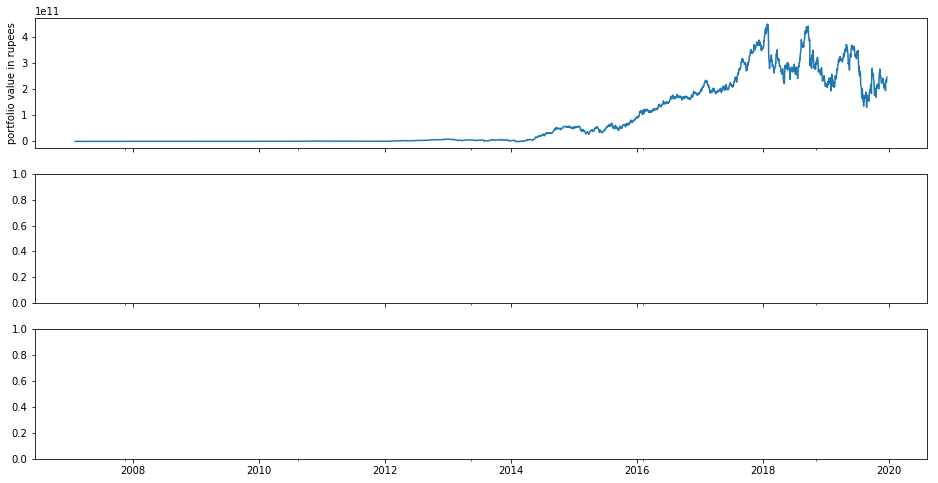

In [14]:
import matplotlib.pyplot as plt
fig, ax = plt.subplots(3, 1, sharex=True, figsize=[16, 9])
perf.portfolio_value.plot(ax=ax[0])
ax[0].set_ylabel('portfolio value in rupees')

#asset


In [227]:


# mark transactions
perf_trans = perf.loc[[t != [] for t in perf.transactions]]
buys = perf_trans.loc[[t[0]['amount'] > 0 for t in perf_trans.transactions]]
sells = perf_trans.loc[[t[0]['amount'] < 0 for t in perf_trans.transactions]]


In [232]:
for b in buys.transactions:
    print(b)

[{'amount': 3148, 'dt': Timestamp('2019-03-07 10:00:00+0000', tz='UTC'), 'sid': Equity(474 [UJJIVAN]), 'commission': None, 'price': 319.85985, 'order_id': 'd406567927ac4e408aa10db44bd65c5e'}, {'amount': 857, 'dt': Timestamp('2019-03-07 10:00:00+0000', tz='UTC'), 'sid': Equity(1 [AAVAS]), 'commission': None, 'price': 1226.8131, 'order_id': 'a8aefdbcb8644acc9c1619807a7c4ca6'}, {'amount': 3432, 'dt': Timestamp('2019-03-07 10:00:00+0000', tz='UTC'), 'sid': Equity(227 [INOXLEISUR]), 'commission': None, 'price': 293.44665000000003, 'order_id': '498808b923c843269f89ccbdb3ef14c7'}, {'amount': 757, 'dt': Timestamp('2019-03-07 10:00:00+0000', tz='UTC'), 'sid': Equity(436 [SYMPHONY]), 'commission': None, 'price': 1314.0567, 'order_id': '1e0bb893998d4ee2aed19772b50cb528'}, {'amount': 3382, 'dt': Timestamp('2019-03-07 10:00:00+0000', tz='UTC'), 'sid': Equity(149 [GET&D]), 'commission': None, 'price': 295.397625, 'order_id': 'dfa5d6983c154ac6bedac9f5762682e6'}, {'amount': 1779, 'dt': Timestamp('2019

In [230]:
sells

,algo_volatility,algorithm_period_return,alpha,benchmark_period_return,benchmark_volatility,beta,capital_used,ending_cash,ending_exposure,ending_value,...,short_exposure,short_value,shorts_count,sortino,starting_cash,starting_exposure,starting_value,trading_days,transactions,treasury_period_return
2019-03-14 10:00:00+00:00,0.023339,0.017619,0.044380,0.040168,0.201491,0.006629,78773.414200,19236.232850,10156956.20,10156956.20,...,0.0,0.0,0,4.645873,-59537.181350,10198612.80,10198612.80,98,"[{'amount': -196, 'dt': 2019-03-14 10:00:00+00...",0.0
2019-04-04 10:00:00+00:00,0.055799,0.003347,0.008478,0.050573,0.192376,0.004489,24621.234650,8198.552425,10025271.45,10025271.45,...,0.0,0.0,0,0.239525,-16422.682225,10151691.20,10151691.20,112,"[{'amount': -17, 'dt': 2019-04-04 10:00:00+00:...",0.0
2019-05-02 10:00:00+00:00,0.094902,0.001237,0.006224,0.074222,0.180981,0.004395,99969.415750,-990.646950,10013361.90,10013361.90,...,0.0,0.0,0,0.099097,-100960.062700,10106396.65,10106396.65,128,"[{'amount': -173, 'dt': 2019-05-02 10:00:00+00...",0.0
2019-05-23 10:00:00+00:00,0.128225,0.009420,0.020521,0.040871,0.179357,0.048256,34271.594459,117196.036734,9977003.30,9977003.30,...,0.0,0.0,0,0.267763,82924.442275,9997148.80,9997148.80,143,"[{'amount': -1919, 'dt': 2019-05-23 10:00:00+0...",0.0
2019-06-13 10:00:00+00:00,0.136750,-0.075699,-0.123604,0.059145,0.175663,0.061312,45215.162325,8447.124688,9234562.45,9234562.45,...,0.0,0.0,0,-1.132510,-36768.037637,9347626.05,9347626.05,157,"[{'amount': -57, 'dt': 2019-06-13 10:00:00+00:...",0.0
2019-06-19 10:00:00+00:00,0.139168,-0.119102,-0.196117,0.071873,0.173934,0.059422,-76626.899425,-68179.774737,8877155.90,8877155.90,...,0.0,0.0,0,-1.750739,8447.124688,8994213.65,8994213.65,161,"[{'amount': -42, 'dt': 2019-06-19 10:00:00+00:...",0.0
2019-07-04 10:00:00+00:00,0.139357,-0.092179,-0.143016,0.099781,0.170299,0.066061,-11514.050425,10961.166838,9067252.80,9067252.80,...,0.0,0.0,0,-1.249829,22475.217263,9004619.10,9004619.10,171,"[{'amount': -4, 'dt': 2019-07-04 10:00:00+00:0...",0.0
2019-07-11 10:00:00+00:00,0.142593,-0.118940,-0.182279,0.101658,0.168111,0.073126,-38397.081900,-27435.915062,8838040.10,8838040.10,...,0.0,0.0,0,-1.553836,10961.166838,8796078.00,8796078.00,176,"[{'amount': -9, 'dt': 2019-07-11 10:00:00+00:0...",0.0
2019-07-18 10:00:00+00:00,0.141005,-0.113321,-0.168042,0.099891,0.166149,0.072147,12817.908475,-14618.006587,8881404.40,8881404.40,...,0.0,0.0,0,-1.449576,-27435.915062,8912948.25,8912948.25,181,"[{'amount': -19, 'dt': 2019-07-18 10:00:00+00:...",0.0


In [15]:

import pyfolio as pf

In [16]:
results = pd.read_pickle('nse_weekly.pickle')
returns, positions, transactions = pf.utils.extract_rets_pos_txn_from_zipline(results)

/opt/anaconda3/envs/env_zipline/lib/python3.5/site-packages/numpy/core/fromnumeric.py:52: FutureWarning: 'argmin' is deprecated. Use 'idxmin' instead. The behavior of 'argmin' will be corrected to return the positional minimum in the future. Use 'series.values.argmin' to get the position of the minimum now.
  return getattr(obj, method)(*args, **kwds)


Text(0.5, 0, 'Date')

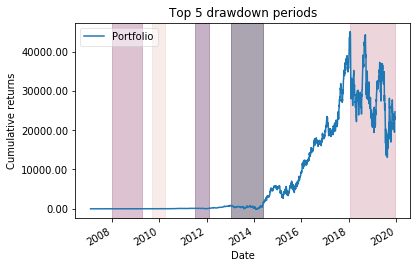

In [17]:
pf.plot_drawdown_periods(returns, top=5).set_xlabel('Date')

In [ ]:
pf.create_full_tear_sheet(returns, positions=positions, transactions=transactions,
                          live_start_date='2015-01-02', round_trips=True)

Worst drawdown periods,Net drawdown in %,Peak date,Valley date,Recovery date,Duration
0,121.35,2013-01-04,2014-01-30,2014-05-14,354
1,84.13,2011-07-07,2011-12-20,2012-02-08,155
2,82.14,2008-01-04,2008-09-22,2009-04-01,324
3,71.01,2018-01-25,2019-08-22,NaT,NaN
4,62.71,2009-09-04,2010-02-05,2010-03-26,146


Stress Events,mean,min,max
Lehman,0.11%,-65.93%,22.99%
US downgrade/European Debt Crisis,0.39%,-13.73%,33.80%
Fukushima,3.15%,-7.86%,19.48%
EZB IR Event,1.33%,-9.34%,9.93%
Aug07,0.00%,0.00%,0.00%
Mar08,-0.95%,-3.74%,3.71%
Sept08,0.12%,-65.93%,22.99%
2009Q1,0.03%,-2.37%,2.23%
2009Q2,0.60%,-27.41%,38.39%
Flash Crash,0.77%,-9.29%,7.50%


Top 10 long positions of all time,max
sid,
VAKRANGEE.NS,162473.03%
ASIANPAINT.NS,104633.41%
MRF.NS,103284.54%
DIVISLAB.NS,102221.29%
MOTHERSUMI.NS,67344.09%
L&TFH.NS,54492.78%
J&KBANK.NS,51367.14%
AMARAJABAT.NS,42330.05%
UBL.NS,41642.33%


Top 10 short positions of all time,max
sid,
AUROPHARMA.NS,-223266.59%
HAVELLS.NS,-86987.04%
IPCALAB.NS,-65381.40%
BAJFINANCE.NS,-47575.38%
AJANTPHARM.NS,-46031.17%
JYOTHYLAB.NS,-33099.30%
CRISIL.NS,-30734.58%
GRUH.NS,-23897.98%
PAGEIND.NS,-22446.46%


Top 10 positions of all time,max
sid,
AUROPHARMA.NS,223266.59%
VAKRANGEE.NS,162473.03%
ASIANPAINT.NS,104633.41%
MRF.NS,103284.54%
DIVISLAB.NS,102221.29%
HAVELLS.NS,86987.04%
MOTHERSUMI.NS,67344.09%
IPCALAB.NS,65381.40%
L&TFH.NS,54492.78%
